# Warning : 
# Do "File -> Save a copy in Drive" before you start modifying the notebook, otherwise your modifications will not be saved.


In [ ]:
!git clone https://github.com/cdancette/deep-learning-polytech-tp6-7.git

Cloning into 'deep-learning-polytech-tp6-7'...
remote: Enumerating objects: 22, done.
remote: Counting objects: 100% (14/14), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 22 (delta 3), reused 7 (delta 1), pack-reused 8
Unpacking objects: 100% (22/22), done.


In [ ]:
cd deep-learning-polytech-tp6-7

/content/deep-learning-polytech-tp6-7


In [ ]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets

from tme6 import *

PRINT_INTERVAL = 200
PATH="datasets"

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(1, 6, (5, 5), stride=1, padding=2),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(6, 16, (5, 5), stride=1, padding=0),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(400, 120),
            nn.Tanh(),
            nn.Linear(120, 84),
            nn.Tanh(),
            nn.Linear(84, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.MNIST(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.MNIST(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


=== EPOCH 1 =====

[TRAIN Batch 000/469]	Time 0.141s (0.141s)	Loss 2.3104 (2.3104)	Prec@1   9.4 (  9.4)	Prec@5  48.4 ( 48.4)


<Figure size 432x288 with 0 Axes>

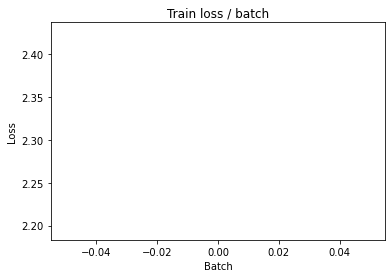

[TRAIN Batch 200/469]	Time 0.006s (0.024s)	Loss 0.4255 (1.1784)	Prec@1  88.3 ( 66.7)	Prec@5  99.2 ( 91.7)


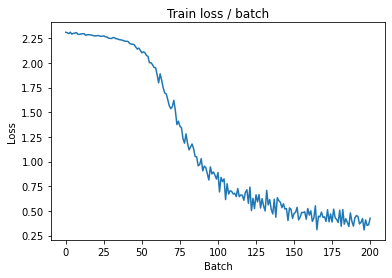

[TRAIN Batch 400/469]	Time 0.006s (0.023s)	Loss 0.1761 (0.7244)	Prec@1  93.8 ( 79.5)	Prec@5 100.0 ( 95.7)


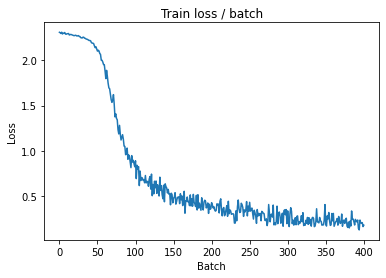


===============> Total time 10s	Avg loss 0.6472	Avg Prec@1 81.72 %	Avg Prec@5 96.26 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.0992 (0.0992)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.1570	Avg Prec@1 95.35 %	Avg Prec@5 99.88 %



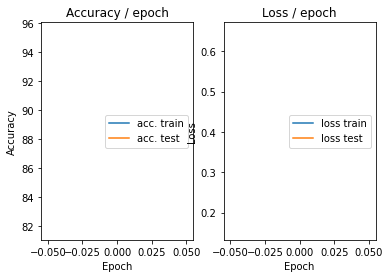

=== EPOCH 2 =====

[TRAIN Batch 000/469]	Time 0.130s (0.130s)	Loss 0.2331 (0.2331)	Prec@1  93.8 ( 93.8)	Prec@5  99.2 ( 99.2)


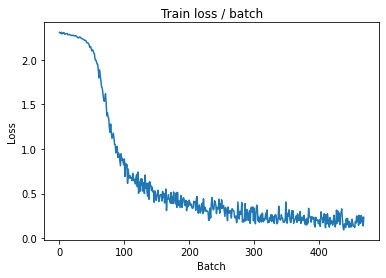

[TRAIN Batch 200/469]	Time 0.039s (0.025s)	Loss 0.1739 (0.1428)	Prec@1  93.0 ( 96.1)	Prec@5  99.2 ( 99.8)


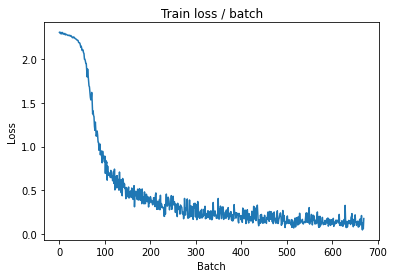

[TRAIN Batch 400/469]	Time 0.031s (0.024s)	Loss 0.0561 (0.1250)	Prec@1  98.4 ( 96.4)	Prec@5 100.0 ( 99.9)


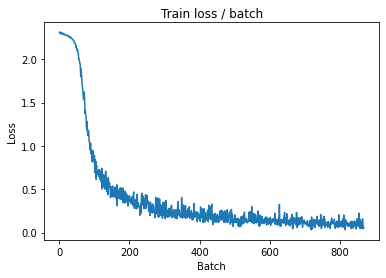


===============> Total time 11s	Avg loss 0.1217	Avg Prec@1 96.52 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 0.0239 (0.0239)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0806	Avg Prec@1 97.54 %	Avg Prec@5 99.98 %



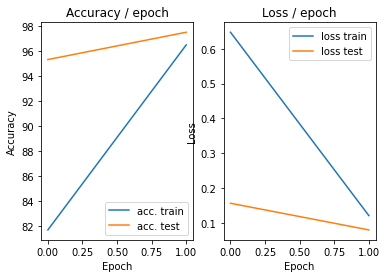

=== EPOCH 3 =====

[TRAIN Batch 000/469]	Time 0.154s (0.154s)	Loss 0.1345 (0.1345)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


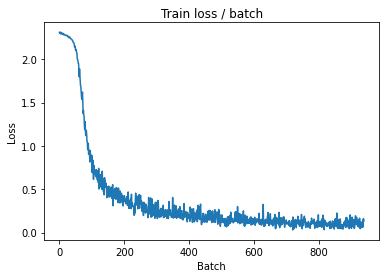

[TRAIN Batch 200/469]	Time 0.038s (0.024s)	Loss 0.1443 (0.0831)	Prec@1  98.4 ( 97.6)	Prec@5  99.2 ( 99.9)


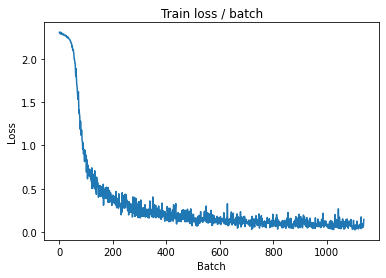

[TRAIN Batch 400/469]	Time 0.037s (0.024s)	Loss 0.0827 (0.0806)	Prec@1  96.1 ( 97.6)	Prec@5 100.0 ( 99.9)


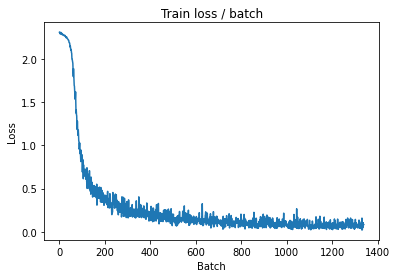


===============> Total time 11s	Avg loss 0.0785	Avg Prec@1 97.70 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 0.0182 (0.0182)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0548	Avg Prec@1 98.36 %	Avg Prec@5 100.00 %



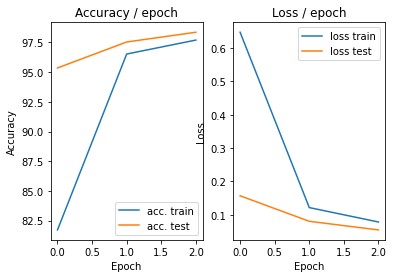

=== EPOCH 4 =====

[TRAIN Batch 000/469]	Time 0.135s (0.135s)	Loss 0.0603 (0.0603)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


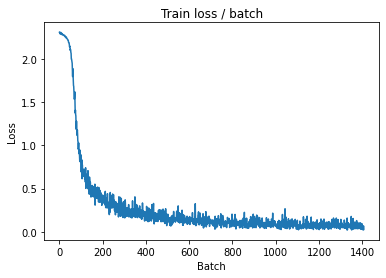

[TRAIN Batch 200/469]	Time 0.011s (0.024s)	Loss 0.0653 (0.0628)	Prec@1  98.4 ( 98.2)	Prec@5 100.0 (100.0)


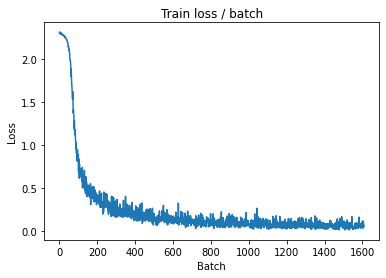

[TRAIN Batch 400/469]	Time 0.027s (0.023s)	Loss 0.0914 (0.0626)	Prec@1  98.4 ( 98.2)	Prec@5  99.2 (100.0)


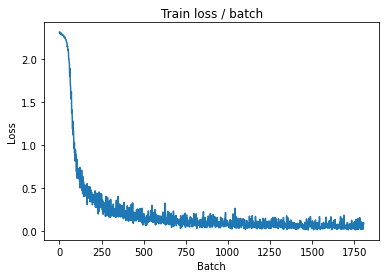


===============> Total time 11s	Avg loss 0.0612	Avg Prec@1 98.23 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 0.0247 (0.0247)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0526	Avg Prec@1 98.25 %	Avg Prec@5 99.99 %



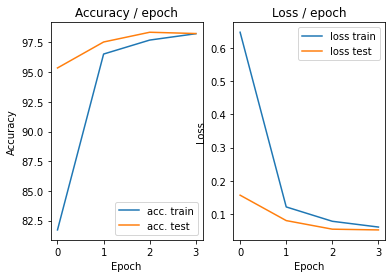

=== EPOCH 5 =====

[TRAIN Batch 000/469]	Time 0.138s (0.138s)	Loss 0.0522 (0.0522)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


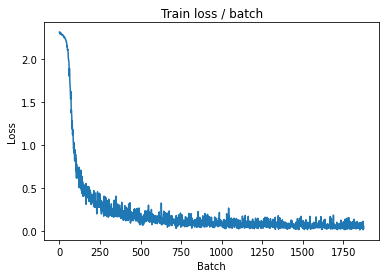

[TRAIN Batch 200/469]	Time 0.030s (0.025s)	Loss 0.0548 (0.0538)	Prec@1  99.2 ( 98.4)	Prec@5 100.0 (100.0)


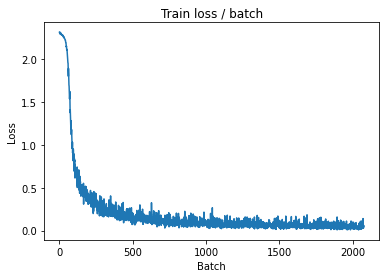

[TRAIN Batch 400/469]	Time 0.010s (0.024s)	Loss 0.0291 (0.0523)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


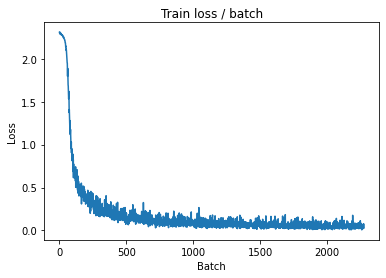


===============> Total time 11s	Avg loss 0.0507	Avg Prec@1 98.49 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.0116 (0.0116)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0425	Avg Prec@1 98.67 %	Avg Prec@5 100.00 %



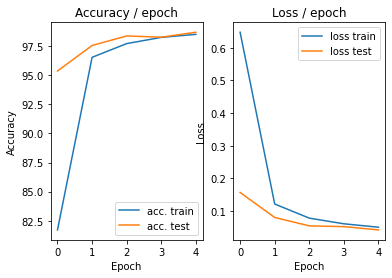

=== EPOCH 6 =====

[TRAIN Batch 000/469]	Time 0.148s (0.148s)	Loss 0.0347 (0.0347)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


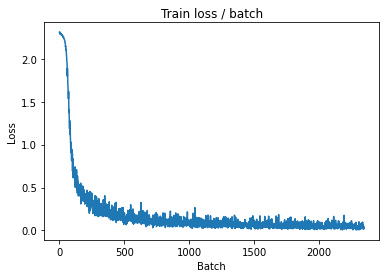

[TRAIN Batch 200/469]	Time 0.012s (0.024s)	Loss 0.0383 (0.0447)	Prec@1  99.2 ( 98.7)	Prec@5 100.0 (100.0)


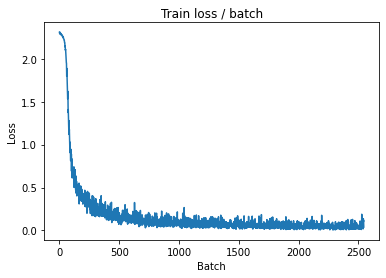

[TRAIN Batch 400/469]	Time 0.034s (0.023s)	Loss 0.0546 (0.0439)	Prec@1  97.7 ( 98.7)	Prec@5 100.0 (100.0)


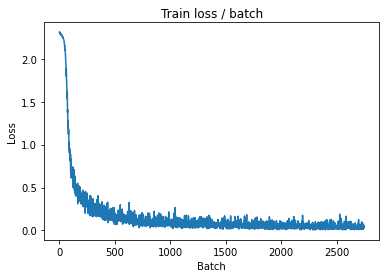


===============> Total time 11s	Avg loss 0.0436	Avg Prec@1 98.72 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.0151 (0.0151)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0393	Avg Prec@1 98.69 %	Avg Prec@5 100.00 %



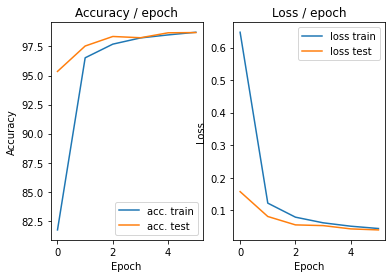

=== EPOCH 7 =====

[TRAIN Batch 000/469]	Time 0.147s (0.147s)	Loss 0.1263 (0.1263)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


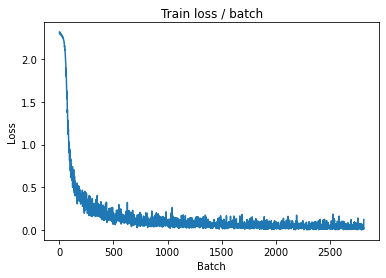

[TRAIN Batch 200/469]	Time 0.036s (0.024s)	Loss 0.0090 (0.0374)	Prec@1 100.0 ( 98.9)	Prec@5 100.0 (100.0)


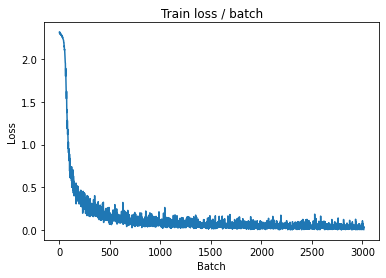

[TRAIN Batch 400/469]	Time 0.036s (0.023s)	Loss 0.0082 (0.0383)	Prec@1 100.0 ( 98.9)	Prec@5 100.0 (100.0)


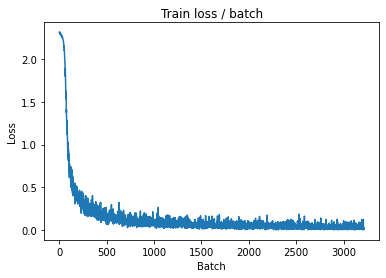


===============> Total time 11s	Avg loss 0.0387	Avg Prec@1 98.88 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.0126 (0.0126)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0371	Avg Prec@1 98.78 %	Avg Prec@5 99.99 %



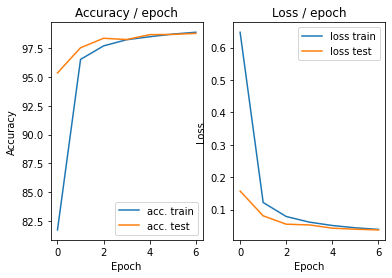

=== EPOCH 8 =====

[TRAIN Batch 000/469]	Time 0.139s (0.139s)	Loss 0.0386 (0.0386)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


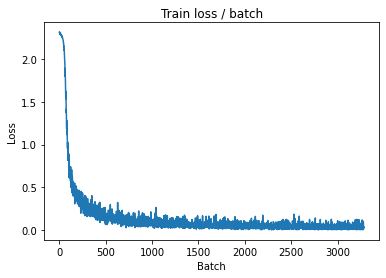

[TRAIN Batch 200/469]	Time 0.011s (0.025s)	Loss 0.0088 (0.0340)	Prec@1 100.0 ( 99.0)	Prec@5 100.0 (100.0)


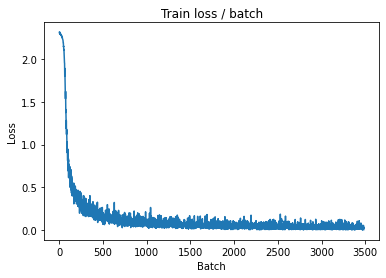

[TRAIN Batch 400/469]	Time 0.006s (0.024s)	Loss 0.0168 (0.0342)	Prec@1  99.2 ( 99.0)	Prec@5 100.0 (100.0)


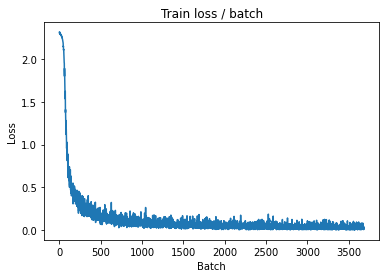


===============> Total time 11s	Avg loss 0.0344	Avg Prec@1 98.99 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.0123 (0.0123)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0359	Avg Prec@1 98.81 %	Avg Prec@5 100.00 %



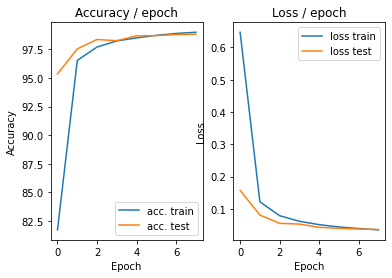

=== EPOCH 9 =====

[TRAIN Batch 000/469]	Time 0.168s (0.168s)	Loss 0.0211 (0.0211)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


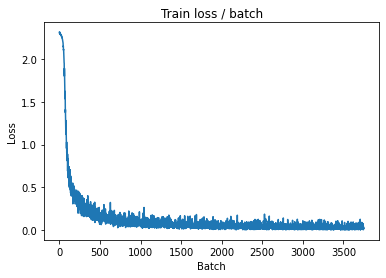

[TRAIN Batch 200/469]	Time 0.010s (0.023s)	Loss 0.0094 (0.0286)	Prec@1 100.0 ( 99.1)	Prec@5 100.0 (100.0)


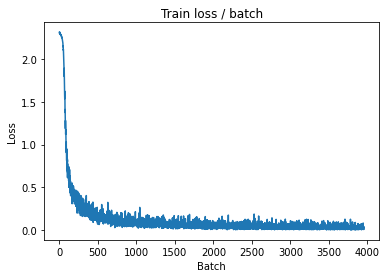

[TRAIN Batch 400/469]	Time 0.007s (0.023s)	Loss 0.0186 (0.0313)	Prec@1  99.2 ( 99.0)	Prec@5 100.0 (100.0)


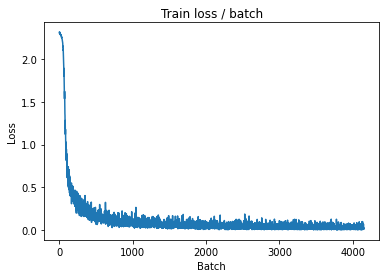


===============> Total time 10s	Avg loss 0.0312	Avg Prec@1 99.05 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.0137 (0.0137)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0334	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



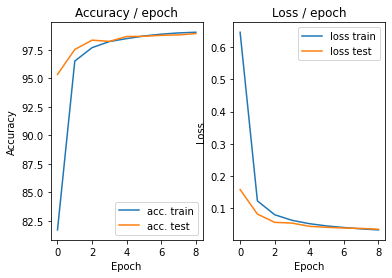

=== EPOCH 10 =====

[TRAIN Batch 000/469]	Time 0.161s (0.161s)	Loss 0.0299 (0.0299)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


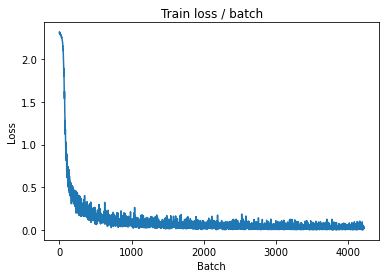

[TRAIN Batch 200/469]	Time 0.007s (0.024s)	Loss 0.0390 (0.0265)	Prec@1  98.4 ( 99.2)	Prec@5 100.0 (100.0)


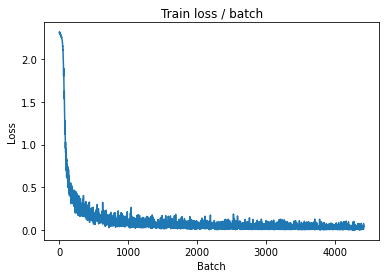

[TRAIN Batch 400/469]	Time 0.026s (0.024s)	Loss 0.0118 (0.0273)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


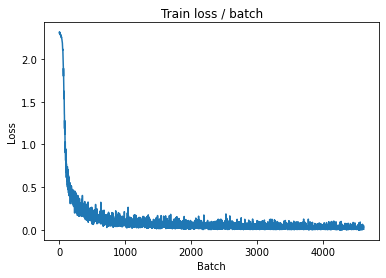


===============> Total time 11s	Avg loss 0.0278	Avg Prec@1 99.18 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.0113 (0.0113)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0335	Avg Prec@1 98.85 %	Avg Prec@5 100.00 %



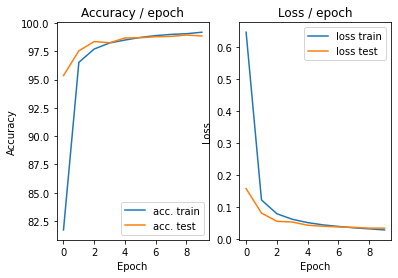

=== EPOCH 11 =====

[TRAIN Batch 000/469]	Time 0.175s (0.175s)	Loss 0.0084 (0.0084)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


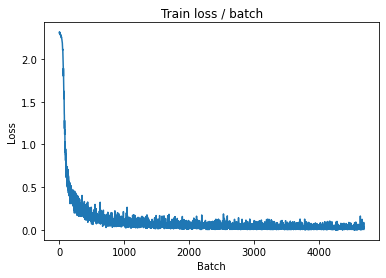

[TRAIN Batch 200/469]	Time 0.006s (0.025s)	Loss 0.0333 (0.0246)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


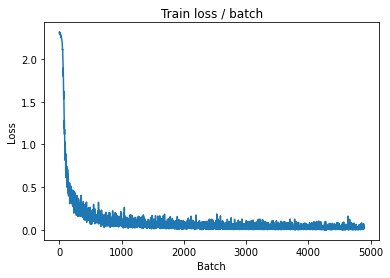

[TRAIN Batch 400/469]	Time 0.010s (0.024s)	Loss 0.0098 (0.0252)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


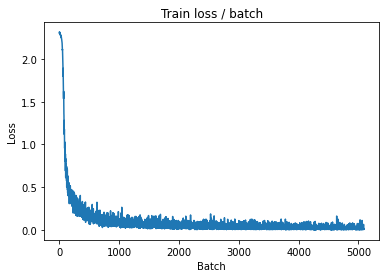


===============> Total time 11s	Avg loss 0.0253	Avg Prec@1 99.26 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.0172 (0.0172)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0366	Avg Prec@1 98.80 %	Avg Prec@5 99.99 %



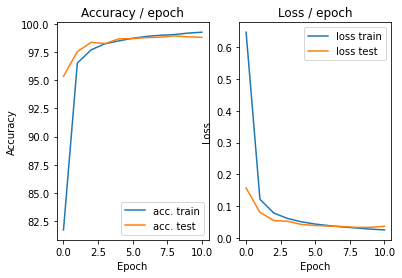

=== EPOCH 12 =====

[TRAIN Batch 000/469]	Time 0.177s (0.177s)	Loss 0.0101 (0.0101)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


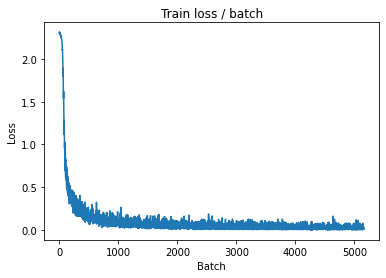

[TRAIN Batch 200/469]	Time 0.006s (0.024s)	Loss 0.0070 (0.0204)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


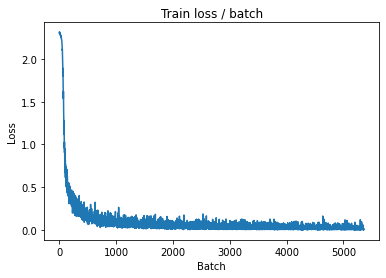

[TRAIN Batch 400/469]	Time 0.006s (0.024s)	Loss 0.0080 (0.0227)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


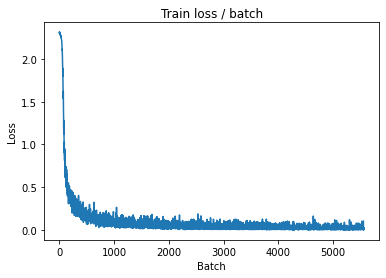


===============> Total time 11s	Avg loss 0.0222	Avg Prec@1 99.33 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 0.0115 (0.0115)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0335	Avg Prec@1 98.89 %	Avg Prec@5 100.00 %



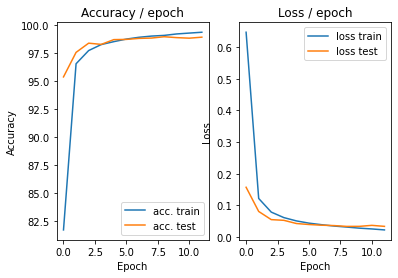

=== EPOCH 13 =====

[TRAIN Batch 000/469]	Time 0.157s (0.157s)	Loss 0.0351 (0.0351)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


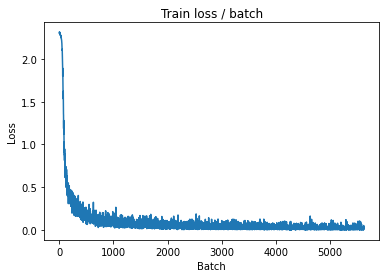

[TRAIN Batch 200/469]	Time 0.024s (0.024s)	Loss 0.0565 (0.0191)	Prec@1  98.4 ( 99.5)	Prec@5 100.0 (100.0)


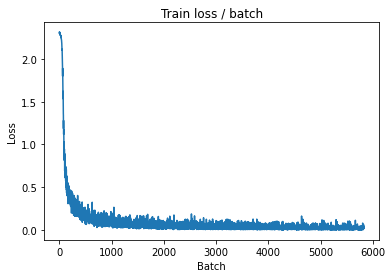

[TRAIN Batch 400/469]	Time 0.040s (0.024s)	Loss 0.0086 (0.0201)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


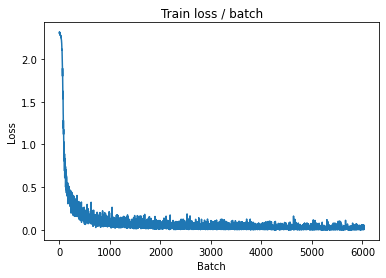


===============> Total time 11s	Avg loss 0.0205	Avg Prec@1 99.45 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.0128 (0.0128)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0321	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



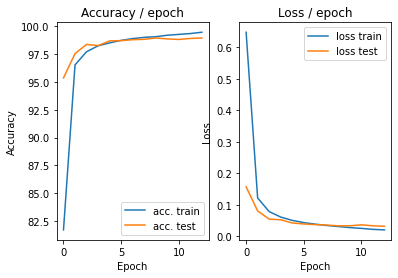

=== EPOCH 14 =====

[TRAIN Batch 000/469]	Time 0.150s (0.150s)	Loss 0.0089 (0.0089)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


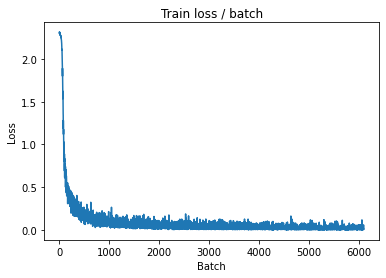

[TRAIN Batch 200/469]	Time 0.006s (0.025s)	Loss 0.0314 (0.0178)	Prec@1  99.2 ( 99.5)	Prec@5 100.0 (100.0)


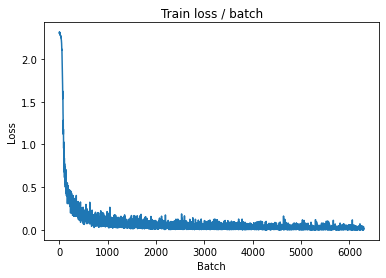

[TRAIN Batch 400/469]	Time 0.035s (0.024s)	Loss 0.0914 (0.0186)	Prec@1  99.2 ( 99.4)	Prec@5  99.2 (100.0)


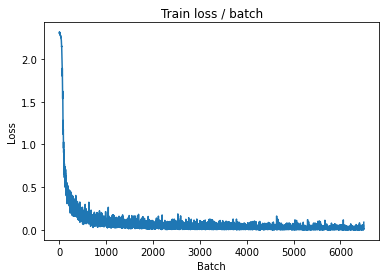


===============> Total time 11s	Avg loss 0.0184	Avg Prec@1 99.44 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.0133 (0.0133)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0340	Avg Prec@1 98.80 %	Avg Prec@5 99.99 %



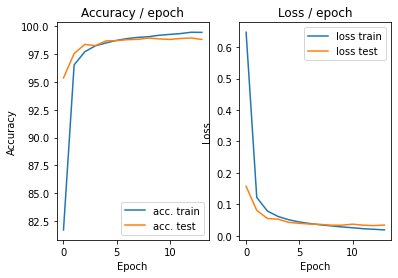

=== EPOCH 15 =====

[TRAIN Batch 000/469]	Time 0.162s (0.162s)	Loss 0.0126 (0.0126)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


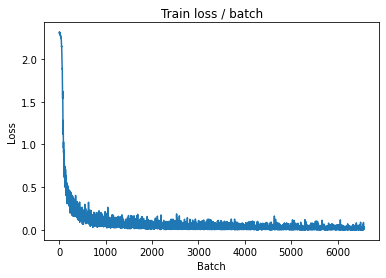

[TRAIN Batch 200/469]	Time 0.006s (0.024s)	Loss 0.0499 (0.0156)	Prec@1  98.4 ( 99.6)	Prec@5 100.0 (100.0)


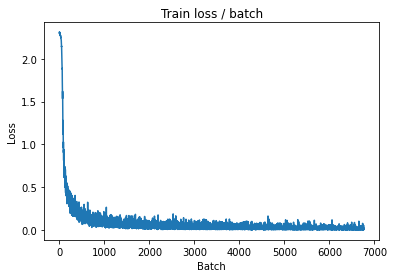

[TRAIN Batch 400/469]	Time 0.012s (0.024s)	Loss 0.0167 (0.0165)	Prec@1  99.2 ( 99.6)	Prec@5 100.0 (100.0)


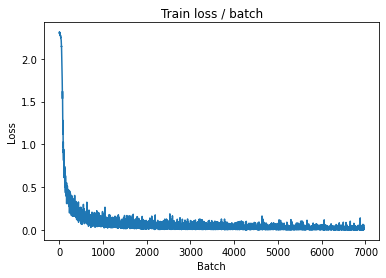


===============> Total time 11s	Avg loss 0.0164	Avg Prec@1 99.56 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.0153 (0.0153)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0344	Avg Prec@1 98.81 %	Avg Prec@5 100.00 %



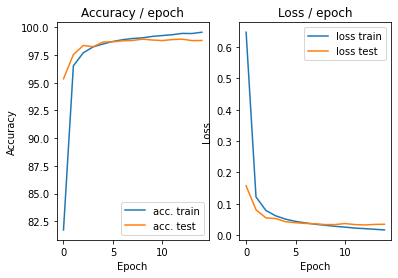

=== EPOCH 16 =====

[TRAIN Batch 000/469]	Time 0.170s (0.170s)	Loss 0.0140 (0.0140)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


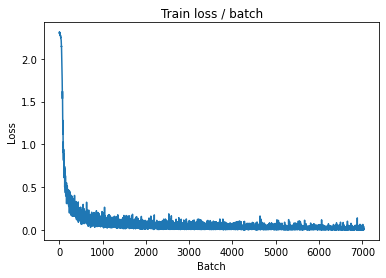

[TRAIN Batch 200/469]	Time 0.037s (0.024s)	Loss 0.0071 (0.0147)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


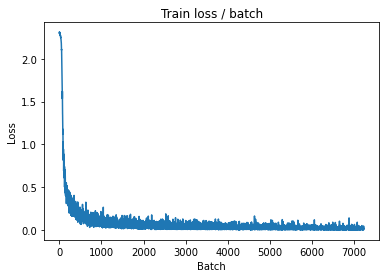

[TRAIN Batch 400/469]	Time 0.006s (0.024s)	Loss 0.0044 (0.0151)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


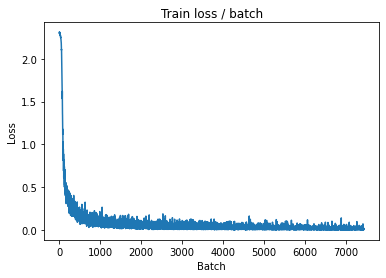


===============> Total time 11s	Avg loss 0.0152	Avg Prec@1 99.58 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.0086 (0.0086)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0332	Avg Prec@1 98.96 %	Avg Prec@5 100.00 %



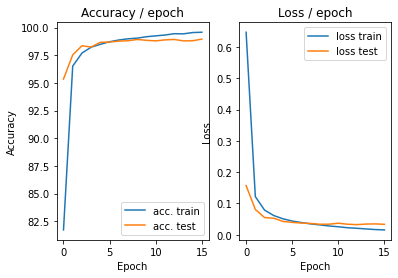

=== EPOCH 17 =====

[TRAIN Batch 000/469]	Time 0.175s (0.175s)	Loss 0.0118 (0.0118)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


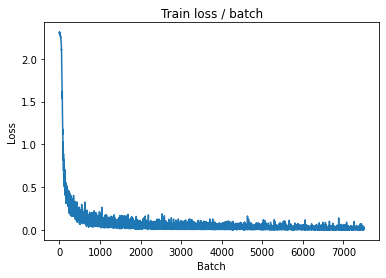

[TRAIN Batch 200/469]	Time 0.006s (0.025s)	Loss 0.0068 (0.0122)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


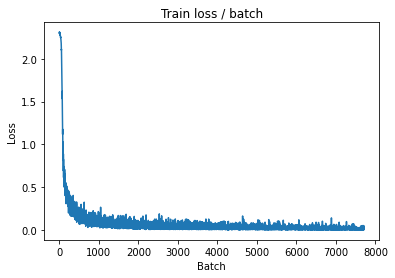

[TRAIN Batch 400/469]	Time 0.036s (0.024s)	Loss 0.0049 (0.0138)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


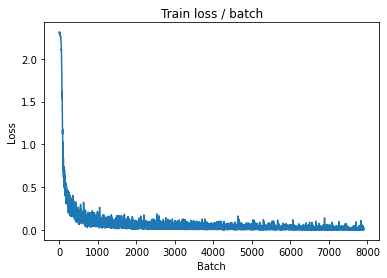


===============> Total time 11s	Avg loss 0.0139	Avg Prec@1 99.65 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.0180 (0.0180)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0316	Avg Prec@1 98.85 %	Avg Prec@5 100.00 %



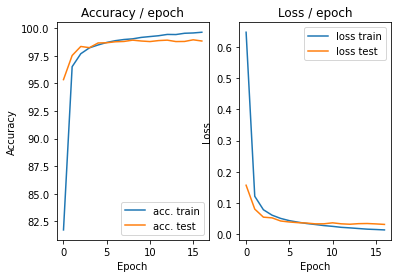

=== EPOCH 18 =====

[TRAIN Batch 000/469]	Time 0.159s (0.159s)	Loss 0.0678 (0.0678)	Prec@1  99.2 ( 99.2)	Prec@5  99.2 ( 99.2)


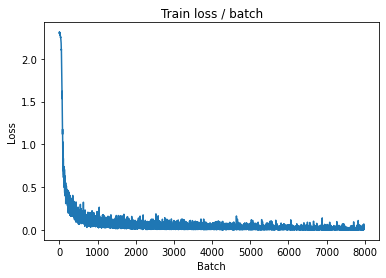

[TRAIN Batch 200/469]	Time 0.025s (0.024s)	Loss 0.0085 (0.0125)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


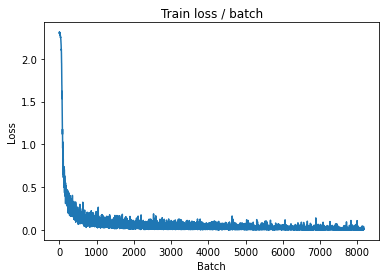

[TRAIN Batch 400/469]	Time 0.006s (0.023s)	Loss 0.0030 (0.0124)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


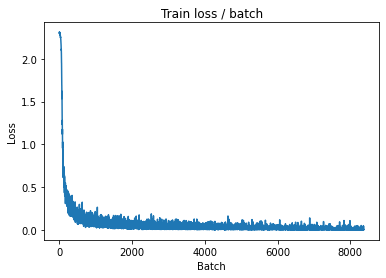


===============> Total time 11s	Avg loss 0.0124	Avg Prec@1 99.68 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.0134 (0.0134)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0314	Avg Prec@1 98.95 %	Avg Prec@5 100.00 %



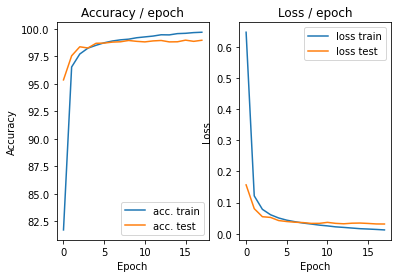

=== EPOCH 19 =====

[TRAIN Batch 000/469]	Time 0.165s (0.165s)	Loss 0.0127 (0.0127)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


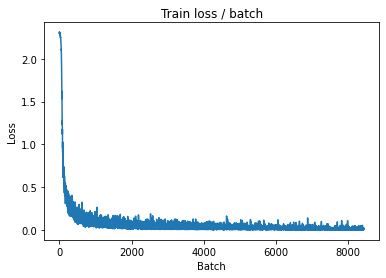

[TRAIN Batch 200/469]	Time 0.039s (0.024s)	Loss 0.0203 (0.0111)	Prec@1  99.2 ( 99.7)	Prec@5 100.0 (100.0)


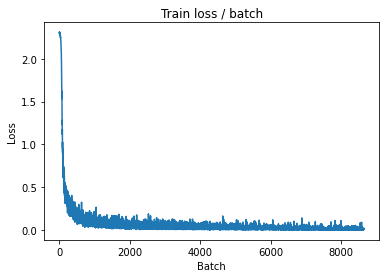

[TRAIN Batch 400/469]	Time 0.012s (0.023s)	Loss 0.0073 (0.0115)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


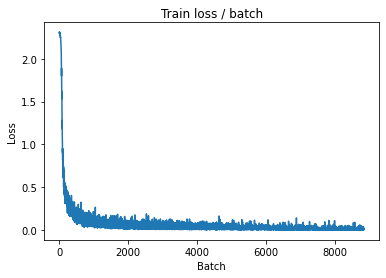


===============> Total time 11s	Avg loss 0.0115	Avg Prec@1 99.69 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.0117 (0.0117)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0372	Avg Prec@1 98.84 %	Avg Prec@5 100.00 %



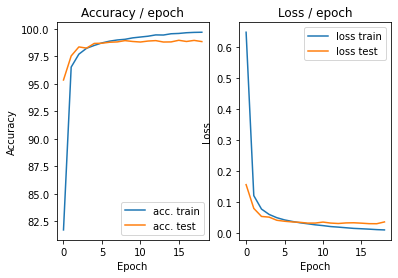

=== EPOCH 20 =====

[TRAIN Batch 000/469]	Time 0.161s (0.161s)	Loss 0.0056 (0.0056)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


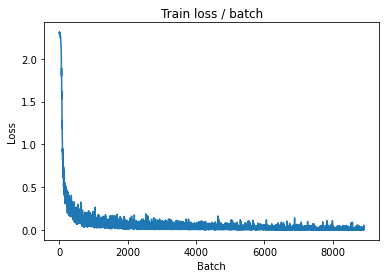

[TRAIN Batch 200/469]	Time 0.034s (0.025s)	Loss 0.0055 (0.0096)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


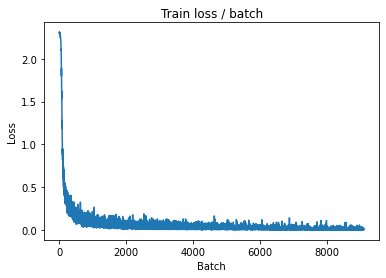

[TRAIN Batch 400/469]	Time 0.036s (0.024s)	Loss 0.0030 (0.0098)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


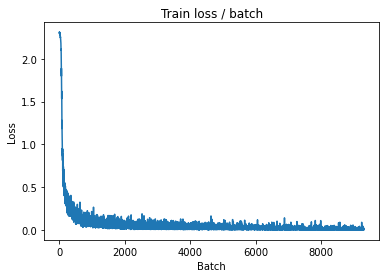


===============> Total time 11s	Avg loss 0.0102	Avg Prec@1 99.76 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.0184 (0.0184)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0314	Avg Prec@1 98.97 %	Avg Prec@5 100.00 %



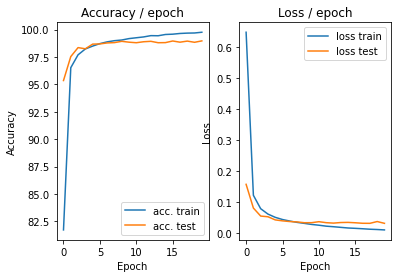

=== EPOCH 21 =====

[TRAIN Batch 000/469]	Time 0.186s (0.186s)	Loss 0.0074 (0.0074)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


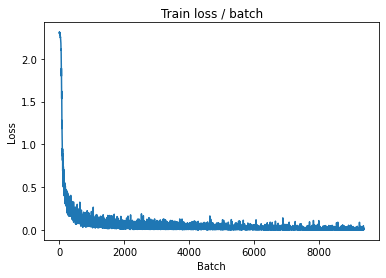

[TRAIN Batch 200/469]	Time 0.006s (0.024s)	Loss 0.0138 (0.0097)	Prec@1  99.2 ( 99.8)	Prec@5 100.0 (100.0)


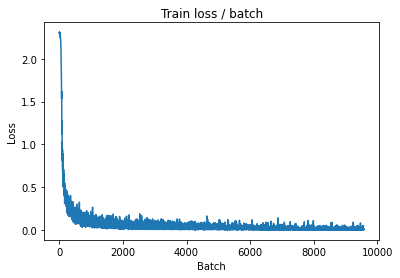

[TRAIN Batch 400/469]	Time 0.011s (0.023s)	Loss 0.0147 (0.0092)	Prec@1  99.2 ( 99.8)	Prec@5 100.0 (100.0)


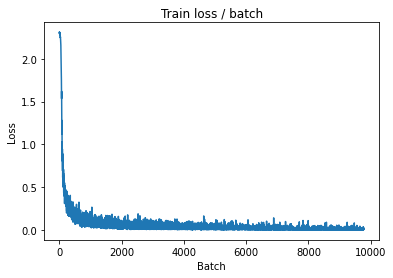


===============> Total time 11s	Avg loss 0.0094	Avg Prec@1 99.81 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.0133 (0.0133)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0343	Avg Prec@1 98.94 %	Avg Prec@5 100.00 %



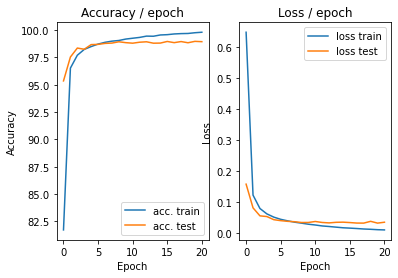

=== EPOCH 22 =====

[TRAIN Batch 000/469]	Time 0.184s (0.184s)	Loss 0.0061 (0.0061)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


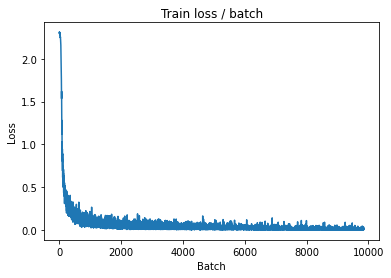

[TRAIN Batch 200/469]	Time 0.035s (0.024s)	Loss 0.0181 (0.0079)	Prec@1  99.2 ( 99.9)	Prec@5 100.0 (100.0)


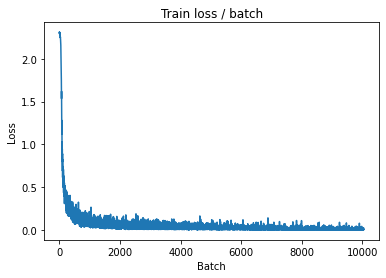

[TRAIN Batch 400/469]	Time 0.022s (0.024s)	Loss 0.0127 (0.0084)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


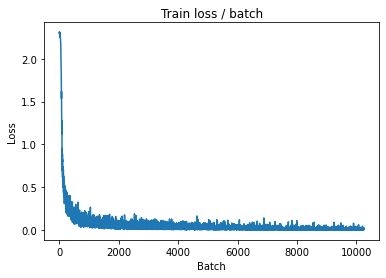


===============> Total time 11s	Avg loss 0.0087	Avg Prec@1 99.83 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.0102 (0.0102)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0321	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



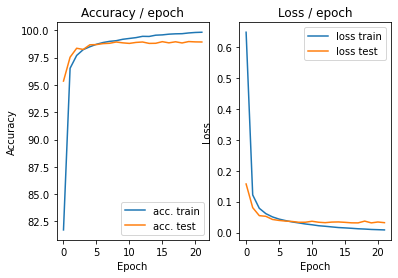

=== EPOCH 23 =====

[TRAIN Batch 000/469]	Time 0.184s (0.184s)	Loss 0.0034 (0.0034)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


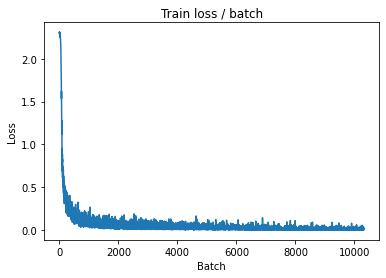

[TRAIN Batch 200/469]	Time 0.037s (0.025s)	Loss 0.0158 (0.0073)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


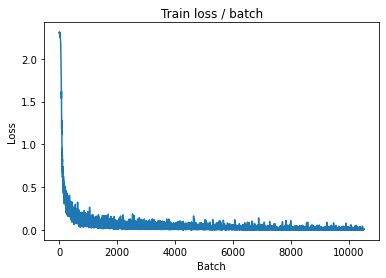

[TRAIN Batch 400/469]	Time 0.011s (0.024s)	Loss 0.0047 (0.0074)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


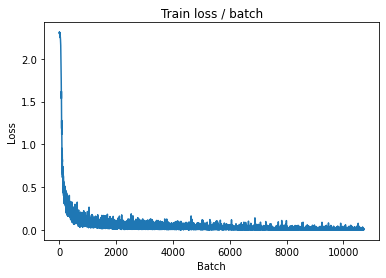


===============> Total time 11s	Avg loss 0.0079	Avg Prec@1 99.84 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.0133 (0.0133)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0353	Avg Prec@1 98.81 %	Avg Prec@5 100.00 %



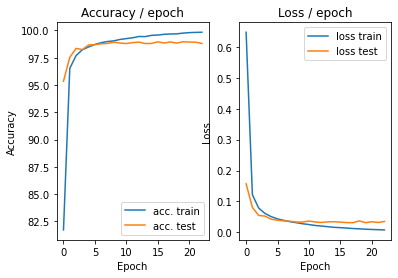

=== EPOCH 24 =====

[TRAIN Batch 000/469]	Time 0.175s (0.175s)	Loss 0.0059 (0.0059)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


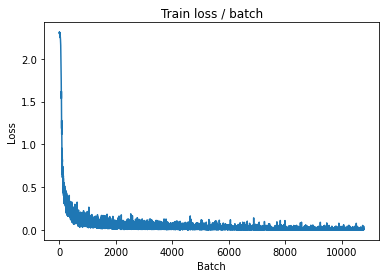

[TRAIN Batch 200/469]	Time 0.054s (0.024s)	Loss 0.0048 (0.0067)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


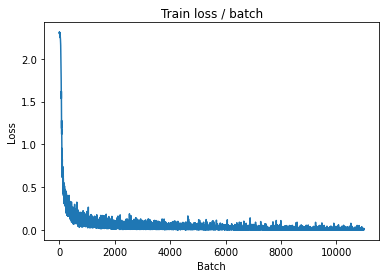

[TRAIN Batch 400/469]	Time 0.010s (0.024s)	Loss 0.0631 (0.0069)	Prec@1  98.4 ( 99.9)	Prec@5 100.0 (100.0)


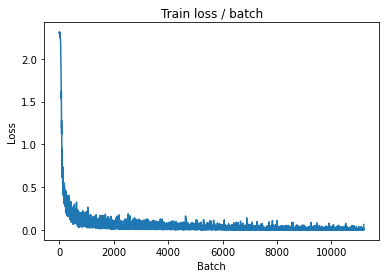


===============> Total time 11s	Avg loss 0.0072	Avg Prec@1 99.87 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.0108 (0.0108)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0360	Avg Prec@1 98.88 %	Avg Prec@5 100.00 %



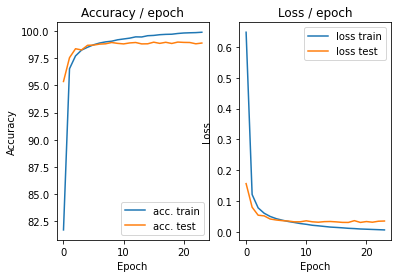

=== EPOCH 25 =====

[TRAIN Batch 000/469]	Time 0.173s (0.173s)	Loss 0.0223 (0.0223)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


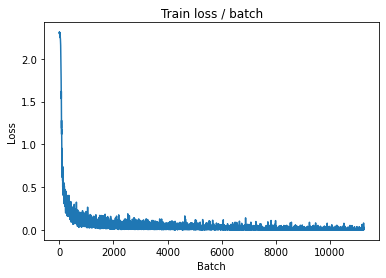

[TRAIN Batch 200/469]	Time 0.040s (0.024s)	Loss 0.0089 (0.0063)	Prec@1  99.2 ( 99.9)	Prec@5 100.0 (100.0)


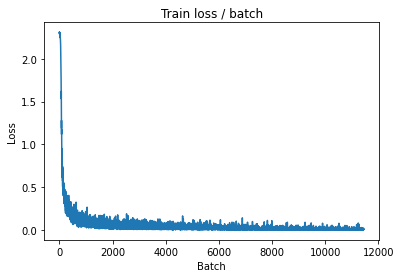

[TRAIN Batch 400/469]	Time 0.006s (0.024s)	Loss 0.0061 (0.0064)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


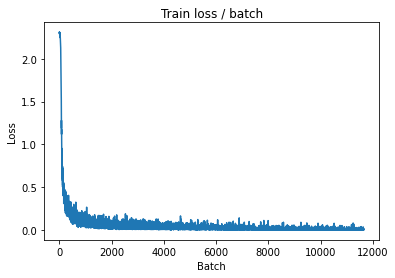


===============> Total time 11s	Avg loss 0.0066	Avg Prec@1 99.89 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.0289 (0.0289)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0323	Avg Prec@1 98.96 %	Avg Prec@5 100.00 %



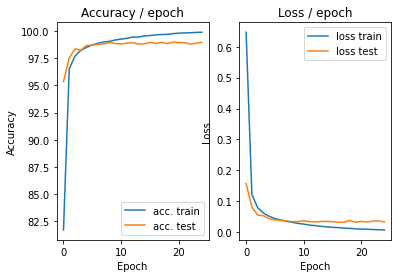

=== EPOCH 26 =====

[TRAIN Batch 000/469]	Time 0.162s (0.162s)	Loss 0.0051 (0.0051)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


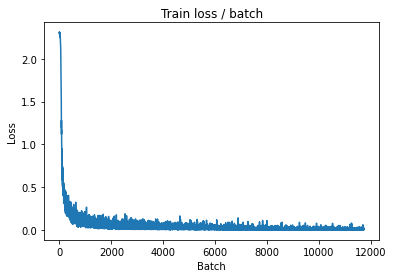

[TRAIN Batch 200/469]	Time 0.006s (0.024s)	Loss 0.0067 (0.0063)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


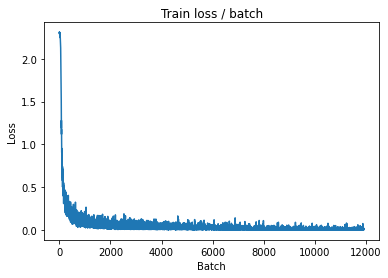

[TRAIN Batch 400/469]	Time 0.008s (0.024s)	Loss 0.0064 (0.0061)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


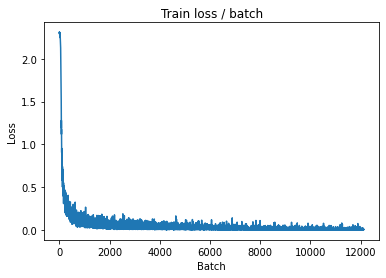


===============> Total time 11s	Avg loss 0.0061	Avg Prec@1 99.90 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.0157 (0.0157)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0322	Avg Prec@1 98.95 %	Avg Prec@5 100.00 %



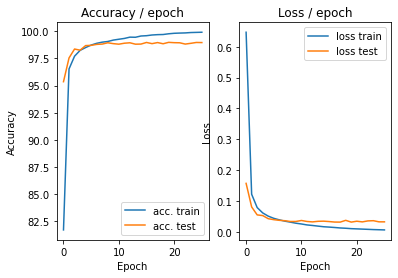

=== EPOCH 27 =====

[TRAIN Batch 000/469]	Time 0.164s (0.164s)	Loss 0.0190 (0.0190)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


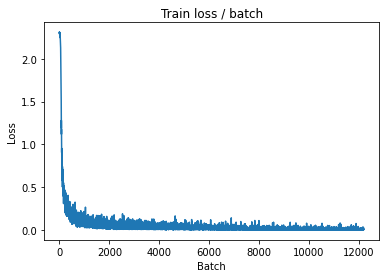

[TRAIN Batch 200/469]	Time 0.037s (0.024s)	Loss 0.0009 (0.0050)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


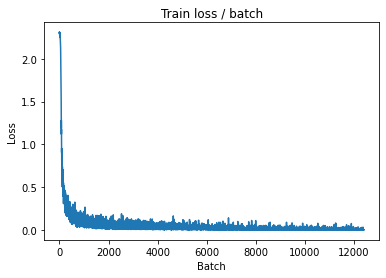

[TRAIN Batch 400/469]	Time 0.012s (0.024s)	Loss 0.0085 (0.0053)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


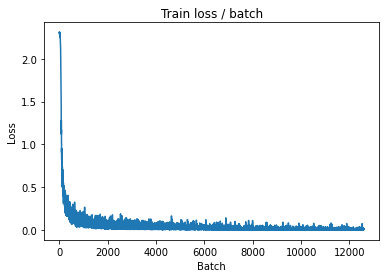


===============> Total time 11s	Avg loss 0.0055	Avg Prec@1 99.92 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.0134 (0.0134)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0345	Avg Prec@1 98.89 %	Avg Prec@5 100.00 %



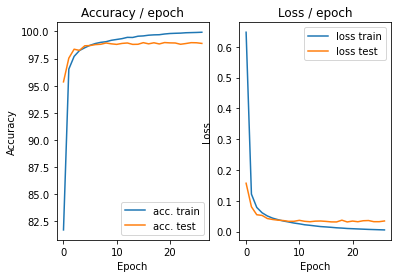

=== EPOCH 28 =====

[TRAIN Batch 000/469]	Time 0.186s (0.186s)	Loss 0.0076 (0.0076)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


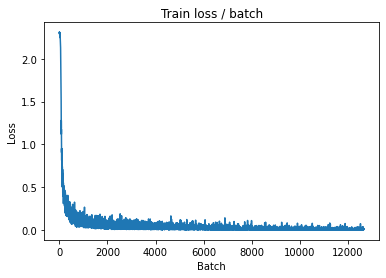

[TRAIN Batch 200/469]	Time 0.006s (0.024s)	Loss 0.0081 (0.0054)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


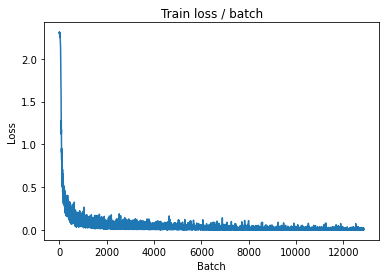

[TRAIN Batch 400/469]	Time 0.006s (0.024s)	Loss 0.0083 (0.0052)	Prec@1  99.2 ( 99.9)	Prec@5 100.0 (100.0)


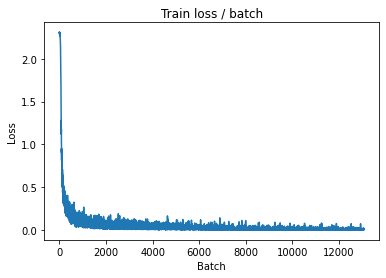


===============> Total time 11s	Avg loss 0.0051	Avg Prec@1 99.92 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 0.0140 (0.0140)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0330	Avg Prec@1 98.95 %	Avg Prec@5 100.00 %



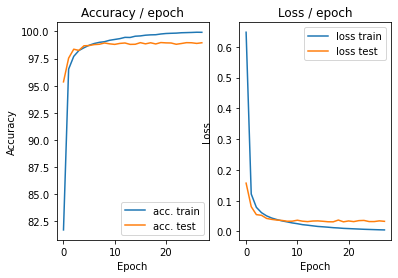

=== EPOCH 29 =====

[TRAIN Batch 000/469]	Time 0.190s (0.190s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


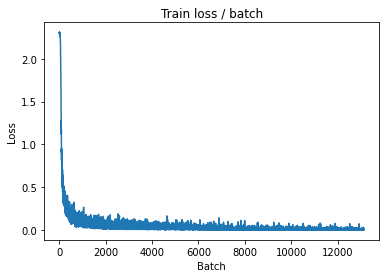

[TRAIN Batch 200/469]	Time 0.017s (0.025s)	Loss 0.0038 (0.0047)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


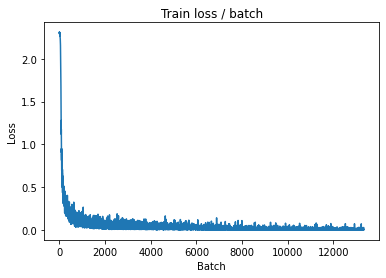

[TRAIN Batch 400/469]	Time 0.039s (0.024s)	Loss 0.0021 (0.0049)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


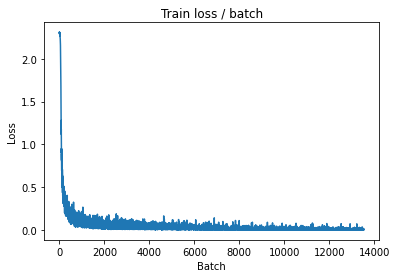


===============> Total time 11s	Avg loss 0.0049	Avg Prec@1 99.92 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.0227 (0.0227)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0336	Avg Prec@1 98.92 %	Avg Prec@5 100.00 %



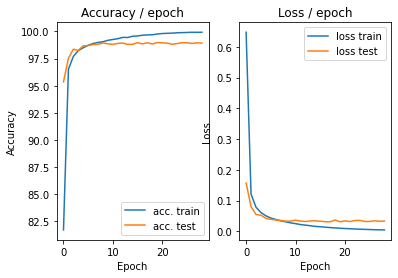

=== EPOCH 30 =====

[TRAIN Batch 000/469]	Time 0.182s (0.182s)	Loss 0.0017 (0.0017)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


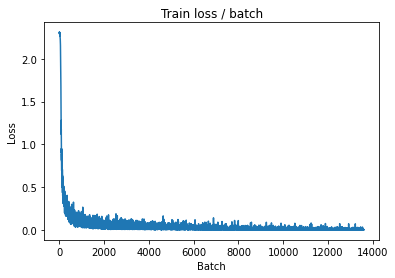

[TRAIN Batch 200/469]	Time 0.016s (0.024s)	Loss 0.0059 (0.0041)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


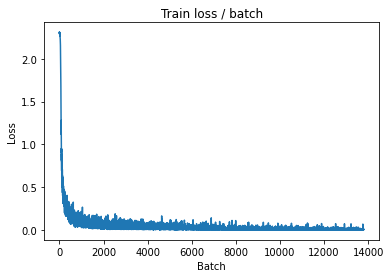

[TRAIN Batch 400/469]	Time 0.019s (0.024s)	Loss 0.0154 (0.0043)	Prec@1  98.4 ( 99.9)	Prec@5 100.0 (100.0)


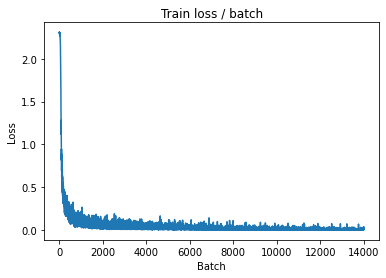


===============> Total time 11s	Avg loss 0.0044	Avg Prec@1 99.94 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.0094 (0.0094)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0350	Avg Prec@1 98.94 %	Avg Prec@5 100.00 %



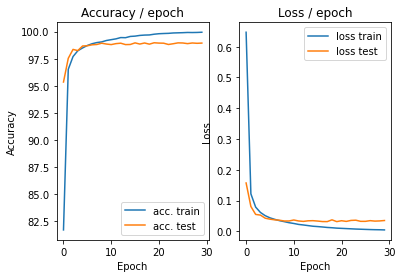

=== EPOCH 31 =====

[TRAIN Batch 000/469]	Time 0.177s (0.177s)	Loss 0.0013 (0.0013)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


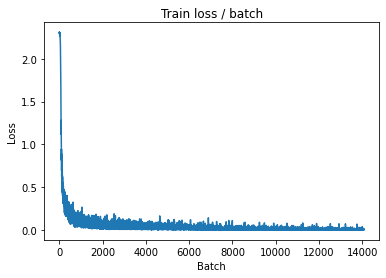

[TRAIN Batch 200/469]	Time 0.024s (0.024s)	Loss 0.0027 (0.0044)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


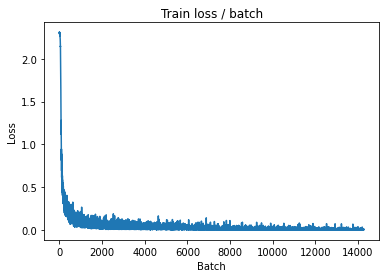

[TRAIN Batch 400/469]	Time 0.026s (0.024s)	Loss 0.0019 (0.0042)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


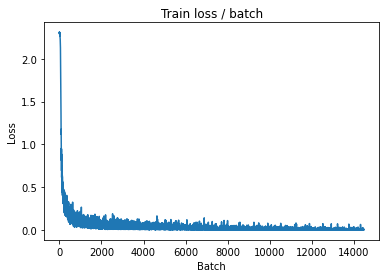


===============> Total time 11s	Avg loss 0.0041	Avg Prec@1 99.94 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.0157 (0.0157)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0332	Avg Prec@1 98.94 %	Avg Prec@5 100.00 %



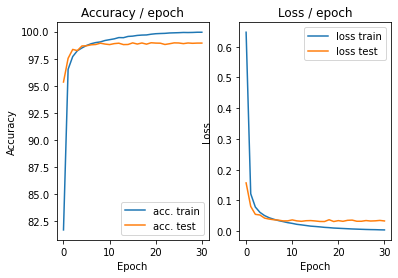

=== EPOCH 32 =====

[TRAIN Batch 000/469]	Time 0.181s (0.181s)	Loss 0.0016 (0.0016)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


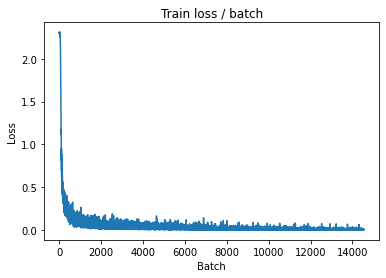

[TRAIN Batch 200/469]	Time 0.052s (0.025s)	Loss 0.0034 (0.0037)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


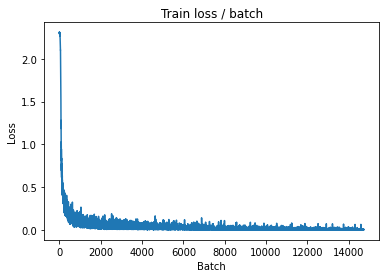

[TRAIN Batch 400/469]	Time 0.035s (0.024s)	Loss 0.0212 (0.0038)	Prec@1  99.2 ( 99.9)	Prec@5 100.0 (100.0)


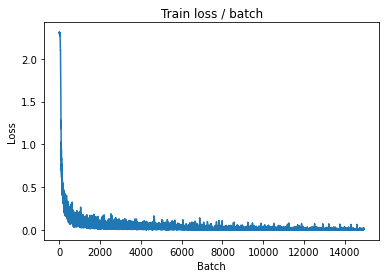


===============> Total time 11s	Avg loss 0.0038	Avg Prec@1 99.95 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.0179 (0.0179)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0333	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



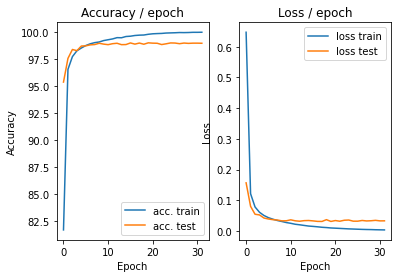

=== EPOCH 33 =====

[TRAIN Batch 000/469]	Time 0.190s (0.190s)	Loss 0.0024 (0.0024)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


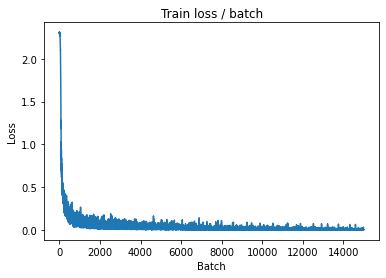

[TRAIN Batch 200/469]	Time 0.035s (0.024s)	Loss 0.0016 (0.0037)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


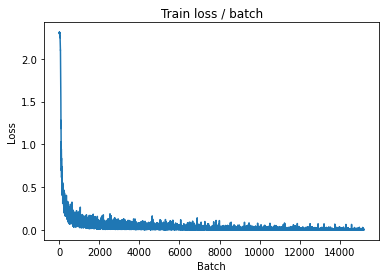

[TRAIN Batch 400/469]	Time 0.014s (0.024s)	Loss 0.0011 (0.0037)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


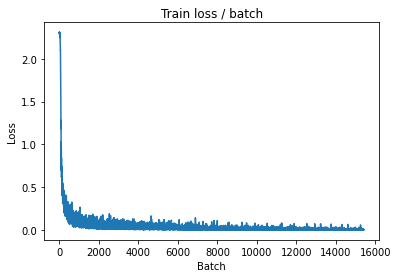


===============> Total time 11s	Avg loss 0.0036	Avg Prec@1 99.95 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.0189 (0.0189)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0335	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



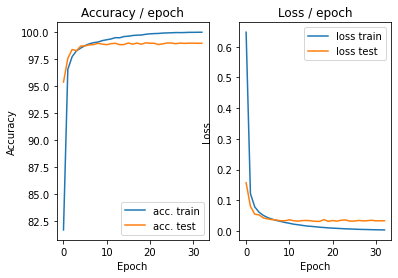

=== EPOCH 34 =====

[TRAIN Batch 000/469]	Time 0.179s (0.179s)	Loss 0.0032 (0.0032)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


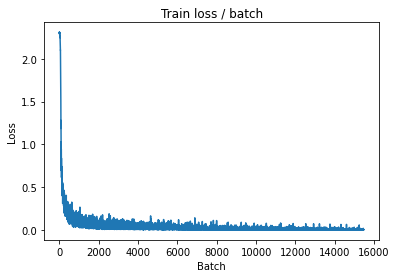

[TRAIN Batch 200/469]	Time 0.040s (0.024s)	Loss 0.0023 (0.0034)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


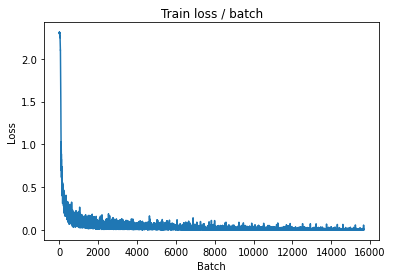

[TRAIN Batch 400/469]	Time 0.042s (0.024s)	Loss 0.0024 (0.0032)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


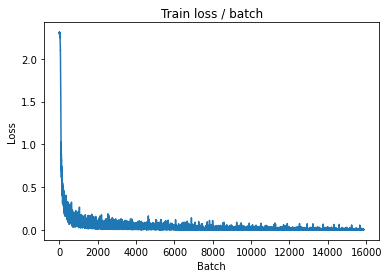


===============> Total time 11s	Avg loss 0.0032	Avg Prec@1 99.96 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.0122 (0.0122)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0348	Avg Prec@1 98.94 %	Avg Prec@5 100.00 %



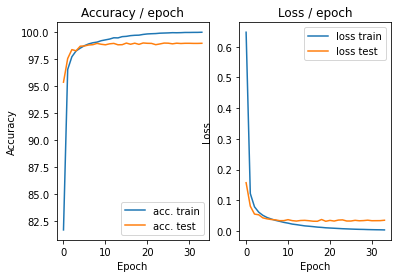

=== EPOCH 35 =====

[TRAIN Batch 000/469]	Time 0.180s (0.180s)	Loss 0.0039 (0.0039)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


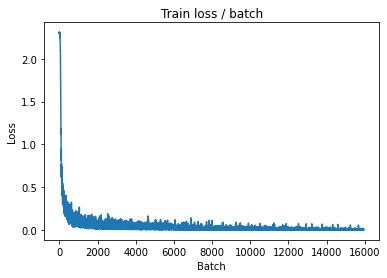

[TRAIN Batch 200/469]	Time 0.016s (0.025s)	Loss 0.0016 (0.0030)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


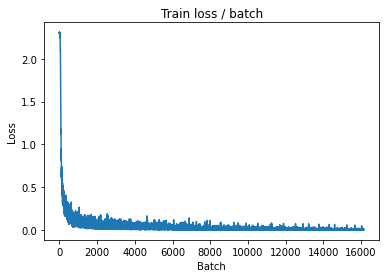

[TRAIN Batch 400/469]	Time 0.042s (0.024s)	Loss 0.0014 (0.0031)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


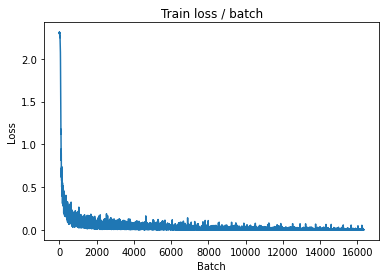


===============> Total time 11s	Avg loss 0.0031	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.0215 (0.0215)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0345	Avg Prec@1 98.90 %	Avg Prec@5 100.00 %



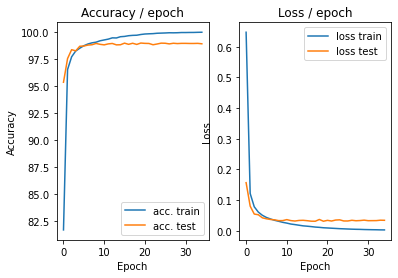

=== EPOCH 36 =====

[TRAIN Batch 000/469]	Time 0.182s (0.182s)	Loss 0.0019 (0.0019)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


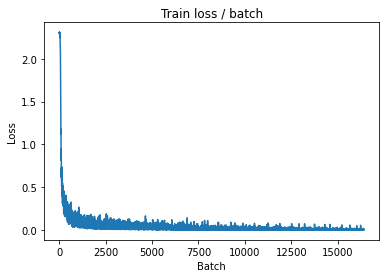

[TRAIN Batch 200/469]	Time 0.010s (0.024s)	Loss 0.0008 (0.0027)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


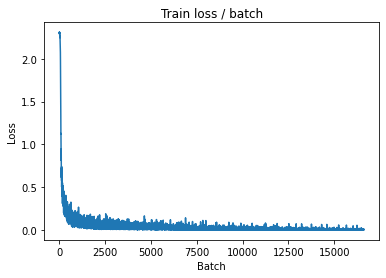

[TRAIN Batch 400/469]	Time 0.007s (0.024s)	Loss 0.0028 (0.0028)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


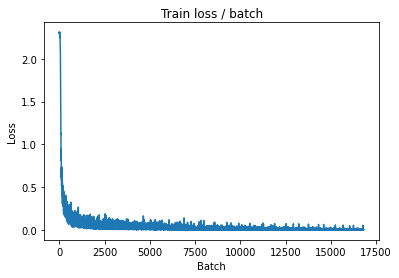


===============> Total time 11s	Avg loss 0.0029	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.0184 (0.0184)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0348	Avg Prec@1 98.92 %	Avg Prec@5 100.00 %



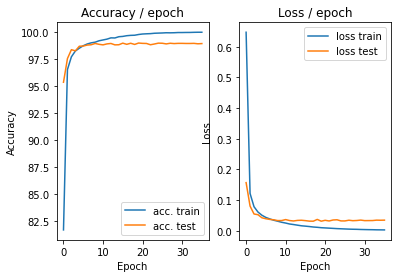

=== EPOCH 37 =====

[TRAIN Batch 000/469]	Time 0.187s (0.187s)	Loss 0.0031 (0.0031)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


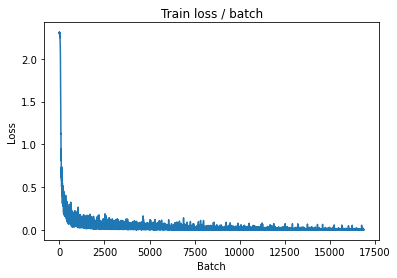

[TRAIN Batch 200/469]	Time 0.012s (0.024s)	Loss 0.0013 (0.0027)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


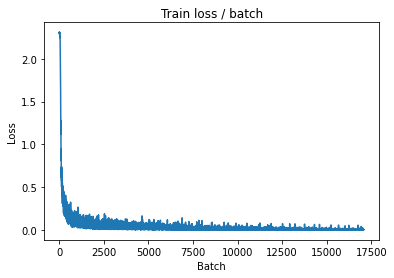

[TRAIN Batch 400/469]	Time 0.040s (0.024s)	Loss 0.0086 (0.0026)	Prec@1  99.2 (100.0)	Prec@5 100.0 (100.0)


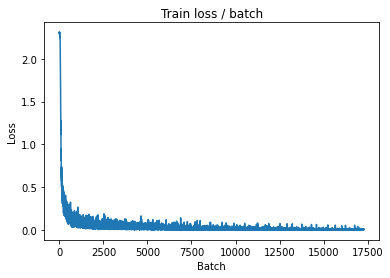


===============> Total time 11s	Avg loss 0.0027	Avg Prec@1 99.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.0134 (0.0134)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0343	Avg Prec@1 98.95 %	Avg Prec@5 100.00 %



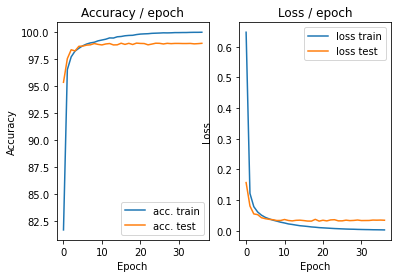

=== EPOCH 38 =====

[TRAIN Batch 000/469]	Time 0.185s (0.185s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


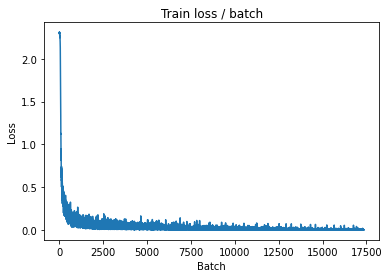

[TRAIN Batch 200/469]	Time 0.041s (0.026s)	Loss 0.0028 (0.0023)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


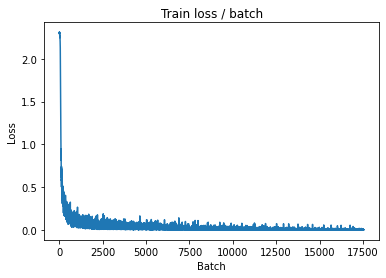

[TRAIN Batch 400/469]	Time 0.012s (0.024s)	Loss 0.0060 (0.0027)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


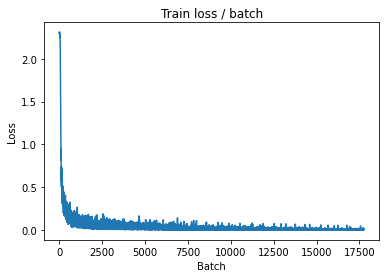


===============> Total time 11s	Avg loss 0.0026	Avg Prec@1 99.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.0142 (0.0142)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0348	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



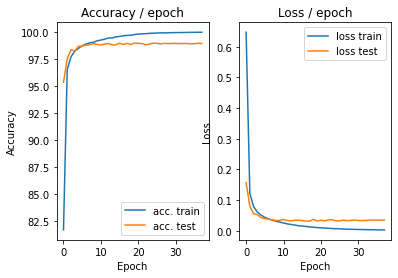

=== EPOCH 39 =====

[TRAIN Batch 000/469]	Time 0.175s (0.175s)	Loss 0.0016 (0.0016)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


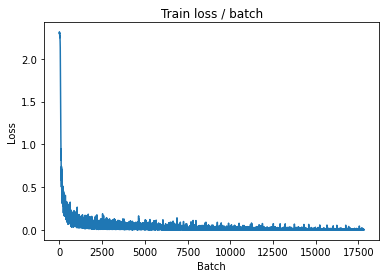

[TRAIN Batch 200/469]	Time 0.035s (0.024s)	Loss 0.0034 (0.0022)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


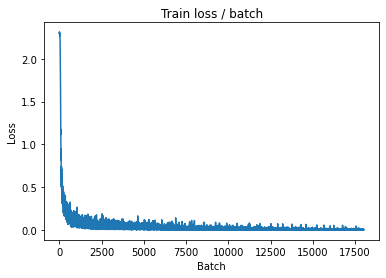

[TRAIN Batch 400/469]	Time 0.006s (0.024s)	Loss 0.0009 (0.0024)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


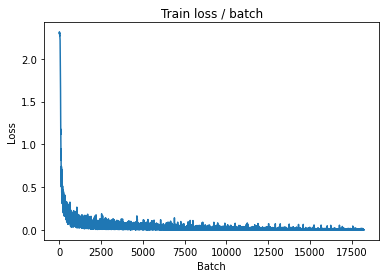


===============> Total time 11s	Avg loss 0.0024	Avg Prec@1 99.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.0191 (0.0191)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0348	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



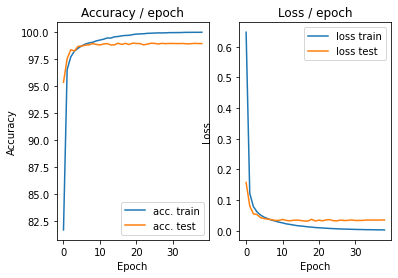

=== EPOCH 40 =====

[TRAIN Batch 000/469]	Time 0.189s (0.189s)	Loss 0.0022 (0.0022)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


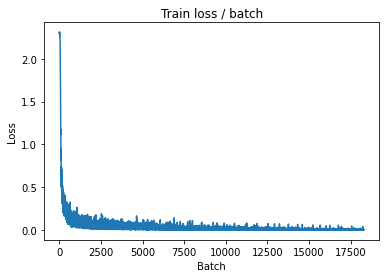

[TRAIN Batch 200/469]	Time 0.006s (0.024s)	Loss 0.0022 (0.0021)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


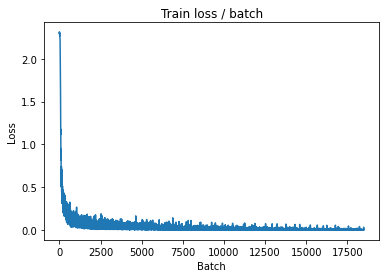

[TRAIN Batch 400/469]	Time 0.031s (0.024s)	Loss 0.0024 (0.0021)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


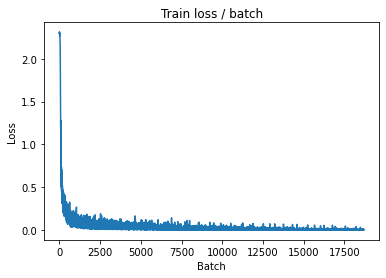


===============> Total time 11s	Avg loss 0.0022	Avg Prec@1 99.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.0215 (0.0215)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0354	Avg Prec@1 98.88 %	Avg Prec@5 100.00 %



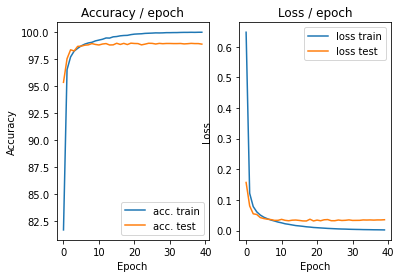

=== EPOCH 41 =====

[TRAIN Batch 000/469]	Time 0.196s (0.196s)	Loss 0.0033 (0.0033)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


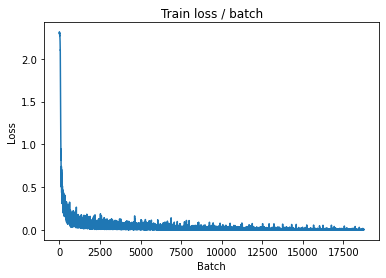

[TRAIN Batch 200/469]	Time 0.010s (0.025s)	Loss 0.0010 (0.0020)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


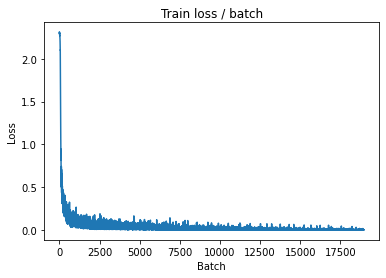

[TRAIN Batch 400/469]	Time 0.013s (0.024s)	Loss 0.0052 (0.0021)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


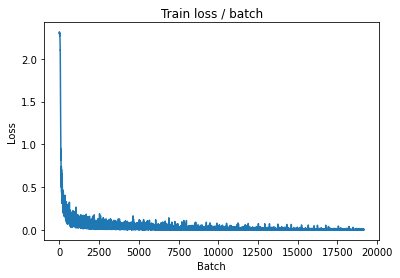


===============> Total time 11s	Avg loss 0.0021	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.0162 (0.0162)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0363	Avg Prec@1 98.92 %	Avg Prec@5 100.00 %



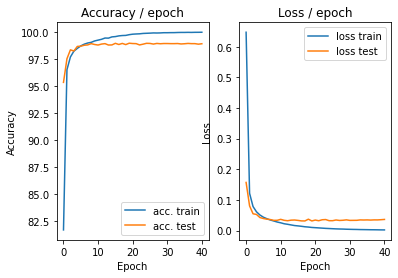

=== EPOCH 42 =====

[TRAIN Batch 000/469]	Time 0.202s (0.202s)	Loss 0.0013 (0.0013)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


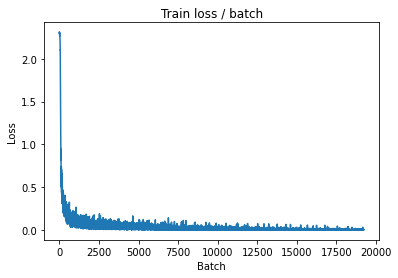

[TRAIN Batch 200/469]	Time 0.008s (0.024s)	Loss 0.0010 (0.0017)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


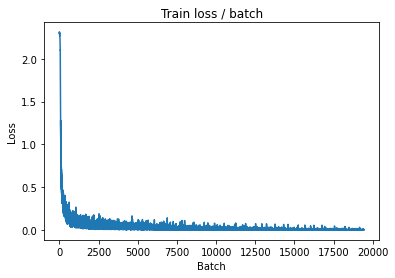

[TRAIN Batch 400/469]	Time 0.008s (0.024s)	Loss 0.0006 (0.0020)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


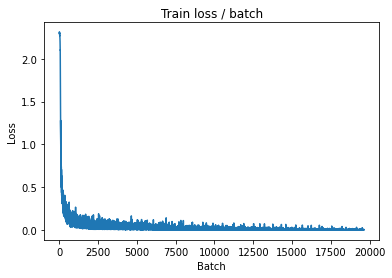


===============> Total time 11s	Avg loss 0.0020	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.0178 (0.0178)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0371	Avg Prec@1 98.90 %	Avg Prec@5 100.00 %



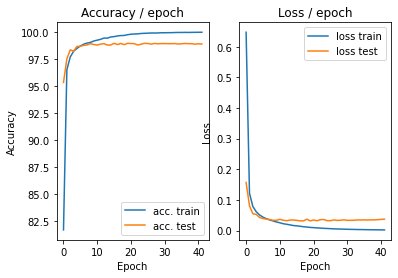

=== EPOCH 43 =====

[TRAIN Batch 000/469]	Time 0.195s (0.195s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


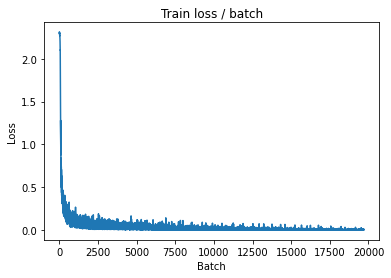

[TRAIN Batch 200/469]	Time 0.040s (0.025s)	Loss 0.0027 (0.0019)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


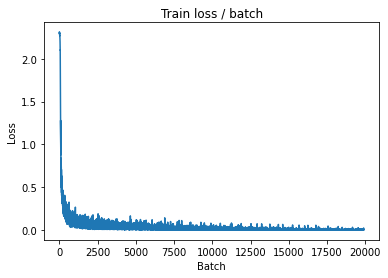

[TRAIN Batch 400/469]	Time 0.006s (0.024s)	Loss 0.0019 (0.0019)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


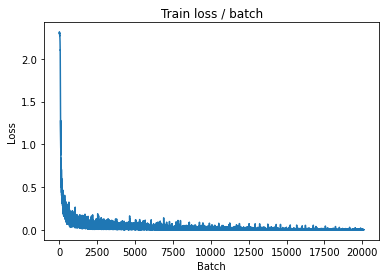


===============> Total time 11s	Avg loss 0.0019	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.0162 (0.0162)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0352	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



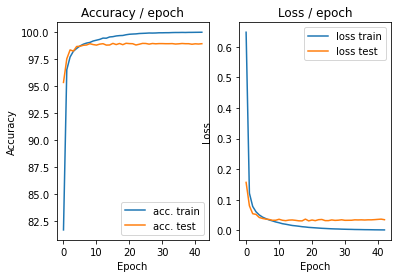

=== EPOCH 44 =====

[TRAIN Batch 000/469]	Time 0.196s (0.196s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


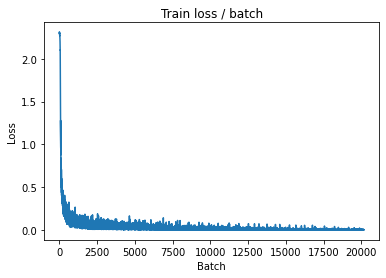

[TRAIN Batch 200/469]	Time 0.040s (0.026s)	Loss 0.0096 (0.0019)	Prec@1  99.2 (100.0)	Prec@5 100.0 (100.0)


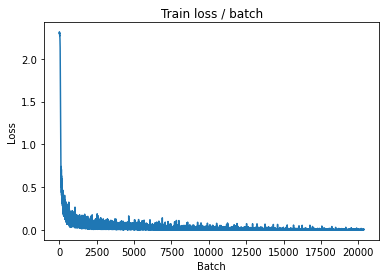

[TRAIN Batch 400/469]	Time 0.040s (0.025s)	Loss 0.0007 (0.0018)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


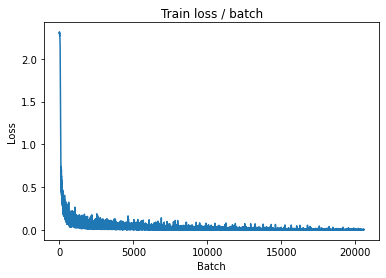


===============> Total time 11s	Avg loss 0.0018	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.0141 (0.0141)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0360	Avg Prec@1 98.92 %	Avg Prec@5 100.00 %



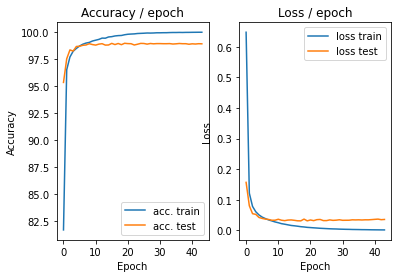

=== EPOCH 45 =====

[TRAIN Batch 000/469]	Time 0.186s (0.186s)	Loss 0.0015 (0.0015)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


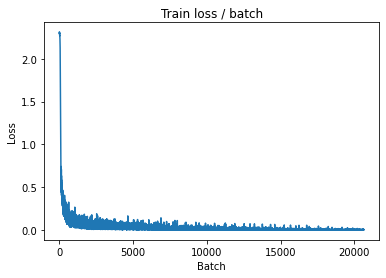

[TRAIN Batch 200/469]	Time 0.025s (0.024s)	Loss 0.0005 (0.0017)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


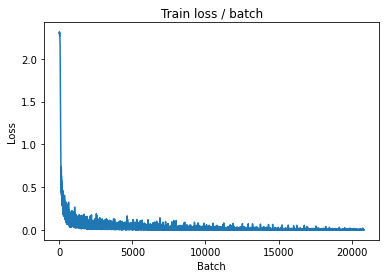

[TRAIN Batch 400/469]	Time 0.013s (0.024s)	Loss 0.0022 (0.0017)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


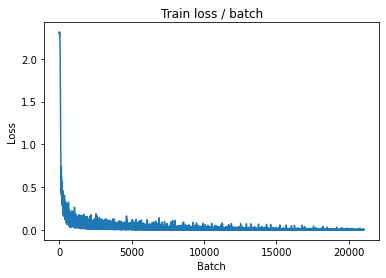


===============> Total time 11s	Avg loss 0.0017	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.0209 (0.0209)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0361	Avg Prec@1 98.93 %	Avg Prec@5 99.99 %



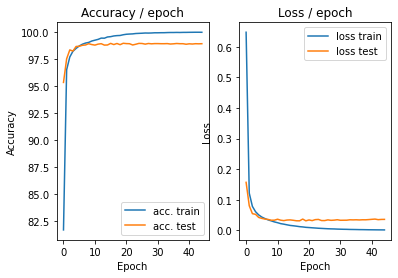

=== EPOCH 46 =====

[TRAIN Batch 000/469]	Time 0.187s (0.187s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


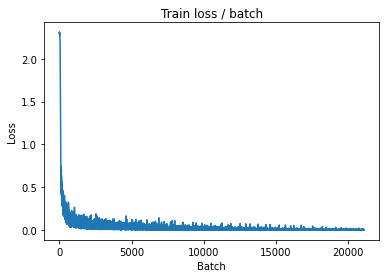

[TRAIN Batch 200/469]	Time 0.010s (0.024s)	Loss 0.0006 (0.0015)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


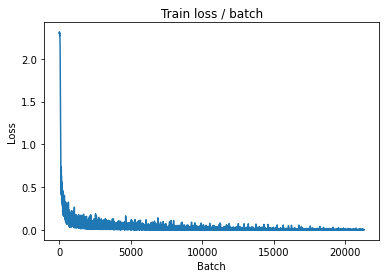

[TRAIN Batch 400/469]	Time 0.050s (0.024s)	Loss 0.0035 (0.0016)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


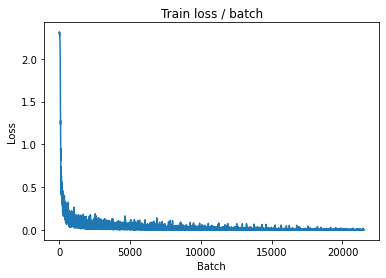


===============> Total time 11s	Avg loss 0.0016	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.0111 (0.0111)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0362	Avg Prec@1 98.94 %	Avg Prec@5 100.00 %



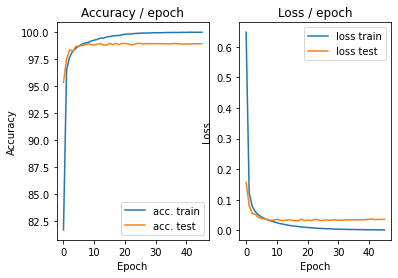

=== EPOCH 47 =====

[TRAIN Batch 000/469]	Time 0.182s (0.182s)	Loss 0.0024 (0.0024)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


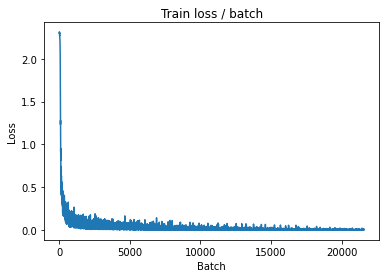

[TRAIN Batch 200/469]	Time 0.006s (0.025s)	Loss 0.0009 (0.0014)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


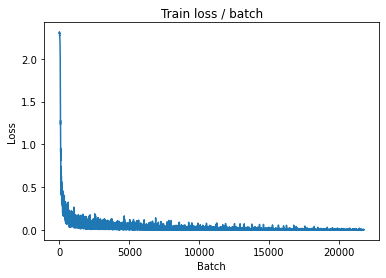

[TRAIN Batch 400/469]	Time 0.011s (0.024s)	Loss 0.0007 (0.0015)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


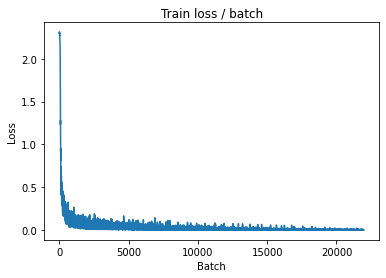


===============> Total time 11s	Avg loss 0.0015	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.0247 (0.0247)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0372	Avg Prec@1 98.86 %	Avg Prec@5 100.00 %



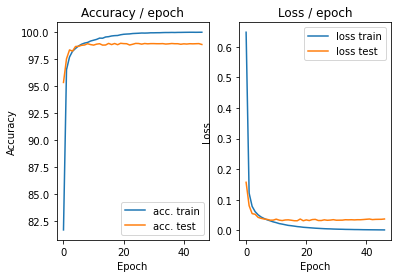

=== EPOCH 48 =====

[TRAIN Batch 000/469]	Time 0.202s (0.202s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


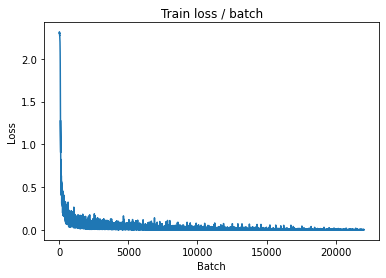

[TRAIN Batch 200/469]	Time 0.041s (0.024s)	Loss 0.0028 (0.0014)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


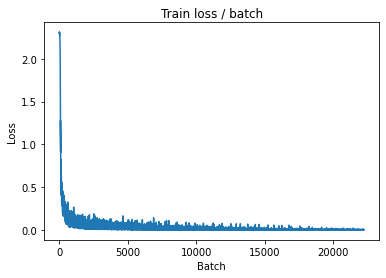

[TRAIN Batch 400/469]	Time 0.006s (0.024s)	Loss 0.0009 (0.0014)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


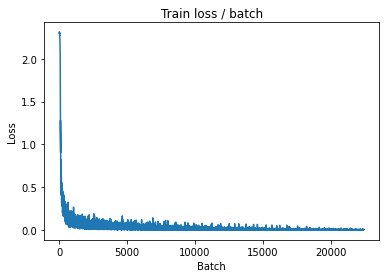


===============> Total time 11s	Avg loss 0.0015	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.0199 (0.0199)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0361	Avg Prec@1 98.92 %	Avg Prec@5 100.00 %



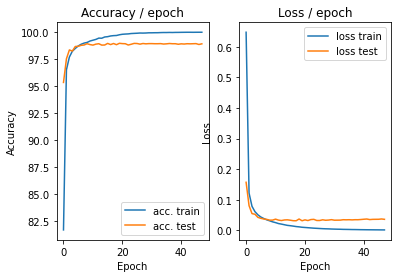

=== EPOCH 49 =====

[TRAIN Batch 000/469]	Time 0.191s (0.191s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


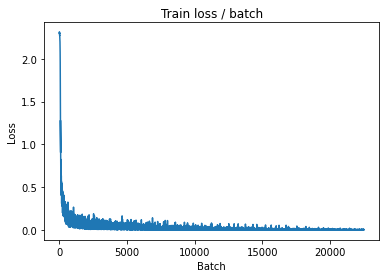

[TRAIN Batch 200/469]	Time 0.039s (0.024s)	Loss 0.0009 (0.0013)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


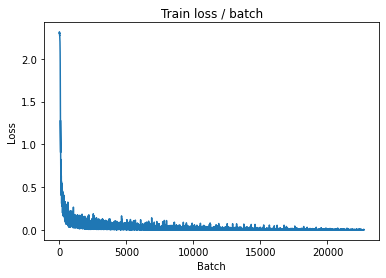

[TRAIN Batch 400/469]	Time 0.042s (0.024s)	Loss 0.0043 (0.0014)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


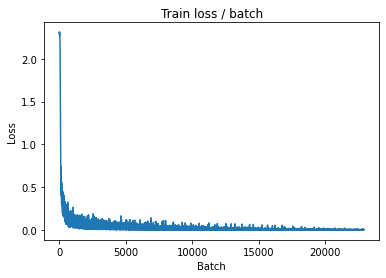


===============> Total time 11s	Avg loss 0.0014	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.0176 (0.0176)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0367	Avg Prec@1 98.91 %	Avg Prec@5 100.00 %



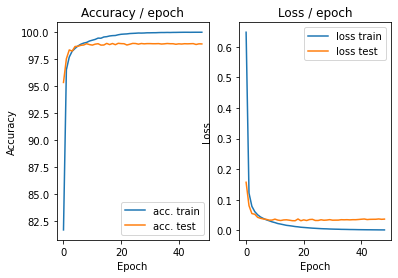

=== EPOCH 50 =====

[TRAIN Batch 000/469]	Time 0.162s (0.162s)	Loss 0.0011 (0.0011)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


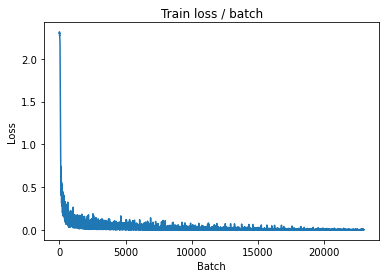

[TRAIN Batch 200/469]	Time 0.010s (0.024s)	Loss 0.0018 (0.0012)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


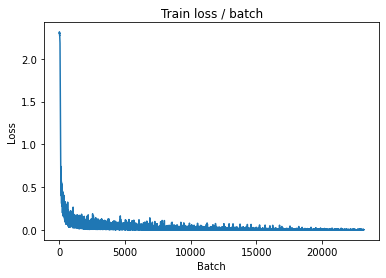

[TRAIN Batch 400/469]	Time 0.040s (0.024s)	Loss 0.0009 (0.0013)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


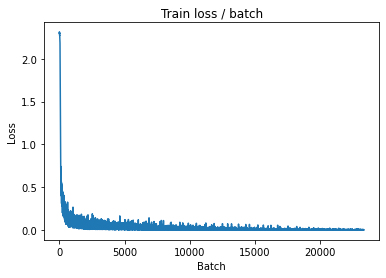


===============> Total time 11s	Avg loss 0.0013	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.0184 (0.0184)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0366	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %



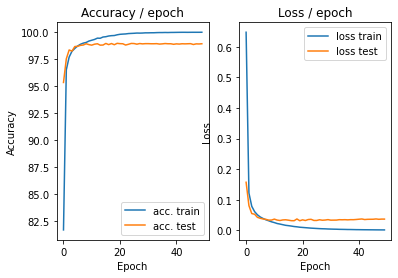

In [ ]:
main(128, 0.1,epochs=50, cuda=True)

##CNN ON CIFAR :

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====



/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[TRAIN Batch 000/391]	Time 0.761s (0.761s)	Loss 2.3026 (2.3026)	Prec@1   7.0 (  7.0)	Prec@5  51.6 ( 51.6)


<Figure size 432x288 with 0 Axes>

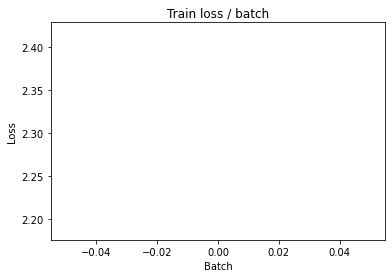

[TRAIN Batch 200/391]	Time 0.049s (0.034s)	Loss 2.0980 (2.2255)	Prec@1  24.2 ( 16.5)	Prec@5  70.3 ( 63.8)


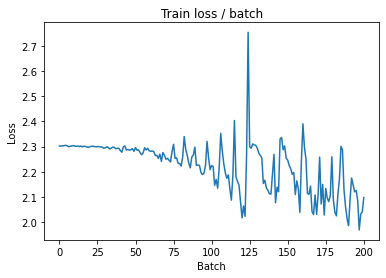


===============> Total time 12s	Avg loss 2.1122	Avg Prec@1 22.17 %	Avg Prec@5 70.98 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 2.2028 (2.2028)	Prec@1  26.6 ( 26.6)	Prec@5  69.5 ( 69.5)

===============> Total time 2s	Avg loss 2.1982	Avg Prec@1 21.93 %	Avg Prec@5 71.28 %



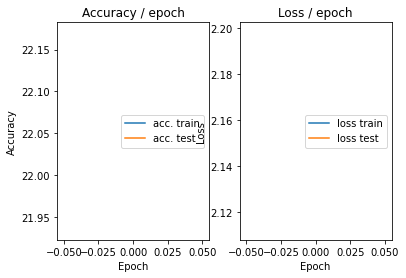

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 2.2129 (2.2129)	Prec@1  19.5 ( 19.5)	Prec@5  68.0 ( 68.0)


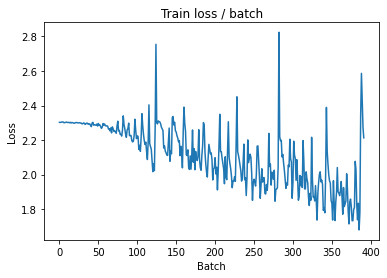

[TRAIN Batch 200/391]	Time 0.019s (0.031s)	Loss 1.5718 (1.7622)	Prec@1  41.4 ( 37.0)	Prec@5  89.1 ( 86.0)


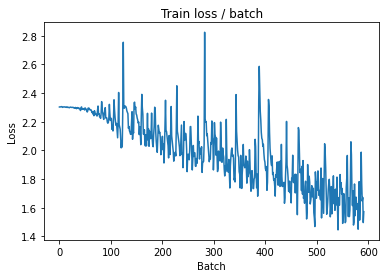


===============> Total time 11s	Avg loss 1.6631	Avg Prec@1 40.31 %	Avg Prec@5 88.21 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 1.3867 (1.3867)	Prec@1  53.9 ( 53.9)	Prec@5  90.6 ( 90.6)

===============> Total time 2s	Avg loss 1.4964	Avg Prec@1 44.52 %	Avg Prec@5 91.97 %



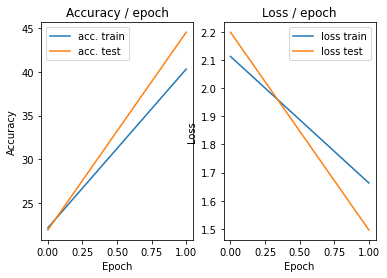

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 1.5375 (1.5375)	Prec@1  44.5 ( 44.5)	Prec@5  91.4 ( 91.4)


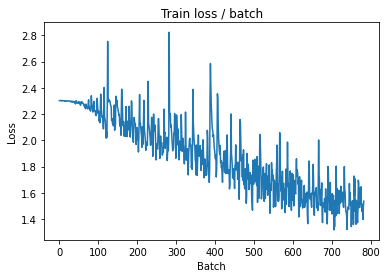

[TRAIN Batch 200/391]	Time 0.024s (0.031s)	Loss 1.2803 (1.4394)	Prec@1  51.6 ( 48.3)	Prec@5  96.1 ( 92.5)


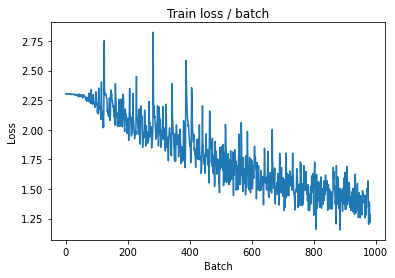


===============> Total time 11s	Avg loss 1.4039	Avg Prec@1 49.76 %	Avg Prec@5 92.88 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 1.1799 (1.1799)	Prec@1  57.8 ( 57.8)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.3413	Avg Prec@1 51.34 %	Avg Prec@5 93.45 %



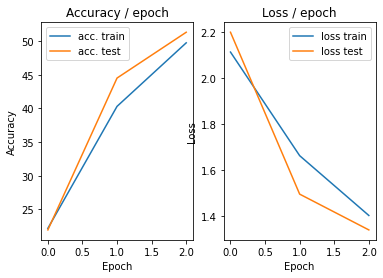

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 1.3333 (1.3333)	Prec@1  57.0 ( 57.0)	Prec@5  92.2 ( 92.2)


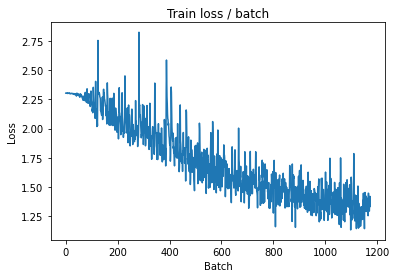

[TRAIN Batch 200/391]	Time 0.015s (0.030s)	Loss 1.1353 (1.2775)	Prec@1  61.7 ( 54.8)	Prec@5  98.4 ( 94.3)


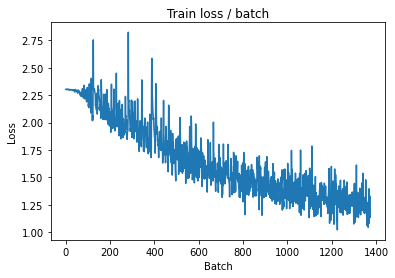


===============> Total time 11s	Avg loss 1.2453	Avg Prec@1 55.79 %	Avg Prec@5 94.73 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.0983 (1.0983)	Prec@1  69.5 ( 69.5)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.2033	Avg Prec@1 56.52 %	Avg Prec@5 95.22 %



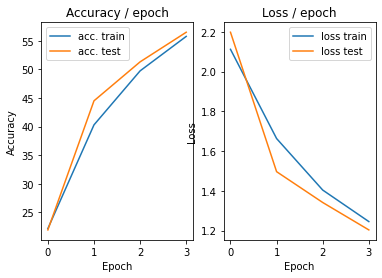

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.165s (0.165s)	Loss 1.2991 (1.2991)	Prec@1  53.9 ( 53.9)	Prec@5  93.8 ( 93.8)


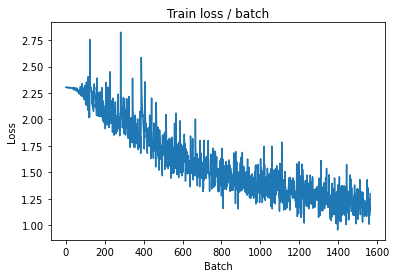

[TRAIN Batch 200/391]	Time 0.040s (0.032s)	Loss 1.0017 (1.1227)	Prec@1  74.2 ( 60.2)	Prec@5  96.1 ( 96.0)


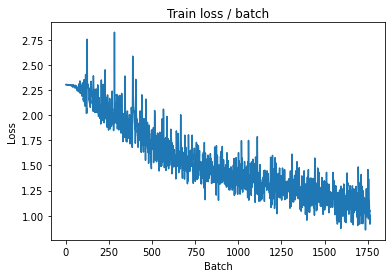


===============> Total time 12s	Avg loss 1.1015	Avg Prec@1 61.12 %	Avg Prec@5 95.98 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.9670 (0.9670)	Prec@1  68.8 ( 68.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.0905	Avg Prec@1 60.71 %	Avg Prec@5 96.27 %



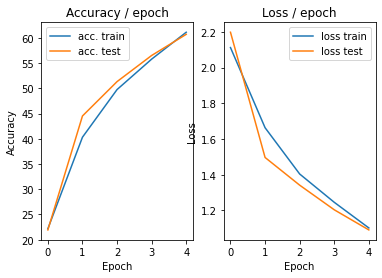

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 1.0423 (1.0423)	Prec@1  60.2 ( 60.2)	Prec@5  98.4 ( 98.4)


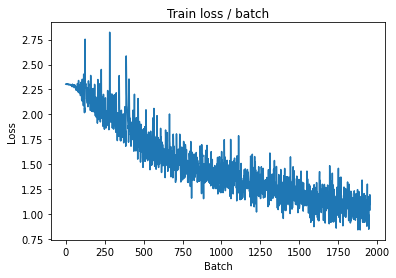

[TRAIN Batch 200/391]	Time 0.027s (0.031s)	Loss 0.9915 (0.9914)	Prec@1  61.7 ( 65.1)	Prec@5  98.4 ( 97.0)


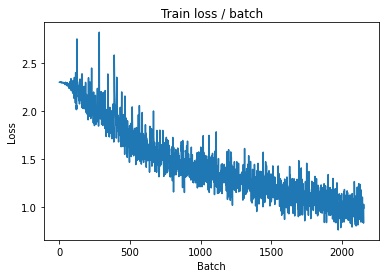


===============> Total time 11s	Avg loss 0.9808	Avg Prec@1 65.45 %	Avg Prec@5 97.03 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.7806 (0.7806)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.9837	Avg Prec@1 64.72 %	Avg Prec@5 96.87 %



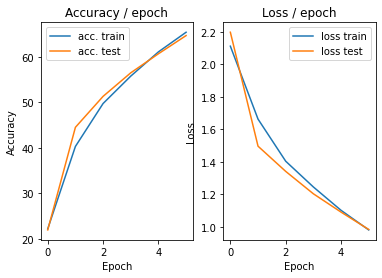

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.8121 (0.8121)	Prec@1  70.3 ( 70.3)	Prec@5  99.2 ( 99.2)


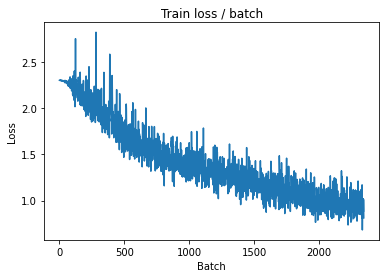

[TRAIN Batch 200/391]	Time 0.026s (0.031s)	Loss 0.5674 (0.8751)	Prec@1  80.5 ( 69.6)	Prec@5  99.2 ( 97.6)


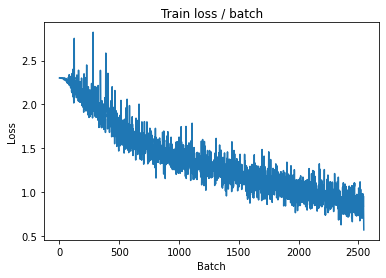


===============> Total time 11s	Avg loss 0.8671	Avg Prec@1 69.84 %	Avg Prec@5 97.65 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.7662 (0.7662)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9431	Avg Prec@1 66.56 %	Avg Prec@5 96.99 %



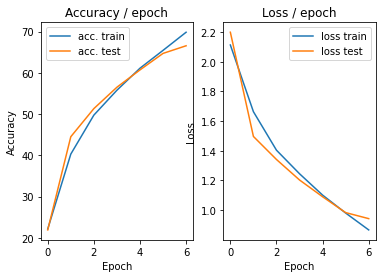

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 0.6423 (0.6423)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


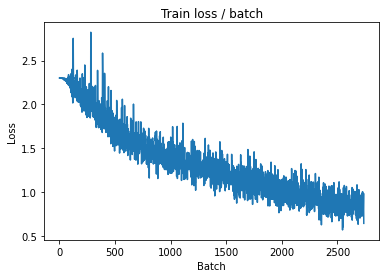

[TRAIN Batch 200/391]	Time 0.023s (0.030s)	Loss 0.9519 (0.7821)	Prec@1  66.4 ( 72.8)	Prec@5  97.7 ( 98.1)


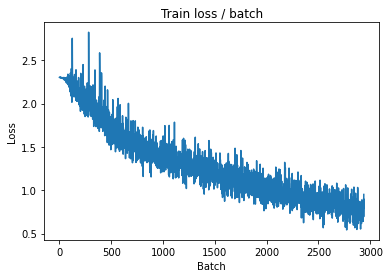


===============> Total time 11s	Avg loss 0.7718	Avg Prec@1 72.81 %	Avg Prec@5 98.19 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.8467 (0.8467)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9506	Avg Prec@1 67.64 %	Avg Prec@5 96.90 %



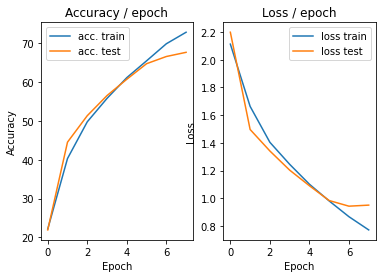

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.7819 (0.7819)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


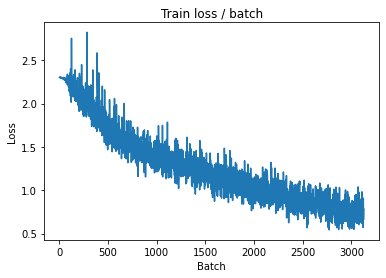

[TRAIN Batch 200/391]	Time 0.030s (0.031s)	Loss 0.5133 (0.6762)	Prec@1  83.6 ( 76.5)	Prec@5  97.7 ( 98.7)


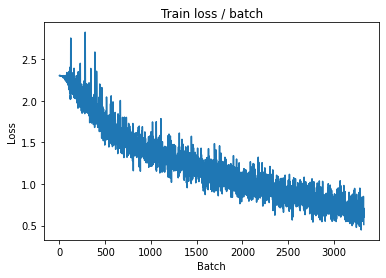


===============> Total time 11s	Avg loss 0.6787	Avg Prec@1 76.25 %	Avg Prec@5 98.69 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.7750 (0.7750)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9083	Avg Prec@1 68.63 %	Avg Prec@5 97.34 %



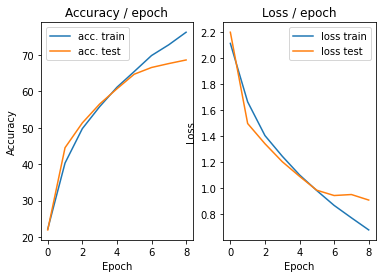

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.5394 (0.5394)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


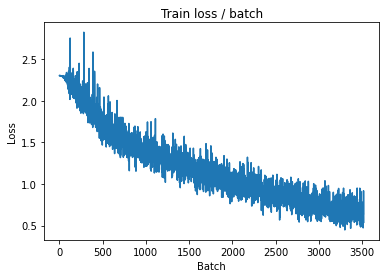

[TRAIN Batch 200/391]	Time 0.024s (0.030s)	Loss 0.4748 (0.5802)	Prec@1  82.0 ( 79.8)	Prec@5  98.4 ( 99.1)


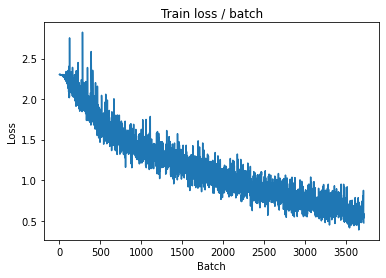


===============> Total time 11s	Avg loss 0.5861	Avg Prec@1 79.51 %	Avg Prec@5 99.11 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.9299 (0.9299)	Prec@1  73.4 ( 73.4)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 0.9819	Avg Prec@1 68.14 %	Avg Prec@5 96.88 %



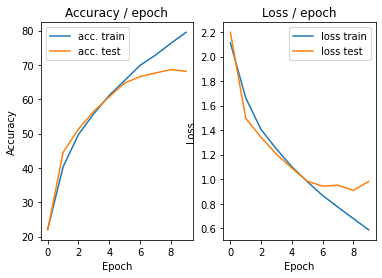

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.5200 (0.5200)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


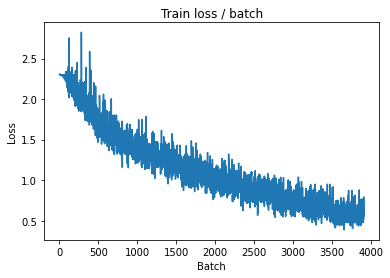

[TRAIN Batch 200/391]	Time 0.018s (0.030s)	Loss 0.6473 (0.4830)	Prec@1  77.3 ( 83.4)	Prec@5  98.4 ( 99.4)


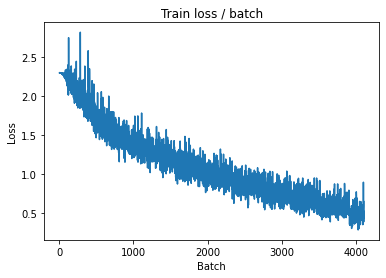


===============> Total time 11s	Avg loss 0.4940	Avg Prec@1 82.82 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.8717 (0.8717)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9748	Avg Prec@1 69.41 %	Avg Prec@5 97.12 %



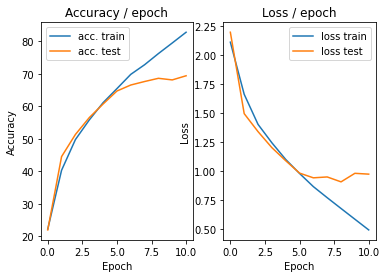

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 0.4278 (0.4278)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


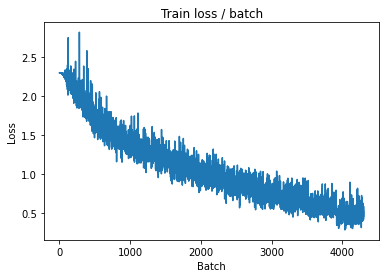

[TRAIN Batch 200/391]	Time 0.024s (0.032s)	Loss 0.4702 (0.3862)	Prec@1  84.4 ( 86.8)	Prec@5  97.7 ( 99.7)


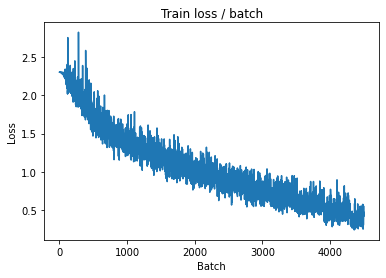


===============> Total time 11s	Avg loss 0.4055	Avg Prec@1 85.95 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.9384 (0.9384)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9450	Avg Prec@1 70.34 %	Avg Prec@5 97.44 %



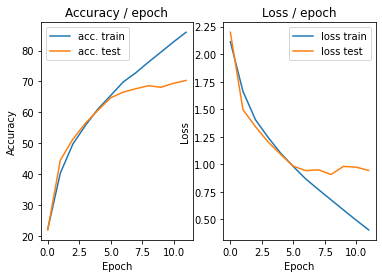

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.2356 (0.2356)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


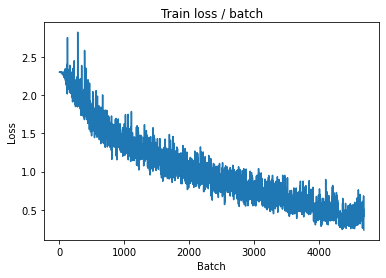

[TRAIN Batch 200/391]	Time 0.047s (0.031s)	Loss 0.4098 (0.2904)	Prec@1  85.2 ( 89.9)	Prec@5 100.0 ( 99.8)


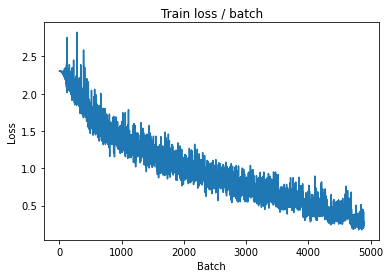


===============> Total time 11s	Avg loss 0.3146	Avg Prec@1 88.99 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.0935 (1.0935)	Prec@1  69.5 ( 69.5)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1083	Avg Prec@1 68.11 %	Avg Prec@5 97.34 %



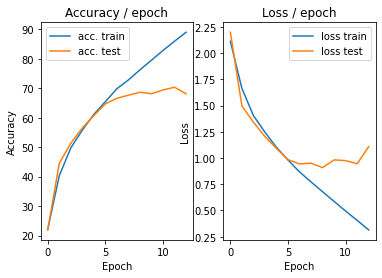

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.2380 (0.2380)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


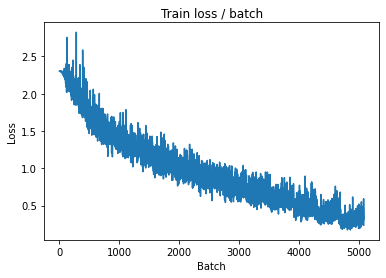

[TRAIN Batch 200/391]	Time 0.057s (0.031s)	Loss 0.2025 (0.2085)	Prec@1  92.2 ( 92.9)	Prec@5 100.0 ( 99.9)


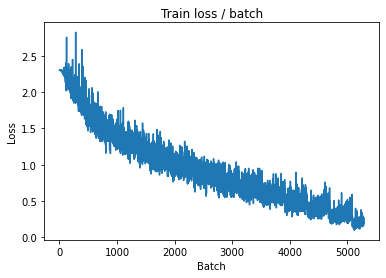


===============> Total time 11s	Avg loss 0.2390	Avg Prec@1 91.80 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.0315 (1.0315)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.2030	Avg Prec@1 68.45 %	Avg Prec@5 97.28 %



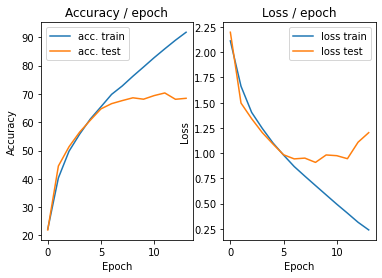

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.3008 (0.3008)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


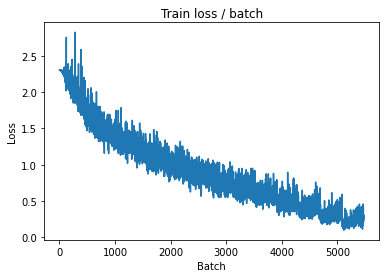

[TRAIN Batch 200/391]	Time 0.037s (0.030s)	Loss 0.1222 (0.1508)	Prec@1  93.0 ( 95.0)	Prec@5 100.0 (100.0)


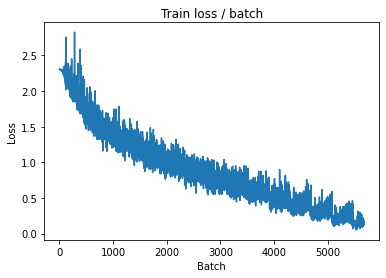


===============> Total time 11s	Avg loss 0.1955	Avg Prec@1 93.57 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.4379 (1.4379)	Prec@1  67.2 ( 67.2)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.2432	Avg Prec@1 69.91 %	Avg Prec@5 97.34 %



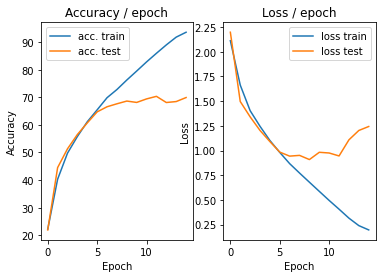

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 0.1287 (0.1287)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


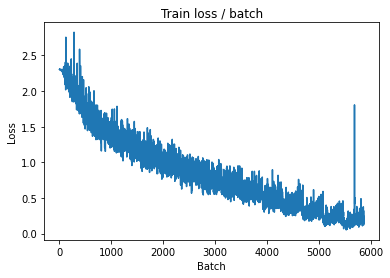

[TRAIN Batch 200/391]	Time 0.019s (0.032s)	Loss 0.0994 (0.1030)	Prec@1  97.7 ( 96.8)	Prec@5 100.0 (100.0)


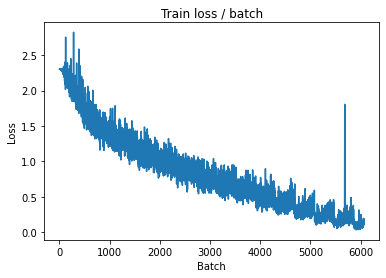


===============> Total time 12s	Avg loss 0.1201	Avg Prec@1 96.05 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 1.3602 (1.3602)	Prec@1  73.4 ( 73.4)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.3186	Avg Prec@1 70.58 %	Avg Prec@5 97.32 %



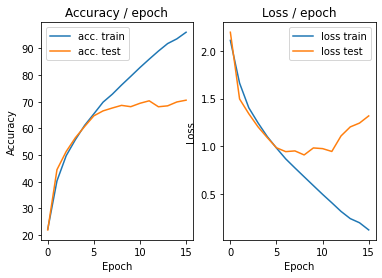

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.1099 (0.1099)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


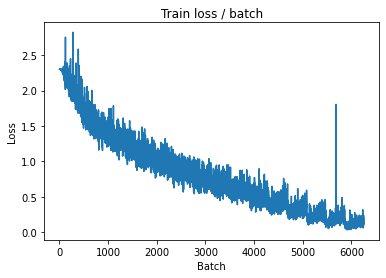

[TRAIN Batch 200/391]	Time 0.030s (0.031s)	Loss 0.1126 (0.0714)	Prec@1  97.7 ( 97.8)	Prec@5  99.2 (100.0)


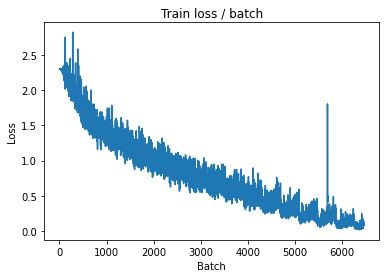


===============> Total time 11s	Avg loss 0.0808	Avg Prec@1 97.49 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 1.5496 (1.5496)	Prec@1  68.8 ( 68.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.4058	Avg Prec@1 70.51 %	Avg Prec@5 96.95 %



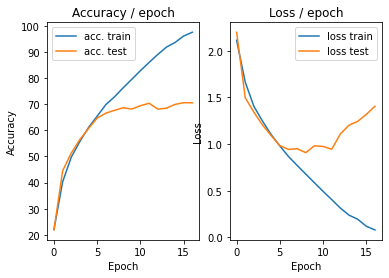

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.0540 (0.0540)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


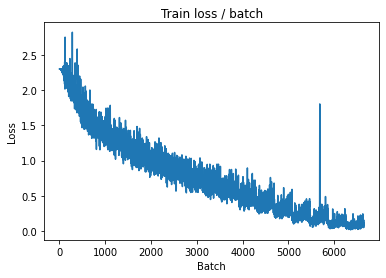

[TRAIN Batch 200/391]	Time 0.015s (0.031s)	Loss 0.0537 (0.0564)	Prec@1  98.4 ( 98.3)	Prec@5 100.0 (100.0)


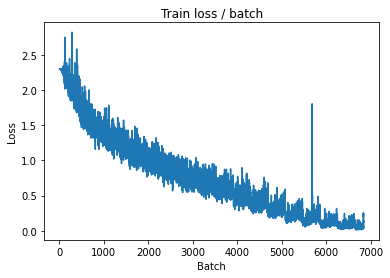


===============> Total time 11s	Avg loss 0.0839	Avg Prec@1 97.53 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.3327 (1.3327)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.5214	Avg Prec@1 69.16 %	Avg Prec@5 97.16 %



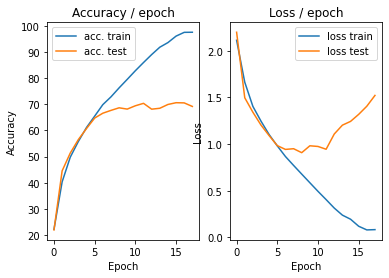

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.0889 (0.0889)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


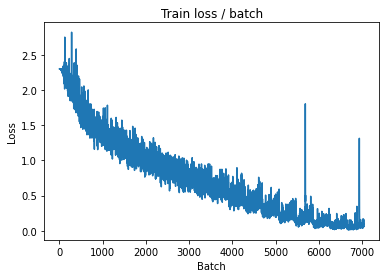

[TRAIN Batch 200/391]	Time 0.042s (0.030s)	Loss 0.0088 (0.0280)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


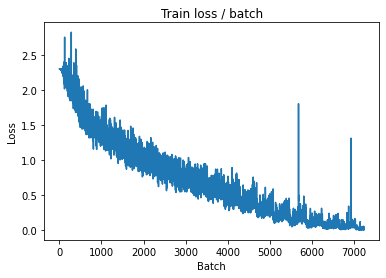


===============> Total time 11s	Avg loss 0.0355	Avg Prec@1 98.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 1.4434 (1.4434)	Prec@1  78.1 ( 78.1)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.6059	Avg Prec@1 71.14 %	Avg Prec@5 97.24 %



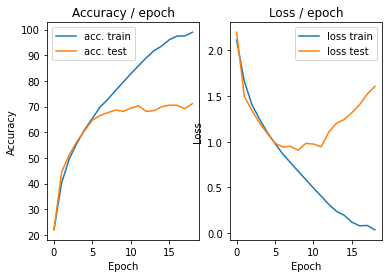

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.0218 (0.0218)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


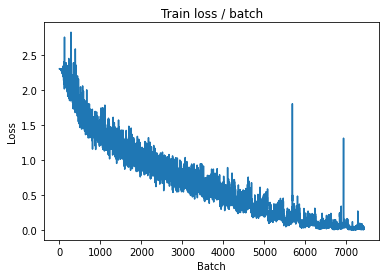

[TRAIN Batch 200/391]	Time 0.029s (0.031s)	Loss 0.0082 (0.0108)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


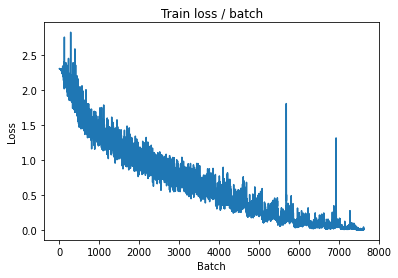


===============> Total time 11s	Avg loss 0.0110	Avg Prec@1 99.78 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.6899 (1.6899)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.7403	Avg Prec@1 71.44 %	Avg Prec@5 97.39 %



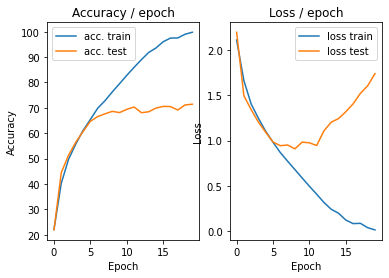

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0114 (0.0114)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


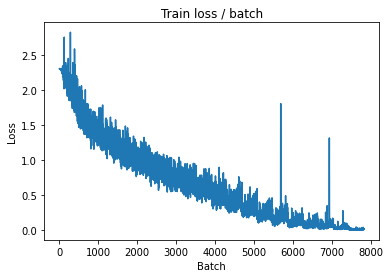

[TRAIN Batch 200/391]	Time 0.024s (0.031s)	Loss 0.0069 (0.0150)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


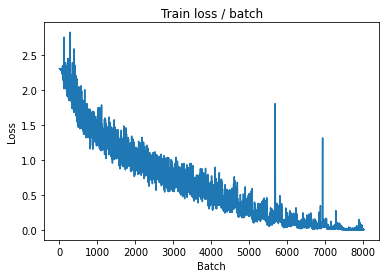


===============> Total time 11s	Avg loss 0.0137	Avg Prec@1 99.69 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.8345 (1.8345)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.8760	Avg Prec@1 71.14 %	Avg Prec@5 97.32 %



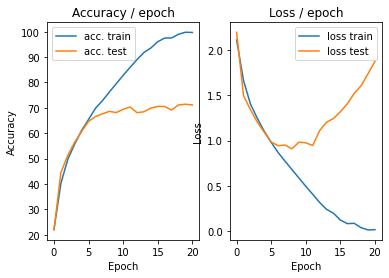

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.0193 (0.0193)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


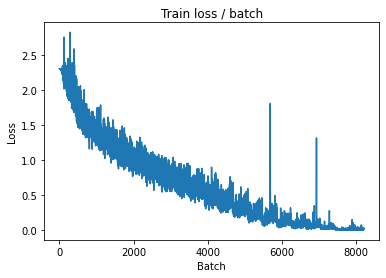

[TRAIN Batch 200/391]	Time 0.019s (0.030s)	Loss 0.0123 (0.0078)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


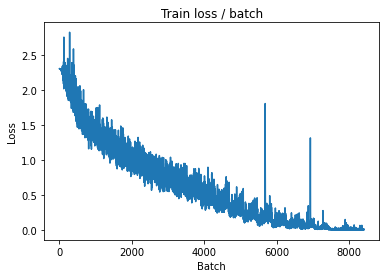


===============> Total time 11s	Avg loss 0.0063	Avg Prec@1 99.88 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 1.6757 (1.6757)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.8535	Avg Prec@1 72.02 %	Avg Prec@5 97.38 %



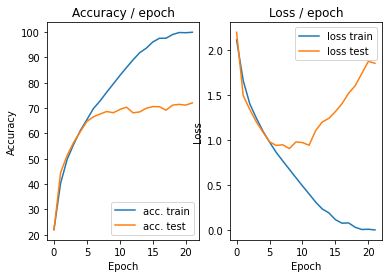

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.0025 (0.0025)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


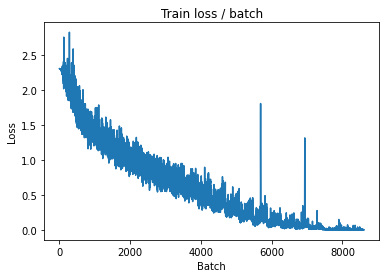

[TRAIN Batch 200/391]	Time 0.047s (0.030s)	Loss 0.0060 (0.0031)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


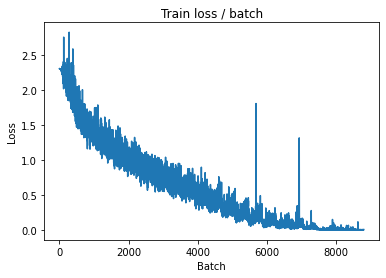


===============> Total time 11s	Avg loss 0.0033	Avg Prec@1 99.95 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 1.7932 (1.7932)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.9314	Avg Prec@1 71.46 %	Avg Prec@5 97.25 %



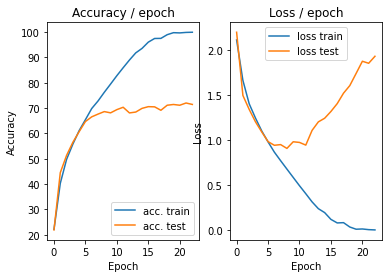

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.0041 (0.0041)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


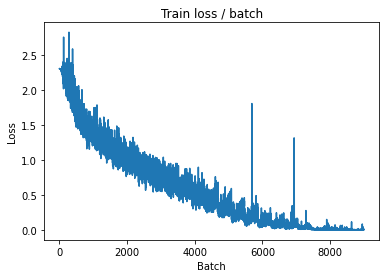

[TRAIN Batch 200/391]	Time 0.019s (0.030s)	Loss 0.0012 (0.0021)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


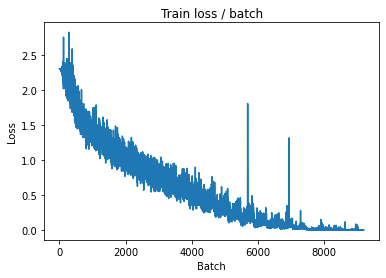


===============> Total time 11s	Avg loss 0.0015	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.8348 (1.8348)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.9454	Avg Prec@1 72.30 %	Avg Prec@5 97.54 %



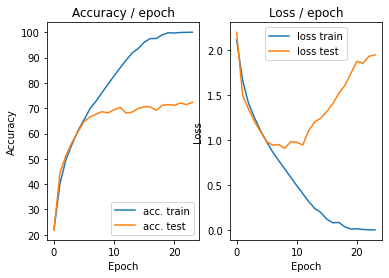

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


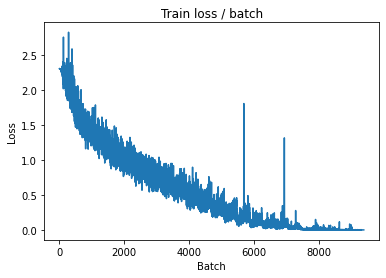

[TRAIN Batch 200/391]	Time 0.018s (0.030s)	Loss 0.0003 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


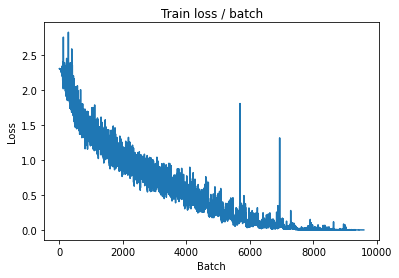


===============> Total time 11s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.8839 (1.8839)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.9956	Avg Prec@1 72.44 %	Avg Prec@5 97.50 %



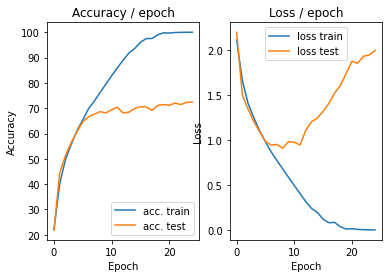

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


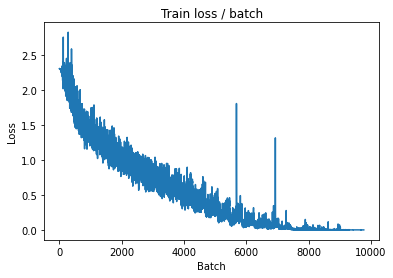

[TRAIN Batch 200/391]	Time 0.031s (0.031s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


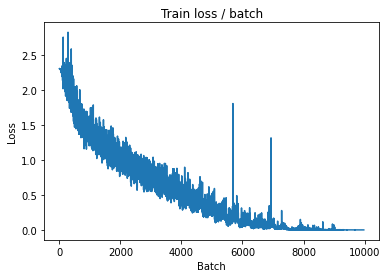


===============> Total time 11s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.9144 (1.9144)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.0339	Avg Prec@1 72.64 %	Avg Prec@5 97.52 %



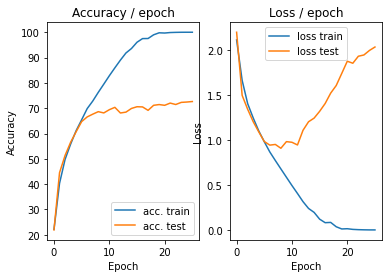

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


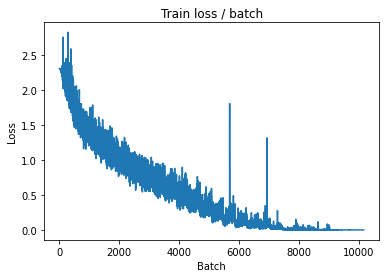

[TRAIN Batch 200/391]	Time 0.027s (0.032s)	Loss 0.0002 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


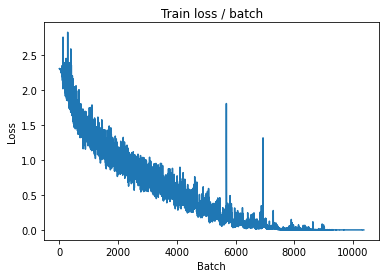


===============> Total time 12s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 1.9528 (1.9528)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.0684	Avg Prec@1 72.39 %	Avg Prec@5 97.53 %



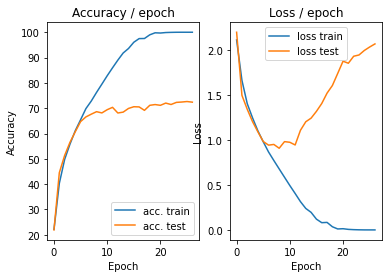

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


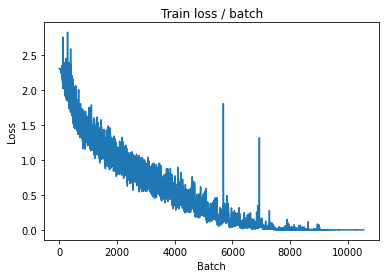

[TRAIN Batch 200/391]	Time 0.037s (0.030s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


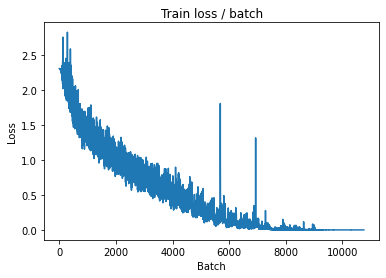


===============> Total time 11s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.9829 (1.9829)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.0944	Avg Prec@1 72.51 %	Avg Prec@5 97.53 %



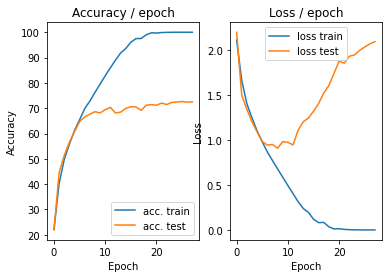

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


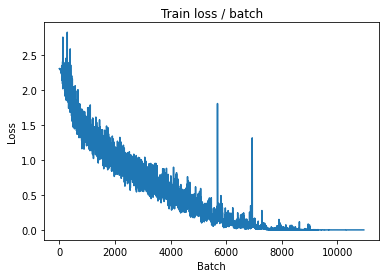

[TRAIN Batch 200/391]	Time 0.051s (0.031s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


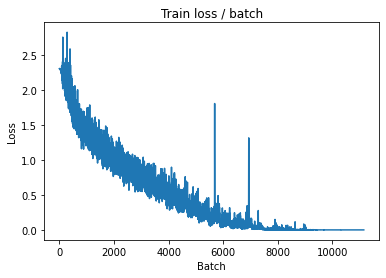


===============> Total time 11s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 2.0090 (2.0090)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1178	Avg Prec@1 72.48 %	Avg Prec@5 97.53 %



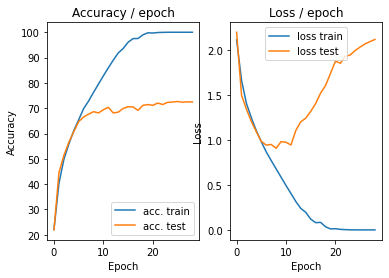

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


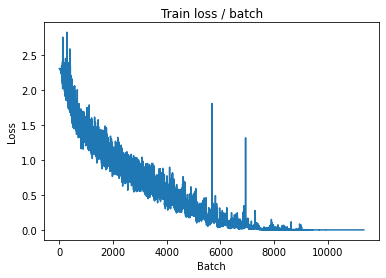

[TRAIN Batch 200/391]	Time 0.018s (0.031s)	Loss 0.0003 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


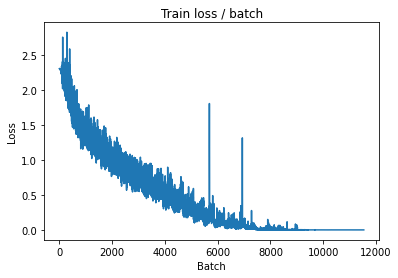


===============> Total time 11s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 2.0222 (2.0222)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1376	Avg Prec@1 72.45 %	Avg Prec@5 97.52 %



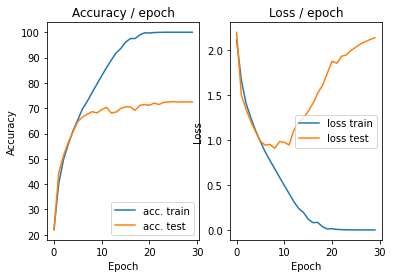

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


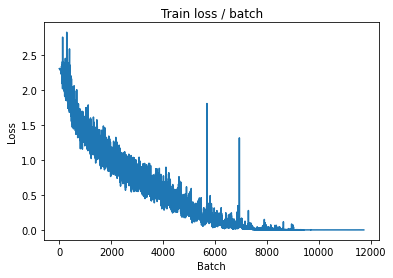

[TRAIN Batch 200/391]	Time 0.019s (0.032s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


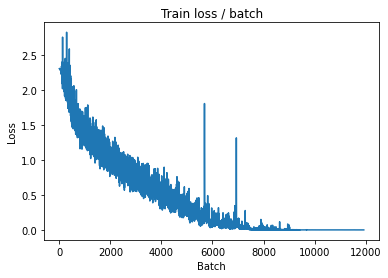


===============> Total time 12s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 2.0499 (2.0499)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1565	Avg Prec@1 72.44 %	Avg Prec@5 97.52 %



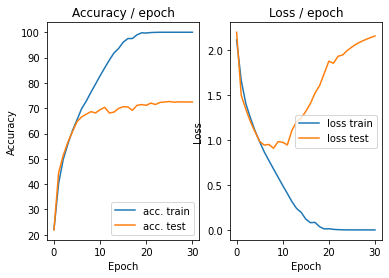

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


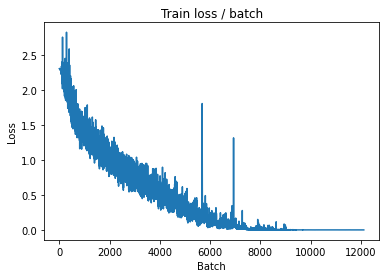

[TRAIN Batch 200/391]	Time 0.019s (0.031s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


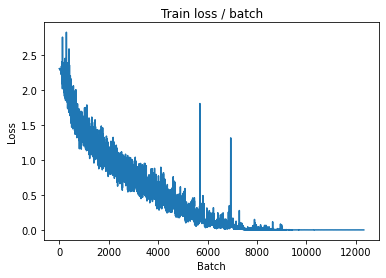


===============> Total time 11s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 2.0736 (2.0736)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1753	Avg Prec@1 72.42 %	Avg Prec@5 97.52 %



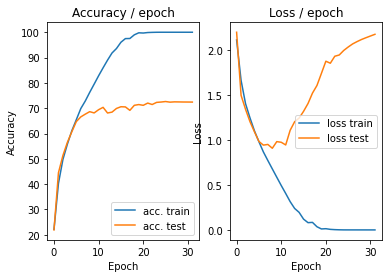

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


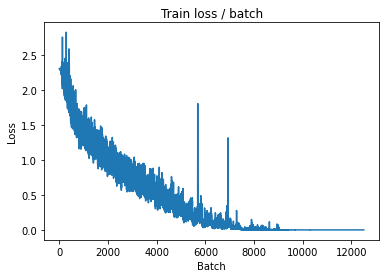

[TRAIN Batch 200/391]	Time 0.043s (0.030s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


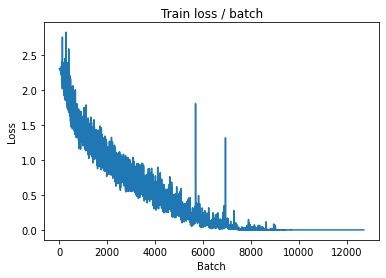


===============> Total time 11s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 2.0933 (2.0933)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1901	Avg Prec@1 72.56 %	Avg Prec@5 97.49 %



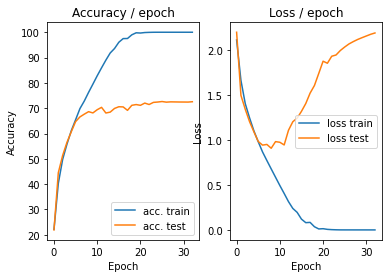

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


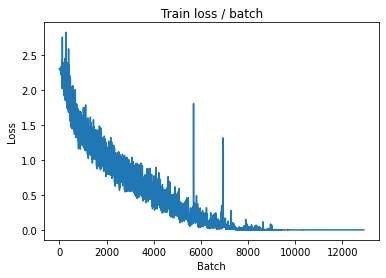

[TRAIN Batch 200/391]	Time 0.016s (0.031s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


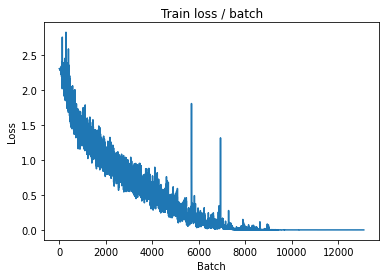


===============> Total time 11s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 2.1047 (2.1047)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2058	Avg Prec@1 72.55 %	Avg Prec@5 97.51 %



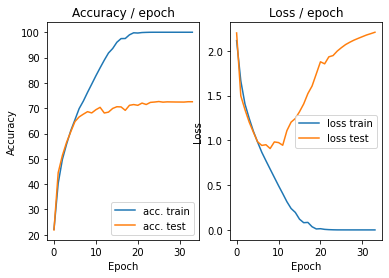

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


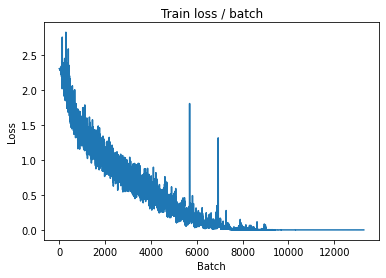

[TRAIN Batch 200/391]	Time 0.033s (0.031s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


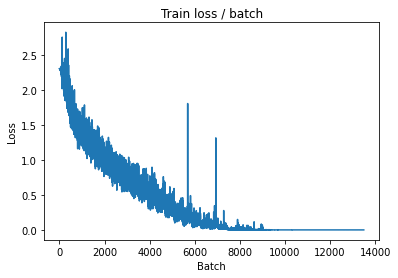


===============> Total time 11s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 2.1199 (2.1199)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2199	Avg Prec@1 72.51 %	Avg Prec@5 97.51 %



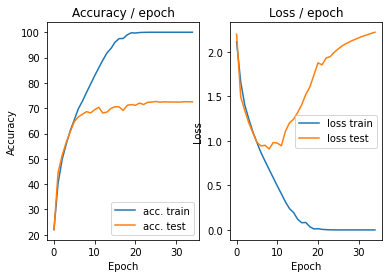

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


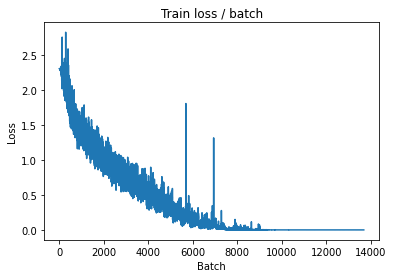

[TRAIN Batch 200/391]	Time 0.028s (0.031s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


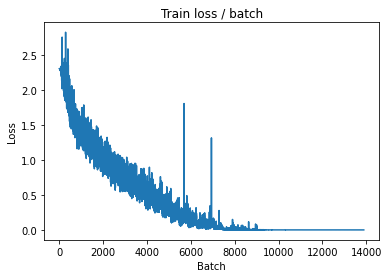


===============> Total time 11s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 2.1316 (2.1316)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2328	Avg Prec@1 72.50 %	Avg Prec@5 97.51 %



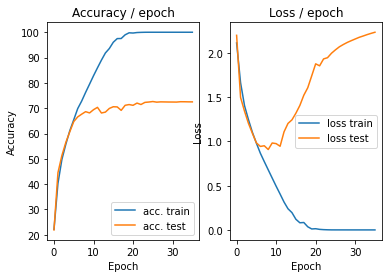

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


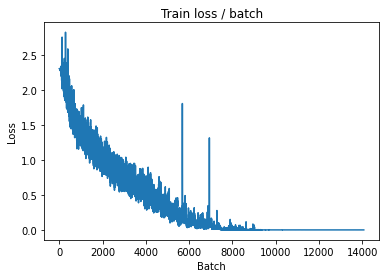

[TRAIN Batch 200/391]	Time 0.050s (0.030s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


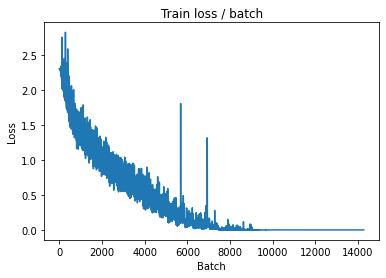


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 2.1415 (2.1415)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2455	Avg Prec@1 72.53 %	Avg Prec@5 97.52 %



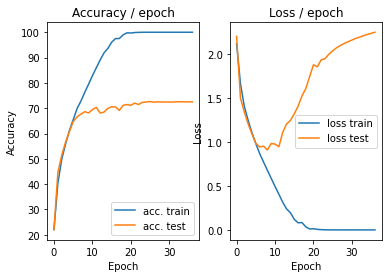

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


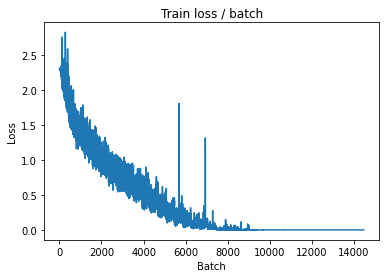

[TRAIN Batch 200/391]	Time 0.029s (0.031s)	Loss 0.0002 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


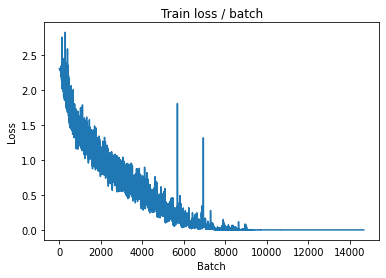


===============> Total time 12s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 2.1551 (2.1551)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2577	Avg Prec@1 72.50 %	Avg Prec@5 97.52 %



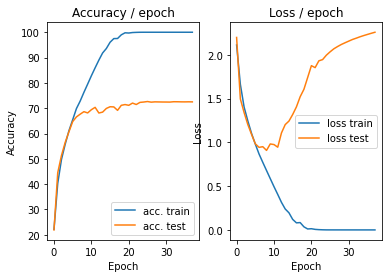

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


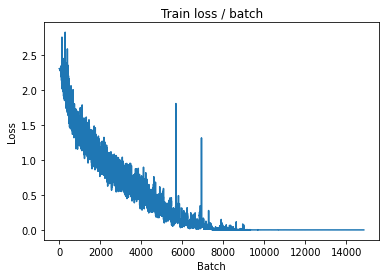

[TRAIN Batch 200/391]	Time 0.019s (0.031s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


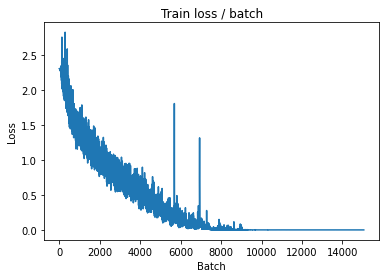


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 2.1700 (2.1700)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2687	Avg Prec@1 72.49 %	Avg Prec@5 97.54 %



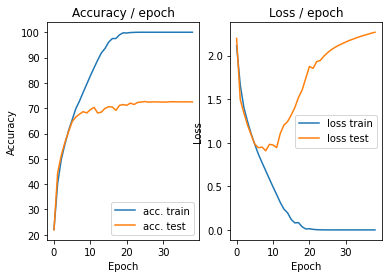

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


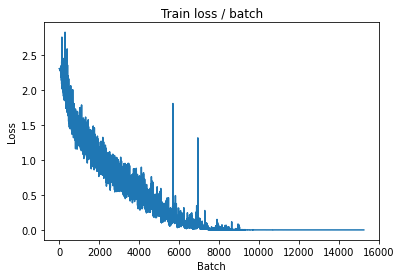

[TRAIN Batch 200/391]	Time 0.036s (0.031s)	Loss 0.0002 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


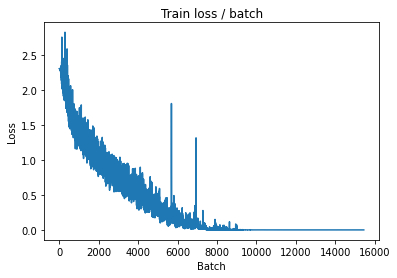


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 2.1815 (2.1815)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2788	Avg Prec@1 72.46 %	Avg Prec@5 97.54 %



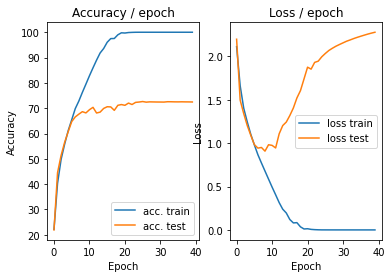

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


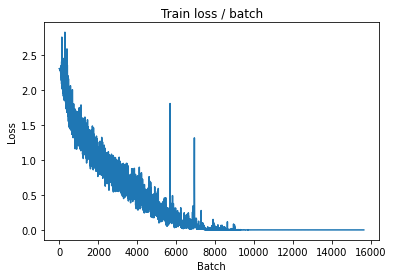

[TRAIN Batch 200/391]	Time 0.041s (0.031s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


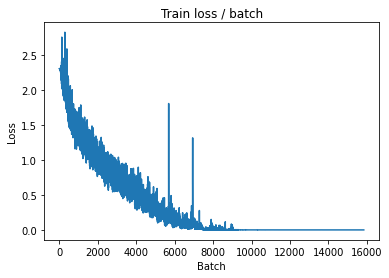


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 2.1896 (2.1896)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2886	Avg Prec@1 72.47 %	Avg Prec@5 97.54 %



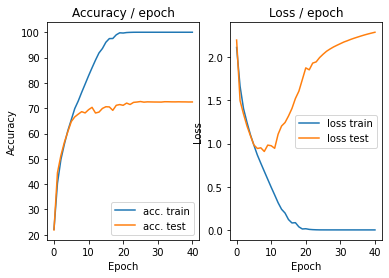

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


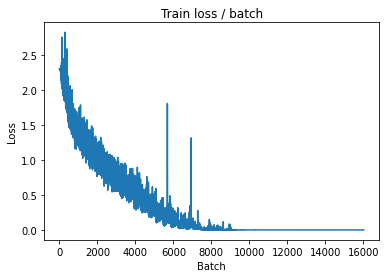

[TRAIN Batch 200/391]	Time 0.015s (0.033s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


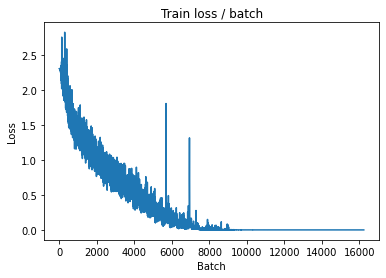


===============> Total time 12s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 2.1992 (2.1992)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2973	Avg Prec@1 72.47 %	Avg Prec@5 97.52 %



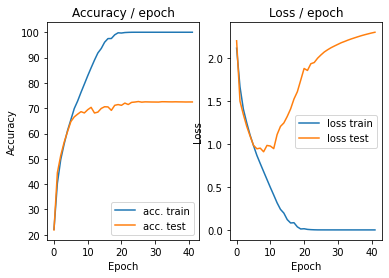

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


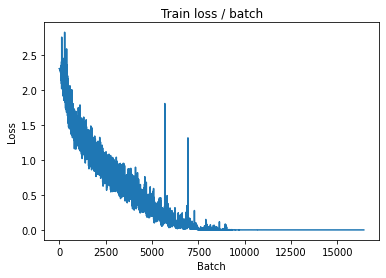

[TRAIN Batch 200/391]	Time 0.025s (0.031s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


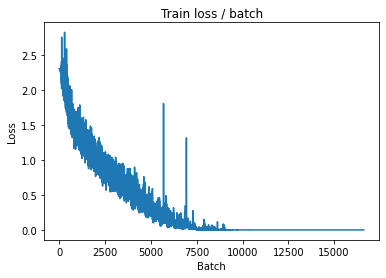


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 2.2136 (2.2136)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3069	Avg Prec@1 72.45 %	Avg Prec@5 97.55 %



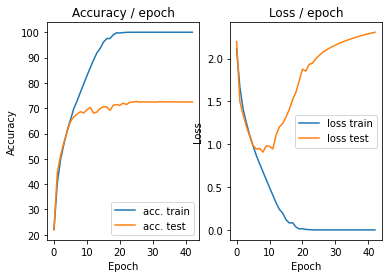

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


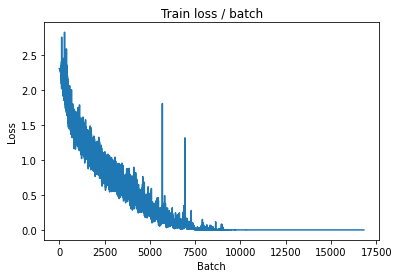

[TRAIN Batch 200/391]	Time 0.036s (0.031s)	Loss 0.0002 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


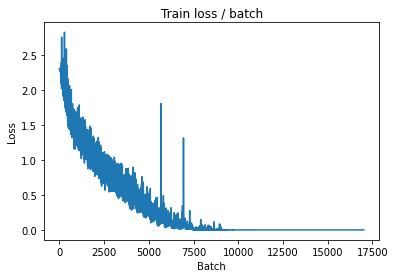


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 2.2173 (2.2173)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3164	Avg Prec@1 72.47 %	Avg Prec@5 97.55 %



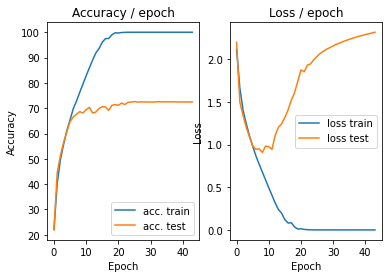

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.201s (0.201s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


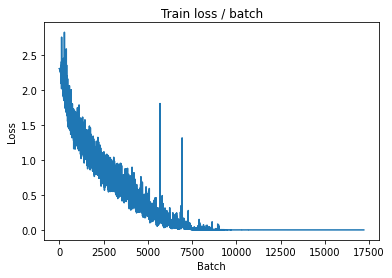

[TRAIN Batch 200/391]	Time 0.028s (0.030s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


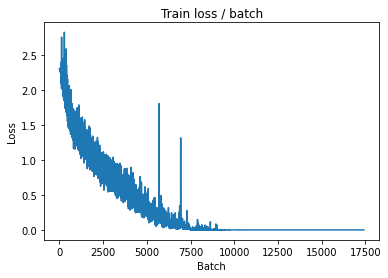


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 2.2304 (2.2304)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3249	Avg Prec@1 72.39 %	Avg Prec@5 97.55 %



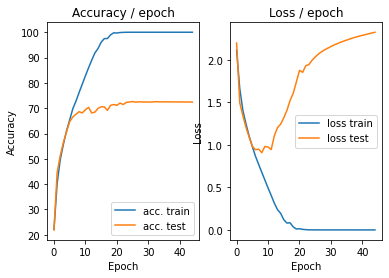

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


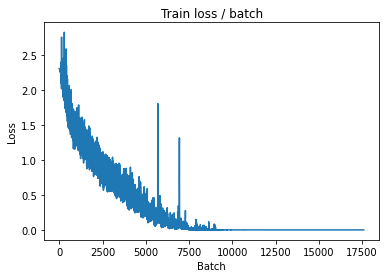

[TRAIN Batch 200/391]	Time 0.022s (0.031s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


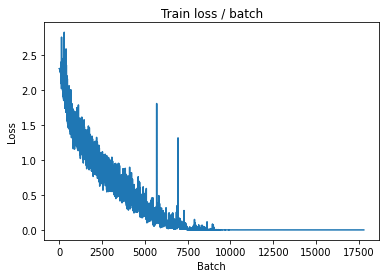


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 2.2347 (2.2347)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.3331	Avg Prec@1 72.46 %	Avg Prec@5 97.57 %



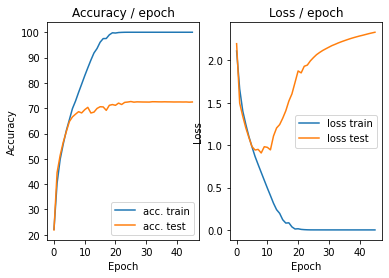

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


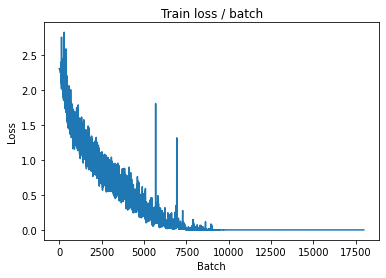

[TRAIN Batch 200/391]	Time 0.024s (0.031s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


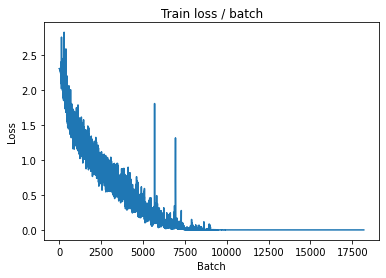


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 2.2503 (2.2503)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3415	Avg Prec@1 72.42 %	Avg Prec@5 97.56 %



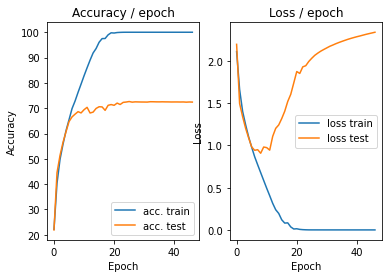

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


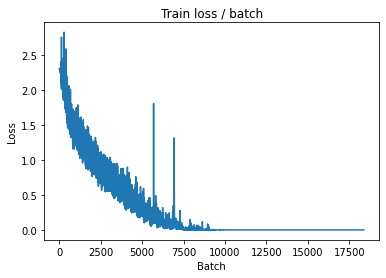

[TRAIN Batch 200/391]	Time 0.033s (0.031s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


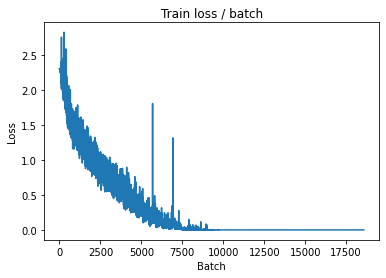


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 2.2557 (2.2557)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3487	Avg Prec@1 72.41 %	Avg Prec@5 97.56 %



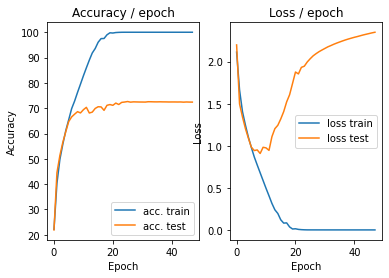

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


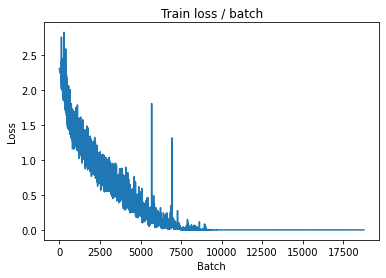

[TRAIN Batch 200/391]	Time 0.023s (0.030s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


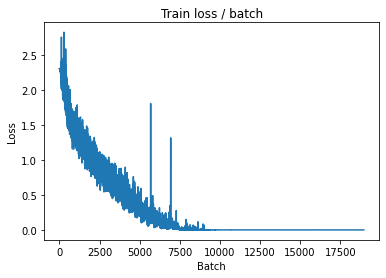


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 2.2615 (2.2615)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.3557	Avg Prec@1 72.40 %	Avg Prec@5 97.56 %



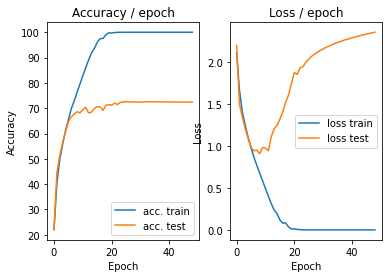

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.227s (0.227s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


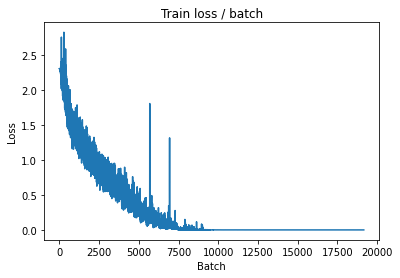

[TRAIN Batch 200/391]	Time 0.039s (0.031s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


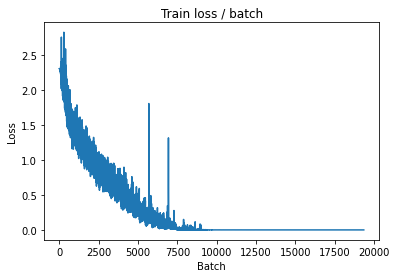


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 2.2710 (2.2710)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.3629	Avg Prec@1 72.46 %	Avg Prec@5 97.58 %



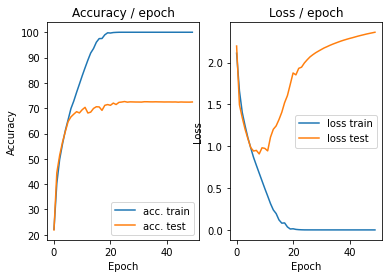

In [ ]:
main(128, 0.1,epochs=50, cuda=True)

##Normalizating :

In [ ]:


def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201])
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201])
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader




  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====



/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[TRAIN Batch 000/391]	Time 0.746s (0.746s)	Loss 2.3032 (2.3032)	Prec@1   7.8 (  7.8)	Prec@5  48.4 ( 48.4)


<Figure size 432x288 with 0 Axes>

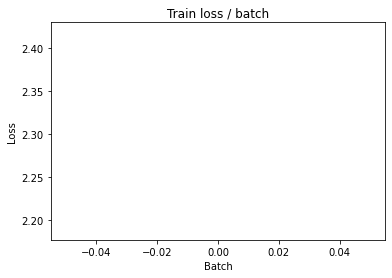

[TRAIN Batch 200/391]	Time 0.023s (0.038s)	Loss 1.6735 (1.9106)	Prec@1  40.6 ( 30.3)	Prec@5  89.8 ( 80.2)


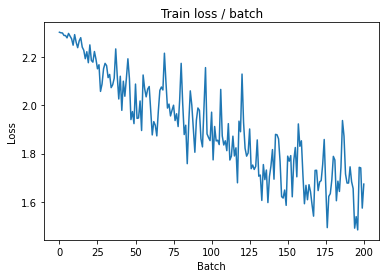


===============> Total time 14s	Avg loss 1.7211	Avg Prec@1 37.65 %	Avg Prec@5 85.67 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.4584 (1.4584)	Prec@1  50.8 ( 50.8)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.4974	Avg Prec@1 48.11 %	Avg Prec@5 91.67 %



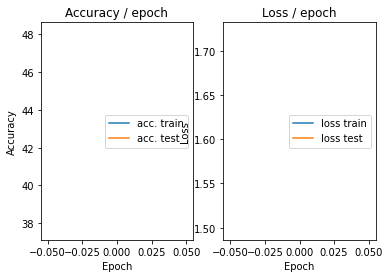

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.152s (0.152s)	Loss 1.2833 (1.2833)	Prec@1  58.6 ( 58.6)	Prec@5  93.8 ( 93.8)


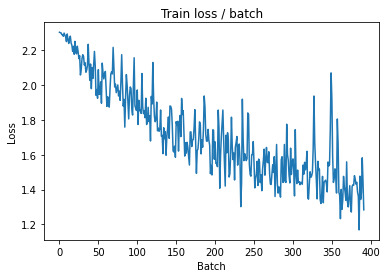

[TRAIN Batch 200/391]	Time 0.018s (0.034s)	Loss 1.1883 (1.3113)	Prec@1  54.7 ( 53.1)	Prec@5  96.1 ( 94.3)


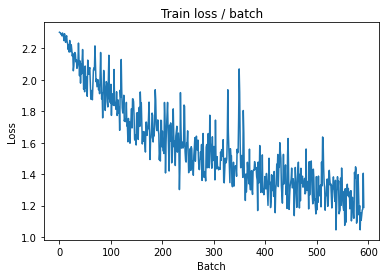


===============> Total time 13s	Avg loss 1.2578	Avg Prec@1 55.20 %	Avg Prec@5 94.80 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.1245 (1.1245)	Prec@1  59.4 ( 59.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1886	Avg Prec@1 57.59 %	Avg Prec@5 95.89 %



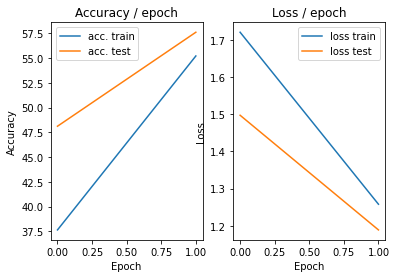

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 1.0385 (1.0385)	Prec@1  64.1 ( 64.1)	Prec@5  96.1 ( 96.1)


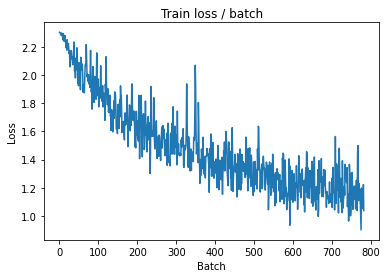

[TRAIN Batch 200/391]	Time 0.021s (0.035s)	Loss 1.0652 (1.0552)	Prec@1  61.7 ( 63.0)	Prec@5  97.7 ( 96.5)


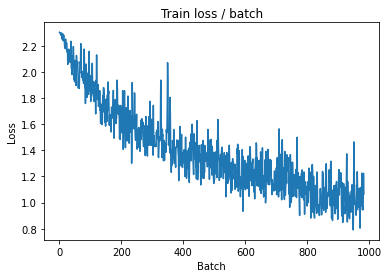


===============> Total time 13s	Avg loss 1.0230	Avg Prec@1 64.16 %	Avg Prec@5 96.60 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.0177 (1.0177)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0337	Avg Prec@1 64.28 %	Avg Prec@5 96.53 %



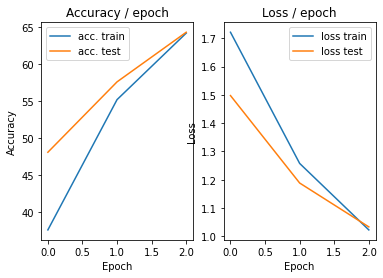

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.7895 (0.7895)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)


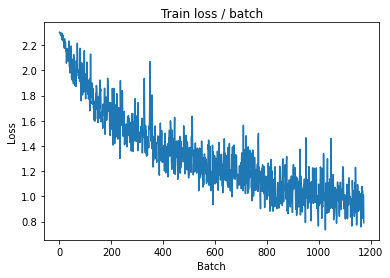

[TRAIN Batch 200/391]	Time 0.017s (0.035s)	Loss 0.8506 (0.8664)	Prec@1  68.0 ( 69.9)	Prec@5  98.4 ( 97.7)


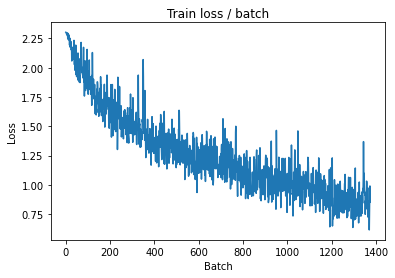


===============> Total time 13s	Avg loss 0.8504	Avg Prec@1 70.37 %	Avg Prec@5 97.79 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.9363 (0.9363)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9699	Avg Prec@1 66.37 %	Avg Prec@5 97.13 %



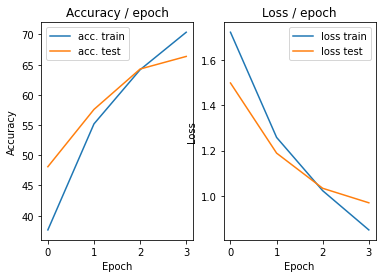

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 0.7170 (0.7170)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


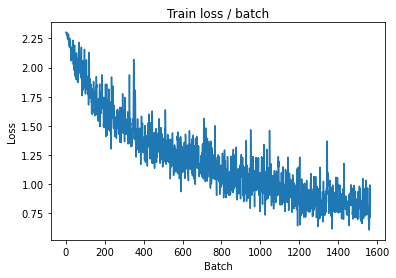

[TRAIN Batch 200/391]	Time 0.018s (0.035s)	Loss 0.7327 (0.7159)	Prec@1  71.9 ( 75.2)	Prec@5  99.2 ( 98.5)


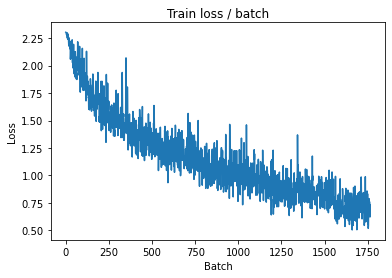


===============> Total time 13s	Avg loss 0.7085	Avg Prec@1 75.43 %	Avg Prec@5 98.55 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.8268 (0.8268)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8937	Avg Prec@1 69.44 %	Avg Prec@5 97.86 %



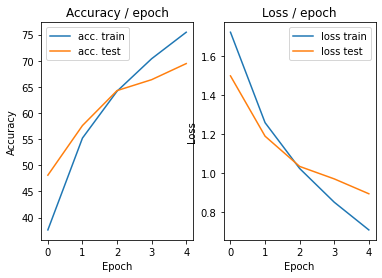

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.5398 (0.5398)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)


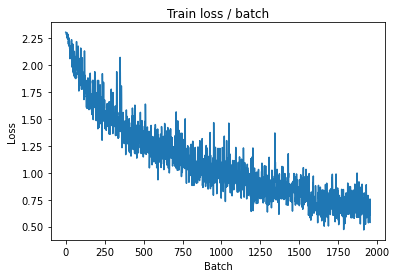

[TRAIN Batch 200/391]	Time 0.037s (0.035s)	Loss 0.5464 (0.5886)	Prec@1  78.9 ( 79.7)	Prec@5  97.7 ( 99.0)


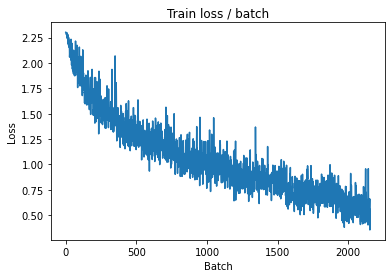


===============> Total time 13s	Avg loss 0.5926	Avg Prec@1 79.43 %	Avg Prec@5 99.04 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.8539 (0.8539)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8661	Avg Prec@1 71.55 %	Avg Prec@5 97.63 %



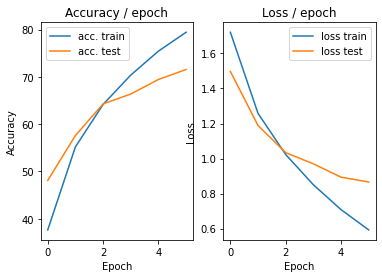

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.4604 (0.4604)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


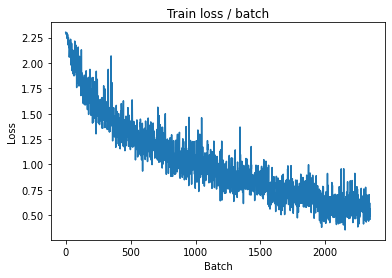

[TRAIN Batch 200/391]	Time 0.021s (0.035s)	Loss 0.4925 (0.4679)	Prec@1  82.8 ( 83.9)	Prec@5 100.0 ( 99.4)


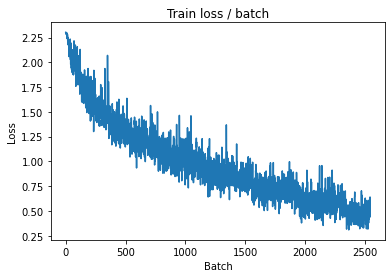


===============> Total time 13s	Avg loss 0.4839	Avg Prec@1 83.25 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.7748 (0.7748)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8342	Avg Prec@1 72.38 %	Avg Prec@5 97.98 %



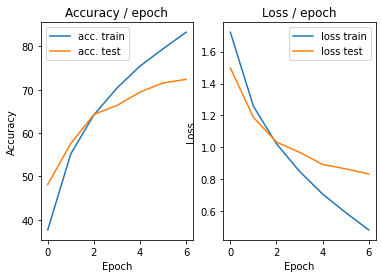

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.2849 (0.2849)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


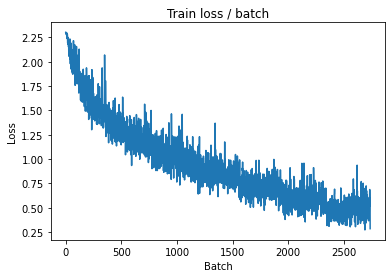

[TRAIN Batch 200/391]	Time 0.039s (0.035s)	Loss 0.3606 (0.3635)	Prec@1  86.7 ( 87.6)	Prec@5 100.0 ( 99.7)


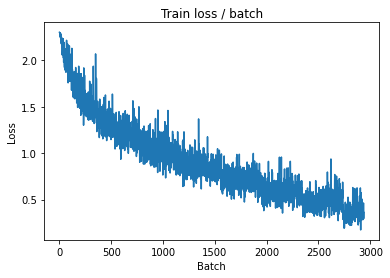


===============> Total time 13s	Avg loss 0.3747	Avg Prec@1 86.97 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.8525 (0.8525)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8690	Avg Prec@1 73.73 %	Avg Prec@5 97.65 %



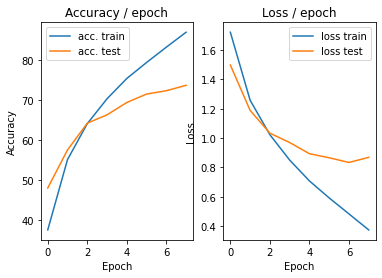

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.2611 (0.2611)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


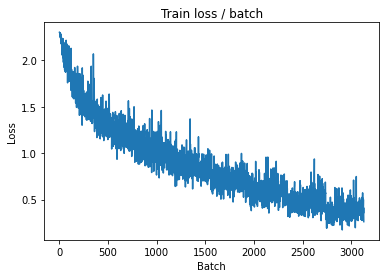

[TRAIN Batch 200/391]	Time 0.049s (0.036s)	Loss 0.1913 (0.2531)	Prec@1  94.5 ( 91.3)	Prec@5 100.0 ( 99.9)


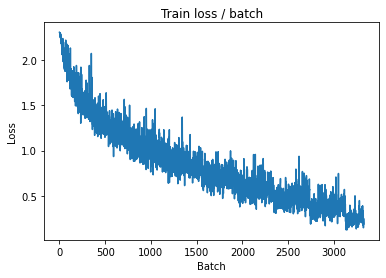


===============> Total time 13s	Avg loss 0.2788	Avg Prec@1 90.31 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.8442 (0.8442)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9533	Avg Prec@1 72.52 %	Avg Prec@5 97.74 %



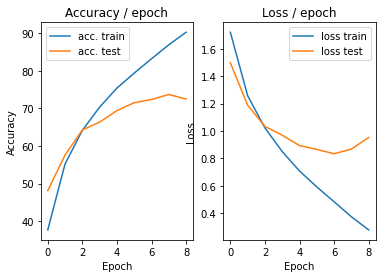

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.2886 (0.2886)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


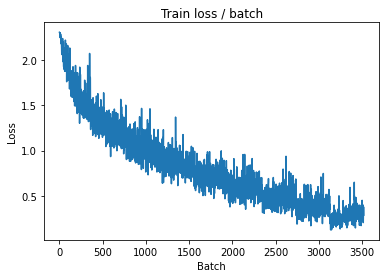

[TRAIN Batch 200/391]	Time 0.020s (0.035s)	Loss 0.1836 (0.1737)	Prec@1  93.0 ( 94.1)	Prec@5 100.0 (100.0)


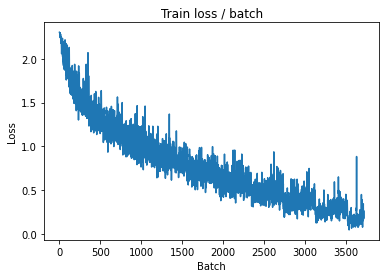


===============> Total time 13s	Avg loss 0.1960	Avg Prec@1 93.21 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.9545 (0.9545)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.0819	Avg Prec@1 73.00 %	Avg Prec@5 97.68 %



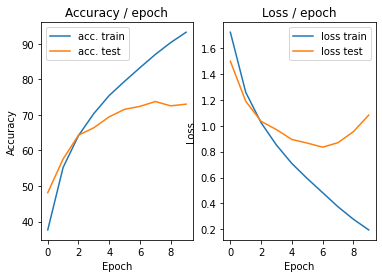

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.1195 (0.1195)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


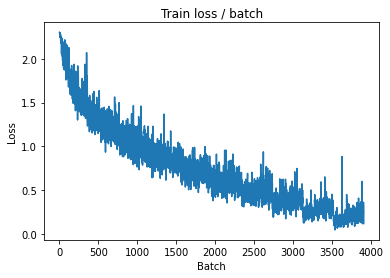

[TRAIN Batch 200/391]	Time 0.026s (0.036s)	Loss 0.2780 (0.1230)	Prec@1  88.3 ( 96.0)	Prec@5 100.0 (100.0)


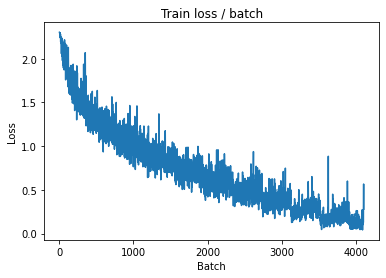


===============> Total time 14s	Avg loss 0.1394	Avg Prec@1 95.27 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.2427 (1.2427)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.3434	Avg Prec@1 70.46 %	Avg Prec@5 97.34 %



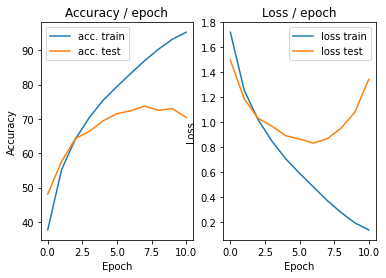

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.1961 (0.1961)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


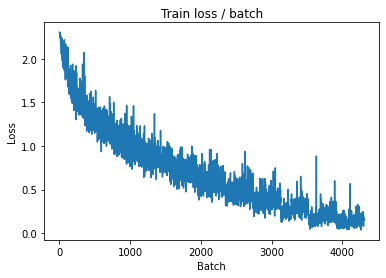

[TRAIN Batch 200/391]	Time 0.020s (0.035s)	Loss 1.6753 (0.1168)	Prec@1  64.8 ( 96.4)	Prec@5  96.9 (100.0)


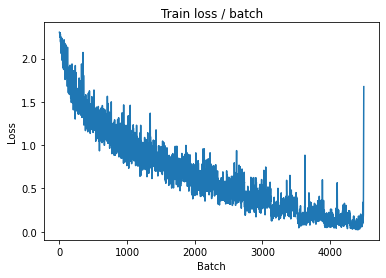


===============> Total time 13s	Avg loss 0.1311	Avg Prec@1 95.91 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.1460 (1.1460)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.1570	Avg Prec@1 74.20 %	Avg Prec@5 97.65 %



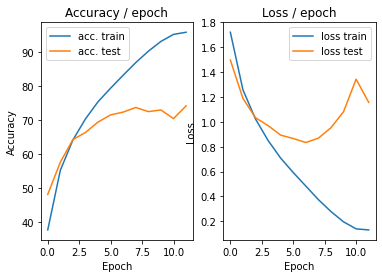

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.0886 (0.0886)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


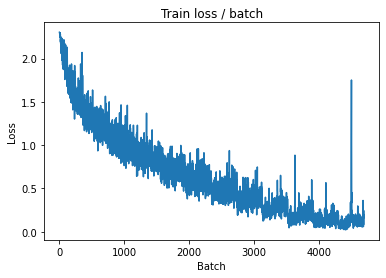

[TRAIN Batch 200/391]	Time 0.042s (0.036s)	Loss 0.0545 (0.0601)	Prec@1  98.4 ( 98.0)	Prec@5 100.0 (100.0)


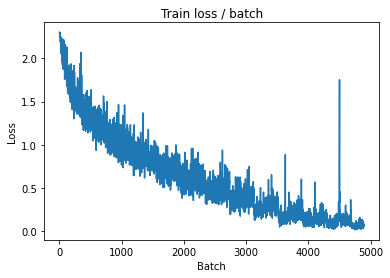


===============> Total time 13s	Avg loss 0.0783	Avg Prec@1 97.36 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 1.2737 (1.2737)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.3504	Avg Prec@1 72.89 %	Avg Prec@5 97.35 %



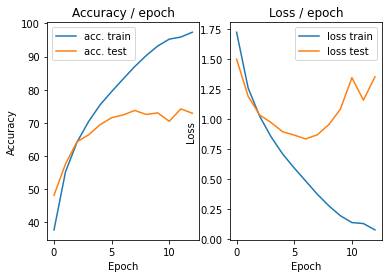

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0901 (0.0901)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


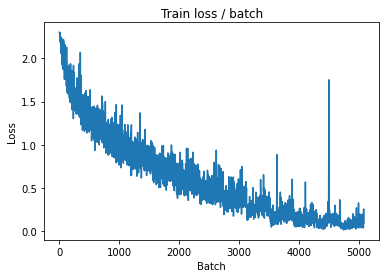

[TRAIN Batch 200/391]	Time 0.038s (0.035s)	Loss 0.0257 (0.0500)	Prec@1  99.2 ( 98.4)	Prec@5 100.0 (100.0)


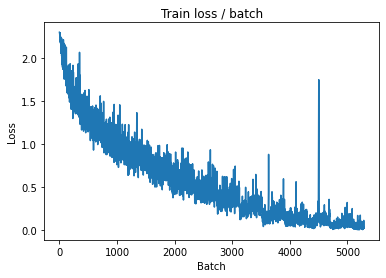


===============> Total time 13s	Avg loss 0.0647	Avg Prec@1 97.86 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 1.4246 (1.4246)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.5825	Avg Prec@1 71.83 %	Avg Prec@5 97.36 %



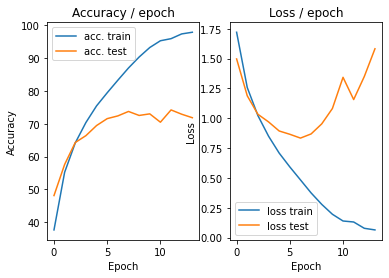

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.2055 (0.2055)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


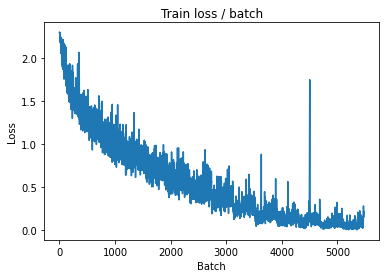

[TRAIN Batch 200/391]	Time 0.062s (0.036s)	Loss 0.1093 (0.0497)	Prec@1  97.7 ( 98.4)	Prec@5 100.0 (100.0)


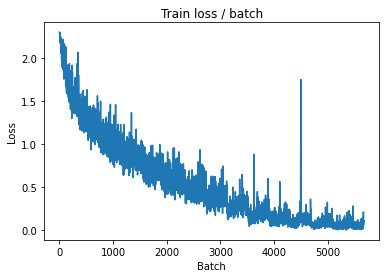


===============> Total time 13s	Avg loss 0.0663	Avg Prec@1 97.84 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 1.1615 (1.1615)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.3762	Avg Prec@1 74.55 %	Avg Prec@5 97.57 %



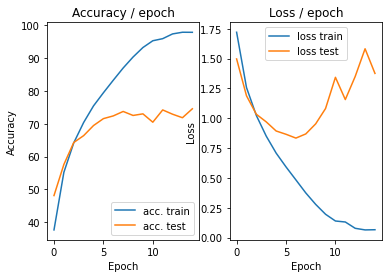

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.0255 (0.0255)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


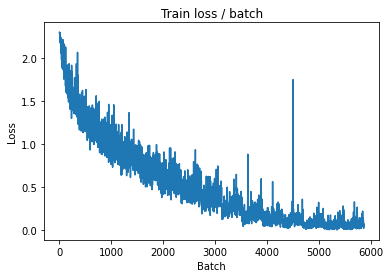

[TRAIN Batch 200/391]	Time 0.019s (0.036s)	Loss 0.0085 (0.0366)	Prec@1 100.0 ( 98.9)	Prec@5 100.0 (100.0)


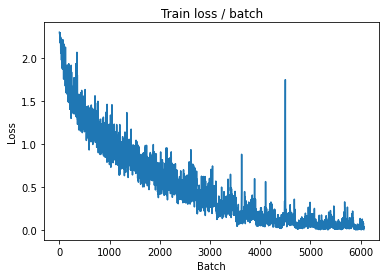


===============> Total time 14s	Avg loss 0.0458	Avg Prec@1 98.51 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 1.3062 (1.3062)	Prec@1  79.7 ( 79.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.4669	Avg Prec@1 75.17 %	Avg Prec@5 97.67 %



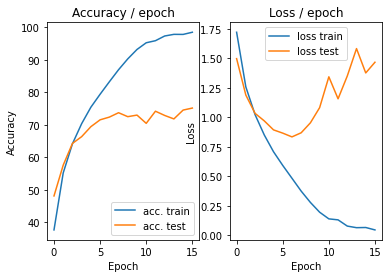

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.0416 (0.0416)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


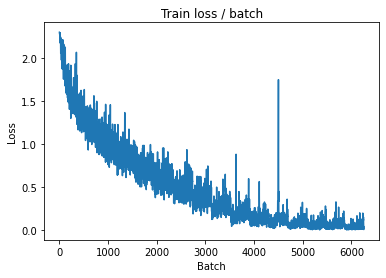

[TRAIN Batch 200/391]	Time 0.035s (0.037s)	Loss 0.0356 (0.0370)	Prec@1  97.7 ( 98.8)	Prec@5 100.0 (100.0)


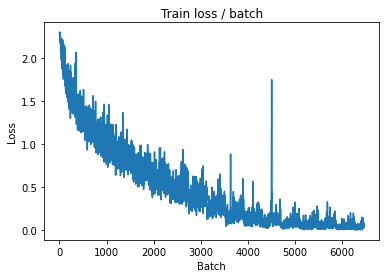


===============> Total time 14s	Avg loss 0.0471	Avg Prec@1 98.44 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 1.2743 (1.2743)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.5115	Avg Prec@1 74.60 %	Avg Prec@5 97.63 %



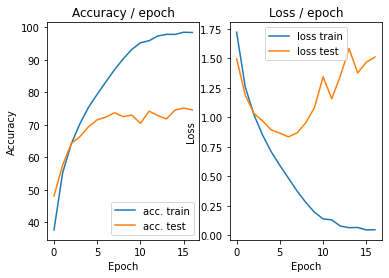

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.0649 (0.0649)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


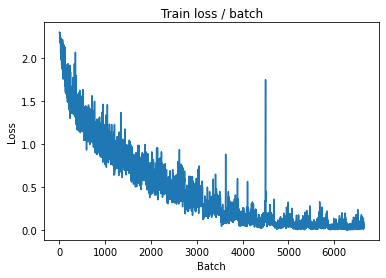

[TRAIN Batch 200/391]	Time 0.053s (0.036s)	Loss 0.0083 (0.0209)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


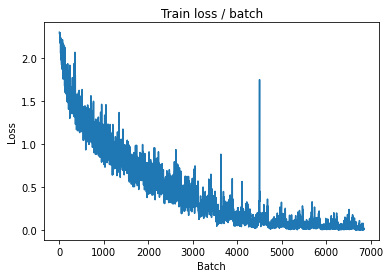


===============> Total time 13s	Avg loss 0.0338	Avg Prec@1 98.92 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 1.7781 (1.7781)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.7205	Avg Prec@1 73.40 %	Avg Prec@5 97.60 %



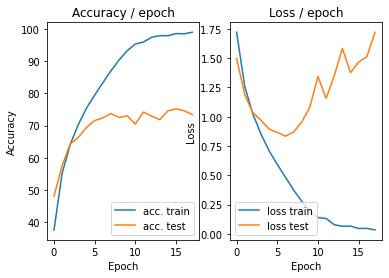

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.0700 (0.0700)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


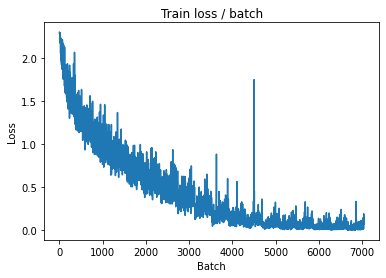

[TRAIN Batch 200/391]	Time 0.048s (0.036s)	Loss 0.0090 (0.0410)	Prec@1 100.0 ( 98.7)	Prec@5 100.0 (100.0)


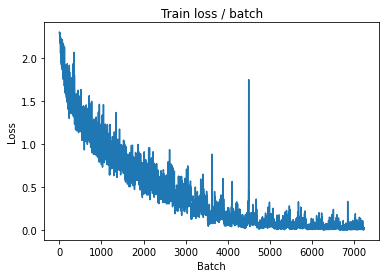


===============> Total time 13s	Avg loss 0.0370	Avg Prec@1 98.87 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 1.3192 (1.3192)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.5848	Avg Prec@1 74.88 %	Avg Prec@5 98.06 %



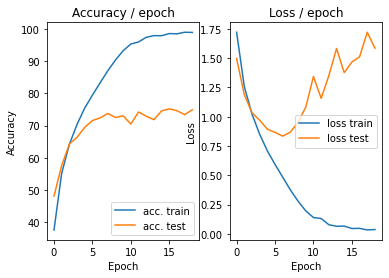

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.0375 (0.0375)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


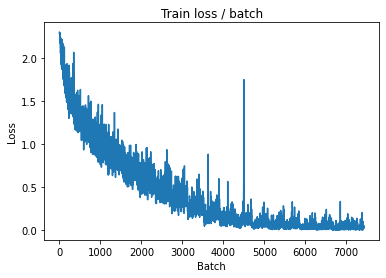

[TRAIN Batch 200/391]	Time 0.035s (0.037s)	Loss 0.0138 (0.0212)	Prec@1  99.2 ( 99.4)	Prec@5 100.0 (100.0)


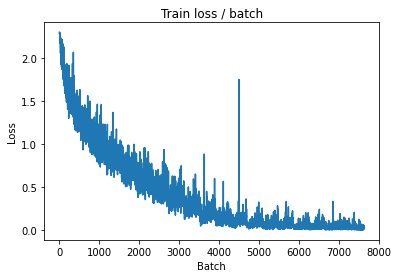


===============> Total time 13s	Avg loss 0.0281	Avg Prec@1 99.12 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 1.3796 (1.3796)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.7727	Avg Prec@1 74.19 %	Avg Prec@5 97.61 %



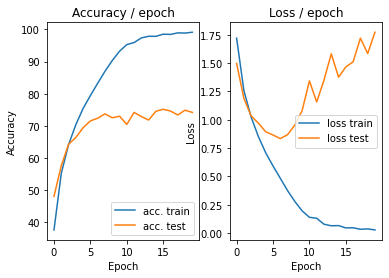

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.0694 (0.0694)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


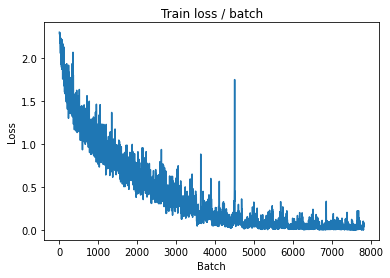

[TRAIN Batch 200/391]	Time 0.066s (0.036s)	Loss 0.0246 (0.0213)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


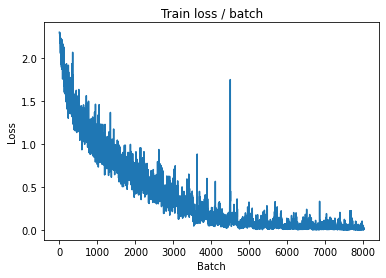


===============> Total time 13s	Avg loss 0.0231	Avg Prec@1 99.22 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 1.2992 (1.2992)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.8050	Avg Prec@1 74.39 %	Avg Prec@5 97.52 %



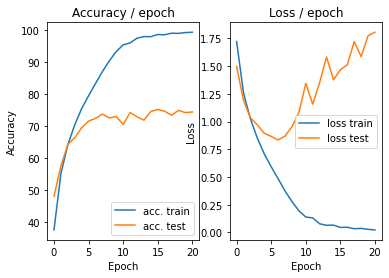

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.0988 (0.0988)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


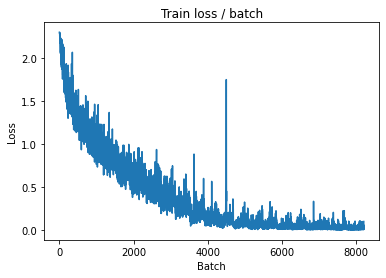

[TRAIN Batch 200/391]	Time 0.017s (0.035s)	Loss 0.0515 (0.0215)	Prec@1  98.4 ( 99.3)	Prec@5 100.0 (100.0)


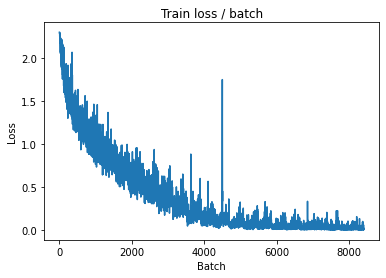


===============> Total time 13s	Avg loss 0.0430	Avg Prec@1 98.63 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 1.5521 (1.5521)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.7219	Avg Prec@1 72.84 %	Avg Prec@5 97.36 %



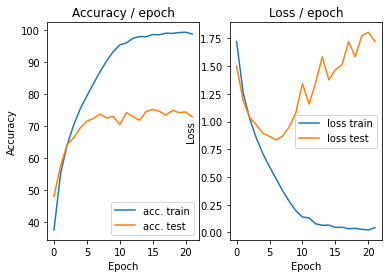

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 0.0916 (0.0916)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


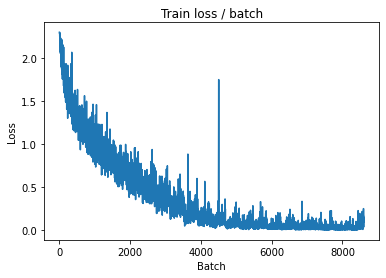

[TRAIN Batch 200/391]	Time 0.019s (0.036s)	Loss 0.0073 (0.0516)	Prec@1 100.0 ( 98.4)	Prec@5 100.0 (100.0)


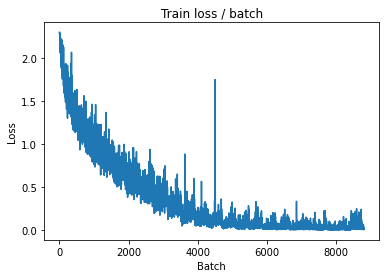


===============> Total time 13s	Avg loss 0.0494	Avg Prec@1 98.41 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.3209 (1.3209)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.7143	Avg Prec@1 73.52 %	Avg Prec@5 97.46 %



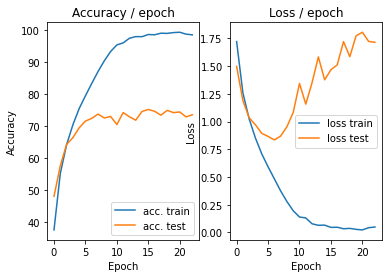

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.0805 (0.0805)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


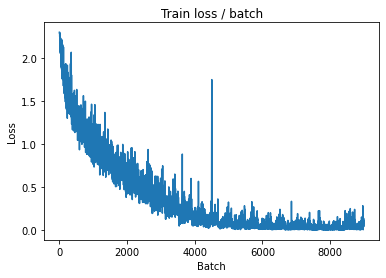

[TRAIN Batch 200/391]	Time 0.040s (0.036s)	Loss 0.0082 (0.0215)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


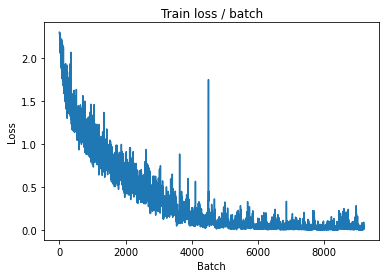


===============> Total time 13s	Avg loss 0.0401	Avg Prec@1 98.75 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 2.0959 (2.0959)	Prec@1  68.8 ( 68.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 2.4035	Avg Prec@1 67.24 %	Avg Prec@5 96.35 %



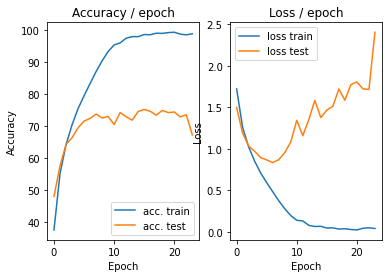

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.3121 (0.3121)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


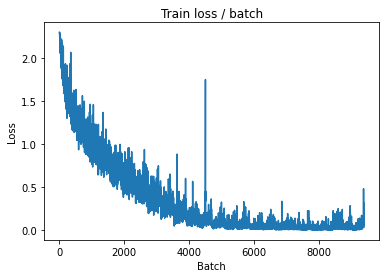

[TRAIN Batch 200/391]	Time 0.048s (0.036s)	Loss 0.0242 (0.0359)	Prec@1  99.2 ( 98.9)	Prec@5 100.0 (100.0)


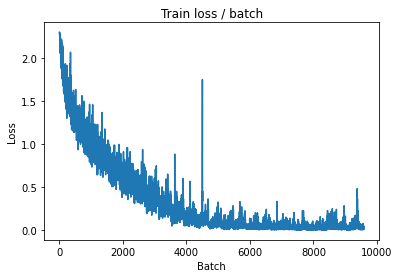


===============> Total time 13s	Avg loss 0.0269	Avg Prec@1 99.19 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 1.5892 (1.5892)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.7982	Avg Prec@1 74.79 %	Avg Prec@5 97.82 %



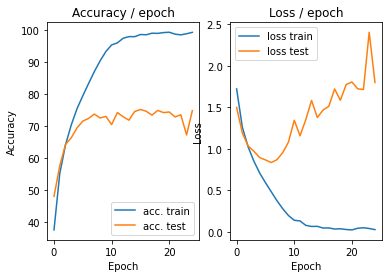

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.0130 (0.0130)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


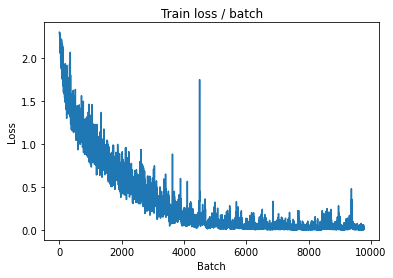

[TRAIN Batch 200/391]	Time 0.024s (0.036s)	Loss 0.0195 (0.0121)	Prec@1  99.2 ( 99.6)	Prec@5 100.0 (100.0)


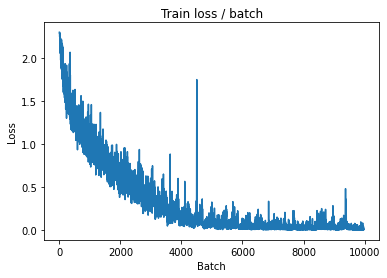


===============> Total time 13s	Avg loss 0.0138	Avg Prec@1 99.58 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.6665 (1.6665)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.9476	Avg Prec@1 74.27 %	Avg Prec@5 97.50 %



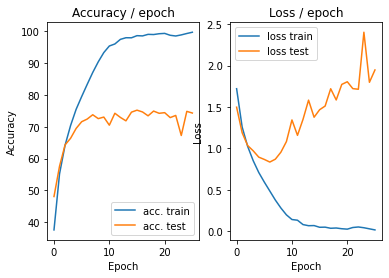

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.0027 (0.0027)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


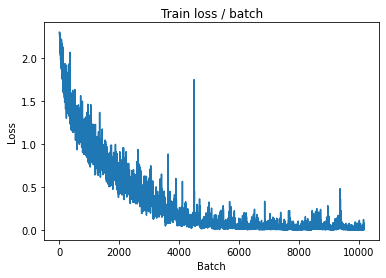

[TRAIN Batch 200/391]	Time 0.041s (0.036s)	Loss 0.0166 (0.0258)	Prec@1  99.2 ( 99.1)	Prec@5 100.0 (100.0)


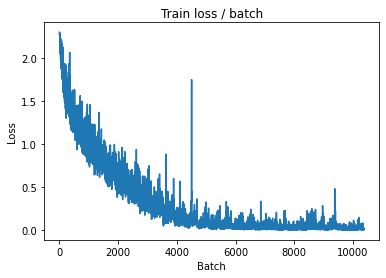


===============> Total time 13s	Avg loss 0.0328	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 1.9362 (1.9362)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.9453	Avg Prec@1 74.04 %	Avg Prec@5 97.70 %



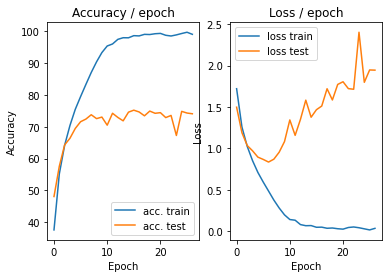

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.0112 (0.0112)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


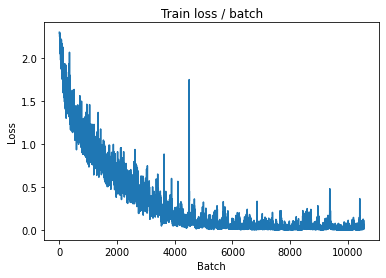

[TRAIN Batch 200/391]	Time 0.043s (0.035s)	Loss 0.0403 (0.0418)	Prec@1  99.2 ( 98.7)	Prec@5 100.0 (100.0)


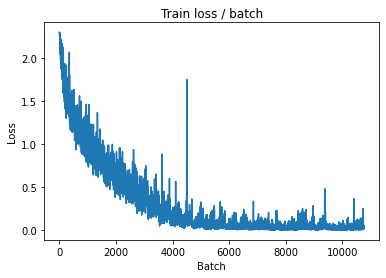


===============> Total time 13s	Avg loss 0.0411	Avg Prec@1 98.70 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 1.9260 (1.9260)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.8653	Avg Prec@1 73.67 %	Avg Prec@5 97.55 %



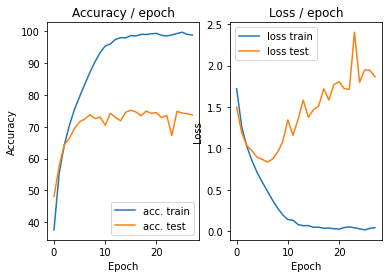

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.0141 (0.0141)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


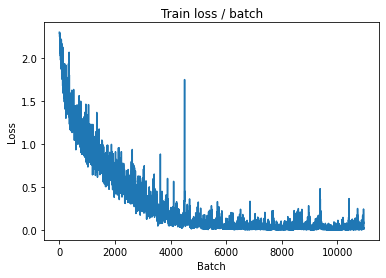

[TRAIN Batch 200/391]	Time 0.022s (0.036s)	Loss 0.0307 (0.0383)	Prec@1  97.7 ( 98.8)	Prec@5 100.0 (100.0)


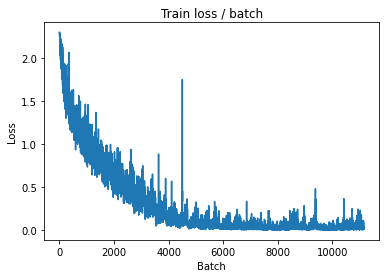


===============> Total time 14s	Avg loss 0.0390	Avg Prec@1 98.75 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 1.8793 (1.8793)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.9190	Avg Prec@1 74.24 %	Avg Prec@5 97.34 %



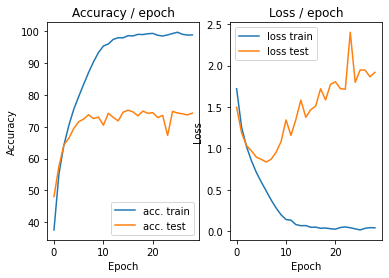

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.1387 (0.1387)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


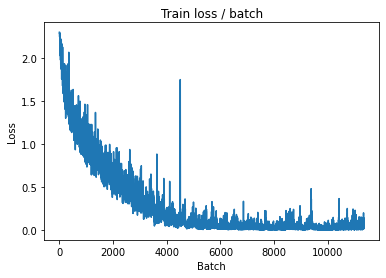

[TRAIN Batch 200/391]	Time 0.061s (0.036s)	Loss 0.0124 (0.0247)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


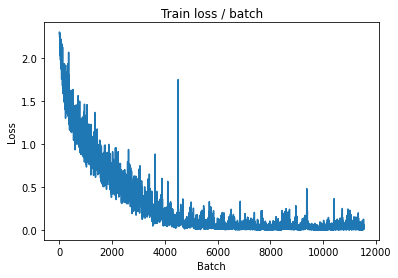


===============> Total time 13s	Avg loss 0.0239	Avg Prec@1 99.19 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 1.5865 (1.5865)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.8975	Avg Prec@1 74.84 %	Avg Prec@5 97.39 %



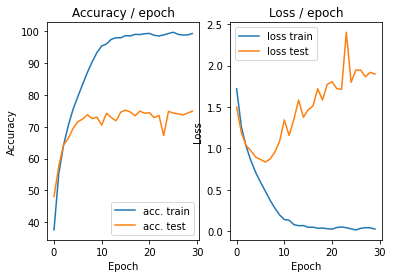

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.0068 (0.0068)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


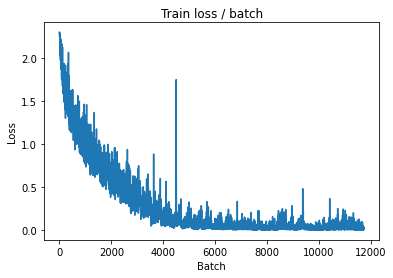

[TRAIN Batch 200/391]	Time 0.026s (0.036s)	Loss 0.0203 (0.0113)	Prec@1  99.2 ( 99.6)	Prec@5 100.0 (100.0)


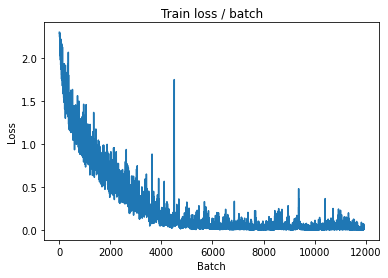


===============> Total time 13s	Avg loss 0.0137	Avg Prec@1 99.58 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.7508 (1.7508)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 2.0812	Avg Prec@1 75.25 %	Avg Prec@5 97.73 %



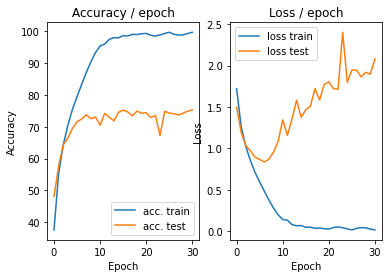

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.0218 (0.0218)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


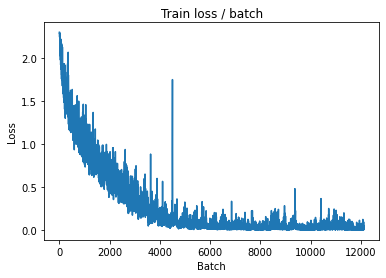

[TRAIN Batch 200/391]	Time 0.038s (0.037s)	Loss 0.0062 (0.0099)	Prec@1 100.0 ( 99.7)	Prec@5 100.0 (100.0)


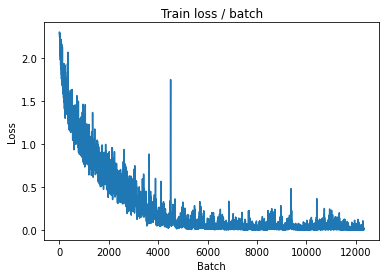


===============> Total time 14s	Avg loss 0.0214	Avg Prec@1 99.37 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 1.9970 (1.9970)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 2.1279	Avg Prec@1 73.51 %	Avg Prec@5 97.48 %



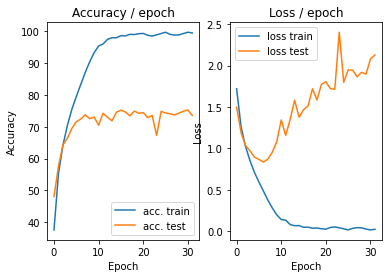

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.0785 (0.0785)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


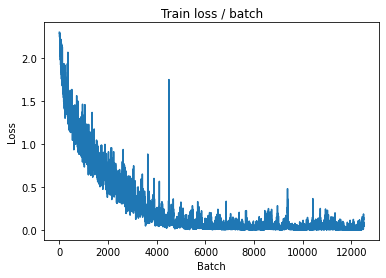

[TRAIN Batch 200/391]	Time 0.057s (0.036s)	Loss 0.0058 (0.0312)	Prec@1 100.0 ( 99.0)	Prec@5 100.0 (100.0)


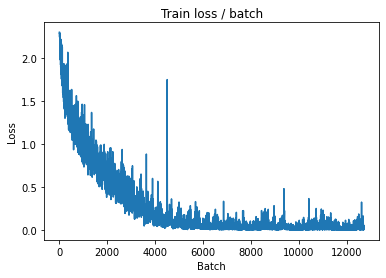


===============> Total time 13s	Avg loss 0.0276	Avg Prec@1 99.14 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 2.1873 (2.1873)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.1002	Avg Prec@1 74.49 %	Avg Prec@5 97.42 %



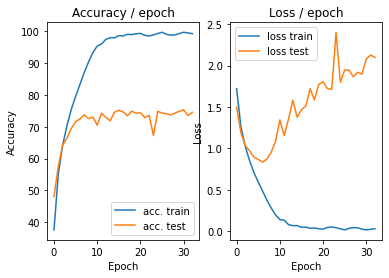

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.201s (0.201s)	Loss 0.0068 (0.0068)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


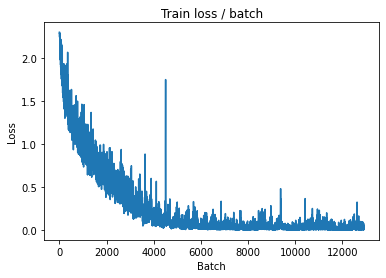

[TRAIN Batch 200/391]	Time 0.018s (0.035s)	Loss 0.0028 (0.0176)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


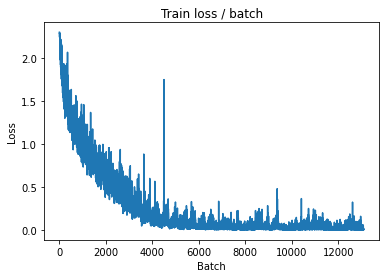


===============> Total time 13s	Avg loss 0.0239	Avg Prec@1 99.25 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 2.0529 (2.0529)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.0753	Avg Prec@1 75.18 %	Avg Prec@5 97.69 %



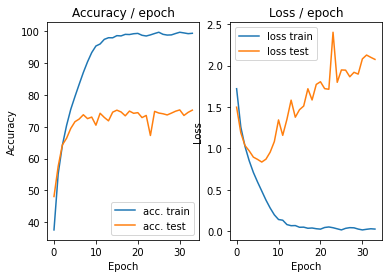

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 0.0499 (0.0499)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


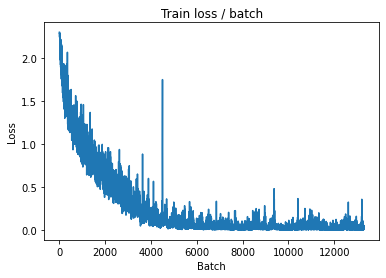

[TRAIN Batch 200/391]	Time 0.033s (0.038s)	Loss 0.0042 (0.0146)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


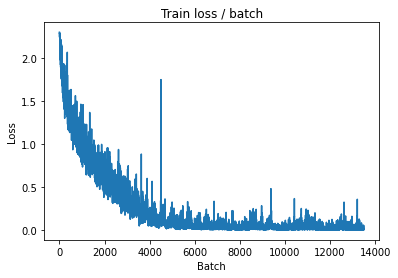


===============> Total time 14s	Avg loss 0.0178	Avg Prec@1 99.43 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 1.8082 (1.8082)	Prec@1  76.6 ( 76.6)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 2.0083	Avg Prec@1 75.16 %	Avg Prec@5 97.72 %



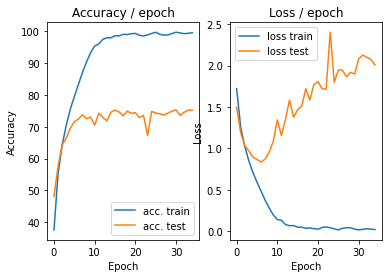

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.0075 (0.0075)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


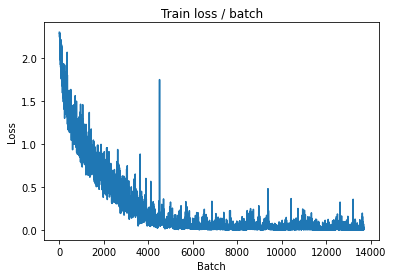

[TRAIN Batch 200/391]	Time 0.019s (0.036s)	Loss 0.0014 (0.0148)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


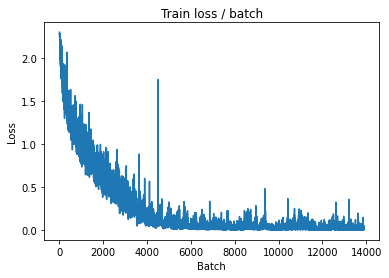


===============> Total time 14s	Avg loss 0.0190	Avg Prec@1 99.43 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 1.8714 (1.8714)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.1478	Avg Prec@1 74.39 %	Avg Prec@5 97.36 %



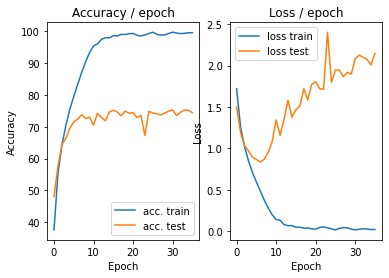

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.0253 (0.0253)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


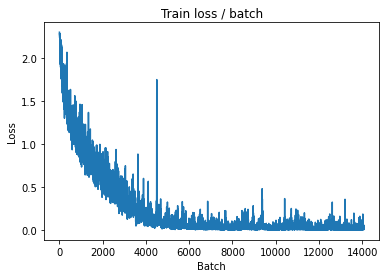

[TRAIN Batch 200/391]	Time 0.046s (0.036s)	Loss 0.0006 (0.0133)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


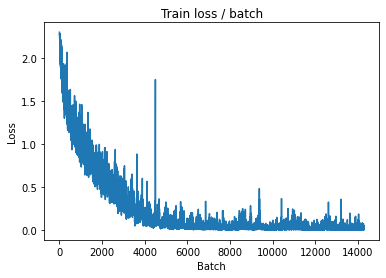


===============> Total time 13s	Avg loss 0.0118	Avg Prec@1 99.62 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 2.1759 (2.1759)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 2.2047	Avg Prec@1 74.88 %	Avg Prec@5 97.64 %



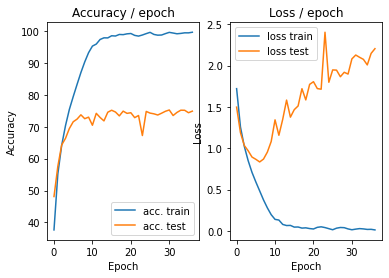

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.0009 (0.0009)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


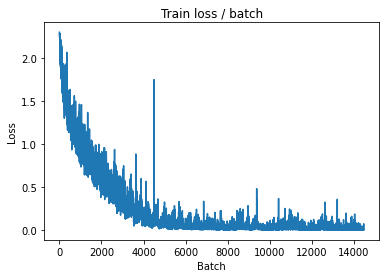

[TRAIN Batch 200/391]	Time 0.051s (0.036s)	Loss 0.0010 (0.0041)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


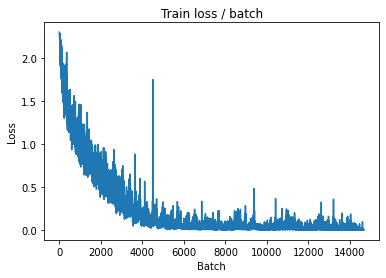


===============> Total time 13s	Avg loss 0.0035	Avg Prec@1 99.90 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 2.1633 (2.1633)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 2.1700	Avg Prec@1 75.50 %	Avg Prec@5 97.77 %



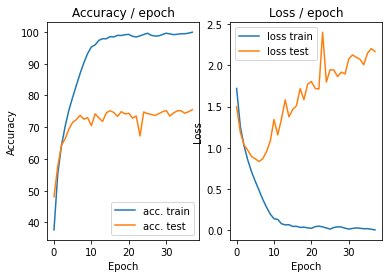

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


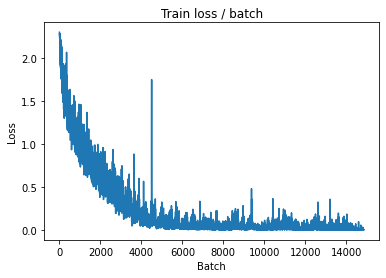

[TRAIN Batch 200/391]	Time 0.027s (0.035s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


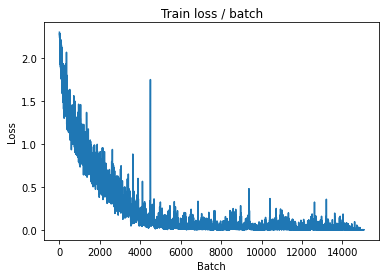


===============> Total time 13s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 2.1695 (2.1695)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.2232	Avg Prec@1 75.82 %	Avg Prec@5 97.83 %



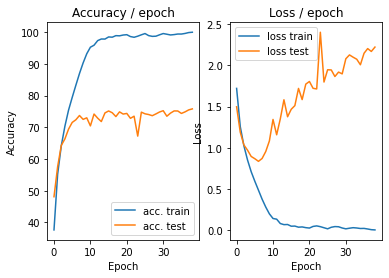

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


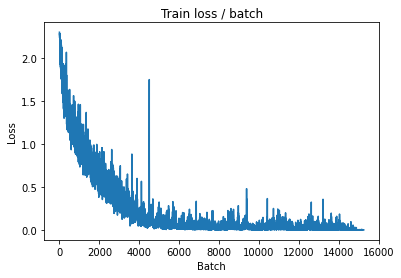

[TRAIN Batch 200/391]	Time 0.040s (0.036s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


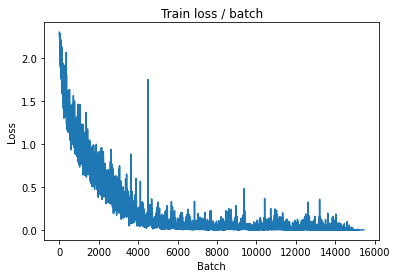


===============> Total time 13s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 2.1857 (2.1857)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.2360	Avg Prec@1 76.01 %	Avg Prec@5 97.86 %



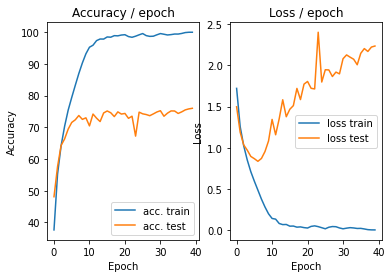

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


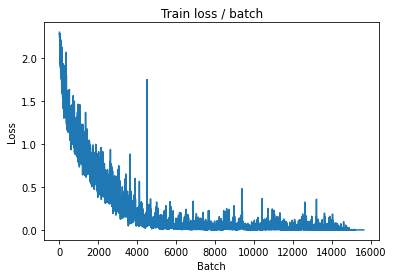

[TRAIN Batch 200/391]	Time 0.053s (0.036s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


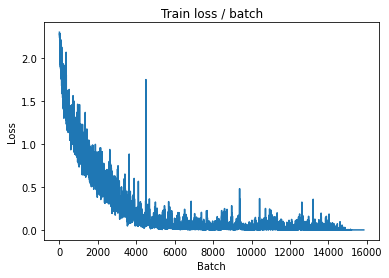


===============> Total time 13s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 2.1990 (2.1990)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.2520	Avg Prec@1 76.04 %	Avg Prec@5 97.86 %



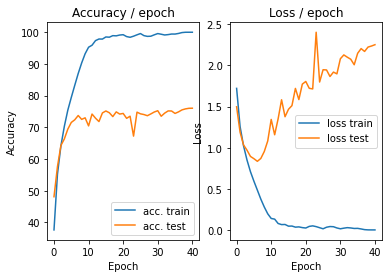

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


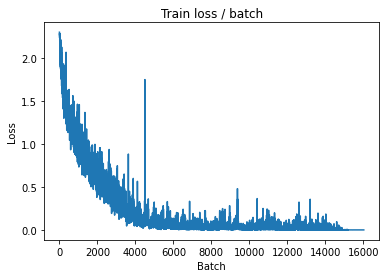

[TRAIN Batch 200/391]	Time 0.056s (0.035s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


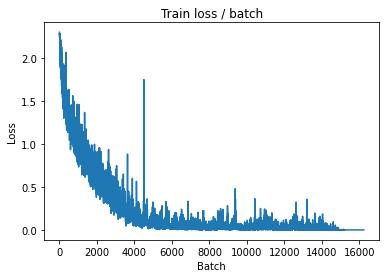


===============> Total time 13s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 2.2149 (2.2149)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.2646	Avg Prec@1 76.09 %	Avg Prec@5 97.87 %



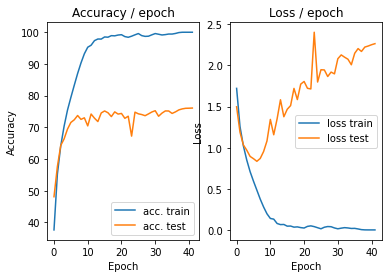

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


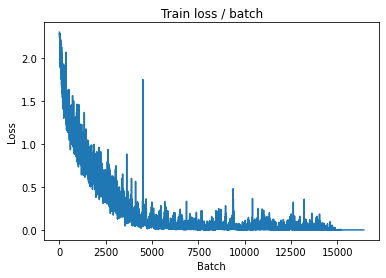

[TRAIN Batch 200/391]	Time 0.021s (0.035s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


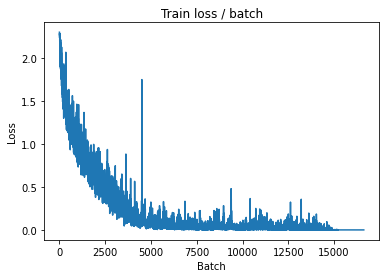


===============> Total time 13s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 2.2227 (2.2227)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.2761	Avg Prec@1 76.06 %	Avg Prec@5 97.88 %



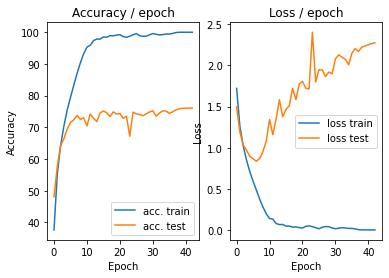

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


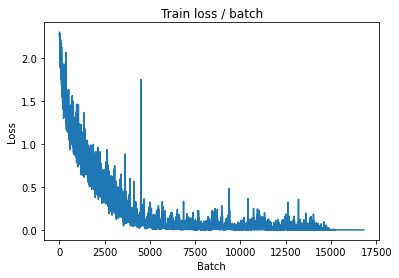

[TRAIN Batch 200/391]	Time 0.029s (0.036s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


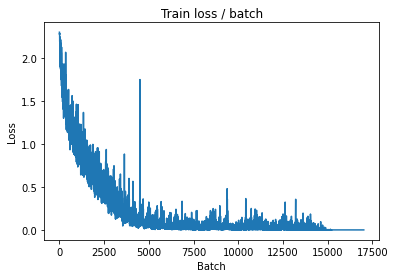


===============> Total time 13s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 2.2328 (2.2328)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.2866	Avg Prec@1 76.09 %	Avg Prec@5 97.89 %



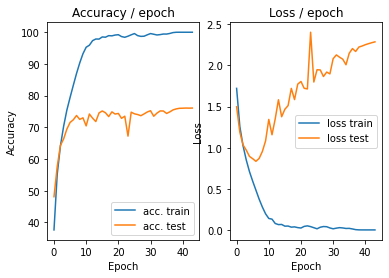

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


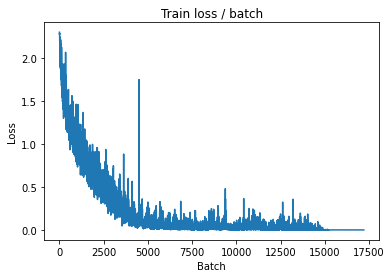

[TRAIN Batch 200/391]	Time 0.018s (0.036s)	Loss 0.0001 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


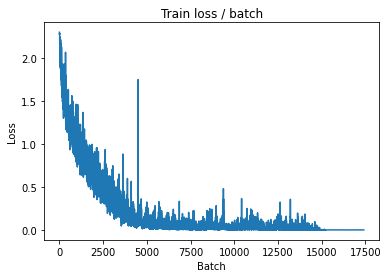


===============> Total time 13s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 2.2422 (2.2422)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.2962	Avg Prec@1 76.13 %	Avg Prec@5 97.91 %



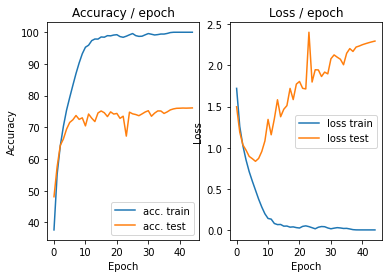

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


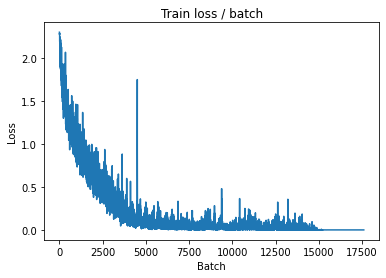

[TRAIN Batch 200/391]	Time 0.049s (0.036s)	Loss 0.0001 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


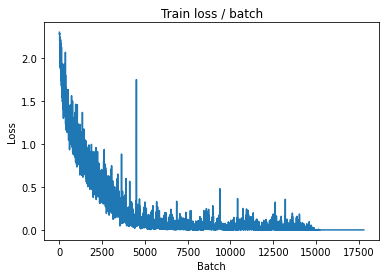


===============> Total time 13s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 2.2508 (2.2508)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.3051	Avg Prec@1 76.19 %	Avg Prec@5 97.93 %



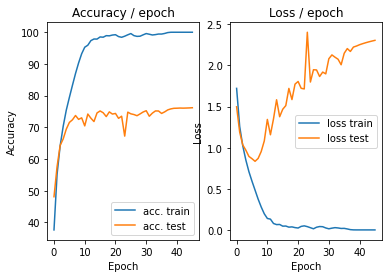

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


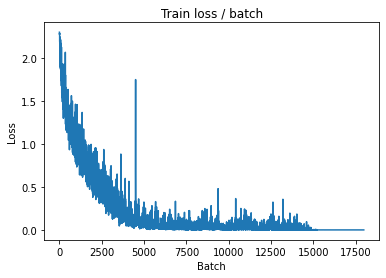

[TRAIN Batch 200/391]	Time 0.017s (0.036s)	Loss 0.0001 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


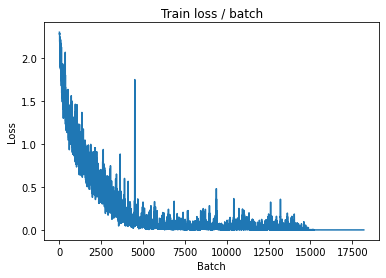


===============> Total time 13s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 2.2588 (2.2588)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.3133	Avg Prec@1 76.20 %	Avg Prec@5 97.96 %



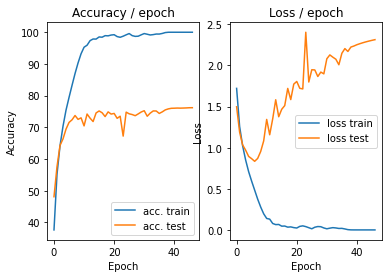

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


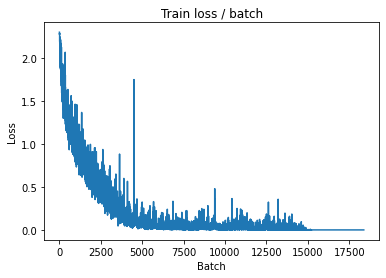

[TRAIN Batch 200/391]	Time 0.030s (0.036s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


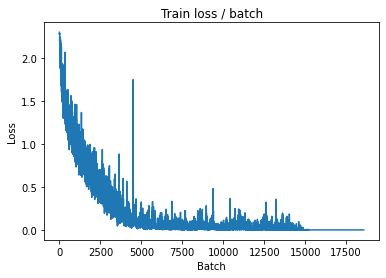


===============> Total time 13s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 2.2661 (2.2661)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.3211	Avg Prec@1 76.22 %	Avg Prec@5 97.98 %



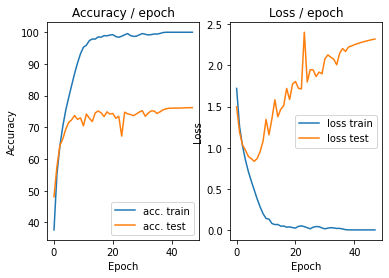

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


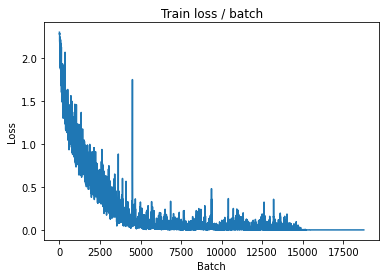

[TRAIN Batch 200/391]	Time 0.050s (0.036s)	Loss 0.0001 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


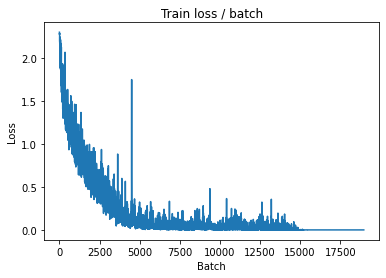


===============> Total time 13s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 2.2730 (2.2730)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.3285	Avg Prec@1 76.21 %	Avg Prec@5 97.98 %



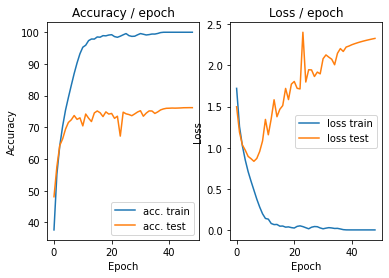

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


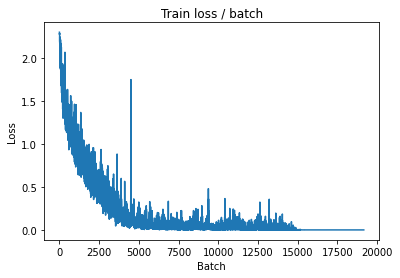

[TRAIN Batch 200/391]	Time 0.023s (0.037s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


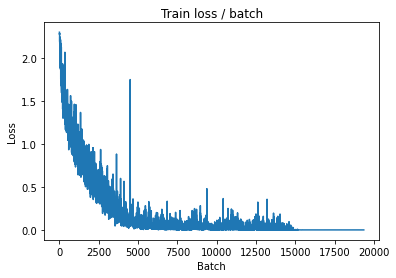


===============> Total time 14s	Avg loss 0.0000	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 2.2793 (2.2793)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 2.3353	Avg Prec@1 76.23 %	Avg Prec@5 97.97 %



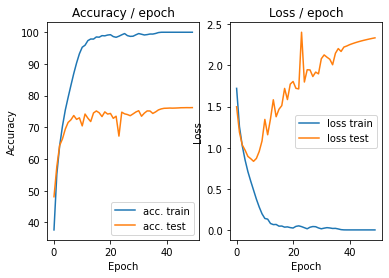

In [ ]:
main(128, 0.1,epochs=50, cuda=True)

##Data increse :

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.457s (0.457s)	Loss 2.3055 (2.3055)	Prec@1   7.8 (  7.8)	Prec@5  43.8 ( 43.8)


<Figure size 432x288 with 0 Axes>

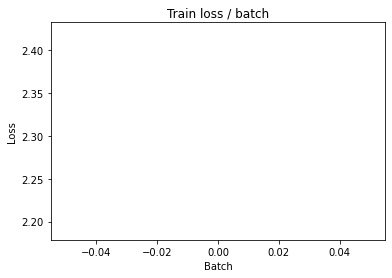

[TRAIN Batch 200/391]	Time 0.019s (0.047s)	Loss 1.8360 (1.9669)	Prec@1  32.8 ( 27.6)	Prec@5  79.7 ( 78.5)


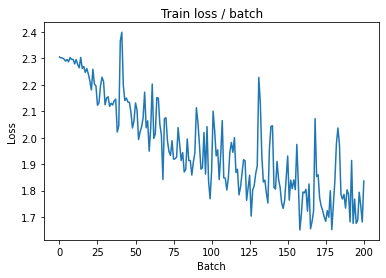


===============> Total time 18s	Avg loss 1.8067	Avg Prec@1 33.93 %	Avg Prec@5 83.68 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 1.8276 (1.8276)	Prec@1  35.2 ( 35.2)	Prec@5  85.2 ( 85.2)

===============> Total time 2s	Avg loss 1.7290	Avg Prec@1 37.02 %	Avg Prec@5 89.36 %



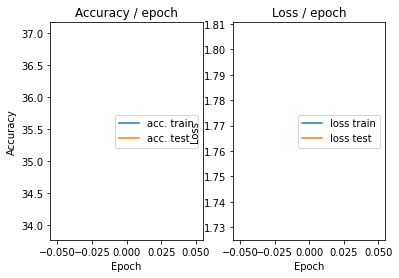

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 1.7685 (1.7685)	Prec@1  36.7 ( 36.7)	Prec@5  92.2 ( 92.2)


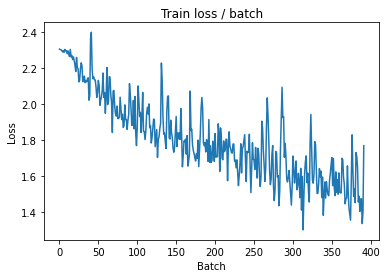

[TRAIN Batch 200/391]	Time 0.049s (0.046s)	Loss 1.3036 (1.4688)	Prec@1  53.9 ( 47.5)	Prec@5  92.2 ( 92.0)


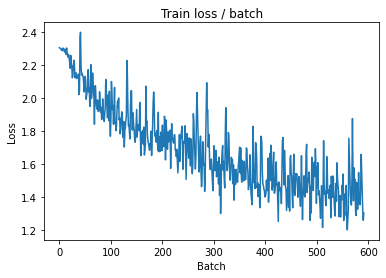


===============> Total time 17s	Avg loss 1.4068	Avg Prec@1 49.93 %	Avg Prec@5 92.91 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 1.1947 (1.1947)	Prec@1  60.2 ( 60.2)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.2271	Avg Prec@1 56.43 %	Avg Prec@5 95.05 %



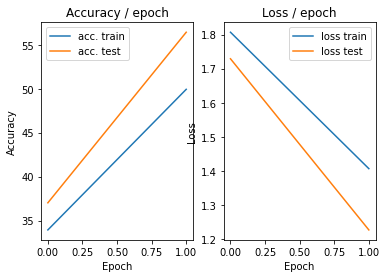

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 1.1517 (1.1517)	Prec@1  64.1 ( 64.1)	Prec@5  91.4 ( 91.4)


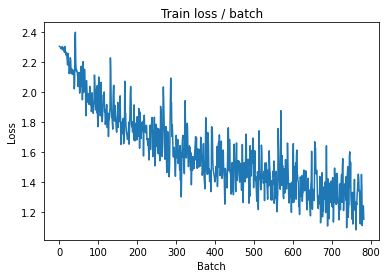

[TRAIN Batch 200/391]	Time 0.023s (0.045s)	Loss 1.1760 (1.2336)	Prec@1  57.0 ( 56.6)	Prec@5  95.3 ( 94.9)


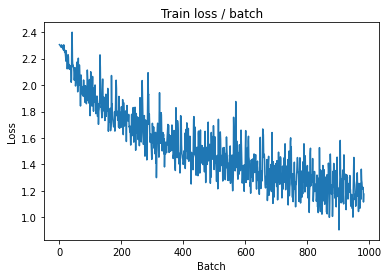


===============> Total time 17s	Avg loss 1.1933	Avg Prec@1 57.95 %	Avg Prec@5 95.19 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 1.1166 (1.1166)	Prec@1  61.7 ( 61.7)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.2450	Avg Prec@1 57.66 %	Avg Prec@5 94.60 %



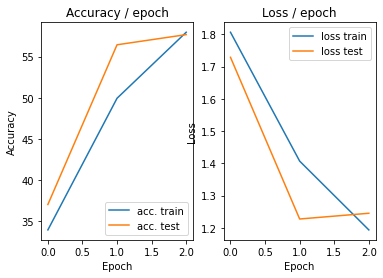

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 1.2924 (1.2924)	Prec@1  55.5 ( 55.5)	Prec@5  92.2 ( 92.2)


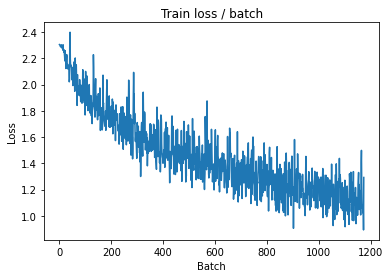

[TRAIN Batch 200/391]	Time 0.042s (0.045s)	Loss 1.0197 (1.0786)	Prec@1  66.4 ( 62.4)	Prec@5  96.9 ( 96.2)


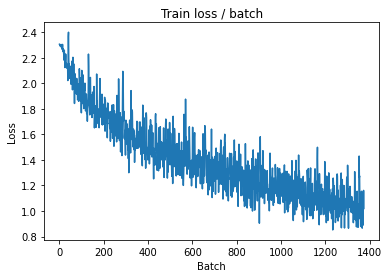


===============> Total time 17s	Avg loss 1.0486	Avg Prec@1 63.39 %	Avg Prec@5 96.48 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 1.1171 (1.1171)	Prec@1  63.3 ( 63.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1276	Avg Prec@1 62.16 %	Avg Prec@5 95.01 %



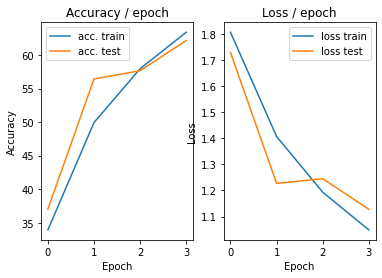

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 1.0600 (1.0600)	Prec@1  60.9 ( 60.9)	Prec@5  96.9 ( 96.9)


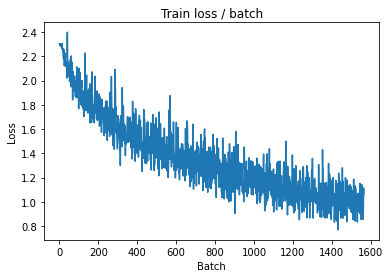

[TRAIN Batch 200/391]	Time 0.070s (0.045s)	Loss 1.1013 (0.9521)	Prec@1  64.8 ( 66.7)	Prec@5  93.0 ( 97.0)


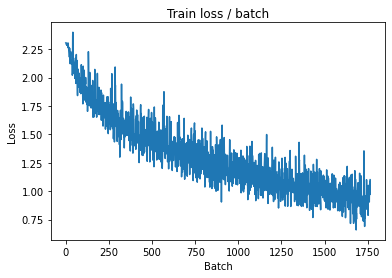


===============> Total time 17s	Avg loss 0.9328	Avg Prec@1 67.47 %	Avg Prec@5 97.16 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 0.9415 (0.9415)	Prec@1  69.5 ( 69.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9909	Avg Prec@1 65.22 %	Avg Prec@5 97.00 %



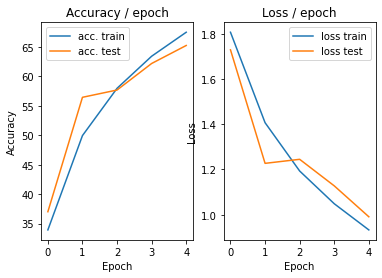

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.192s (0.192s)	Loss 0.8939 (0.8939)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)


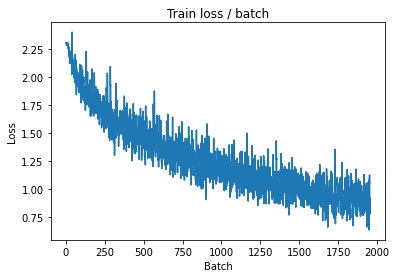

[TRAIN Batch 200/391]	Time 0.030s (0.045s)	Loss 0.7485 (0.8590)	Prec@1  76.6 ( 69.9)	Prec@5  98.4 ( 97.5)


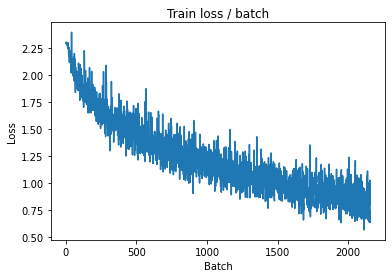


===============> Total time 17s	Avg loss 0.8483	Avg Prec@1 70.42 %	Avg Prec@5 97.62 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.8025 (0.8025)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8233	Avg Prec@1 70.96 %	Avg Prec@5 98.01 %



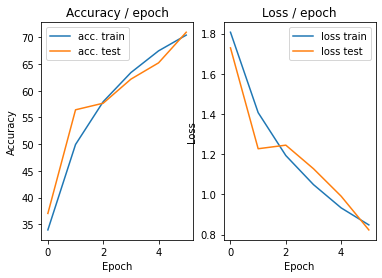

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.9039 (0.9039)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)


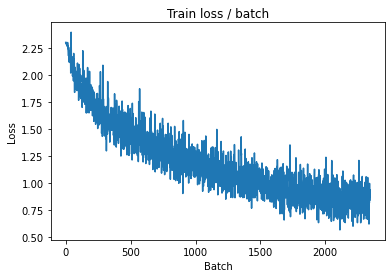

[TRAIN Batch 200/391]	Time 0.018s (0.045s)	Loss 0.8436 (0.7982)	Prec@1  70.3 ( 71.7)	Prec@5  95.3 ( 98.0)


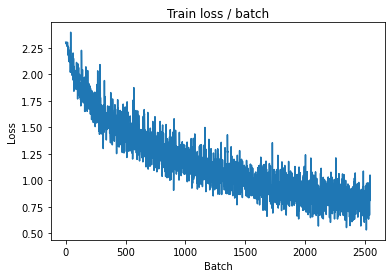


===============> Total time 17s	Avg loss 0.7818	Avg Prec@1 72.48 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.6749 (0.6749)	Prec@1  75.8 ( 75.8)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.8205	Avg Prec@1 70.67 %	Avg Prec@5 97.86 %



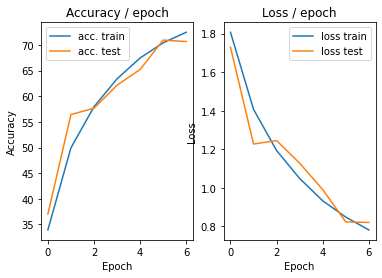

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.7397 (0.7397)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)


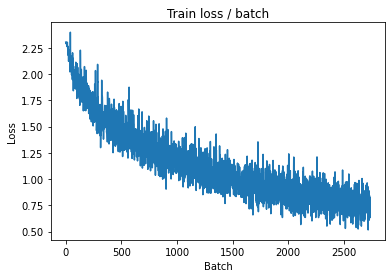

[TRAIN Batch 200/391]	Time 0.019s (0.045s)	Loss 0.6666 (0.7390)	Prec@1  82.0 ( 74.5)	Prec@5 100.0 ( 98.2)


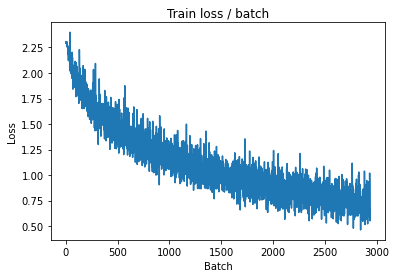


===============> Total time 17s	Avg loss 0.7260	Avg Prec@1 74.69 %	Avg Prec@5 98.38 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.7068 (0.7068)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8064	Avg Prec@1 72.37 %	Avg Prec@5 97.98 %



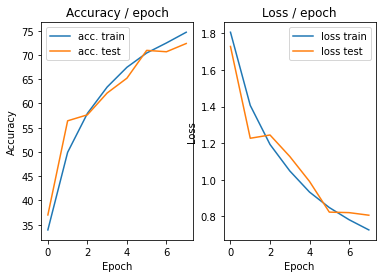

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.7699 (0.7699)	Prec@1  71.9 ( 71.9)	Prec@5  99.2 ( 99.2)


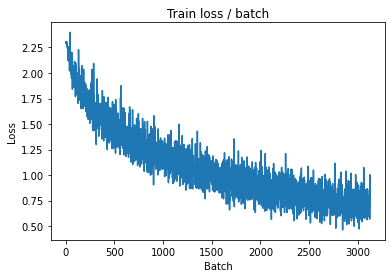

[TRAIN Batch 200/391]	Time 0.024s (0.045s)	Loss 0.5377 (0.6815)	Prec@1  82.0 ( 76.1)	Prec@5  98.4 ( 98.5)


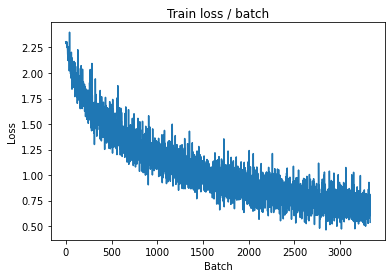


===============> Total time 17s	Avg loss 0.6792	Avg Prec@1 76.24 %	Avg Prec@5 98.50 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.7258 (0.7258)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7608	Avg Prec@1 74.16 %	Avg Prec@5 98.22 %



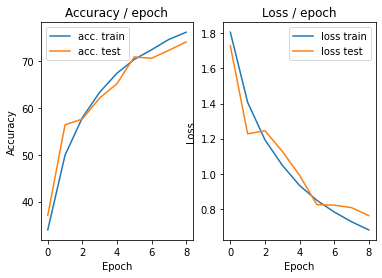

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.6222 (0.6222)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


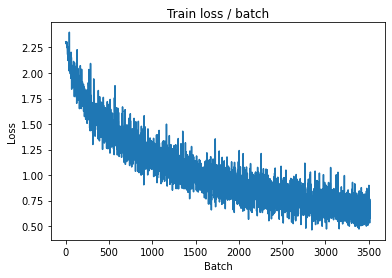

[TRAIN Batch 200/391]	Time 0.076s (0.045s)	Loss 0.5340 (0.6337)	Prec@1  81.2 ( 77.9)	Prec@5  99.2 ( 98.8)


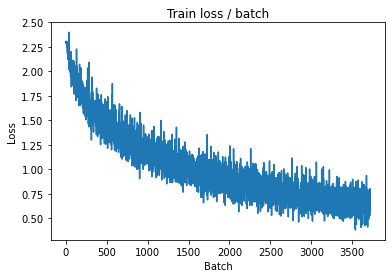


===============> Total time 17s	Avg loss 0.6364	Avg Prec@1 77.87 %	Avg Prec@5 98.75 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.6090 (0.6090)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6937	Avg Prec@1 76.35 %	Avg Prec@5 98.35 %



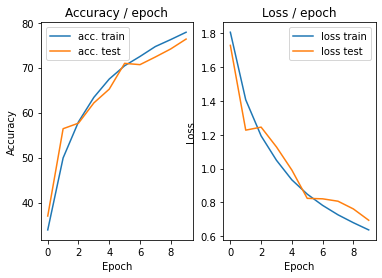

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.6820 (0.6820)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)


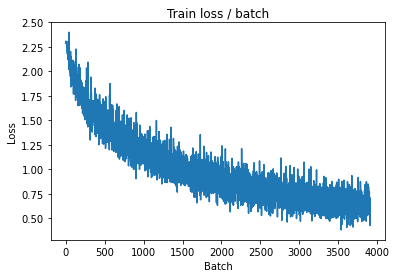

[TRAIN Batch 200/391]	Time 0.059s (0.046s)	Loss 0.6440 (0.6029)	Prec@1  74.2 ( 79.0)	Prec@5  99.2 ( 98.9)


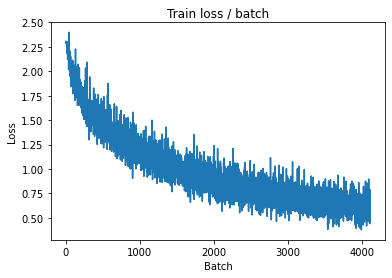


===============> Total time 17s	Avg loss 0.6018	Avg Prec@1 79.14 %	Avg Prec@5 98.86 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.7120 (0.7120)	Prec@1  70.3 ( 70.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7377	Avg Prec@1 74.66 %	Avg Prec@5 98.20 %



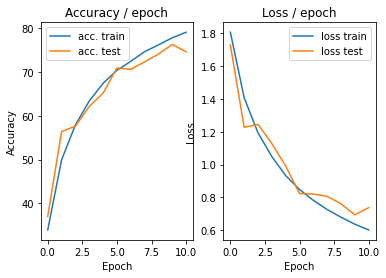

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 0.7477 (0.7477)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)


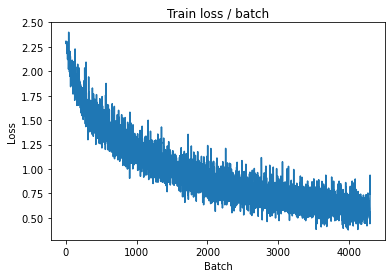

[TRAIN Batch 200/391]	Time 0.029s (0.046s)	Loss 0.7279 (0.5696)	Prec@1  75.0 ( 79.9)	Prec@5  97.7 ( 99.0)


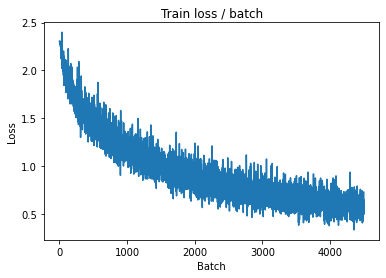


===============> Total time 17s	Avg loss 0.5656	Avg Prec@1 80.03 %	Avg Prec@5 99.02 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.7539 (0.7539)	Prec@1  75.8 ( 75.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7053	Avg Prec@1 76.26 %	Avg Prec@5 98.34 %



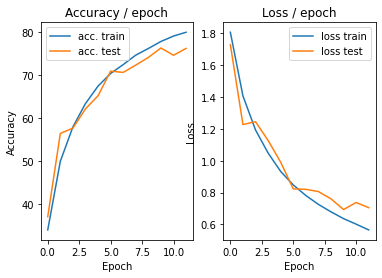

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.5659 (0.5659)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


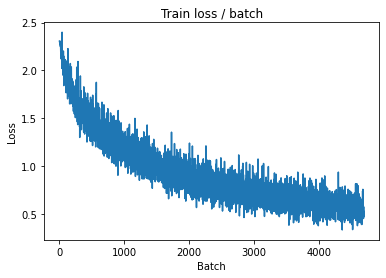

[TRAIN Batch 200/391]	Time 0.026s (0.046s)	Loss 0.5757 (0.5305)	Prec@1  82.0 ( 81.4)	Prec@5 100.0 ( 99.2)


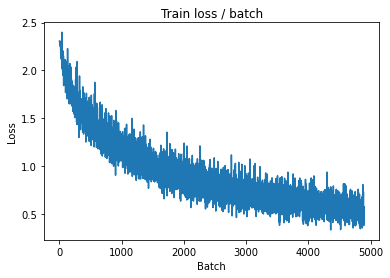


===============> Total time 17s	Avg loss 0.5402	Avg Prec@1 81.12 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 0.7125 (0.7125)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6924	Avg Prec@1 76.48 %	Avg Prec@5 98.28 %



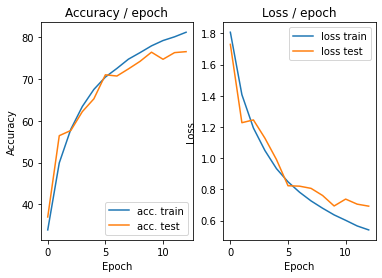

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.5837 (0.5837)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


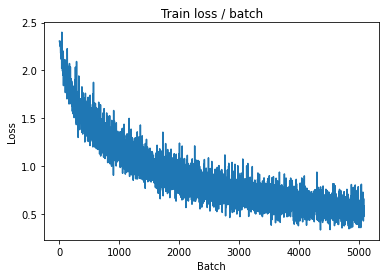

[TRAIN Batch 200/391]	Time 0.032s (0.045s)	Loss 0.5748 (0.5040)	Prec@1  78.9 ( 82.4)	Prec@5  98.4 ( 99.2)


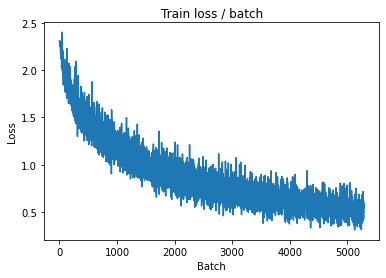


===============> Total time 17s	Avg loss 0.5135	Avg Prec@1 82.15 %	Avg Prec@5 99.24 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.6665 (0.6665)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6624	Avg Prec@1 77.61 %	Avg Prec@5 98.36 %



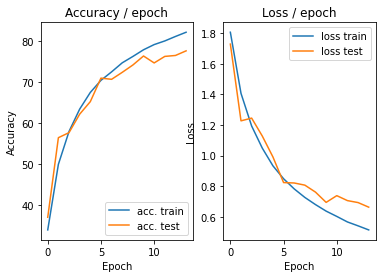

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.4464 (0.4464)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)


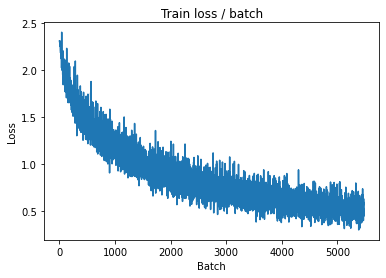

[TRAIN Batch 200/391]	Time 0.059s (0.047s)	Loss 0.4572 (0.4859)	Prec@1  83.6 ( 82.8)	Prec@5  99.2 ( 99.3)


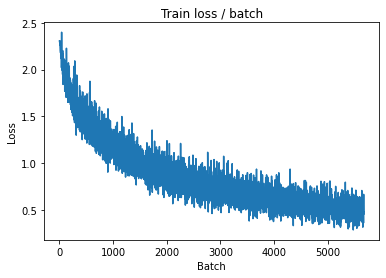


===============> Total time 17s	Avg loss 0.4888	Avg Prec@1 82.73 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 0.7180 (0.7180)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7056	Avg Prec@1 77.07 %	Avg Prec@5 98.32 %



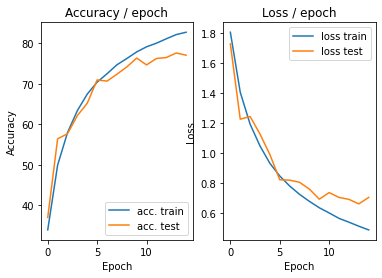

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.4899 (0.4899)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


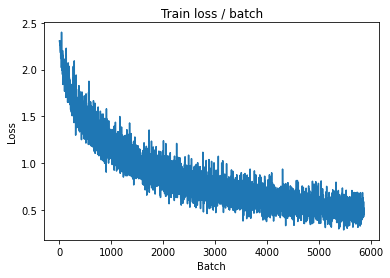

[TRAIN Batch 200/391]	Time 0.041s (0.045s)	Loss 0.4599 (0.4551)	Prec@1  85.2 ( 84.2)	Prec@5  98.4 ( 99.4)


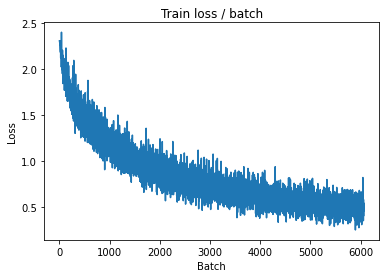


===============> Total time 17s	Avg loss 0.4632	Avg Prec@1 83.84 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.7309 (0.7309)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7016	Avg Prec@1 76.96 %	Avg Prec@5 98.56 %



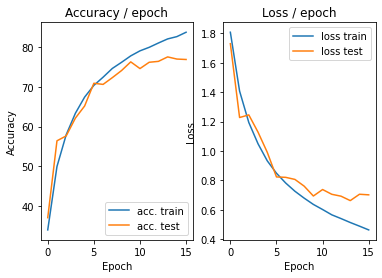

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.4772 (0.4772)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


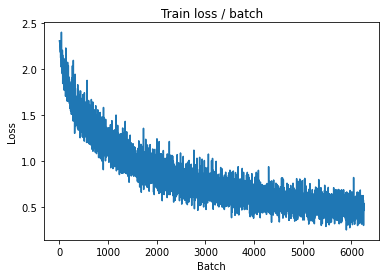

[TRAIN Batch 200/391]	Time 0.041s (0.045s)	Loss 0.5691 (0.4424)	Prec@1  78.9 ( 84.5)	Prec@5  98.4 ( 99.5)


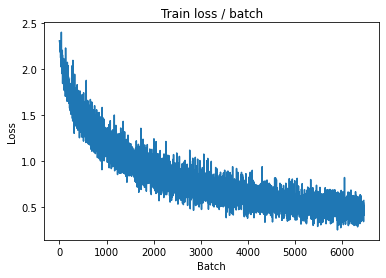


===============> Total time 17s	Avg loss 0.4440	Avg Prec@1 84.46 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.6849 (0.6849)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6949	Avg Prec@1 77.29 %	Avg Prec@5 98.38 %



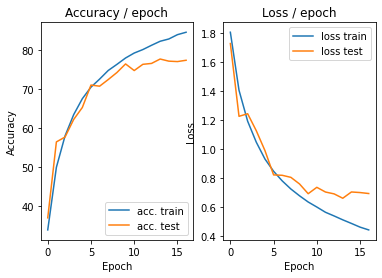

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.5291 (0.5291)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)


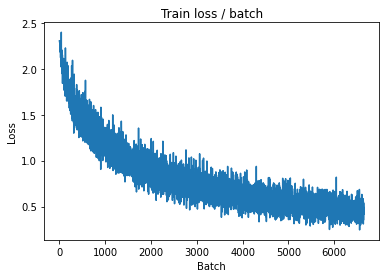

[TRAIN Batch 200/391]	Time 0.081s (0.045s)	Loss 0.4058 (0.4098)	Prec@1  87.5 ( 85.8)	Prec@5 100.0 ( 99.5)


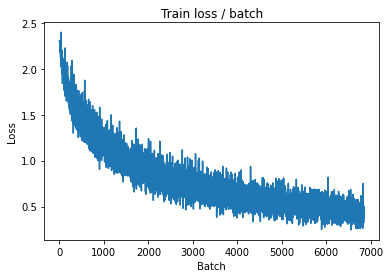


===============> Total time 17s	Avg loss 0.4203	Avg Prec@1 85.36 %	Avg Prec@5 99.53 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.9083 (0.9083)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8154	Avg Prec@1 74.70 %	Avg Prec@5 98.05 %



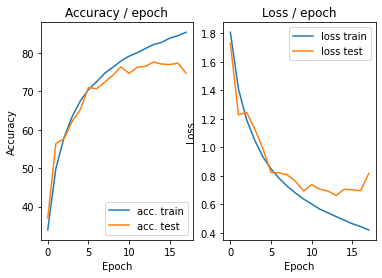

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.5565 (0.5565)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


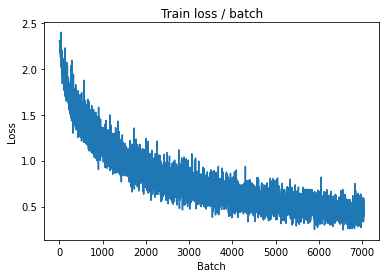

[TRAIN Batch 200/391]	Time 0.029s (0.047s)	Loss 0.4835 (0.4070)	Prec@1  83.6 ( 85.6)	Prec@5  99.2 ( 99.6)


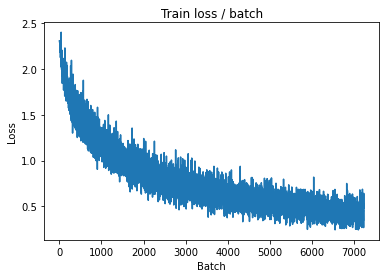


===============> Total time 17s	Avg loss 0.4081	Avg Prec@1 85.63 %	Avg Prec@5 99.54 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.6849 (0.6849)	Prec@1  81.2 ( 81.2)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.6991	Avg Prec@1 78.01 %	Avg Prec@5 98.35 %



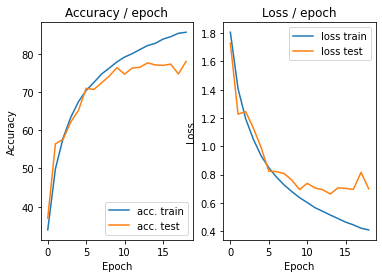

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.226s (0.226s)	Loss 0.4534 (0.4534)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


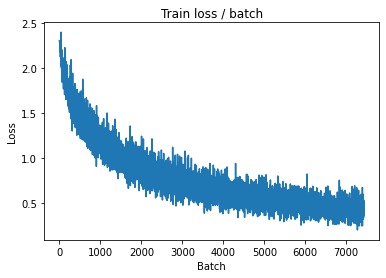

[TRAIN Batch 200/391]	Time 0.045s (0.045s)	Loss 0.4462 (0.3839)	Prec@1  82.8 ( 86.6)	Prec@5 100.0 ( 99.6)


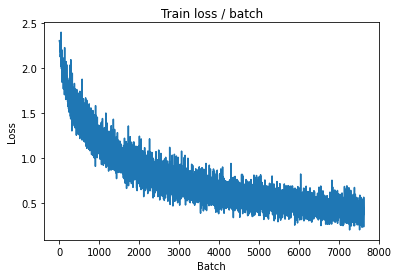


===============> Total time 17s	Avg loss 0.3961	Avg Prec@1 86.14 %	Avg Prec@5 99.60 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 0.6327 (0.6327)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7197	Avg Prec@1 77.70 %	Avg Prec@5 98.28 %



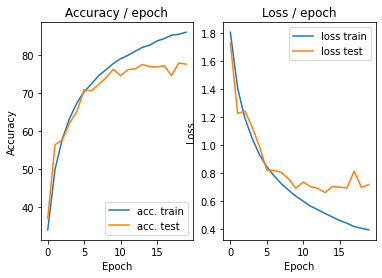

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.4087 (0.4087)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


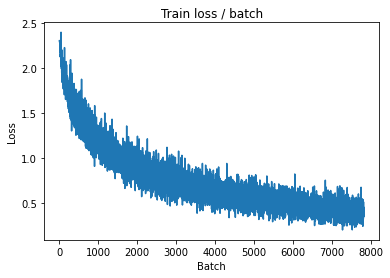

[TRAIN Batch 200/391]	Time 0.019s (0.045s)	Loss 0.3901 (0.3690)	Prec@1  85.9 ( 87.0)	Prec@5  98.4 ( 99.7)


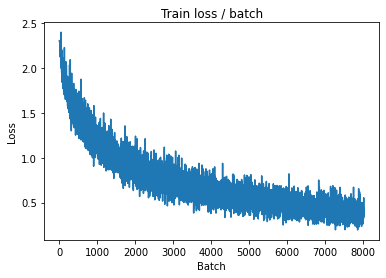


===============> Total time 17s	Avg loss 0.3754	Avg Prec@1 86.91 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.7743 (0.7743)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6574	Avg Prec@1 79.60 %	Avg Prec@5 98.56 %



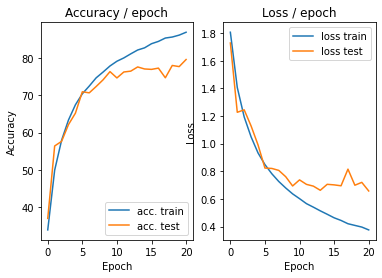

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.3860 (0.3860)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


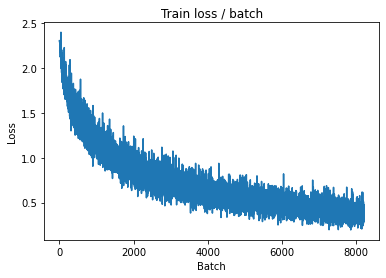

[TRAIN Batch 200/391]	Time 0.065s (0.045s)	Loss 0.2195 (0.3511)	Prec@1  89.8 ( 87.7)	Prec@5 100.0 ( 99.7)


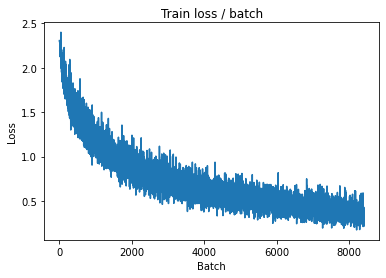


===============> Total time 17s	Avg loss 0.3589	Avg Prec@1 87.43 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.7365 (0.7365)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6393	Avg Prec@1 80.09 %	Avg Prec@5 98.62 %



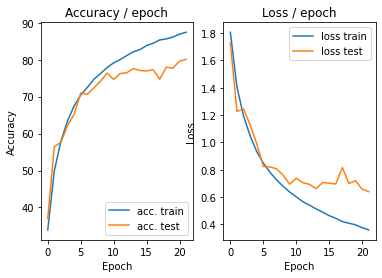

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.3671 (0.3671)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


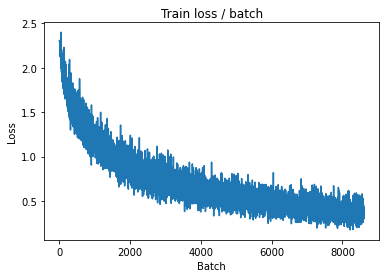

[TRAIN Batch 200/391]	Time 0.050s (0.047s)	Loss 0.3409 (0.3314)	Prec@1  89.8 ( 88.5)	Prec@5 100.0 ( 99.7)


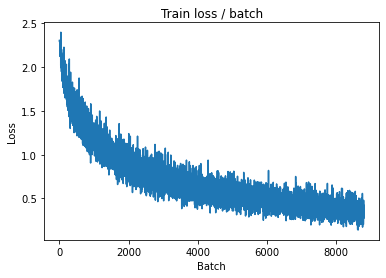


===============> Total time 17s	Avg loss 0.3453	Avg Prec@1 87.93 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 0.7277 (0.7277)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6868	Avg Prec@1 78.71 %	Avg Prec@5 98.64 %



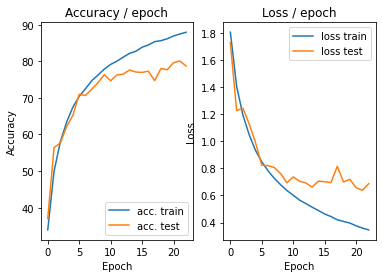

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 0.4744 (0.4744)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


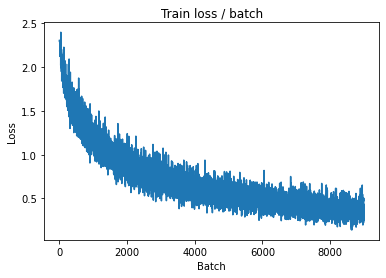

[TRAIN Batch 200/391]	Time 0.044s (0.046s)	Loss 0.3864 (0.3232)	Prec@1  88.3 ( 88.7)	Prec@5  99.2 ( 99.8)


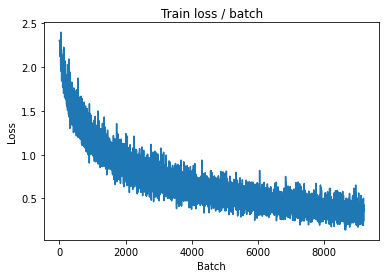


===============> Total time 17s	Avg loss 0.3327	Avg Prec@1 88.31 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 0.8145 (0.8145)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6636	Avg Prec@1 79.61 %	Avg Prec@5 98.49 %



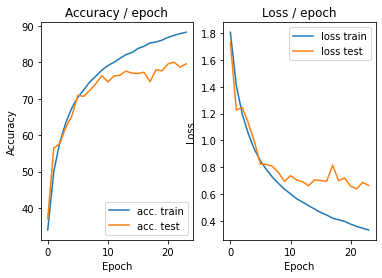

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.3542 (0.3542)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


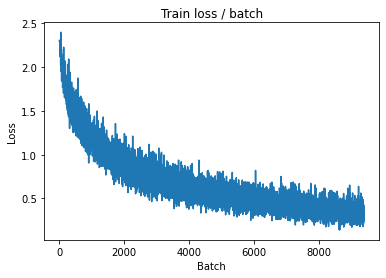

[TRAIN Batch 200/391]	Time 0.030s (0.046s)	Loss 0.3978 (0.3069)	Prec@1  84.4 ( 89.3)	Prec@5 100.0 ( 99.8)


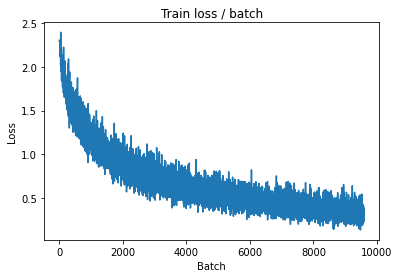


===============> Total time 17s	Avg loss 0.3120	Avg Prec@1 89.14 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.6719 (0.6719)	Prec@1  79.7 ( 79.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7003	Avg Prec@1 79.30 %	Avg Prec@5 98.54 %



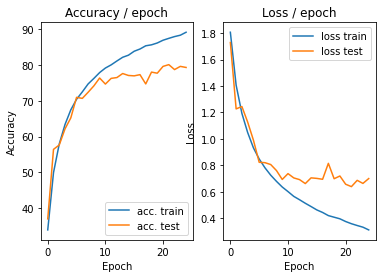

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.2367 (0.2367)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


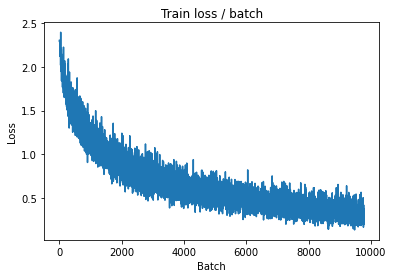

[TRAIN Batch 200/391]	Time 0.063s (0.046s)	Loss 0.2511 (0.2908)	Prec@1  92.2 ( 89.9)	Prec@5 100.0 ( 99.8)


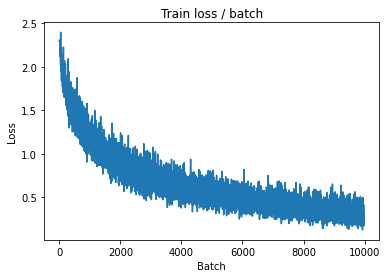


===============> Total time 17s	Avg loss 0.3004	Avg Prec@1 89.52 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.8215 (0.8215)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6708	Avg Prec@1 80.77 %	Avg Prec@5 98.33 %



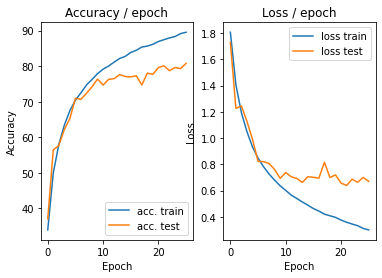

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.226s (0.226s)	Loss 0.2119 (0.2119)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


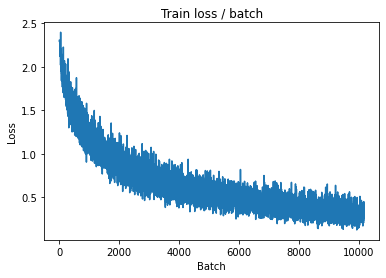

[TRAIN Batch 200/391]	Time 0.050s (0.047s)	Loss 0.3637 (0.2741)	Prec@1  89.1 ( 90.7)	Prec@5  99.2 ( 99.8)


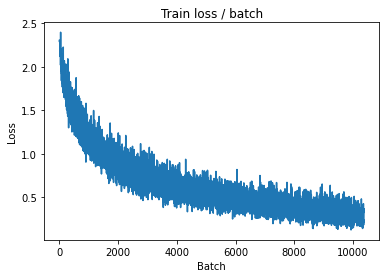


===============> Total time 17s	Avg loss 0.2925	Avg Prec@1 89.99 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 0.7392 (0.7392)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7069	Avg Prec@1 79.94 %	Avg Prec@5 98.49 %



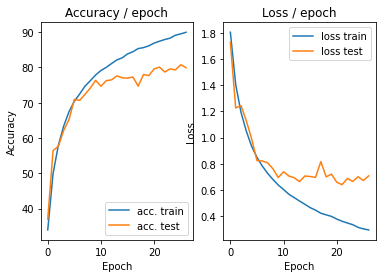

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.2271 (0.2271)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


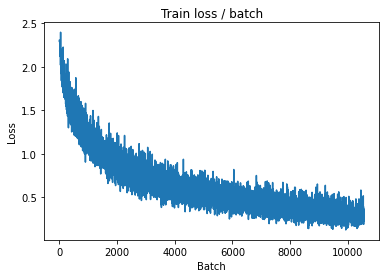

[TRAIN Batch 200/391]	Time 0.075s (0.046s)	Loss 0.3241 (0.2763)	Prec@1  86.7 ( 90.4)	Prec@5 100.0 ( 99.8)


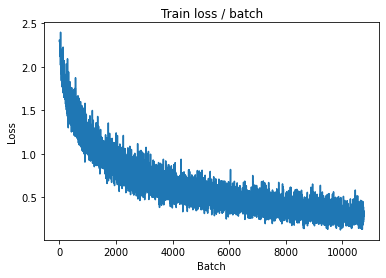


===============> Total time 17s	Avg loss 0.2855	Avg Prec@1 89.99 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.9792 (0.9792)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7906	Avg Prec@1 78.60 %	Avg Prec@5 98.23 %



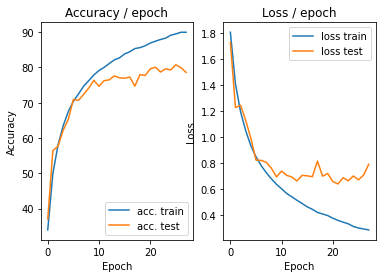

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.3064 (0.3064)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


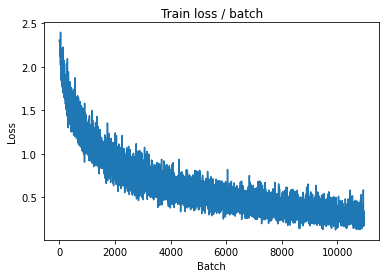

[TRAIN Batch 200/391]	Time 0.031s (0.045s)	Loss 0.1296 (0.2674)	Prec@1  96.1 ( 90.5)	Prec@5 100.0 ( 99.9)


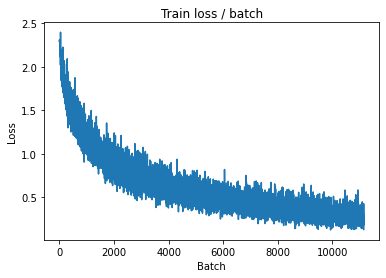


===============> Total time 17s	Avg loss 0.2777	Avg Prec@1 90.19 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.8443 (0.8443)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7496	Avg Prec@1 79.44 %	Avg Prec@5 98.48 %



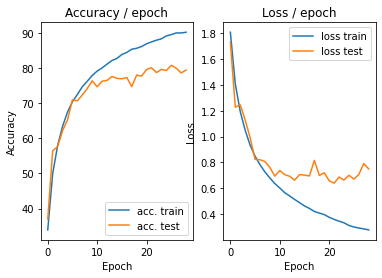

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.2777 (0.2777)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


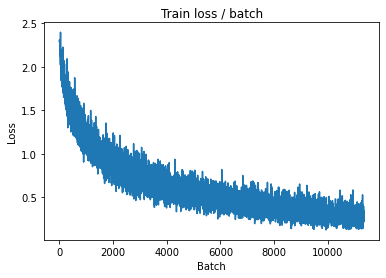

[TRAIN Batch 200/391]	Time 0.059s (0.045s)	Loss 0.3427 (0.2639)	Prec@1  91.4 ( 90.9)	Prec@5 100.0 ( 99.9)


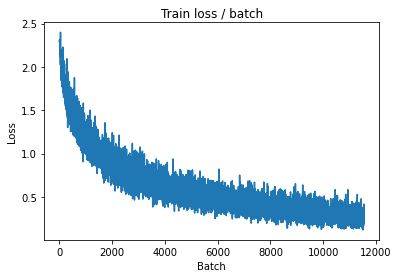


===============> Total time 17s	Avg loss 0.2626	Avg Prec@1 90.94 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 0.8896 (0.8896)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7766	Avg Prec@1 78.13 %	Avg Prec@5 98.40 %



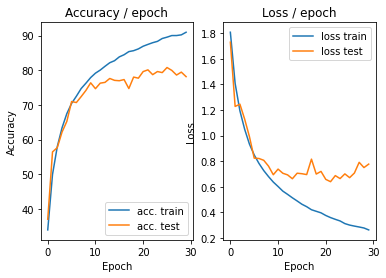

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.2858 (0.2858)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


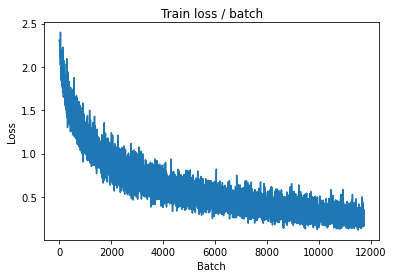

[TRAIN Batch 200/391]	Time 0.053s (0.046s)	Loss 0.2437 (0.2412)	Prec@1  93.0 ( 91.6)	Prec@5 100.0 ( 99.9)


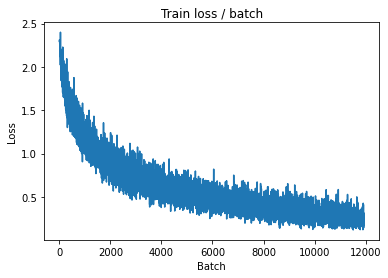


===============> Total time 17s	Avg loss 0.2496	Avg Prec@1 91.40 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.8469 (0.8469)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6887	Avg Prec@1 80.60 %	Avg Prec@5 98.58 %



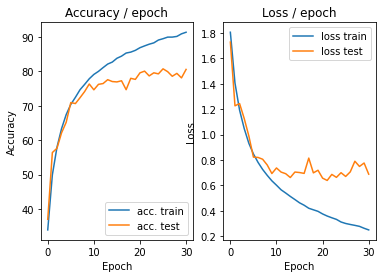

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.2270 (0.2270)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


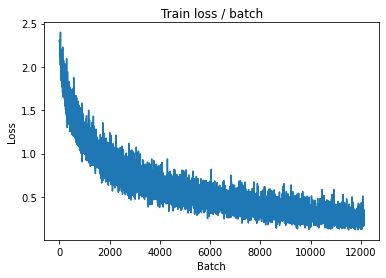

[TRAIN Batch 200/391]	Time 0.019s (0.046s)	Loss 0.2644 (0.2429)	Prec@1  89.1 ( 91.5)	Prec@5 100.0 ( 99.9)


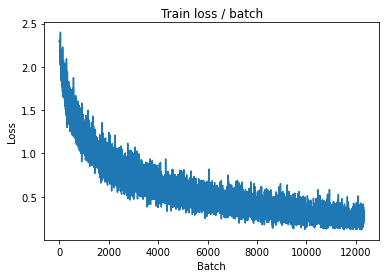


===============> Total time 17s	Avg loss 0.2521	Avg Prec@1 91.18 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.9179 (0.9179)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7148	Avg Prec@1 80.85 %	Avg Prec@5 98.59 %



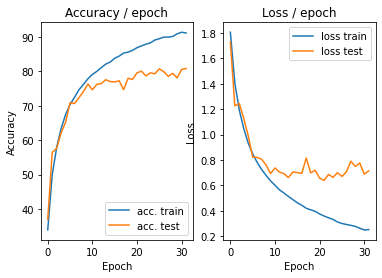

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 0.2073 (0.2073)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


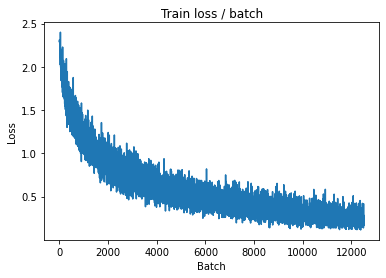

[TRAIN Batch 200/391]	Time 0.020s (0.045s)	Loss 0.2722 (0.2309)	Prec@1  89.8 ( 92.0)	Prec@5 100.0 ( 99.9)


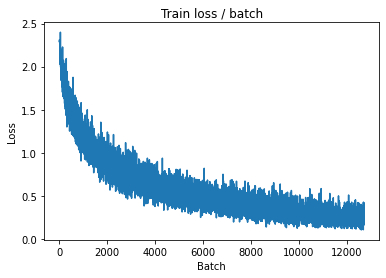


===============> Total time 17s	Avg loss 0.2393	Avg Prec@1 91.75 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 0.7811 (0.7811)	Prec@1  80.5 ( 80.5)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 0.7328	Avg Prec@1 80.09 %	Avg Prec@5 98.41 %



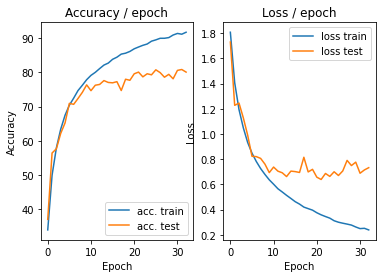

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 0.1778 (0.1778)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


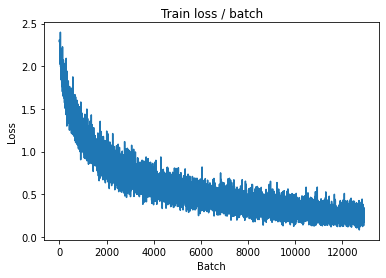

[TRAIN Batch 200/391]	Time 0.019s (0.045s)	Loss 0.1735 (0.2340)	Prec@1  94.5 ( 91.8)	Prec@5 100.0 ( 99.9)


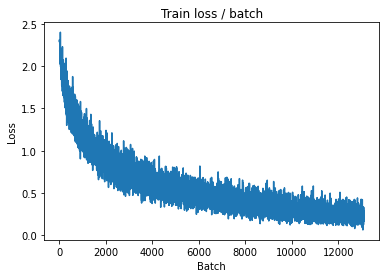


===============> Total time 17s	Avg loss 0.2352	Avg Prec@1 91.74 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.8814 (0.8814)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7513	Avg Prec@1 79.94 %	Avg Prec@5 98.52 %



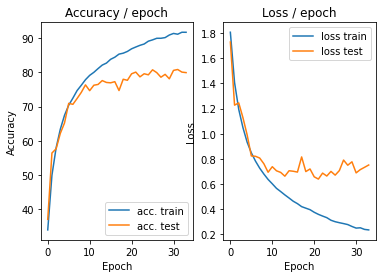

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.1465 (0.1465)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


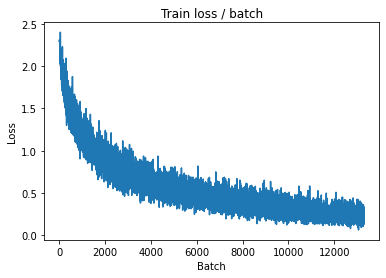

[TRAIN Batch 200/391]	Time 0.023s (0.046s)	Loss 0.2670 (0.2179)	Prec@1  89.1 ( 92.4)	Prec@5 100.0 ( 99.9)


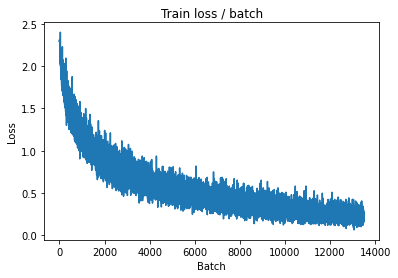


===============> Total time 17s	Avg loss 0.2334	Avg Prec@1 91.88 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.9621 (0.9621)	Prec@1  80.5 ( 80.5)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7707	Avg Prec@1 79.24 %	Avg Prec@5 98.41 %



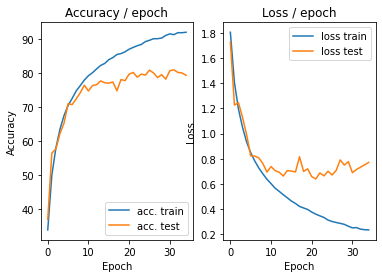

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 0.2759 (0.2759)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


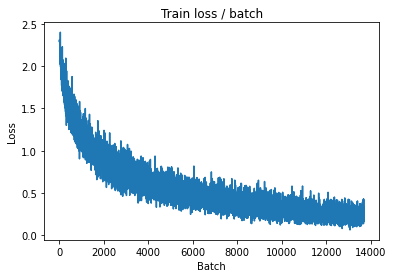

[TRAIN Batch 200/391]	Time 0.046s (0.045s)	Loss 0.2026 (0.2141)	Prec@1  96.1 ( 92.4)	Prec@5 100.0 ( 99.9)


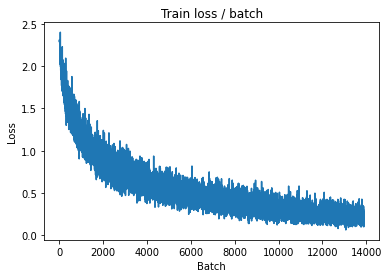


===============> Total time 17s	Avg loss 0.2211	Avg Prec@1 92.33 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.7940 (0.7940)	Prec@1  83.6 ( 83.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7991	Avg Prec@1 80.07 %	Avg Prec@5 98.40 %



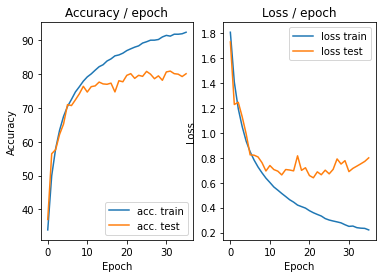

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.1226 (0.1226)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


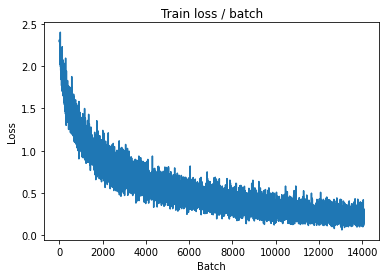

[TRAIN Batch 200/391]	Time 0.020s (0.044s)	Loss 0.1081 (0.2068)	Prec@1  95.3 ( 92.8)	Prec@5 100.0 ( 99.9)


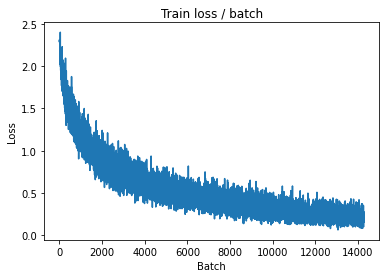


===============> Total time 17s	Avg loss 0.2158	Avg Prec@1 92.41 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.9208 (0.9208)	Prec@1  79.7 ( 79.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7865	Avg Prec@1 79.72 %	Avg Prec@5 98.54 %



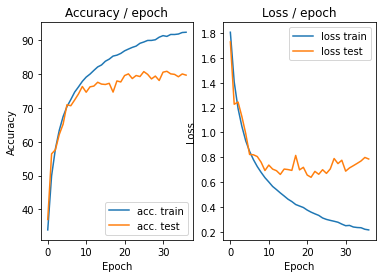

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 0.1973 (0.1973)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


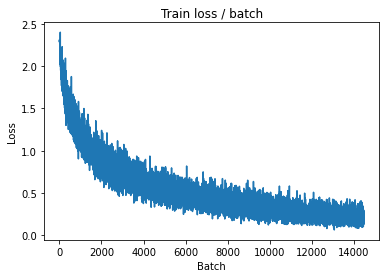

[TRAIN Batch 200/391]	Time 0.057s (0.045s)	Loss 0.2851 (0.2025)	Prec@1  90.6 ( 93.1)	Prec@5 100.0 ( 99.9)


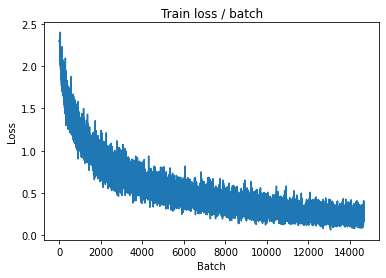


===============> Total time 17s	Avg loss 0.2067	Avg Prec@1 92.93 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.8097 (0.8097)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7712	Avg Prec@1 79.88 %	Avg Prec@5 98.66 %



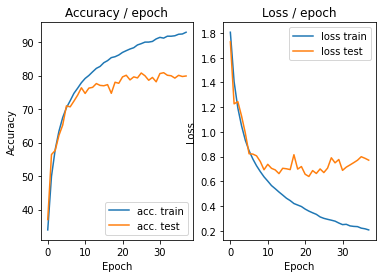

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.2308 (0.2308)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)


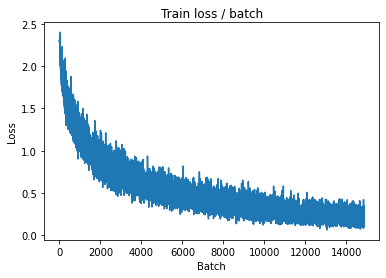

[TRAIN Batch 200/391]	Time 0.089s (0.046s)	Loss 0.2518 (0.1978)	Prec@1  95.3 ( 93.2)	Prec@5 100.0 ( 99.9)


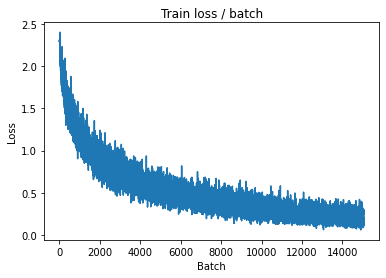


===============> Total time 17s	Avg loss 0.2046	Avg Prec@1 92.90 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.8409 (0.8409)	Prec@1  78.1 ( 78.1)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7807	Avg Prec@1 79.91 %	Avg Prec@5 98.50 %



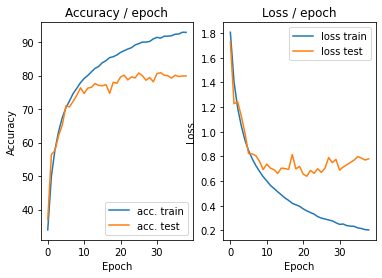

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.2170 (0.2170)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


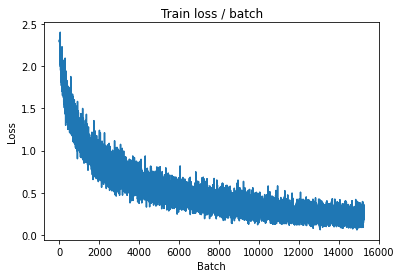

[TRAIN Batch 200/391]	Time 0.019s (0.045s)	Loss 0.1788 (0.1916)	Prec@1  93.0 ( 93.4)	Prec@5  99.2 ( 99.9)


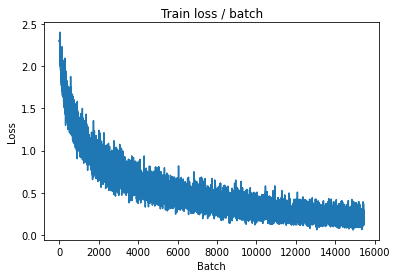


===============> Total time 17s	Avg loss 0.2022	Avg Prec@1 93.02 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 1.0317 (1.0317)	Prec@1  78.9 ( 78.9)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7705	Avg Prec@1 80.90 %	Avg Prec@5 98.70 %



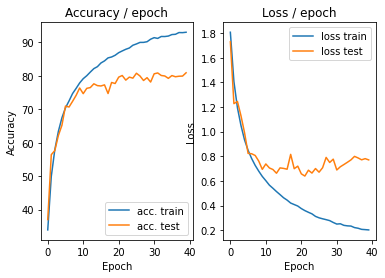

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.2961 (0.2961)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


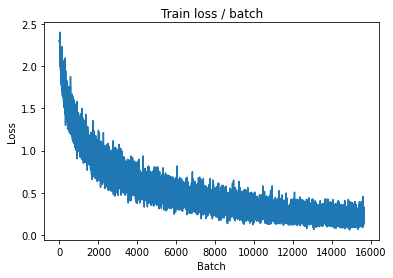

[TRAIN Batch 200/391]	Time 0.029s (0.046s)	Loss 0.1714 (0.1942)	Prec@1  93.8 ( 93.3)	Prec@5 100.0 ( 99.9)


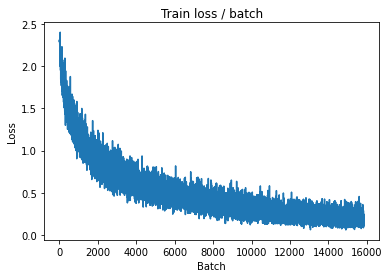


===============> Total time 17s	Avg loss 0.2010	Avg Prec@1 93.00 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 1.1084 (1.1084)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8017	Avg Prec@1 80.17 %	Avg Prec@5 98.45 %



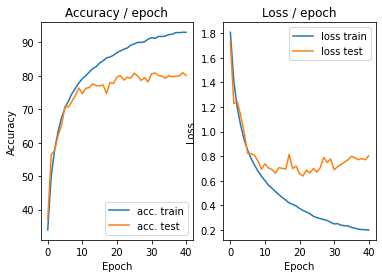

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.1441 (0.1441)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


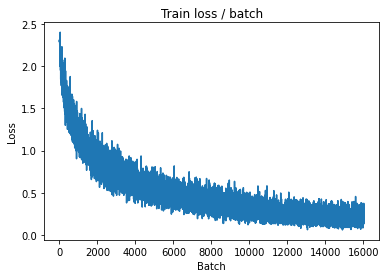

[TRAIN Batch 200/391]	Time 0.042s (0.045s)	Loss 0.1490 (0.1872)	Prec@1  95.3 ( 93.5)	Prec@5 100.0 (100.0)


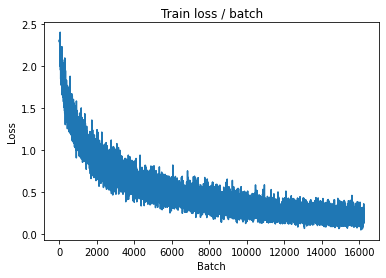


===============> Total time 17s	Avg loss 0.1936	Avg Prec@1 93.19 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.9360 (0.9360)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8156	Avg Prec@1 80.64 %	Avg Prec@5 98.57 %



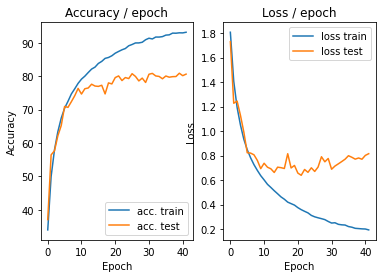

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.1866 (0.1866)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


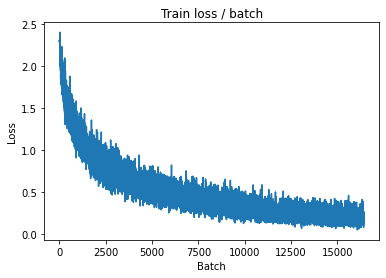

[TRAIN Batch 200/391]	Time 0.055s (0.045s)	Loss 0.1469 (0.1832)	Prec@1  92.2 ( 93.8)	Prec@5 100.0 (100.0)


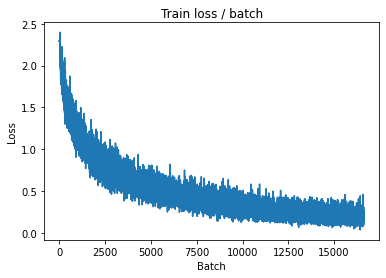


===============> Total time 17s	Avg loss 0.1847	Avg Prec@1 93.71 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.9932 (0.9932)	Prec@1  82.8 ( 82.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8367	Avg Prec@1 79.92 %	Avg Prec@5 98.52 %



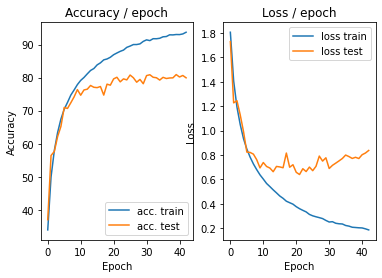

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.1471 (0.1471)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


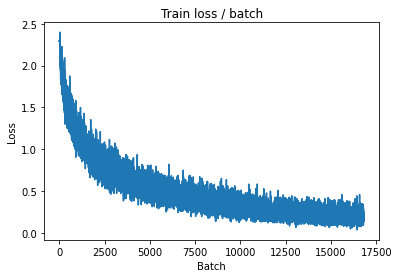

[TRAIN Batch 200/391]	Time 0.069s (0.045s)	Loss 0.1809 (0.1872)	Prec@1  93.8 ( 93.5)	Prec@5  99.2 ( 99.9)


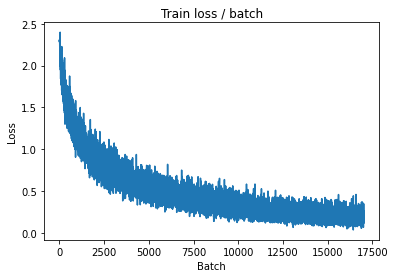


===============> Total time 17s	Avg loss 0.1893	Avg Prec@1 93.47 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 1.0609 (1.0609)	Prec@1  79.7 ( 79.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8838	Avg Prec@1 79.38 %	Avg Prec@5 98.22 %



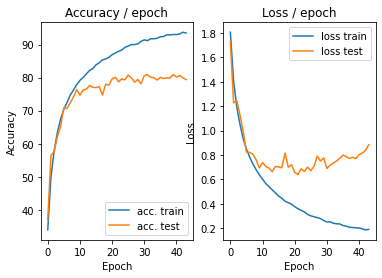

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.1122 (0.1122)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


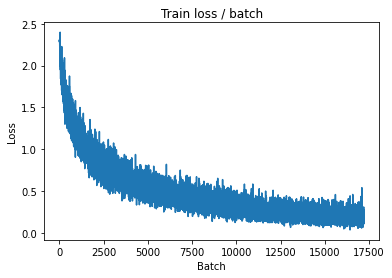

[TRAIN Batch 200/391]	Time 0.067s (0.045s)	Loss 0.1707 (0.1639)	Prec@1  93.0 ( 94.3)	Prec@5 100.0 ( 99.9)


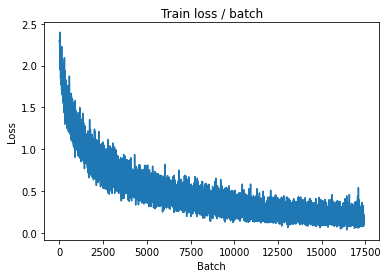


===============> Total time 17s	Avg loss 0.1755	Avg Prec@1 93.99 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 1.0115 (1.0115)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8341	Avg Prec@1 80.40 %	Avg Prec@5 98.41 %



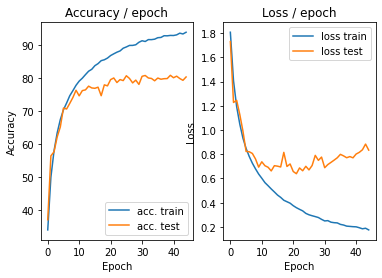

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.1345 (0.1345)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


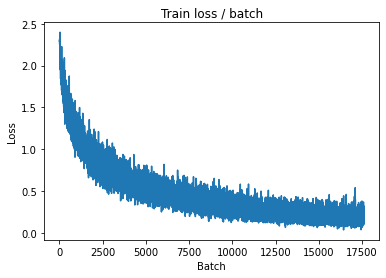

[TRAIN Batch 200/391]	Time 0.048s (0.046s)	Loss 0.1039 (0.1656)	Prec@1  96.1 ( 94.3)	Prec@5 100.0 ( 99.9)


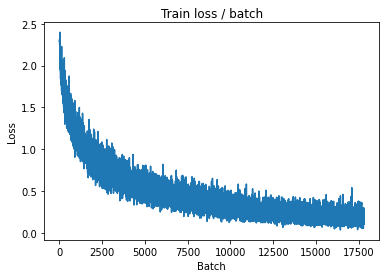


===============> Total time 17s	Avg loss 0.1710	Avg Prec@1 94.11 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 1.0357 (1.0357)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8870	Avg Prec@1 79.70 %	Avg Prec@5 98.64 %



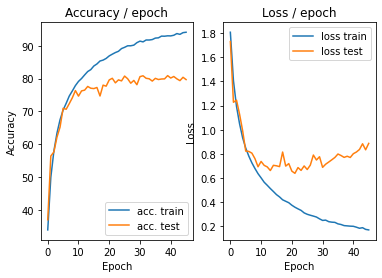

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.0862 (0.0862)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


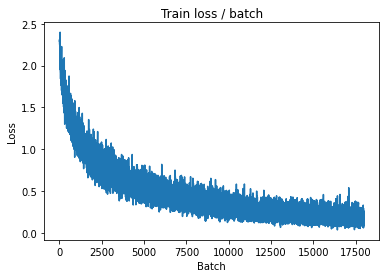

[TRAIN Batch 200/391]	Time 0.050s (0.045s)	Loss 0.0957 (0.1645)	Prec@1  96.1 ( 94.3)	Prec@5 100.0 (100.0)


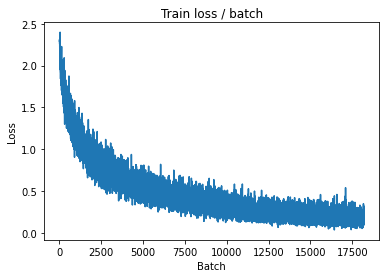


===============> Total time 17s	Avg loss 0.1743	Avg Prec@1 94.03 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.9159 (0.9159)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8353	Avg Prec@1 80.23 %	Avg Prec@5 98.61 %



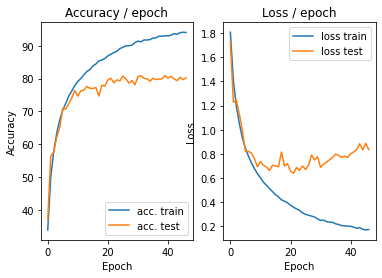

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.0930 (0.0930)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


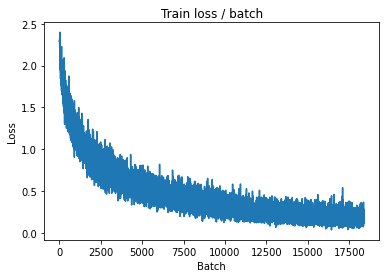

[TRAIN Batch 200/391]	Time 0.018s (0.046s)	Loss 0.1636 (0.1648)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 ( 99.9)


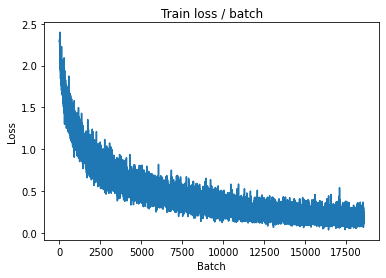


===============> Total time 17s	Avg loss 0.1748	Avg Prec@1 94.11 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 1.0378 (1.0378)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9166	Avg Prec@1 78.99 %	Avg Prec@5 98.24 %



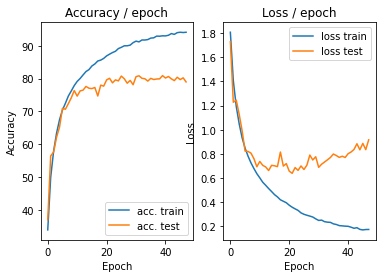

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 0.1469 (0.1469)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


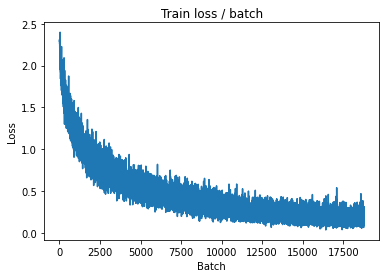

[TRAIN Batch 200/391]	Time 0.022s (0.045s)	Loss 0.2038 (0.1614)	Prec@1  92.2 ( 94.4)	Prec@5 100.0 (100.0)


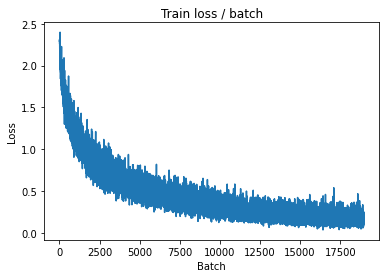


===============> Total time 17s	Avg loss 0.1658	Avg Prec@1 94.37 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 1.0655 (1.0655)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8539	Avg Prec@1 80.54 %	Avg Prec@5 98.37 %



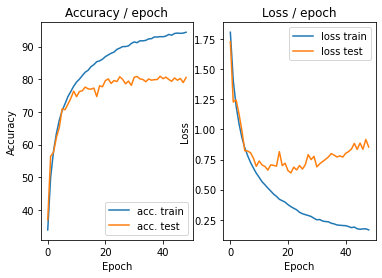

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.1250 (0.1250)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


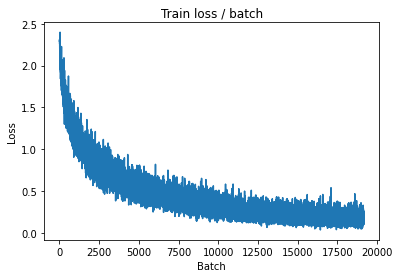

[TRAIN Batch 200/391]	Time 0.025s (0.045s)	Loss 0.2758 (0.1585)	Prec@1  92.2 ( 94.5)	Prec@5 100.0 (100.0)


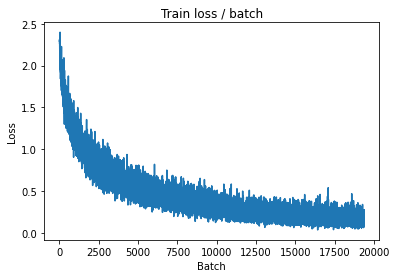


===============> Total time 17s	Avg loss 0.1650	Avg Prec@1 94.29 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 0.8953 (0.8953)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8700	Avg Prec@1 80.06 %	Avg Prec@5 98.30 %



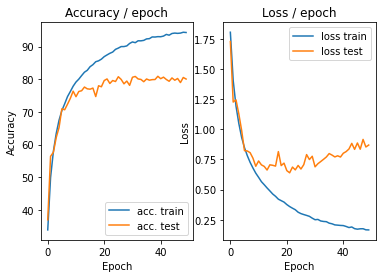

In [ ]:
main(128, 0.1,epochs=50, cuda=True)

##ZCA :

In [ ]:

def computeZCAMAtrix():


    
    temp= datasets.CIFAR10(PATH,
                                  train = True,
                                  download = True)
        

    #normalize the data to [0 1] range
    temp.data=temp.data/255
    
    #compute mean and std and normalize the data to -1 1 range with 1 std
    mean=(temp.data.mean(axis=(0,1,2)))
    std=(temp.data.std(axis=(0,1,2)))   
    temp.data=np.multiply(1/std,np.add(temp.data,-mean)) 
    
    
    #reshape data from M x C x W x H to M x N where N=C x W x H 
    X = temp.data
    X = X.reshape(-1, 3072)
    
    # compute the covariance 
    cov = np.cov(X, rowvar=False)   # cov is (N, N)
    
    # singular value decomposition
    U,S,V = np.linalg.svd(cov)     # U is (N, N), S is (N,1) V is (N,N)
    # build the ZCA matrix which is (N,N)
    epsilon = 1e-5
    zca_matrix = np.dot(U, np.dot(np.diag(1.0/np.sqrt(S + epsilon)), U.T))
  


    return (torch.from_numpy(zca_matrix).float(), mean, std)  


In [ ]:
(Z,mean,std) = computeZCAMAtrix()

Files already downloaded and verified


In [ ]:


def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.LinearTransformation(transformation_matrix=Z, 
                                            mean_vector=mean)
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.LinearTransformation(transformation_matrix=Z, 
                                            mean_vector=mean)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



In [ ]:
main(128, 0.1,epochs=50, cuda=True)

TypeError: ignored

##Add noise, RandomPerspective, Blur....

In [ ]:
class AddGaussianNoise(object):
    def __init__(self, mean=0., std=1.):
        self.std = std
        self.mean = mean
        
    def __call__(self, tensor):
        return tensor + torch.randn(tensor.size()) * self.std + self.mean
    
    def __repr__(self):
        return self.__class__.__name__ + '(mean={0}, std={1})'.format(self.mean, self.std)


def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.GaussianBlur(3, sigma=(0.1, 2.0)),
            transforms.RandomPerspective(fill=None)
            #AddGaussianNoise(0., 1.)
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201])
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 1.302s (1.302s)	Loss 2.3046 (2.3046)	Prec@1  10.2 ( 10.2)	Prec@5  47.7 ( 47.7)


<Figure size 432x288 with 0 Axes>

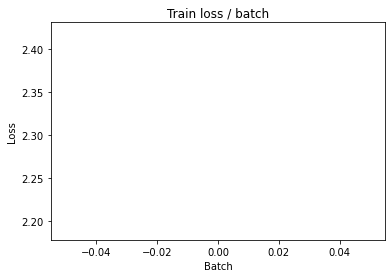

[TRAIN Batch 200/391]	Time 0.211s (0.138s)	Loss 1.9071 (1.9930)	Prec@1  28.9 ( 26.5)	Prec@5  84.4 ( 77.2)


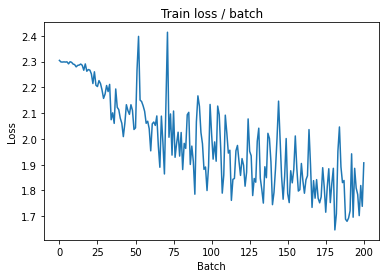


===============> Total time 53s	Avg loss 1.8501	Avg Prec@1 32.29 %	Avg Prec@5 82.52 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 1.6364 (1.6364)	Prec@1  41.4 ( 41.4)	Prec@5  89.8 ( 89.8)

===============> Total time 3s	Avg loss 1.5872	Avg Prec@1 42.22 %	Avg Prec@5 91.08 %



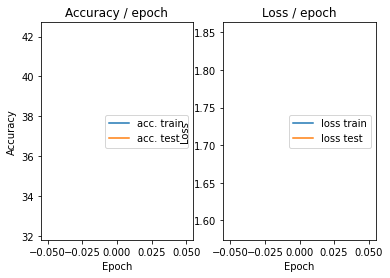

=== EPOCH 2 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.430s (0.430s)	Loss 1.7655 (1.7655)	Prec@1  39.1 ( 39.1)	Prec@5  92.2 ( 92.2)


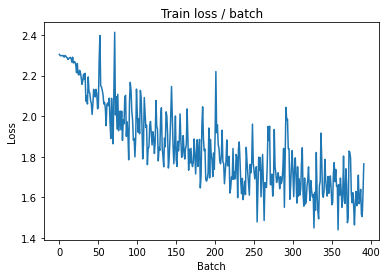

[TRAIN Batch 200/391]	Time 0.231s (0.138s)	Loss 1.5569 (1.5492)	Prec@1  41.4 ( 44.3)	Prec@5  87.5 ( 90.9)


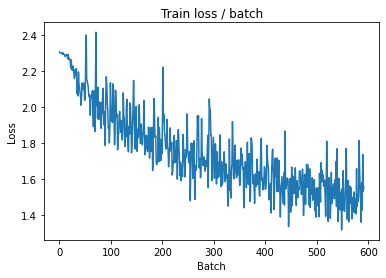


===============> Total time 53s	Avg loss 1.5078	Avg Prec@1 45.78 %	Avg Prec@5 91.44 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 1.1579 (1.1579)	Prec@1  65.6 ( 65.6)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.2750	Avg Prec@1 54.81 %	Avg Prec@5 94.84 %



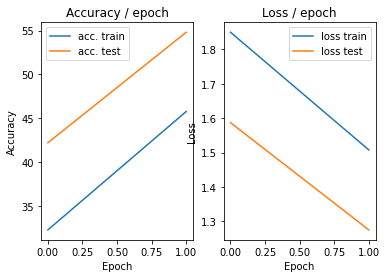

=== EPOCH 3 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.429s (0.429s)	Loss 1.3452 (1.3452)	Prec@1  50.0 ( 50.0)	Prec@5  93.0 ( 93.0)


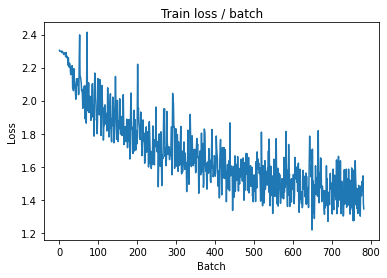

[TRAIN Batch 200/391]	Time 0.251s (0.140s)	Loss 1.3964 (1.3706)	Prec@1  53.1 ( 51.0)	Prec@5  93.0 ( 93.2)


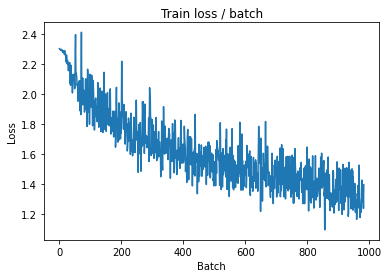


===============> Total time 53s	Avg loss 1.3426	Avg Prec@1 51.97 %	Avg Prec@5 93.64 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 1.0411 (1.0411)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.2146	Avg Prec@1 56.95 %	Avg Prec@5 95.36 %



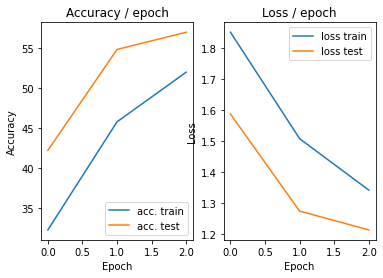

=== EPOCH 4 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.398s (0.398s)	Loss 1.1960 (1.1960)	Prec@1  53.9 ( 53.9)	Prec@5  93.0 ( 93.0)


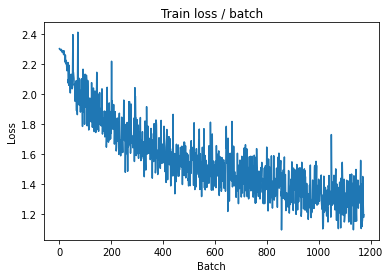

[TRAIN Batch 200/391]	Time 0.240s (0.140s)	Loss 1.2137 (1.2462)	Prec@1  59.4 ( 55.7)	Prec@5  97.7 ( 94.6)


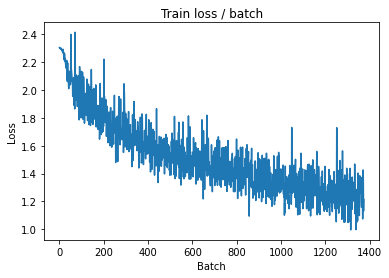


===============> Total time 54s	Avg loss 1.2266	Avg Prec@1 56.62 %	Avg Prec@5 94.84 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 1.1355 (1.1355)	Prec@1  59.4 ( 59.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.2304	Avg Prec@1 57.99 %	Avg Prec@5 95.09 %



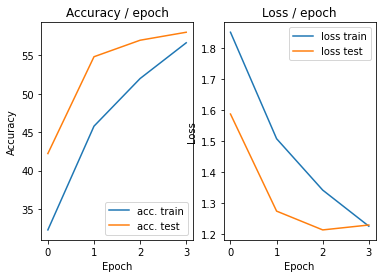

=== EPOCH 5 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.410s (0.410s)	Loss 1.4602 (1.4602)	Prec@1  45.3 ( 45.3)	Prec@5  90.6 ( 90.6)


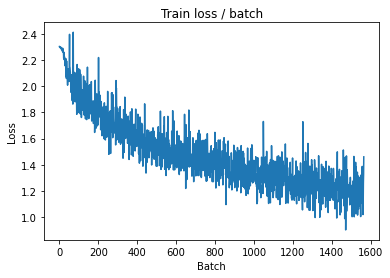

[TRAIN Batch 200/391]	Time 0.022s (0.139s)	Loss 1.0346 (1.1450)	Prec@1  60.2 ( 59.6)	Prec@5  99.2 ( 95.7)


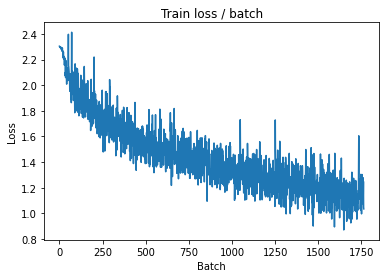


===============> Total time 54s	Avg loss 1.1293	Avg Prec@1 60.28 %	Avg Prec@5 95.70 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.9807 (0.9807)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.1128	Avg Prec@1 62.21 %	Avg Prec@5 96.04 %



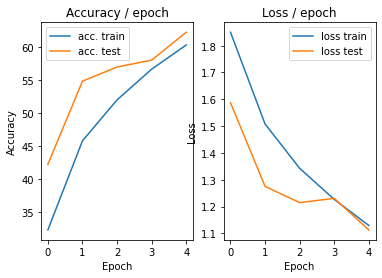

=== EPOCH 6 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.419s (0.419s)	Loss 1.3247 (1.3247)	Prec@1  54.7 ( 54.7)	Prec@5  92.2 ( 92.2)


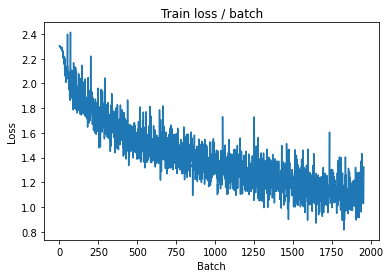

[TRAIN Batch 200/391]	Time 0.019s (0.139s)	Loss 0.9944 (1.0612)	Prec@1  67.2 ( 62.5)	Prec@5  96.9 ( 96.3)


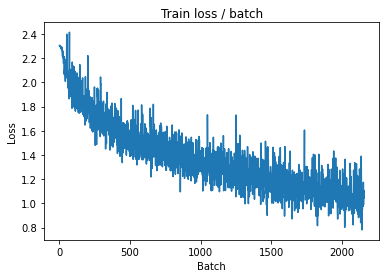


===============> Total time 54s	Avg loss 1.0497	Avg Prec@1 62.79 %	Avg Prec@5 96.39 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 0.8814 (0.8814)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9485	Avg Prec@1 67.37 %	Avg Prec@5 96.71 %



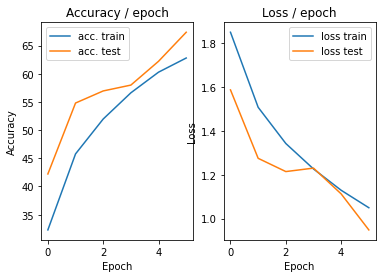

=== EPOCH 7 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.447s (0.447s)	Loss 0.8751 (0.8751)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)


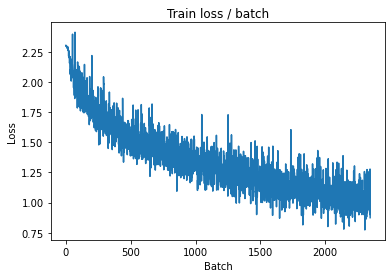

[TRAIN Batch 200/391]	Time 0.240s (0.140s)	Loss 1.0459 (0.9925)	Prec@1  62.5 ( 64.9)	Prec@5  96.9 ( 96.8)


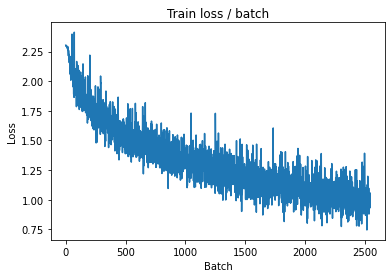


===============> Total time 54s	Avg loss 0.9818	Avg Prec@1 65.39 %	Avg Prec@5 96.91 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.8240 (0.8240)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9750	Avg Prec@1 67.08 %	Avg Prec@5 97.06 %



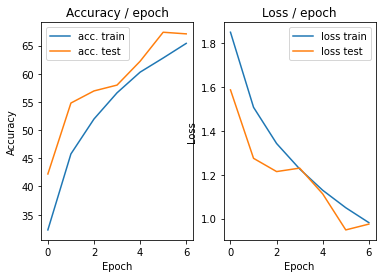

=== EPOCH 8 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.402s (0.402s)	Loss 0.9165 (0.9165)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)


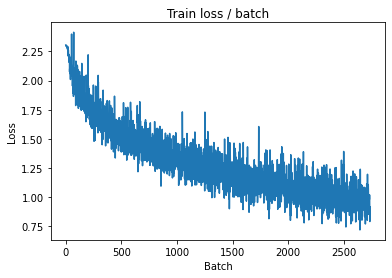

[TRAIN Batch 200/391]	Time 0.265s (0.140s)	Loss 0.8023 (0.9219)	Prec@1  71.9 ( 67.5)	Prec@5  97.7 ( 97.3)


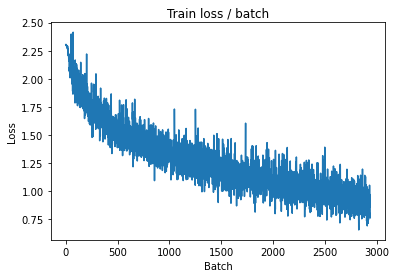


===============> Total time 54s	Avg loss 0.9237	Avg Prec@1 67.46 %	Avg Prec@5 97.34 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 0.9587 (0.9587)	Prec@1  67.2 ( 67.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9041	Avg Prec@1 69.42 %	Avg Prec@5 97.42 %



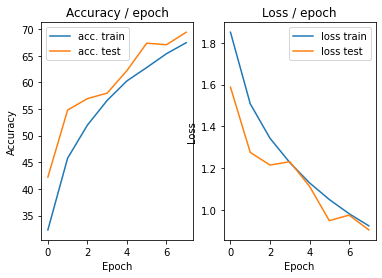

=== EPOCH 9 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.404s (0.404s)	Loss 0.7446 (0.7446)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)


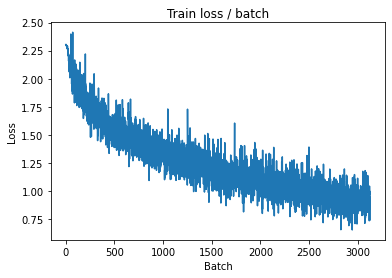

[TRAIN Batch 200/391]	Time 0.264s (0.141s)	Loss 0.7791 (0.8674)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 97.5)


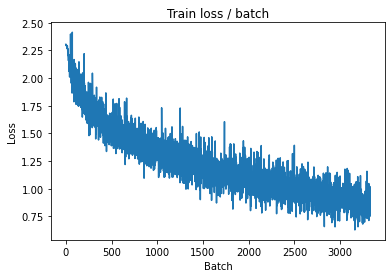

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 1.1173 (1.1173)	Prec@1  64.1 ( 64.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9527	Avg Prec@1 68.26 %	Avg Prec@5 97.34 %



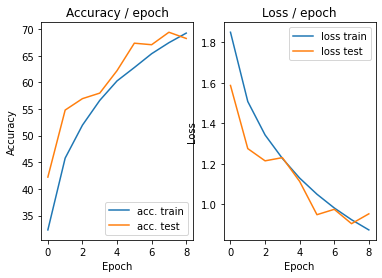

=== EPOCH 10 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.403s (0.403s)	Loss 0.8004 (0.8004)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)


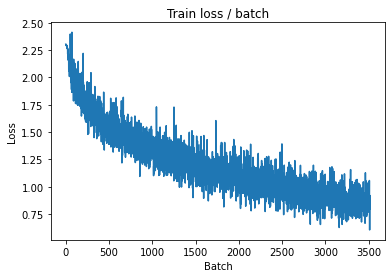

[TRAIN Batch 200/391]	Time 0.242s (0.140s)	Loss 0.8437 (0.8186)	Prec@1  65.6 ( 71.3)	Prec@5  98.4 ( 97.9)


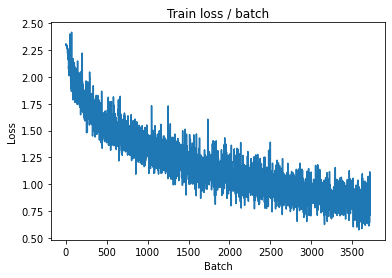


===============> Total time 54s	Avg loss 0.8287	Avg Prec@1 70.82 %	Avg Prec@5 97.81 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 0.7928 (0.7928)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8412	Avg Prec@1 71.87 %	Avg Prec@5 97.77 %



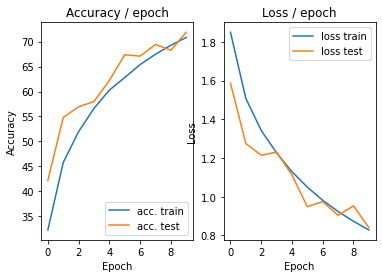

=== EPOCH 11 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.446s (0.446s)	Loss 0.7726 (0.7726)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)


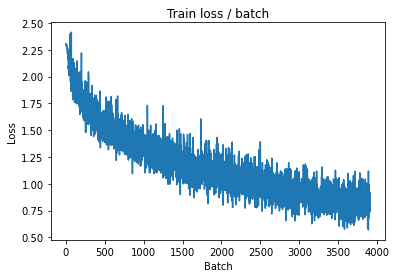

[TRAIN Batch 200/391]	Time 0.058s (0.139s)	Loss 0.6392 (0.7701)	Prec@1  80.5 ( 72.9)	Prec@5  99.2 ( 98.2)


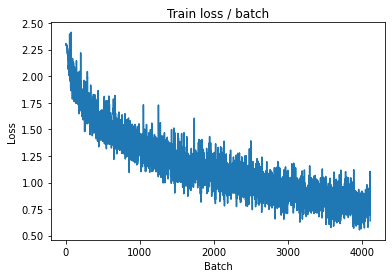


===============> Total time 54s	Avg loss 0.7799	Avg Prec@1 72.54 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.8571 (0.8571)	Prec@1  76.6 ( 76.6)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 0.9227	Avg Prec@1 69.72 %	Avg Prec@5 97.48 %



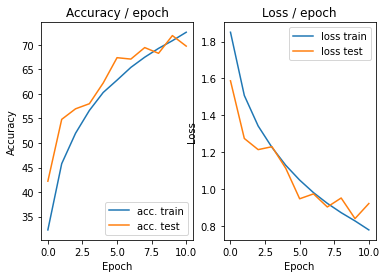

=== EPOCH 12 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.431s (0.431s)	Loss 0.7981 (0.7981)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)


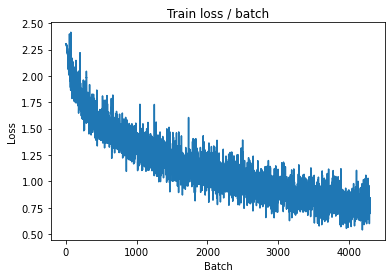

[TRAIN Batch 200/391]	Time 0.022s (0.140s)	Loss 0.6534 (0.7387)	Prec@1  73.4 ( 74.3)	Prec@5  97.7 ( 98.4)


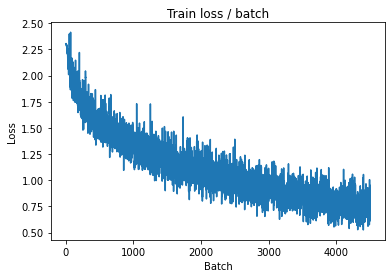


===============> Total time 54s	Avg loss 0.7427	Avg Prec@1 74.00 %	Avg Prec@5 98.34 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 0.8933 (0.8933)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8761	Avg Prec@1 72.46 %	Avg Prec@5 97.70 %



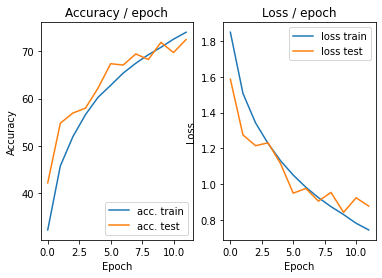

=== EPOCH 13 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.430s (0.430s)	Loss 0.7309 (0.7309)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)


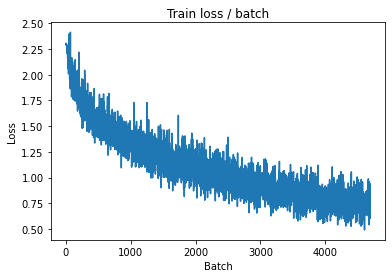

[TRAIN Batch 200/391]	Time 0.065s (0.139s)	Loss 0.6556 (0.7051)	Prec@1  72.7 ( 75.2)	Prec@5 100.0 ( 98.5)


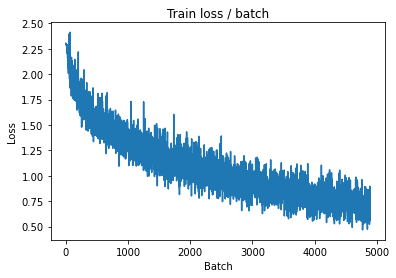


===============> Total time 54s	Avg loss 0.7050	Avg Prec@1 75.32 %	Avg Prec@5 98.50 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 0.9913 (0.9913)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8624	Avg Prec@1 72.22 %	Avg Prec@5 97.69 %



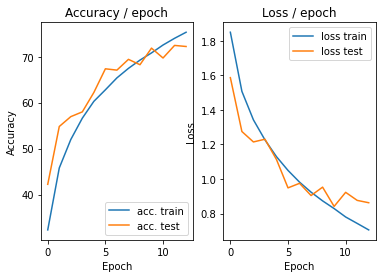

=== EPOCH 14 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.435s (0.435s)	Loss 0.5889 (0.5889)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


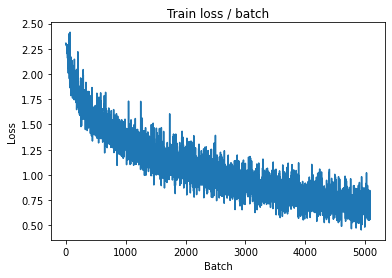

[TRAIN Batch 200/391]	Time 0.019s (0.140s)	Loss 0.7598 (0.6512)	Prec@1  71.9 ( 77.1)	Prec@5  98.4 ( 98.7)


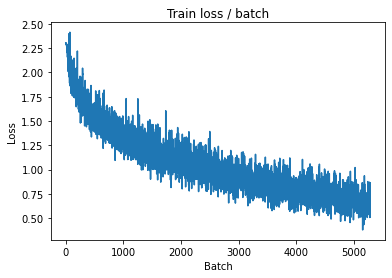


===============> Total time 54s	Avg loss 0.6664	Avg Prec@1 76.55 %	Avg Prec@5 98.62 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 1.0001 (1.0001)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9003	Avg Prec@1 73.26 %	Avg Prec@5 97.69 %



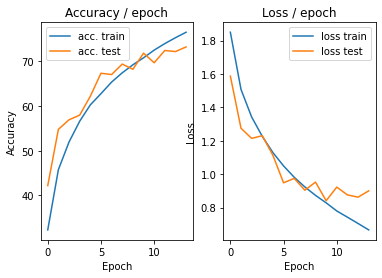

=== EPOCH 15 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.451s (0.451s)	Loss 0.5470 (0.5470)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


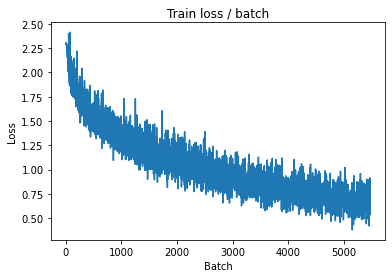

[TRAIN Batch 200/391]	Time 0.220s (0.141s)	Loss 0.5577 (0.6244)	Prec@1  76.6 ( 77.9)	Prec@5  99.2 ( 98.8)


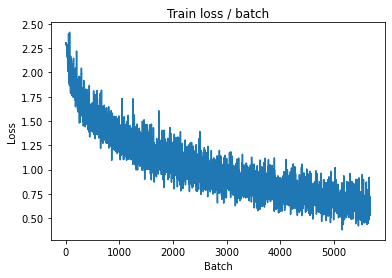


===============> Total time 54s	Avg loss 0.6377	Avg Prec@1 77.62 %	Avg Prec@5 98.78 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 1.0420 (1.0420)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9149	Avg Prec@1 72.30 %	Avg Prec@5 97.79 %



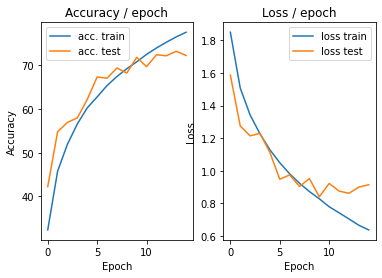

=== EPOCH 16 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.423s (0.423s)	Loss 0.6001 (0.6001)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


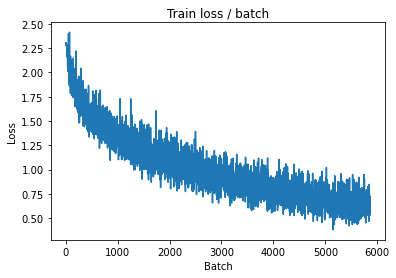

[TRAIN Batch 200/391]	Time 0.134s (0.140s)	Loss 0.7954 (0.6038)	Prec@1  68.8 ( 78.9)	Prec@5  98.4 ( 98.9)


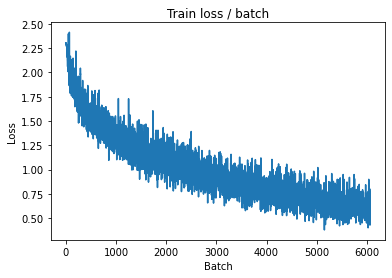


===============> Total time 54s	Avg loss 0.6079	Avg Prec@1 78.86 %	Avg Prec@5 98.88 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 0.8773 (0.8773)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9227	Avg Prec@1 72.47 %	Avg Prec@5 97.92 %



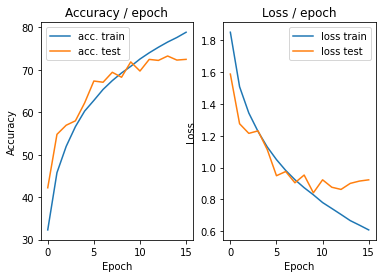

=== EPOCH 17 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.440s (0.440s)	Loss 0.7258 (0.7258)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


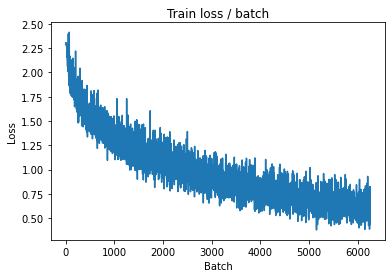

[TRAIN Batch 200/391]	Time 0.024s (0.141s)	Loss 0.5506 (0.5768)	Prec@1  81.2 ( 80.0)	Prec@5 100.0 ( 99.0)


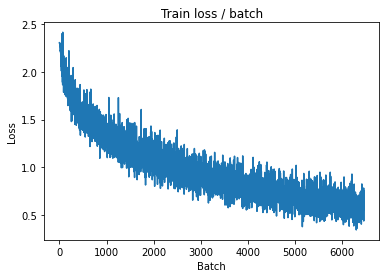


===============> Total time 54s	Avg loss 0.5826	Avg Prec@1 79.61 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 0.9741 (0.9741)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8610	Avg Prec@1 74.69 %	Avg Prec@5 97.84 %



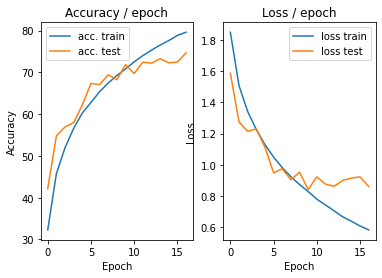

=== EPOCH 18 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.440s (0.440s)	Loss 0.5667 (0.5667)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


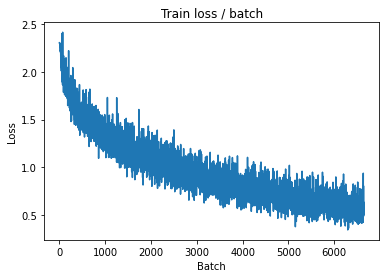

[TRAIN Batch 200/391]	Time 0.273s (0.142s)	Loss 0.4726 (0.5478)	Prec@1  79.7 ( 80.6)	Prec@5  98.4 ( 99.2)


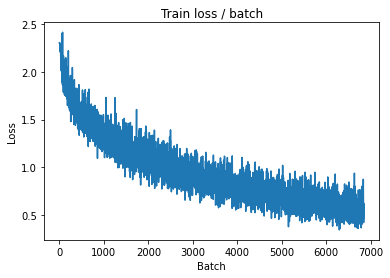


===============> Total time 54s	Avg loss 0.5623	Avg Prec@1 80.21 %	Avg Prec@5 99.11 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 1.1188 (1.1188)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.0741	Avg Prec@1 71.47 %	Avg Prec@5 97.67 %



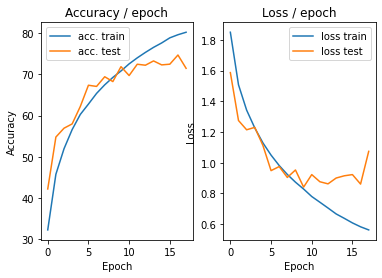

=== EPOCH 19 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.440s (0.440s)	Loss 0.5985 (0.5985)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


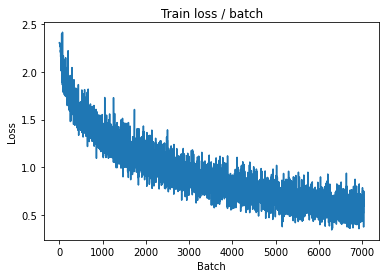

[TRAIN Batch 200/391]	Time 0.263s (0.141s)	Loss 0.5260 (0.5151)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.3)


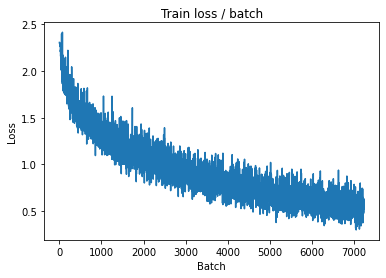


===============> Total time 54s	Avg loss 0.5283	Avg Prec@1 81.52 %	Avg Prec@5 99.21 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 1.1519 (1.1519)	Prec@1  69.5 ( 69.5)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 0.9508	Avg Prec@1 72.77 %	Avg Prec@5 97.81 %



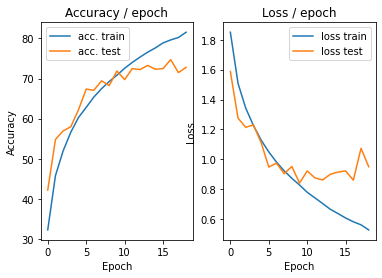

=== EPOCH 20 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.455s (0.455s)	Loss 0.5577 (0.5577)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


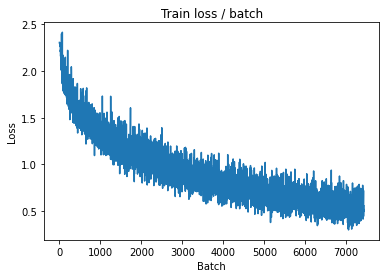

[TRAIN Batch 200/391]	Time 0.281s (0.142s)	Loss 0.4439 (0.5132)	Prec@1  84.4 ( 82.3)	Prec@5 100.0 ( 99.2)


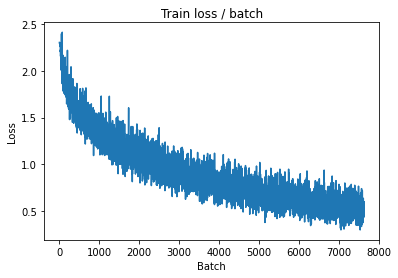


===============> Total time 54s	Avg loss 0.5206	Avg Prec@1 82.05 %	Avg Prec@5 99.16 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.9640 (0.9640)	Prec@1  74.2 ( 74.2)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 0.8657	Avg Prec@1 74.66 %	Avg Prec@5 97.82 %



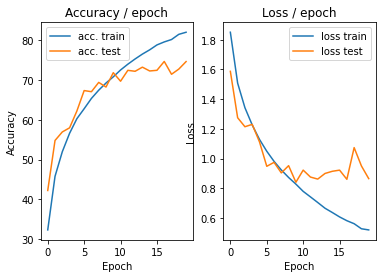

=== EPOCH 21 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.432s (0.432s)	Loss 0.3664 (0.3664)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


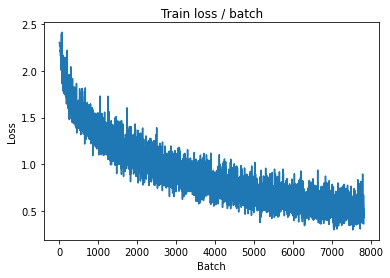

[TRAIN Batch 200/391]	Time 0.019s (0.142s)	Loss 0.5623 (0.4794)	Prec@1  81.2 ( 83.3)	Prec@5  99.2 ( 99.3)


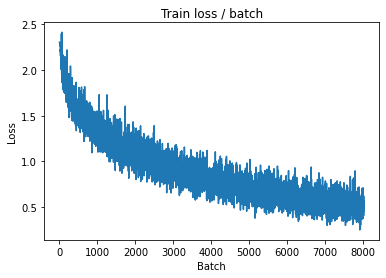


===============> Total time 54s	Avg loss 0.4874	Avg Prec@1 83.14 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 1.1496 (1.1496)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9676	Avg Prec@1 73.26 %	Avg Prec@5 97.82 %



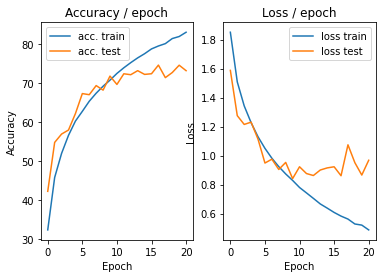

=== EPOCH 22 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.461s (0.461s)	Loss 0.4746 (0.4746)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


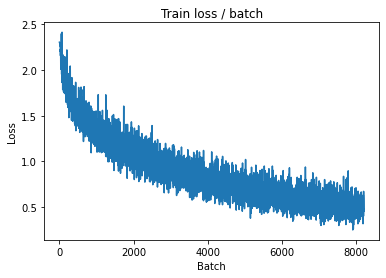

[TRAIN Batch 200/391]	Time 0.023s (0.141s)	Loss 0.4732 (0.4640)	Prec@1  82.0 ( 83.8)	Prec@5  99.2 ( 99.3)


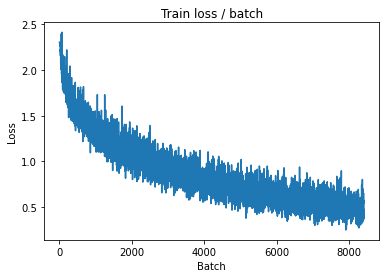


===============> Total time 54s	Avg loss 0.4737	Avg Prec@1 83.47 %	Avg Prec@5 99.27 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 1.0401 (1.0401)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9552	Avg Prec@1 74.48 %	Avg Prec@5 97.83 %



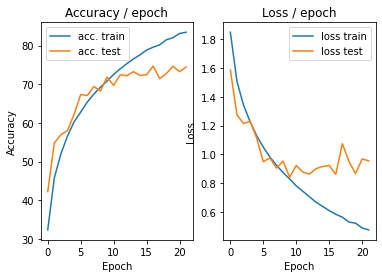

=== EPOCH 23 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.433s (0.433s)	Loss 0.4749 (0.4749)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


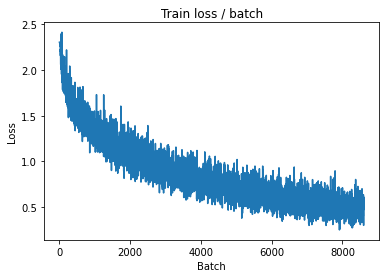

[TRAIN Batch 200/391]	Time 0.083s (0.140s)	Loss 0.4704 (0.4479)	Prec@1  79.7 ( 84.5)	Prec@5  98.4 ( 99.3)


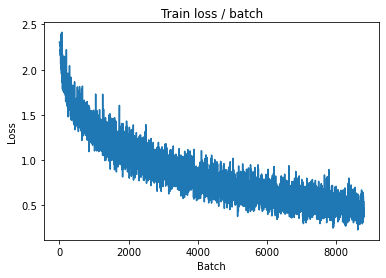


===============> Total time 54s	Avg loss 0.4590	Avg Prec@1 84.04 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 1.0510 (1.0510)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.0352	Avg Prec@1 73.04 %	Avg Prec@5 97.41 %



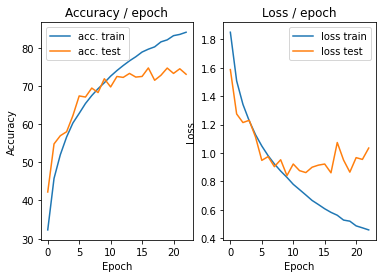

=== EPOCH 24 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.445s (0.445s)	Loss 0.4584 (0.4584)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)


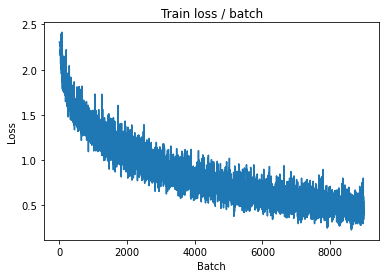

[TRAIN Batch 200/391]	Time 0.050s (0.140s)	Loss 0.4476 (0.4306)	Prec@1  85.2 ( 85.1)	Prec@5 100.0 ( 99.4)


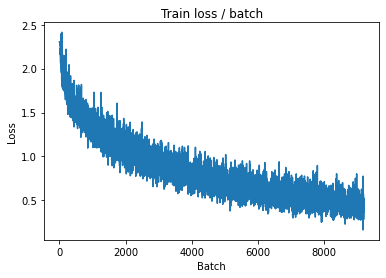


===============> Total time 54s	Avg loss 0.4385	Avg Prec@1 84.87 %	Avg Prec@5 99.41 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 1.0042 (1.0042)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9934	Avg Prec@1 73.72 %	Avg Prec@5 97.88 %



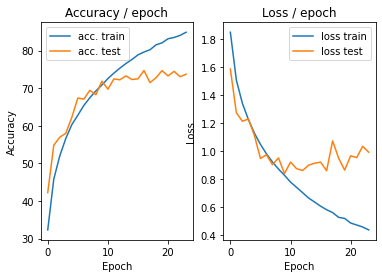

=== EPOCH 25 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.526s (0.526s)	Loss 0.4478 (0.4478)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


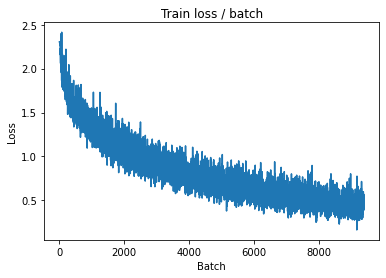

[TRAIN Batch 200/391]	Time 0.114s (0.138s)	Loss 0.4502 (0.4289)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.4)


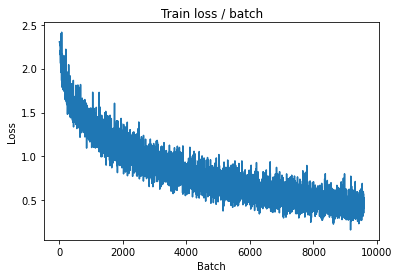


===============> Total time 53s	Avg loss 0.4340	Avg Prec@1 85.07 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 1.0661 (1.0661)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.0324	Avg Prec@1 74.12 %	Avg Prec@5 97.57 %



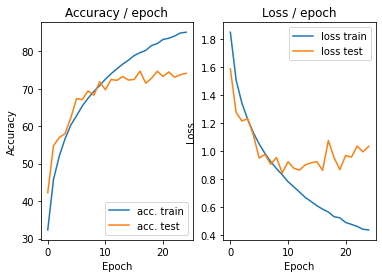

=== EPOCH 26 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.443s (0.443s)	Loss 0.4411 (0.4411)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


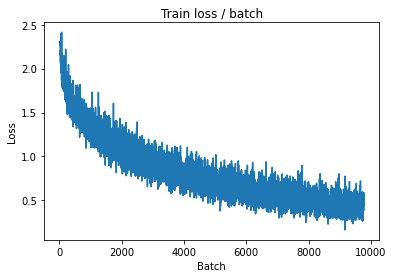

[TRAIN Batch 200/391]	Time 0.231s (0.140s)	Loss 0.3368 (0.4022)	Prec@1  85.2 ( 86.2)	Prec@5  99.2 ( 99.5)


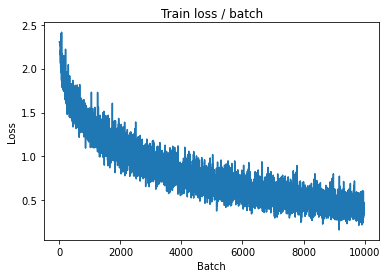


===============> Total time 54s	Avg loss 0.4123	Avg Prec@1 85.80 %	Avg Prec@5 99.53 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 1.1043 (1.1043)	Prec@1  75.8 ( 75.8)	Prec@5  93.8 ( 93.8)

===============> Total time 3s	Avg loss 1.2165	Avg Prec@1 71.79 %	Avg Prec@5 97.34 %



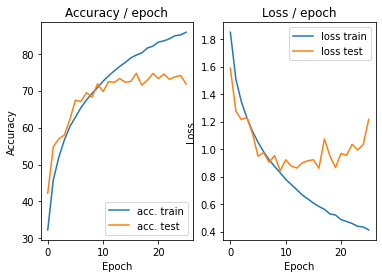

=== EPOCH 27 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.462s (0.462s)	Loss 0.6230 (0.6230)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)


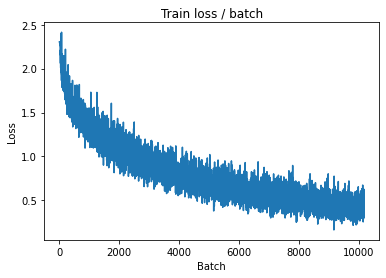

[TRAIN Batch 200/391]	Time 0.238s (0.139s)	Loss 0.3960 (0.3881)	Prec@1  87.5 ( 86.7)	Prec@5  96.9 ( 99.5)


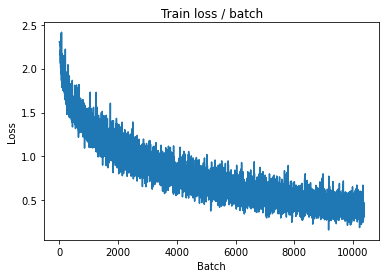


===============> Total time 54s	Avg loss 0.4062	Avg Prec@1 86.07 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 1.0871 (1.0871)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.0598	Avg Prec@1 73.41 %	Avg Prec@5 97.74 %



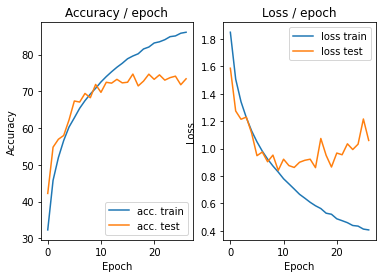

=== EPOCH 28 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.439s (0.439s)	Loss 0.4597 (0.4597)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)


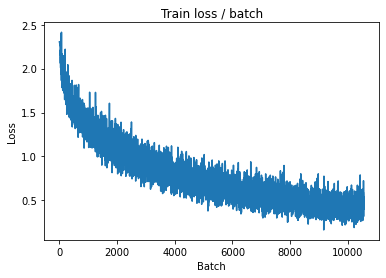

[TRAIN Batch 200/391]	Time 0.259s (0.143s)	Loss 0.3716 (0.3819)	Prec@1  84.4 ( 86.9)	Prec@5 100.0 ( 99.6)


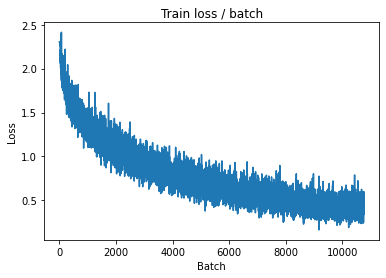


===============> Total time 54s	Avg loss 0.3942	Avg Prec@1 86.55 %	Avg Prec@5 99.52 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 1.3282 (1.3282)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1952	Avg Prec@1 73.64 %	Avg Prec@5 97.62 %



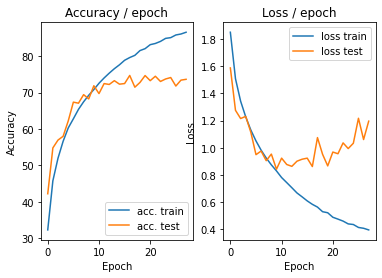

=== EPOCH 29 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.460s (0.460s)	Loss 0.3408 (0.3408)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


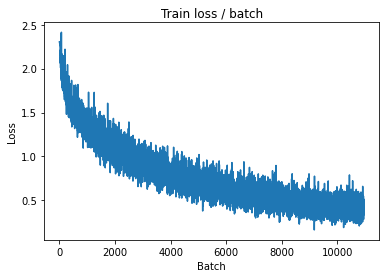

[TRAIN Batch 200/391]	Time 0.247s (0.141s)	Loss 0.3235 (0.3760)	Prec@1  86.7 ( 87.0)	Prec@5 100.0 ( 99.5)


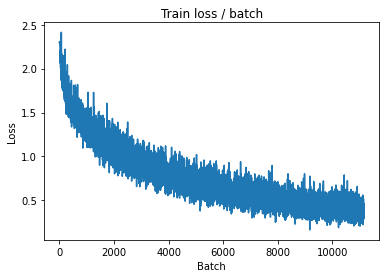


===============> Total time 54s	Avg loss 0.3859	Avg Prec@1 86.76 %	Avg Prec@5 99.53 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 1.0293 (1.0293)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.0296	Avg Prec@1 75.52 %	Avg Prec@5 97.77 %



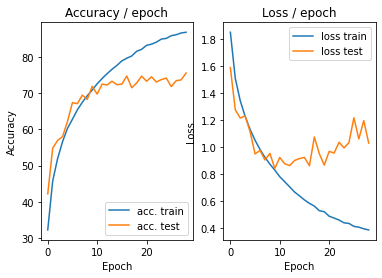

=== EPOCH 30 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.491s (0.491s)	Loss 0.3404 (0.3404)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


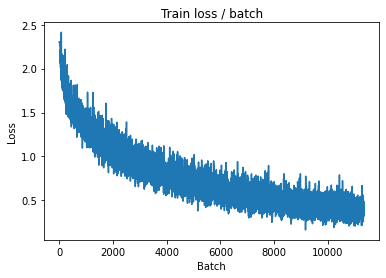

[TRAIN Batch 200/391]	Time 0.225s (0.141s)	Loss 0.3336 (0.3610)	Prec@1  91.4 ( 87.7)	Prec@5 100.0 ( 99.4)


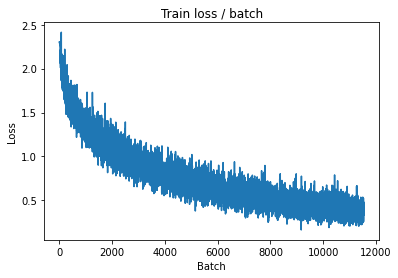


===============> Total time 54s	Avg loss 0.3724	Avg Prec@1 87.29 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 1.0561 (1.0561)	Prec@1  78.9 ( 78.9)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.1026	Avg Prec@1 74.78 %	Avg Prec@5 97.64 %



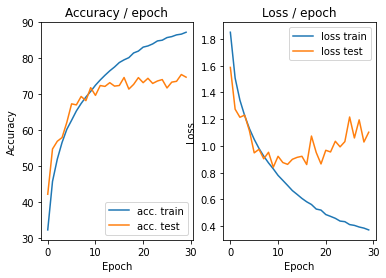

=== EPOCH 31 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.446s (0.446s)	Loss 0.4202 (0.4202)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


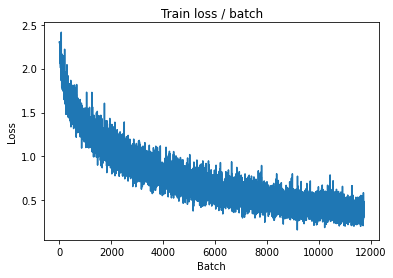

[TRAIN Batch 200/391]	Time 0.020s (0.138s)	Loss 0.3668 (0.3577)	Prec@1  84.4 ( 87.9)	Prec@5 100.0 ( 99.6)


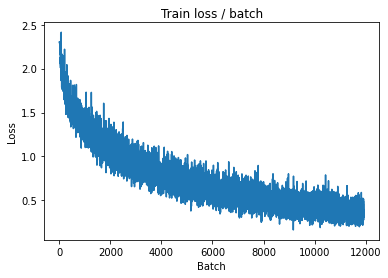


===============> Total time 53s	Avg loss 0.3617	Avg Prec@1 87.70 %	Avg Prec@5 99.55 %

[EVAL Batch 000/079]	Time 0.206s (0.206s)	Loss 1.3358 (1.3358)	Prec@1  74.2 ( 74.2)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.1427	Avg Prec@1 74.10 %	Avg Prec@5 97.59 %



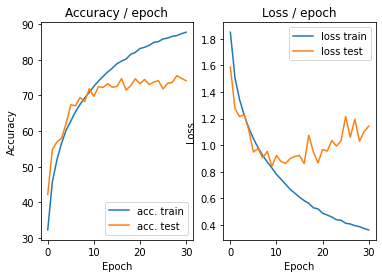

=== EPOCH 32 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.479s (0.479s)	Loss 0.3662 (0.3662)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


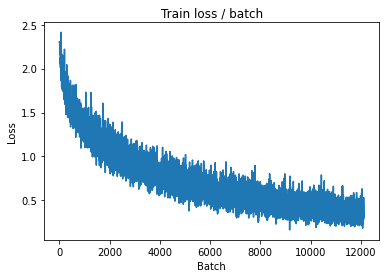

[TRAIN Batch 200/391]	Time 0.183s (0.140s)	Loss 0.4263 (0.3446)	Prec@1  86.7 ( 88.2)	Prec@5 100.0 ( 99.6)


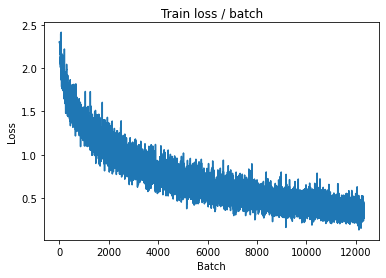


===============> Total time 53s	Avg loss 0.3591	Avg Prec@1 87.62 %	Avg Prec@5 99.59 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 1.1528 (1.1528)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.0500	Avg Prec@1 74.65 %	Avg Prec@5 97.83 %



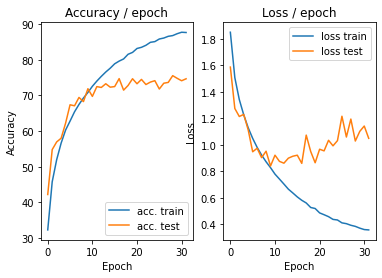

=== EPOCH 33 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.457s (0.457s)	Loss 0.3092 (0.3092)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


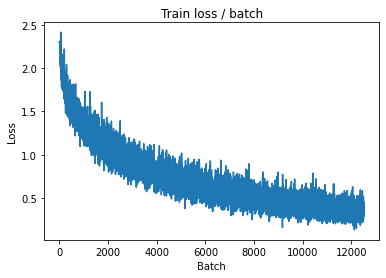

[TRAIN Batch 200/391]	Time 0.026s (0.138s)	Loss 0.3886 (0.3462)	Prec@1  84.4 ( 88.0)	Prec@5 100.0 ( 99.6)


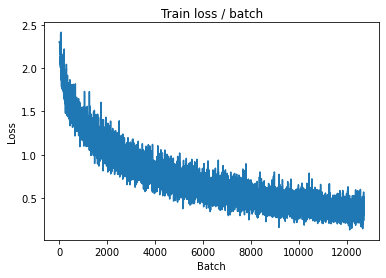


===============> Total time 53s	Avg loss 0.3509	Avg Prec@1 87.94 %	Avg Prec@5 99.60 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 1.2823 (1.2823)	Prec@1  78.1 ( 78.1)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.1246	Avg Prec@1 75.11 %	Avg Prec@5 97.75 %



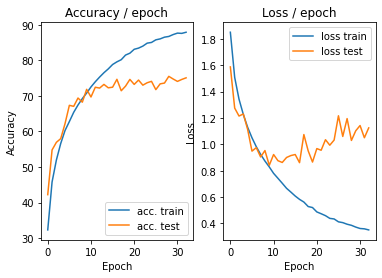

=== EPOCH 34 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.503s (0.503s)	Loss 0.3348 (0.3348)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


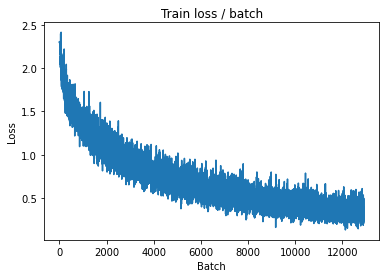

[TRAIN Batch 200/391]	Time 0.186s (0.137s)	Loss 0.2792 (0.3395)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 ( 99.6)


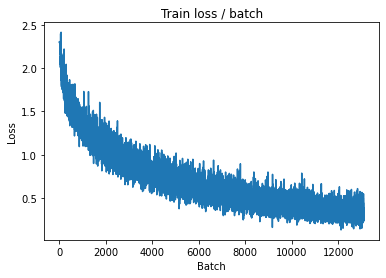


===============> Total time 53s	Avg loss 0.3434	Avg Prec@1 88.25 %	Avg Prec@5 99.61 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 1.2410 (1.2410)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.1713	Avg Prec@1 74.48 %	Avg Prec@5 97.26 %



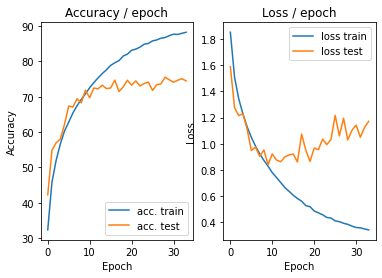

=== EPOCH 35 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.447s (0.447s)	Loss 0.2581 (0.2581)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


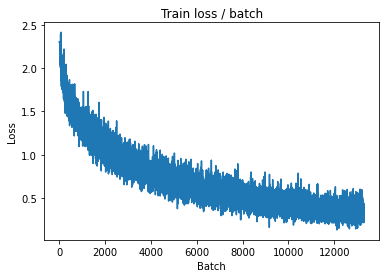

[TRAIN Batch 200/391]	Time 0.237s (0.138s)	Loss 0.2745 (0.3278)	Prec@1  88.3 ( 88.9)	Prec@5 100.0 ( 99.6)


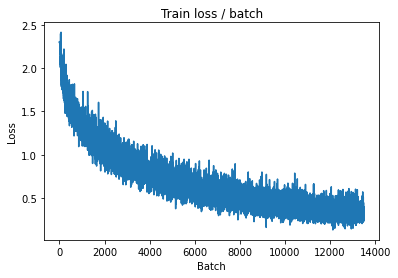


===============> Total time 53s	Avg loss 0.3388	Avg Prec@1 88.43 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 1.3893 (1.3893)	Prec@1  72.7 ( 72.7)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.1904	Avg Prec@1 75.27 %	Avg Prec@5 97.57 %



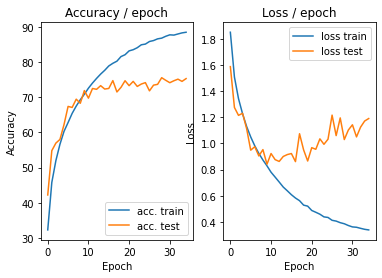

=== EPOCH 36 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.541s (0.541s)	Loss 0.2166 (0.2166)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


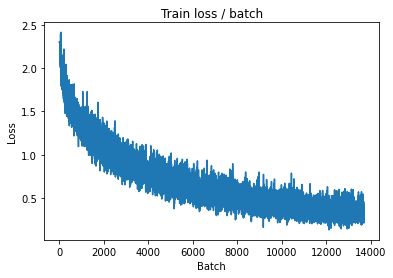

[TRAIN Batch 200/391]	Time 0.024s (0.139s)	Loss 0.2145 (0.3174)	Prec@1  90.6 ( 89.1)	Prec@5 100.0 ( 99.7)


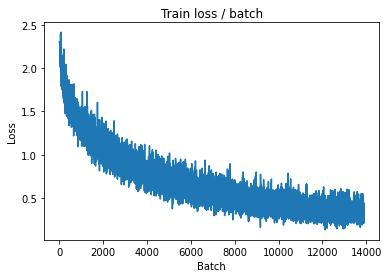


===============> Total time 53s	Avg loss 0.3312	Avg Prec@1 88.73 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 1.2101 (1.2101)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1070	Avg Prec@1 74.74 %	Avg Prec@5 97.75 %



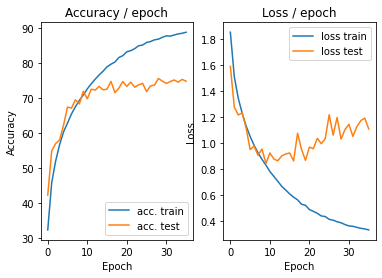

=== EPOCH 37 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.479s (0.479s)	Loss 0.3866 (0.3866)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


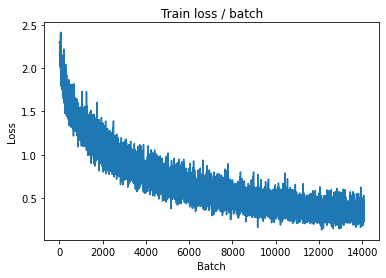

[TRAIN Batch 200/391]	Time 0.250s (0.138s)	Loss 0.3920 (0.3278)	Prec@1  88.3 ( 88.8)	Prec@5 100.0 ( 99.7)


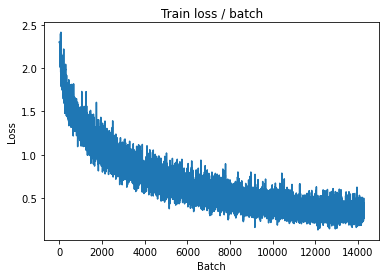


===============> Total time 53s	Avg loss 0.3313	Avg Prec@1 88.76 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 1.3936 (1.3936)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1377	Avg Prec@1 74.83 %	Avg Prec@5 97.71 %



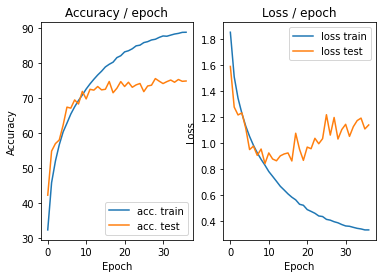

=== EPOCH 38 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.479s (0.479s)	Loss 0.2753 (0.2753)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


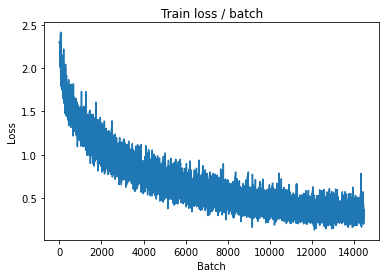

[TRAIN Batch 200/391]	Time 0.140s (0.138s)	Loss 0.4023 (0.3097)	Prec@1  89.1 ( 89.4)	Prec@5 100.0 ( 99.7)


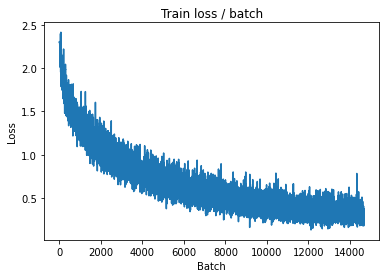


===============> Total time 53s	Avg loss 0.3203	Avg Prec@1 88.85 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 1.1769 (1.1769)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.2546	Avg Prec@1 73.48 %	Avg Prec@5 97.39 %



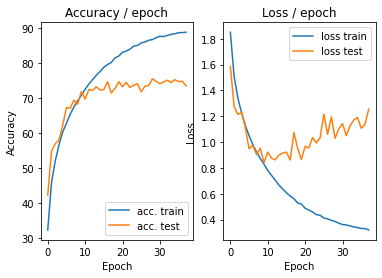

=== EPOCH 39 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.481s (0.481s)	Loss 0.3381 (0.3381)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


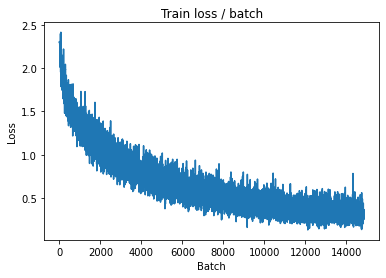

[TRAIN Batch 200/391]	Time 0.228s (0.138s)	Loss 0.3822 (0.3023)	Prec@1  88.3 ( 89.7)	Prec@5  98.4 ( 99.7)


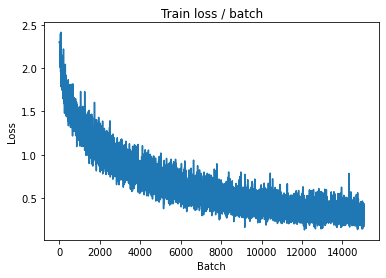


===============> Total time 53s	Avg loss 0.3094	Avg Prec@1 89.43 %	Avg Prec@5 99.69 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 1.1244 (1.1244)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.2361	Avg Prec@1 74.03 %	Avg Prec@5 97.33 %



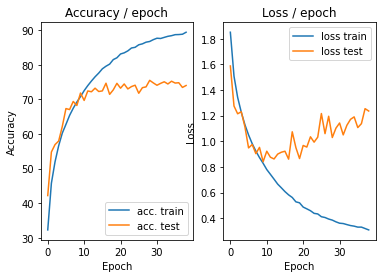

=== EPOCH 40 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.541s (0.541s)	Loss 0.3296 (0.3296)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)


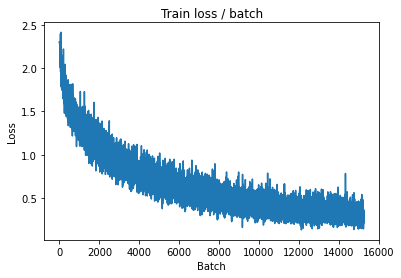

[TRAIN Batch 200/391]	Time 0.264s (0.139s)	Loss 0.3093 (0.2938)	Prec@1  90.6 ( 90.0)	Prec@5  99.2 ( 99.7)


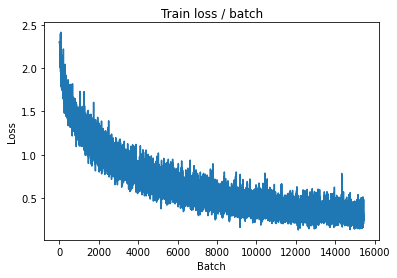


===============> Total time 53s	Avg loss 0.3047	Avg Prec@1 89.60 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 1.1514 (1.1514)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.2001	Avg Prec@1 75.00 %	Avg Prec@5 97.77 %



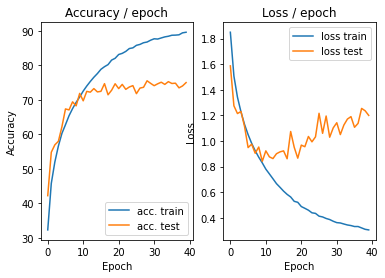

=== EPOCH 41 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.503s (0.503s)	Loss 0.2582 (0.2582)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


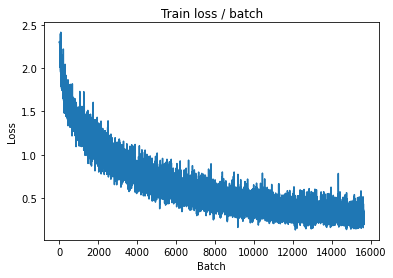

[TRAIN Batch 200/391]	Time 0.027s (0.138s)	Loss 0.2589 (0.2917)	Prec@1  91.4 ( 90.0)	Prec@5 100.0 ( 99.7)


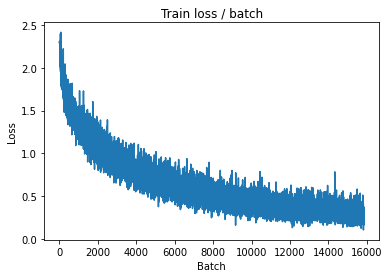


===============> Total time 53s	Avg loss 0.3040	Avg Prec@1 89.80 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 1.0312 (1.0312)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.2330	Avg Prec@1 74.46 %	Avg Prec@5 97.40 %



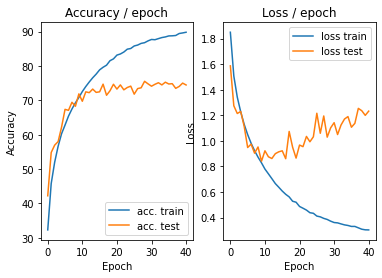

=== EPOCH 42 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.481s (0.481s)	Loss 0.2127 (0.2127)	Prec@1  95.3 ( 95.3)	Prec@5  99.2 ( 99.2)


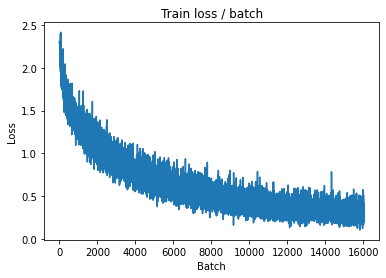

[TRAIN Batch 200/391]	Time 0.026s (0.138s)	Loss 0.3863 (0.2920)	Prec@1  85.9 ( 90.0)	Prec@5 100.0 ( 99.7)


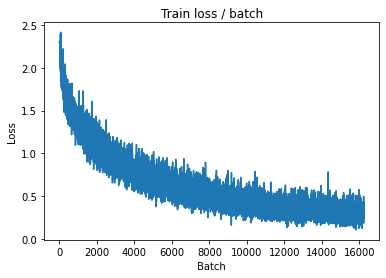


===============> Total time 53s	Avg loss 0.2978	Avg Prec@1 89.79 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 1.1507 (1.1507)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.1627	Avg Prec@1 73.95 %	Avg Prec@5 97.42 %



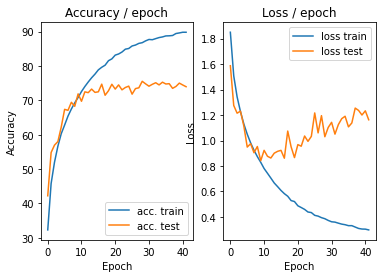

=== EPOCH 43 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.475s (0.475s)	Loss 0.4485 (0.4485)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


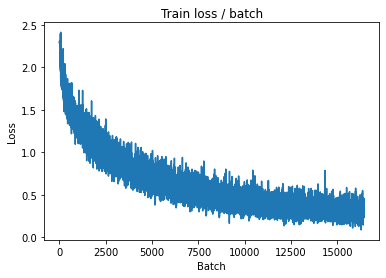

[TRAIN Batch 200/391]	Time 0.025s (0.137s)	Loss 0.1898 (0.2838)	Prec@1  94.5 ( 90.5)	Prec@5 100.0 ( 99.8)


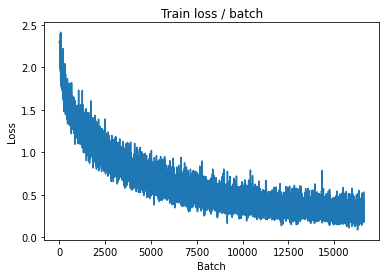


===============> Total time 53s	Avg loss 0.2913	Avg Prec@1 90.21 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 1.2146 (1.2146)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.2228	Avg Prec@1 74.57 %	Avg Prec@5 97.38 %



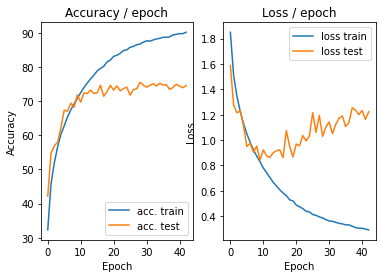

=== EPOCH 44 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.473s (0.473s)	Loss 0.3657 (0.3657)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


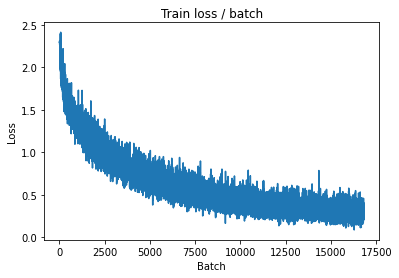

[TRAIN Batch 200/391]	Time 0.267s (0.139s)	Loss 0.1797 (0.2900)	Prec@1  94.5 ( 90.1)	Prec@5 100.0 ( 99.7)


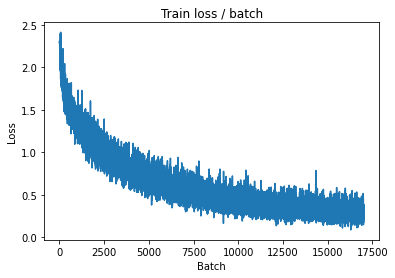


===============> Total time 53s	Avg loss 0.2922	Avg Prec@1 90.06 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 1.1300 (1.1300)	Prec@1  79.7 ( 79.7)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.1893	Avg Prec@1 75.26 %	Avg Prec@5 97.59 %



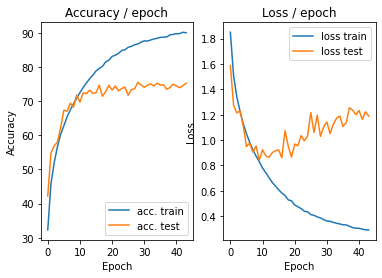

=== EPOCH 45 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.473s (0.473s)	Loss 0.3441 (0.3441)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


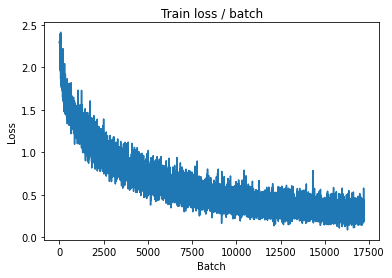

[TRAIN Batch 200/391]	Time 0.029s (0.139s)	Loss 0.2537 (0.2800)	Prec@1  89.8 ( 90.5)	Prec@5 100.0 ( 99.8)


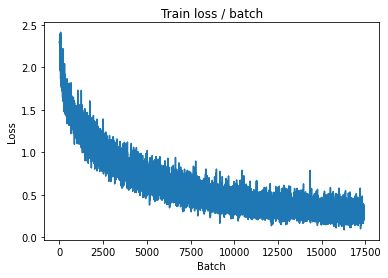


===============> Total time 53s	Avg loss 0.2848	Avg Prec@1 90.23 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 1.1222 (1.1222)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.3703	Avg Prec@1 74.44 %	Avg Prec@5 97.31 %



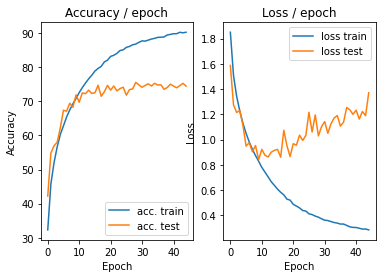

=== EPOCH 46 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.515s (0.515s)	Loss 0.1797 (0.1797)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


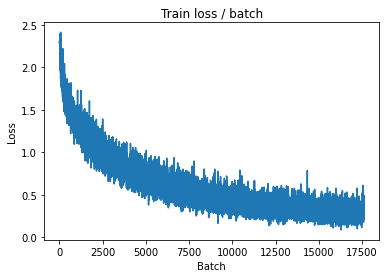

[TRAIN Batch 200/391]	Time 0.075s (0.137s)	Loss 0.2296 (0.2746)	Prec@1  90.6 ( 90.4)	Prec@5 100.0 ( 99.7)


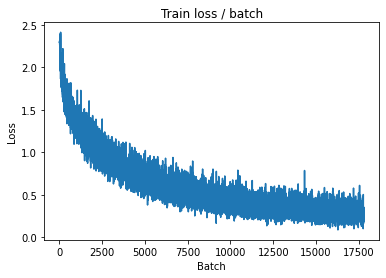


===============> Total time 53s	Avg loss 0.2808	Avg Prec@1 90.31 %	Avg Prec@5 99.71 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 1.3433 (1.3433)	Prec@1  79.7 ( 79.7)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.2633	Avg Prec@1 75.55 %	Avg Prec@5 97.71 %



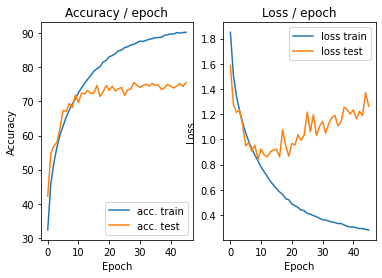

=== EPOCH 47 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.466s (0.466s)	Loss 0.2851 (0.2851)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


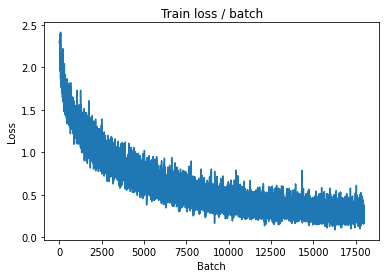

[TRAIN Batch 200/391]	Time 0.236s (0.140s)	Loss 0.3787 (0.2697)	Prec@1  87.5 ( 90.6)	Prec@5 100.0 ( 99.8)


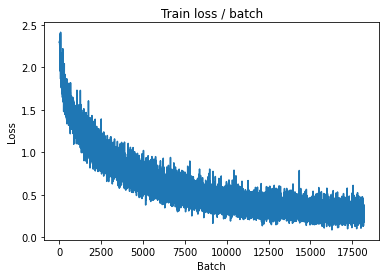


===============> Total time 53s	Avg loss 0.2824	Avg Prec@1 90.32 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 0.9783 (0.9783)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.1963	Avg Prec@1 75.65 %	Avg Prec@5 97.85 %



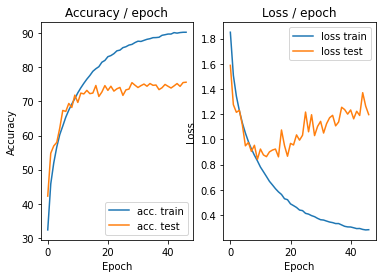

=== EPOCH 48 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.467s (0.467s)	Loss 0.2509 (0.2509)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


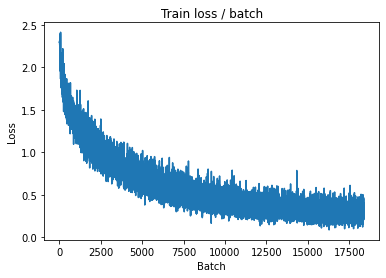

[TRAIN Batch 200/391]	Time 0.193s (0.137s)	Loss 0.3842 (0.2582)	Prec@1  85.9 ( 91.3)	Prec@5 100.0 ( 99.8)


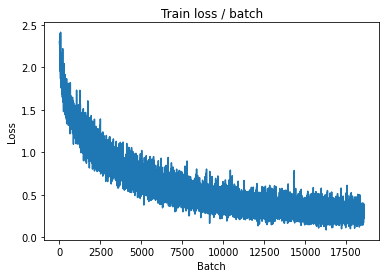


===============> Total time 53s	Avg loss 0.2736	Avg Prec@1 90.72 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 1.2560 (1.2560)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.2212	Avg Prec@1 75.65 %	Avg Prec@5 97.83 %



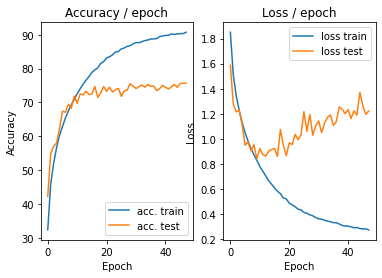

=== EPOCH 49 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.469s (0.469s)	Loss 0.2882 (0.2882)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


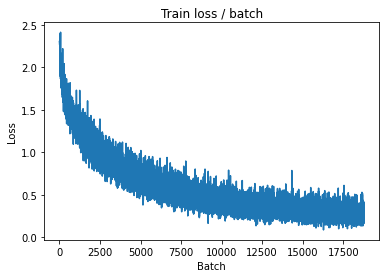

[TRAIN Batch 200/391]	Time 0.026s (0.138s)	Loss 0.4736 (0.2692)	Prec@1  86.7 ( 90.7)	Prec@5 100.0 ( 99.8)


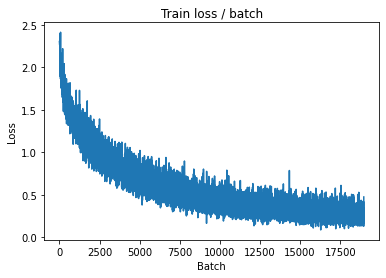


===============> Total time 53s	Avg loss 0.2748	Avg Prec@1 90.58 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 1.4476 (1.4476)	Prec@1  69.5 ( 69.5)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.3094	Avg Prec@1 73.99 %	Avg Prec@5 97.33 %



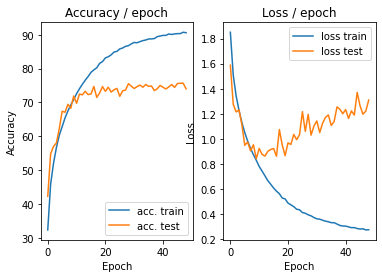

=== EPOCH 50 =====



/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594: UserWarning: torch.lstsq is deprecated in favor of torch.linalg.lstsq and will be removed in a future PyTorch release.
torch.linalg.lstsq has reversed arguments and does not return the QR decomposition in the returned tuple (although it returns other information about the problem).
To get the qr decomposition consider using torch.linalg.qr.
The returned solution in torch.lstsq stored the residuals of the solution in the last m - n columns of the returned value whenever m > n. In torch.linalg.lstsq, the residuals in the field 'residuals' of the returned named tuple.
The unpacking of the solution, as in
X, _ = torch.lstsq(B, A).solution[:A.size(1)]
should be replaced with
X = torch.linalg.lstsq(A, B).solution (Triggered internally at  /pytorch/aten/src/ATen/LegacyTHFunctionsCPU.cpp:389.)
  res = torch.lstsq(b_matrix, a_matrix)[0]
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/functional.py:594

[TRAIN Batch 000/391]	Time 0.471s (0.471s)	Loss 0.3253 (0.3253)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


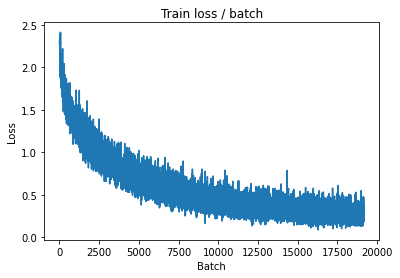

[TRAIN Batch 200/391]	Time 0.135s (0.140s)	Loss 0.4728 (0.2721)	Prec@1  85.9 ( 90.8)	Prec@5  98.4 ( 99.7)


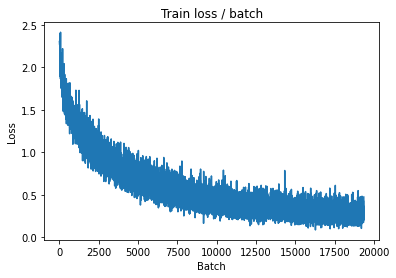


===============> Total time 54s	Avg loss 0.2750	Avg Prec@1 90.70 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 1.3410 (1.3410)	Prec@1  73.4 ( 73.4)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.3543	Avg Prec@1 72.95 %	Avg Prec@5 97.15 %



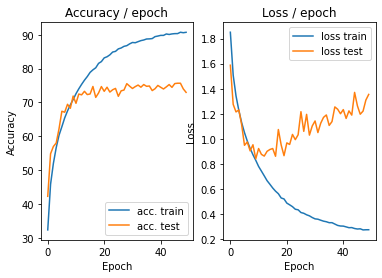

In [ ]:
main(128, 0.1,epochs=50, cuda=True)

##SGD and schedule improvements :

momentum :

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.9)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 2.3012 (2.3012)	Prec@1  13.3 ( 13.3)	Prec@5  48.4 ( 48.4)


<Figure size 432x288 with 0 Axes>

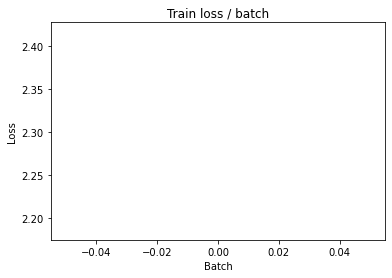

[TRAIN Batch 200/391]	Time 0.061s (0.052s)	Loss 2.3010 (2.3812)	Prec@1   9.4 ( 13.1)	Prec@5  49.2 ( 56.7)


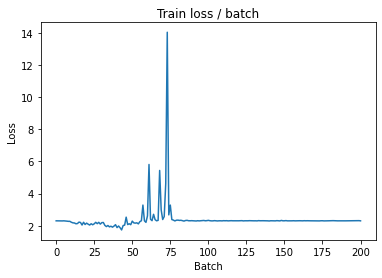


===============> Total time 20s	Avg loss 2.4004	Avg Prec@1 11.67 %	Avg Prec@5 53.35 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 2.2957 (2.2957)	Prec@1  11.7 ( 11.7)	Prec@5  60.2 ( 60.2)

===============> Total time 3s	Avg loss 2.3035	Avg Prec@1 10.10 %	Avg Prec@5 50.21 %



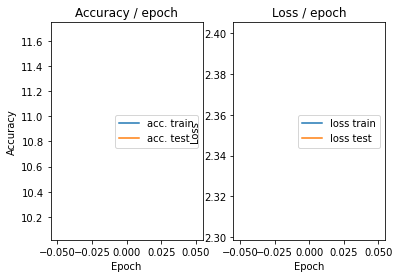

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 2.3075 (2.3075)	Prec@1   9.4 (  9.4)	Prec@5  47.7 ( 47.7)


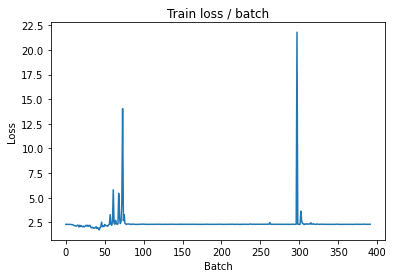

[TRAIN Batch 200/391]	Time 0.087s (0.053s)	Loss 2.2984 (2.3044)	Prec@1  11.7 (  9.9)	Prec@5  53.9 ( 49.5)


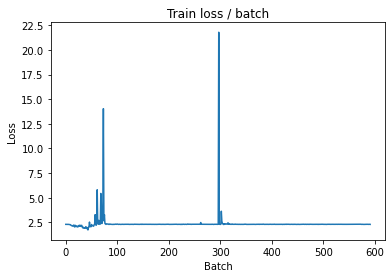


===============> Total time 20s	Avg loss 2.3042	Avg Prec@1 10.00 %	Avg Prec@5 50.00 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 2.3049 (2.3049)	Prec@1  13.3 ( 13.3)	Prec@5  49.2 ( 49.2)

===============> Total time 3s	Avg loss 2.3046	Avg Prec@1 10.10 %	Avg Prec@5 50.28 %



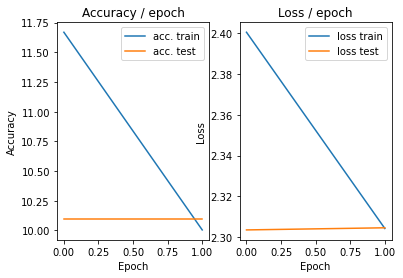

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 2.3015 (2.3015)	Prec@1   8.6 (  8.6)	Prec@5  53.1 ( 53.1)


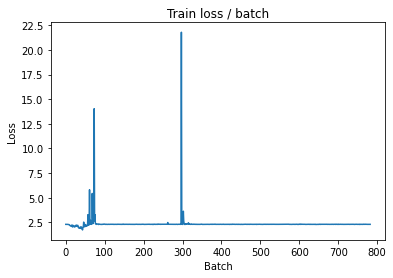

[TRAIN Batch 200/391]	Time 0.034s (0.053s)	Loss 2.3015 (2.3046)	Prec@1  11.7 ( 10.1)	Prec@5  53.1 ( 50.1)


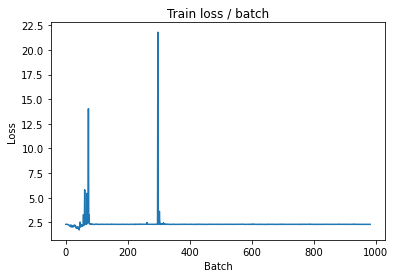


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1 10.07 %	Avg Prec@5 50.06 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 2.3057 (2.3057)	Prec@1   7.0 (  7.0)	Prec@5  50.0 ( 50.0)

===============> Total time 3s	Avg loss 2.3036	Avg Prec@1 10.10 %	Avg Prec@5 50.35 %



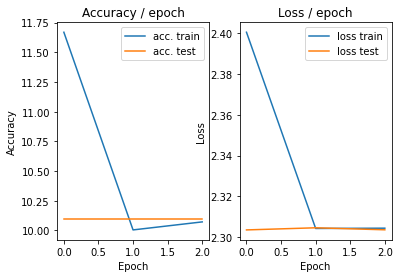

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 2.3007 (2.3007)	Prec@1  10.9 ( 10.9)	Prec@5  52.3 ( 52.3)


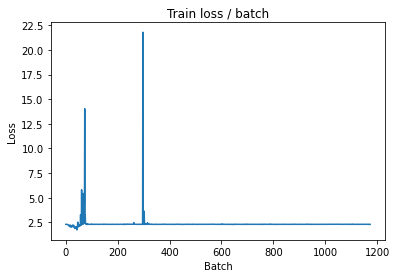

[TRAIN Batch 200/391]	Time 0.022s (0.053s)	Loss 2.2983 (2.3049)	Prec@1   8.6 (  9.6)	Prec@5  58.6 ( 49.5)


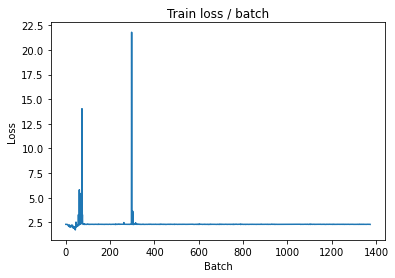


===============> Total time 20s	Avg loss 2.3047	Avg Prec@1  9.85 %	Avg Prec@5 49.72 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 2.3041 (2.3041)	Prec@1   7.8 (  7.8)	Prec@5  51.6 ( 51.6)

===============> Total time 3s	Avg loss 2.3044	Avg Prec@1  9.96 %	Avg Prec@5 50.14 %



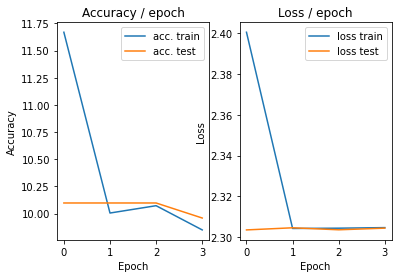

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.232s (0.232s)	Loss 2.3042 (2.3042)	Prec@1  11.7 ( 11.7)	Prec@5  52.3 ( 52.3)


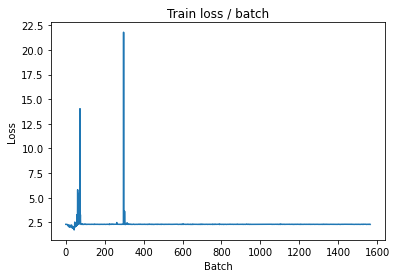

[TRAIN Batch 200/391]	Time 0.069s (0.053s)	Loss 2.3040 (2.3045)	Prec@1  10.2 (  9.8)	Prec@5  50.0 ( 50.1)


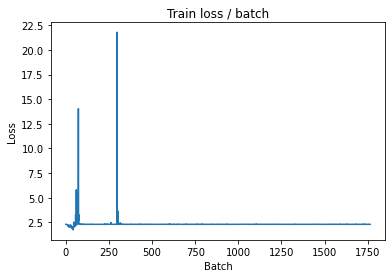


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1  9.88 %	Avg Prec@5 50.28 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 2.3007 (2.3007)	Prec@1  10.2 ( 10.2)	Prec@5  55.5 ( 55.5)

===============> Total time 3s	Avg loss 2.3035	Avg Prec@1 10.10 %	Avg Prec@5 50.07 %



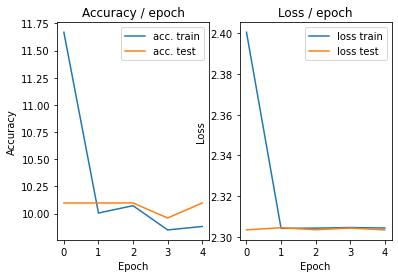

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 2.3030 (2.3030)	Prec@1  14.8 ( 14.8)	Prec@5  49.2 ( 49.2)


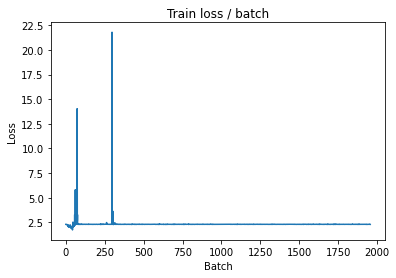

[TRAIN Batch 200/391]	Time 0.084s (0.053s)	Loss 2.2981 (2.3042)	Prec@1  12.5 ( 10.4)	Prec@5  55.5 ( 49.9)


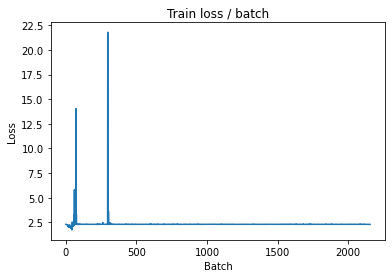


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1 10.19 %	Avg Prec@5 49.64 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 2.2983 (2.2983)	Prec@1  11.7 ( 11.7)	Prec@5  57.0 ( 57.0)

===============> Total time 3s	Avg loss 2.3034	Avg Prec@1 10.10 %	Avg Prec@5 49.93 %



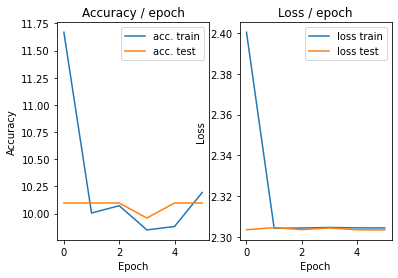

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 2.3124 (2.3124)	Prec@1   9.4 (  9.4)	Prec@5  42.2 ( 42.2)


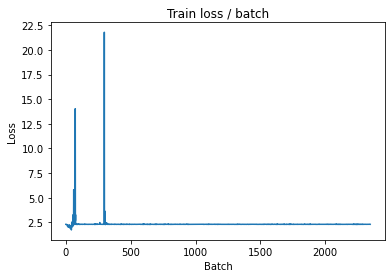

[TRAIN Batch 200/391]	Time 0.020s (0.054s)	Loss 2.2982 (2.3046)	Prec@1  14.1 (  9.8)	Prec@5  51.6 ( 49.4)


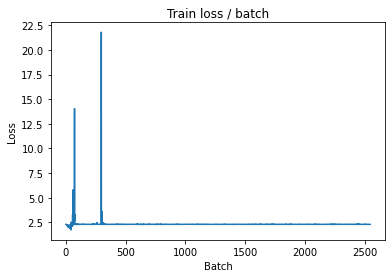


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1  9.91 %	Avg Prec@5 49.51 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 2.3061 (2.3061)	Prec@1   7.8 (  7.8)	Prec@5  48.4 ( 48.4)

===============> Total time 3s	Avg loss 2.3037	Avg Prec@1  9.96 %	Avg Prec@5 49.93 %



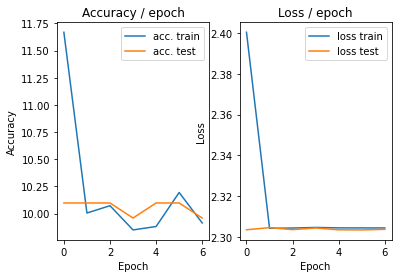

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.227s (0.227s)	Loss 2.3092 (2.3092)	Prec@1   9.4 (  9.4)	Prec@5  43.0 ( 43.0)


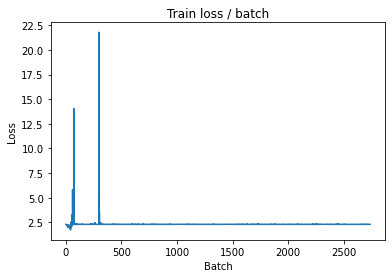

[TRAIN Batch 200/391]	Time 0.023s (0.053s)	Loss 2.2990 (2.3046)	Prec@1  15.6 ( 10.1)	Prec@5  56.2 ( 50.0)


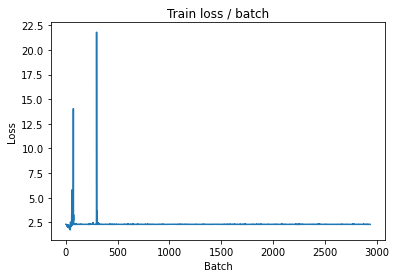


===============> Total time 20s	Avg loss 2.3046	Avg Prec@1  9.98 %	Avg Prec@5 49.73 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 2.3017 (2.3017)	Prec@1  11.7 ( 11.7)	Prec@5  53.1 ( 53.1)

===============> Total time 3s	Avg loss 2.3037	Avg Prec@1 10.10 %	Avg Prec@5 49.86 %



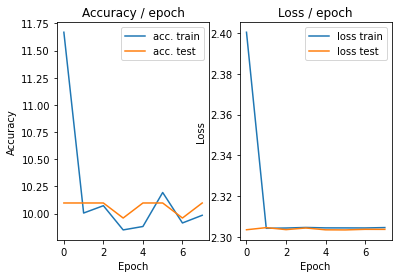

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 2.3085 (2.3085)	Prec@1   9.4 (  9.4)	Prec@5  47.7 ( 47.7)


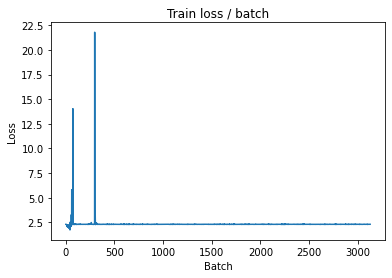

[TRAIN Batch 200/391]	Time 0.024s (0.052s)	Loss 2.3137 (2.3050)	Prec@1   7.0 (  9.5)	Prec@5  46.1 ( 49.6)


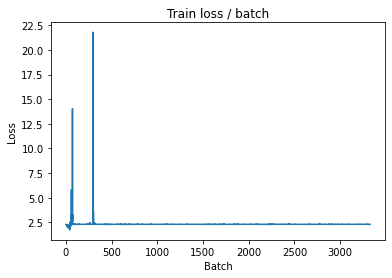


===============> Total time 20s	Avg loss 2.3047	Avg Prec@1  9.87 %	Avg Prec@5 49.93 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 2.3053 (2.3053)	Prec@1  11.7 ( 11.7)	Prec@5  48.4 ( 48.4)

===============> Total time 3s	Avg loss 2.3034	Avg Prec@1 10.10 %	Avg Prec@5 50.14 %



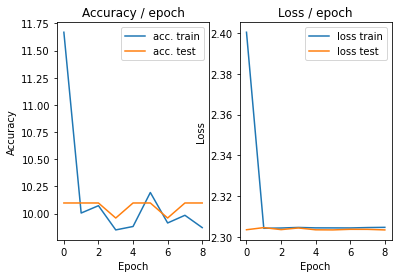

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 2.3039 (2.3039)	Prec@1   9.4 (  9.4)	Prec@5  53.1 ( 53.1)


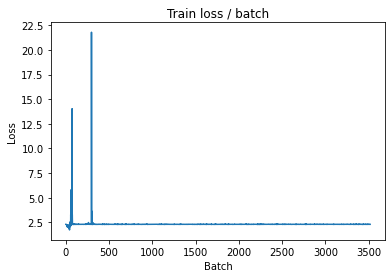

[TRAIN Batch 200/391]	Time 0.073s (0.053s)	Loss 2.3032 (2.3044)	Prec@1   8.6 ( 10.1)	Prec@5  51.6 ( 49.9)


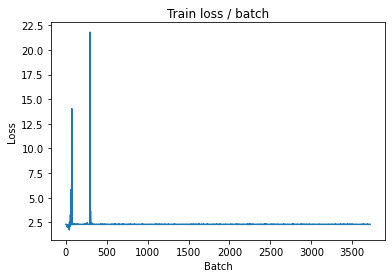


===============> Total time 20s	Avg loss 2.3046	Avg Prec@1  9.90 %	Avg Prec@5 49.82 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 2.3089 (2.3089)	Prec@1   7.8 (  7.8)	Prec@5  50.0 ( 50.0)

===============> Total time 3s	Avg loss 2.3043	Avg Prec@1  9.94 %	Avg Prec@5 49.93 %



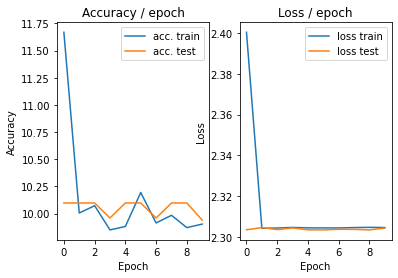

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 2.3002 (2.3002)	Prec@1   7.0 (  7.0)	Prec@5  50.8 ( 50.8)


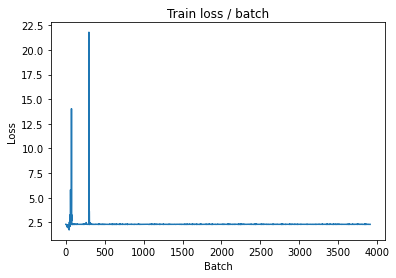

[TRAIN Batch 200/391]	Time 0.065s (0.053s)	Loss 2.3100 (2.3043)	Prec@1   5.5 (  9.9)	Prec@5  49.2 ( 49.7)


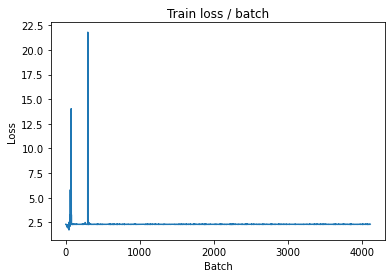


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1  9.69 %	Avg Prec@5 49.66 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 2.3041 (2.3041)	Prec@1   7.0 (  7.0)	Prec@5  52.3 ( 52.3)

===============> Total time 3s	Avg loss 2.3032	Avg Prec@1 10.10 %	Avg Prec@5 50.07 %



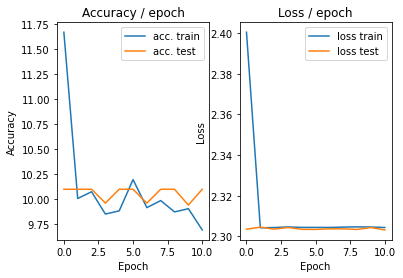

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 2.3002 (2.3002)	Prec@1  14.1 ( 14.1)	Prec@5  57.0 ( 57.0)


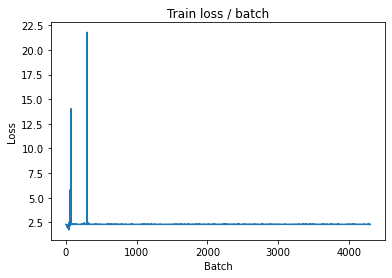

[TRAIN Batch 200/391]	Time 0.065s (0.053s)	Loss 2.3038 (2.3039)	Prec@1  11.7 ( 10.1)	Prec@5  44.5 ( 50.1)


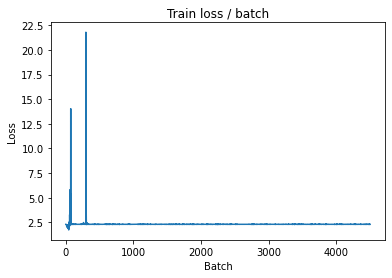


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1 10.10 %	Avg Prec@5 49.85 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 2.3014 (2.3014)	Prec@1   7.0 (  7.0)	Prec@5  50.0 ( 50.0)

===============> Total time 3s	Avg loss 2.3042	Avg Prec@1 10.10 %	Avg Prec@5 50.28 %



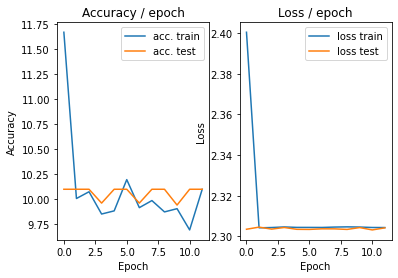

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 2.3094 (2.3094)	Prec@1   8.6 (  8.6)	Prec@5  49.2 ( 49.2)


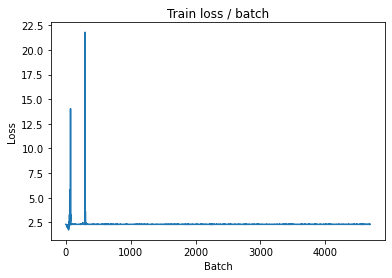

[TRAIN Batch 200/391]	Time 0.025s (0.052s)	Loss 2.3016 (2.3052)	Prec@1  10.2 (  9.7)	Prec@5  50.0 ( 49.0)


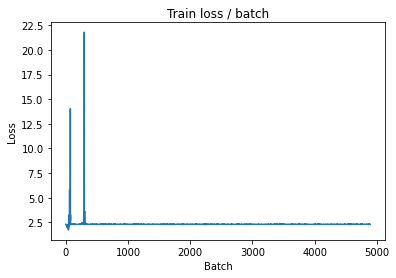


===============> Total time 20s	Avg loss 2.3049	Avg Prec@1  9.88 %	Avg Prec@5 49.33 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 2.2985 (2.2985)	Prec@1  10.2 ( 10.2)	Prec@5  53.9 ( 53.9)

===============> Total time 3s	Avg loss 2.3034	Avg Prec@1 10.03 %	Avg Prec@5 50.21 %



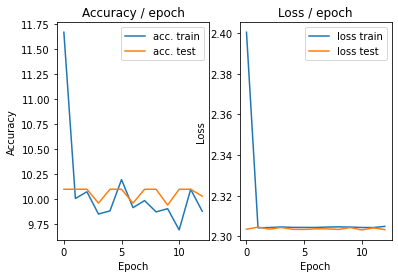

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 2.3041 (2.3041)	Prec@1   7.8 (  7.8)	Prec@5  49.2 ( 49.2)


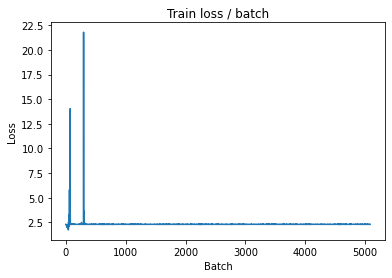

[TRAIN Batch 200/391]	Time 0.030s (0.054s)	Loss 2.2923 (2.3046)	Prec@1  11.7 (  9.7)	Prec@5  59.4 ( 49.9)


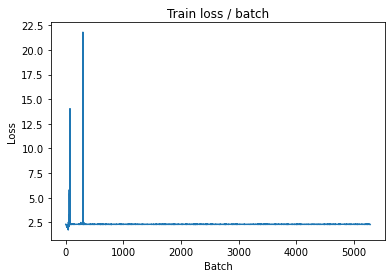


===============> Total time 20s	Avg loss 2.3047	Avg Prec@1  9.79 %	Avg Prec@5 49.79 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 2.3035 (2.3035)	Prec@1   7.8 (  7.8)	Prec@5  49.2 ( 49.2)

===============> Total time 3s	Avg loss 2.3036	Avg Prec@1  9.89 %	Avg Prec@5 50.07 %



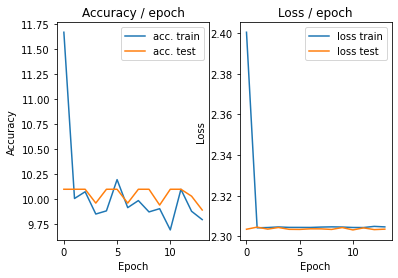

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 2.3075 (2.3075)	Prec@1  10.2 ( 10.2)	Prec@5  43.8 ( 43.8)


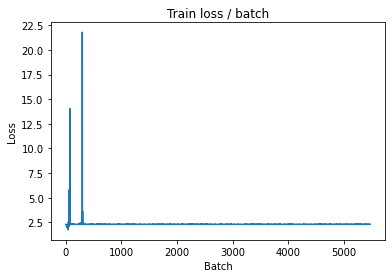

[TRAIN Batch 200/391]	Time 0.038s (0.053s)	Loss 2.3068 (2.3039)	Prec@1   7.0 ( 10.4)	Prec@5  50.0 ( 50.6)


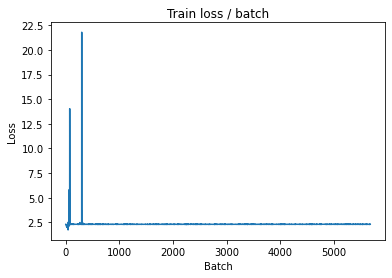


===============> Total time 20s	Avg loss 2.3041	Avg Prec@1 10.17 %	Avg Prec@5 50.55 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 2.2980 (2.2980)	Prec@1  13.3 ( 13.3)	Prec@5  53.9 ( 53.9)

===============> Total time 3s	Avg loss 2.3043	Avg Prec@1 10.10 %	Avg Prec@5 50.28 %



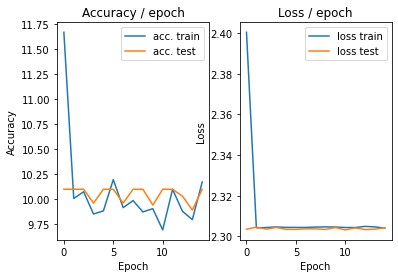

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 2.3144 (2.3144)	Prec@1   3.9 (  3.9)	Prec@5  45.3 ( 45.3)


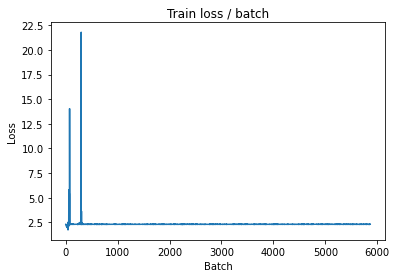

[TRAIN Batch 200/391]	Time 0.090s (0.054s)	Loss 2.3117 (2.3045)	Prec@1   7.0 (  9.9)	Prec@5  49.2 ( 49.7)


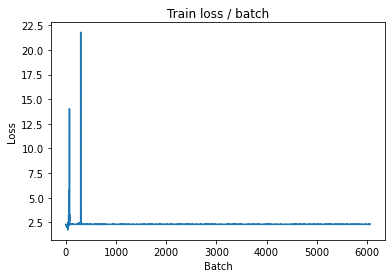


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1  9.74 %	Avg Prec@5 49.65 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 2.3052 (2.3052)	Prec@1   8.6 (  8.6)	Prec@5  50.0 ( 50.0)

===============> Total time 3s	Avg loss 2.3040	Avg Prec@1  9.96 %	Avg Prec@5 49.93 %



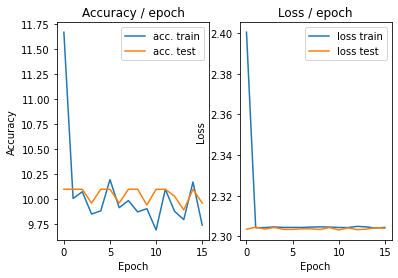

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 2.2997 (2.2997)	Prec@1  16.4 ( 16.4)	Prec@5  47.7 ( 47.7)


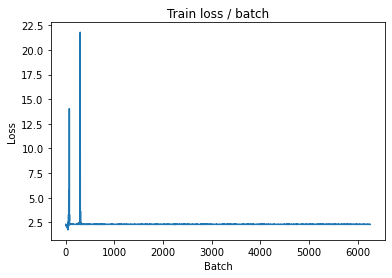

[TRAIN Batch 200/391]	Time 0.035s (0.053s)	Loss 2.3086 (2.3044)	Prec@1   8.6 ( 10.0)	Prec@5  52.3 ( 50.2)


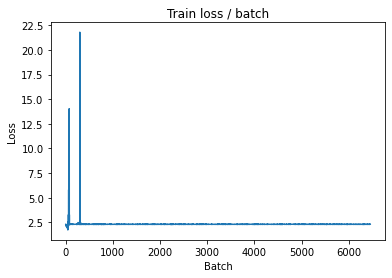


===============> Total time 20s	Avg loss 2.3043	Avg Prec@1  9.78 %	Avg Prec@5 50.29 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 2.3113 (2.3113)	Prec@1   7.8 (  7.8)	Prec@5  46.1 ( 46.1)

===============> Total time 3s	Avg loss 2.3042	Avg Prec@1  9.89 %	Avg Prec@5 50.00 %



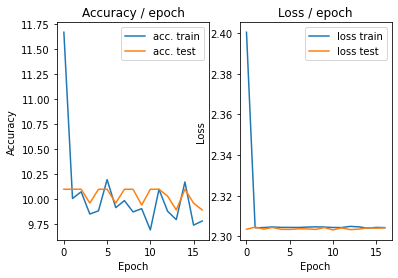

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.232s (0.232s)	Loss 2.3026 (2.3026)	Prec@1   9.4 (  9.4)	Prec@5  52.3 ( 52.3)


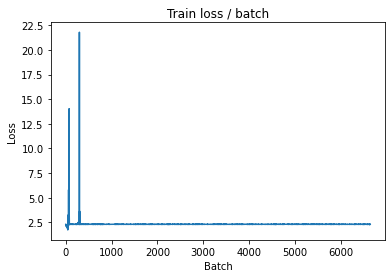

[TRAIN Batch 200/391]	Time 0.016s (0.052s)	Loss 2.3053 (2.3044)	Prec@1   7.8 ( 10.1)	Prec@5  50.8 ( 49.8)


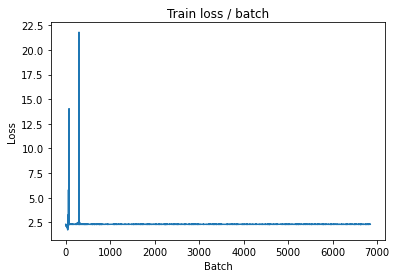


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1 10.07 %	Avg Prec@5 49.91 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 2.2993 (2.2993)	Prec@1  11.7 ( 11.7)	Prec@5  50.0 ( 50.0)

===============> Total time 3s	Avg loss 2.3043	Avg Prec@1 10.10 %	Avg Prec@5 49.93 %



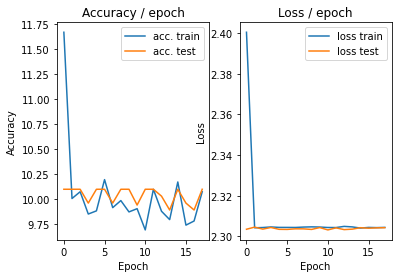

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 2.3053 (2.3053)	Prec@1   7.8 (  7.8)	Prec@5  52.3 ( 52.3)


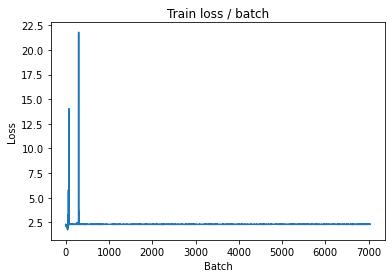

[TRAIN Batch 200/391]	Time 0.074s (0.053s)	Loss 2.2997 (2.3044)	Prec@1   7.8 ( 10.1)	Prec@5  56.2 ( 50.0)


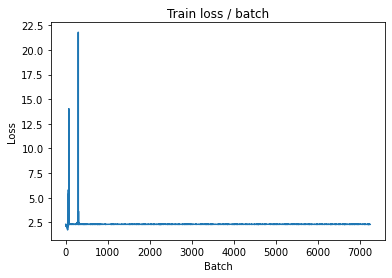


===============> Total time 20s	Avg loss 2.3045	Avg Prec@1  9.97 %	Avg Prec@5 49.91 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 2.3017 (2.3017)	Prec@1  13.3 ( 13.3)	Prec@5  52.3 ( 52.3)

===============> Total time 3s	Avg loss 2.3040	Avg Prec@1 10.10 %	Avg Prec@5 49.79 %



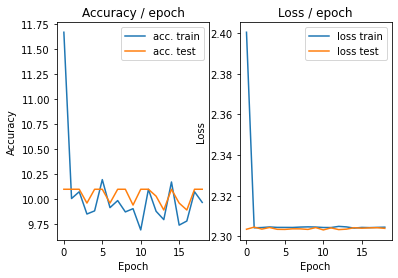

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 2.3028 (2.3028)	Prec@1   8.6 (  8.6)	Prec@5  51.6 ( 51.6)


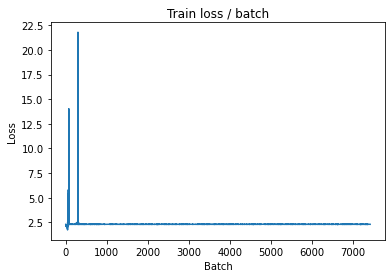

[TRAIN Batch 200/391]	Time 0.018s (0.053s)	Loss 2.3104 (2.3042)	Prec@1  10.9 ( 10.0)	Prec@5  48.4 ( 50.2)


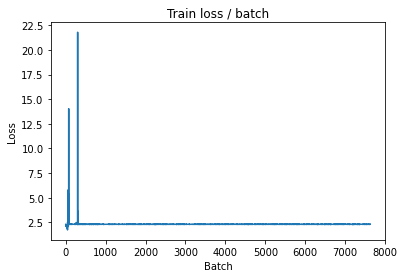


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1 10.03 %	Avg Prec@5 49.91 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 2.3141 (2.3141)	Prec@1   7.0 (  7.0)	Prec@5  44.5 ( 44.5)

===============> Total time 3s	Avg loss 2.3050	Avg Prec@1 10.10 %	Avg Prec@5 50.07 %



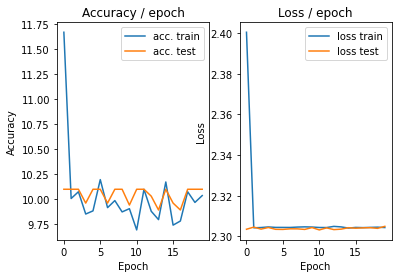

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 2.3007 (2.3007)	Prec@1  10.2 ( 10.2)	Prec@5  52.3 ( 52.3)


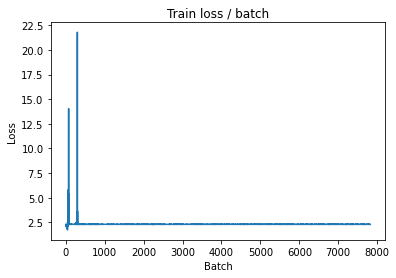

[TRAIN Batch 200/391]	Time 0.020s (0.053s)	Loss 2.3058 (2.3045)	Prec@1  11.7 (  9.8)	Prec@5  43.8 ( 49.6)


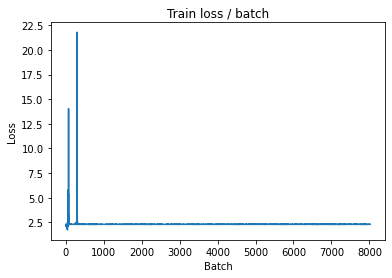


===============> Total time 20s	Avg loss 2.3045	Avg Prec@1  9.89 %	Avg Prec@5 49.50 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 2.3051 (2.3051)	Prec@1   7.0 (  7.0)	Prec@5  46.1 ( 46.1)

===============> Total time 3s	Avg loss 2.3029	Avg Prec@1 10.10 %	Avg Prec@5 50.14 %



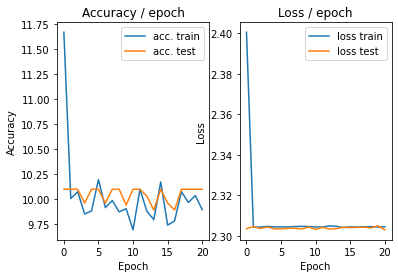

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 2.3027 (2.3027)	Prec@1  10.2 ( 10.2)	Prec@5  54.7 ( 54.7)


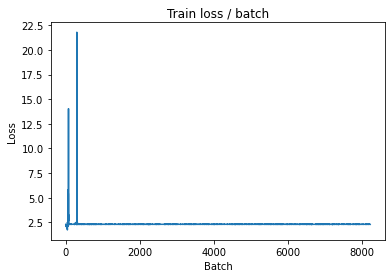

[TRAIN Batch 200/391]	Time 0.075s (0.053s)	Loss 2.3015 (2.3043)	Prec@1  10.9 ( 10.0)	Prec@5  49.2 ( 50.3)


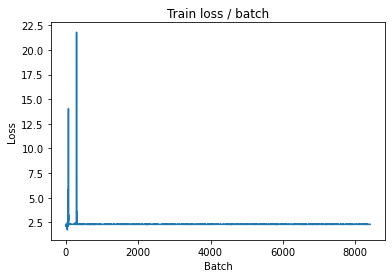


===============> Total time 20s	Avg loss 2.3046	Avg Prec@1  9.87 %	Avg Prec@5 49.80 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 2.3077 (2.3077)	Prec@1   8.6 (  8.6)	Prec@5  50.8 ( 50.8)

===============> Total time 3s	Avg loss 2.3041	Avg Prec@1  9.96 %	Avg Prec@5 50.07 %



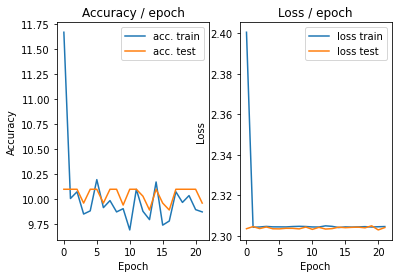

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 2.2942 (2.2942)	Prec@1   6.2 (  6.2)	Prec@5  60.2 ( 60.2)


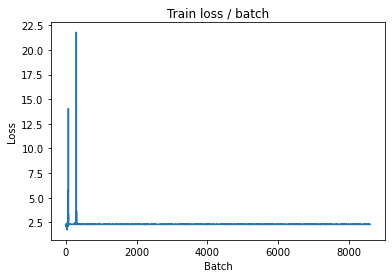

[TRAIN Batch 200/391]	Time 0.087s (0.053s)	Loss 2.2980 (2.3043)	Prec@1   8.6 (  9.9)	Prec@5  56.2 ( 49.8)


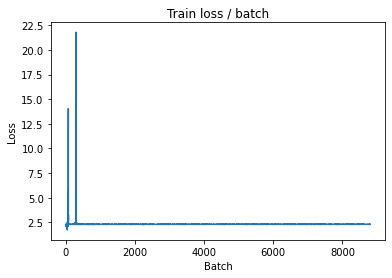


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1  9.89 %	Avg Prec@5 49.87 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 2.3086 (2.3086)	Prec@1   8.6 (  8.6)	Prec@5  51.6 ( 51.6)

===============> Total time 3s	Avg loss 2.3078	Avg Prec@1  9.96 %	Avg Prec@5 49.86 %



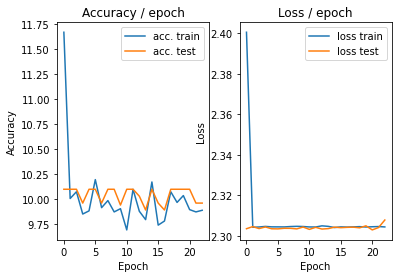

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 2.3088 (2.3088)	Prec@1  10.9 ( 10.9)	Prec@5  49.2 ( 49.2)


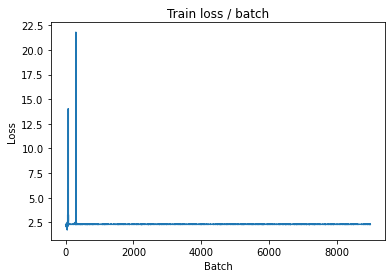

[TRAIN Batch 200/391]	Time 0.024s (0.053s)	Loss 2.3023 (2.3046)	Prec@1  11.7 (  9.8)	Prec@5  50.8 ( 50.1)


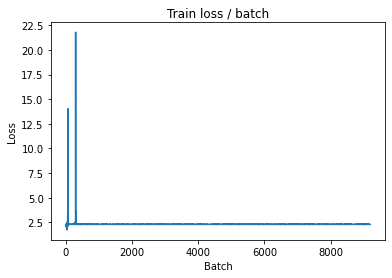


===============> Total time 20s	Avg loss 2.3046	Avg Prec@1  9.88 %	Avg Prec@5 49.98 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 2.3129 (2.3129)	Prec@1   7.8 (  7.8)	Prec@5  44.5 ( 44.5)

===============> Total time 3s	Avg loss 2.3050	Avg Prec@1  9.96 %	Avg Prec@5 50.00 %



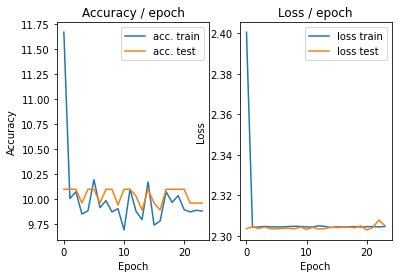

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 2.3096 (2.3096)	Prec@1   8.6 (  8.6)	Prec@5  47.7 ( 47.7)


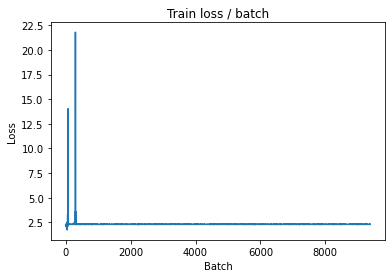

[TRAIN Batch 200/391]	Time 0.025s (0.054s)	Loss 2.3035 (2.3043)	Prec@1   9.4 ( 10.0)	Prec@5  48.4 ( 50.2)


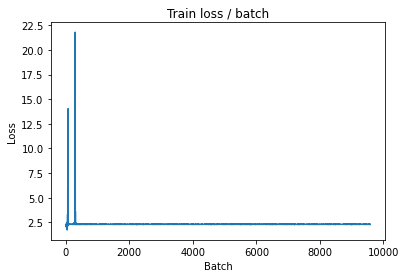


===============> Total time 20s	Avg loss 2.3042	Avg Prec@1 10.02 %	Avg Prec@5 50.22 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 2.3020 (2.3020)	Prec@1  10.2 ( 10.2)	Prec@5  54.7 ( 54.7)

===============> Total time 3s	Avg loss 2.3049	Avg Prec@1 10.10 %	Avg Prec@5 50.00 %



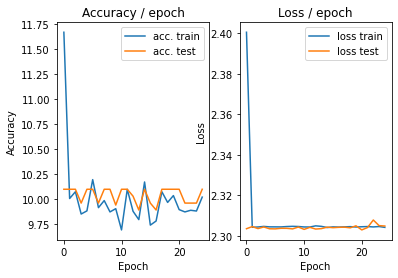

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 2.3054 (2.3054)	Prec@1  10.2 ( 10.2)	Prec@5  45.3 ( 45.3)


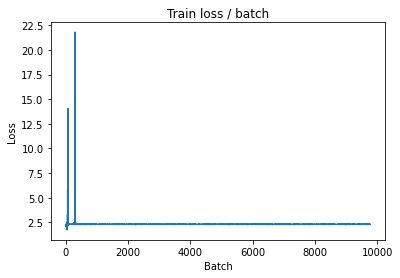

[TRAIN Batch 200/391]	Time 0.024s (0.053s)	Loss 2.3088 (2.3044)	Prec@1   7.8 ( 10.4)	Prec@5  47.7 ( 49.7)


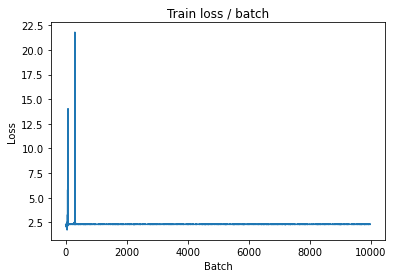


===============> Total time 20s	Avg loss 2.3043	Avg Prec@1 10.18 %	Avg Prec@5 49.93 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 2.2944 (2.2944)	Prec@1  13.3 ( 13.3)	Prec@5  60.2 ( 60.2)

===============> Total time 3s	Avg loss 2.3034	Avg Prec@1 10.10 %	Avg Prec@5 50.21 %



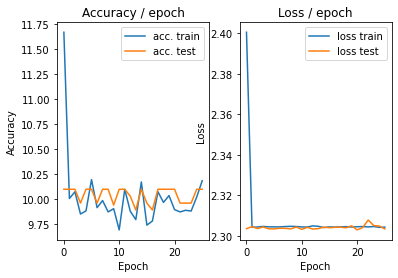

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 2.3057 (2.3057)	Prec@1  10.2 ( 10.2)	Prec@5  43.0 ( 43.0)


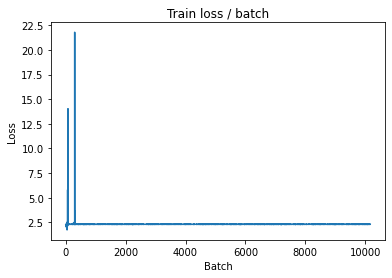

[TRAIN Batch 200/391]	Time 0.089s (0.053s)	Loss 2.3005 (2.3044)	Prec@1  11.7 (  9.7)	Prec@5  54.7 ( 49.7)


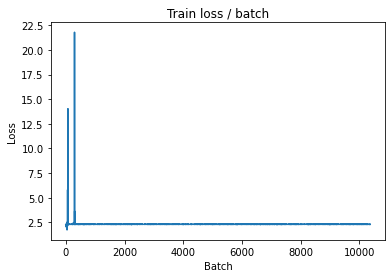


===============> Total time 20s	Avg loss 2.3045	Avg Prec@1  9.84 %	Avg Prec@5 49.72 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 2.3035 (2.3035)	Prec@1   8.6 (  8.6)	Prec@5  47.7 ( 47.7)

===============> Total time 3s	Avg loss 2.3038	Avg Prec@1  9.96 %	Avg Prec@5 50.14 %



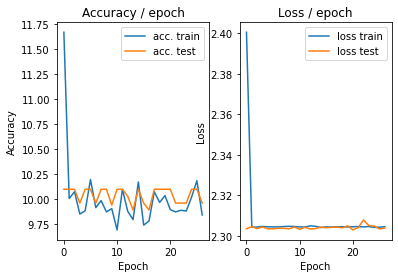

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 2.3056 (2.3056)	Prec@1   6.2 (  6.2)	Prec@5  46.9 ( 46.9)


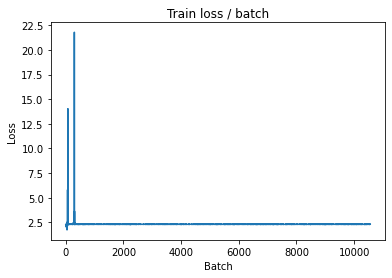

[TRAIN Batch 200/391]	Time 0.052s (0.054s)	Loss 2.3084 (2.3043)	Prec@1   7.8 (  9.6)	Prec@5  46.1 ( 49.7)


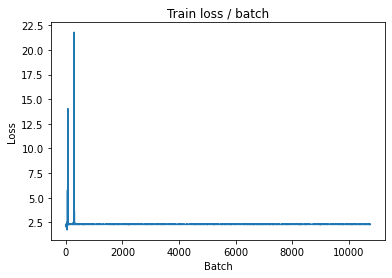


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1  9.85 %	Avg Prec@5 49.69 %

[EVAL Batch 000/079]	Time 0.202s (0.202s)	Loss 2.2977 (2.2977)	Prec@1  13.3 ( 13.3)	Prec@5  55.5 ( 55.5)

===============> Total time 3s	Avg loss 2.3030	Avg Prec@1 10.10 %	Avg Prec@5 49.93 %



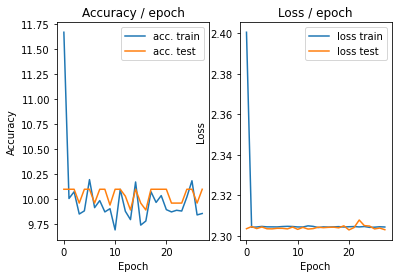

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 2.3002 (2.3002)	Prec@1  12.5 ( 12.5)	Prec@5  53.9 ( 53.9)


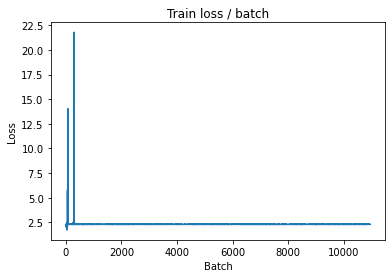

[TRAIN Batch 200/391]	Time 0.019s (0.055s)	Loss 2.2998 (2.3048)	Prec@1   7.8 (  9.7)	Prec@5  51.6 ( 49.6)


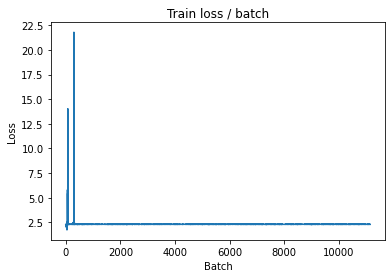


===============> Total time 20s	Avg loss 2.3047	Avg Prec@1  9.88 %	Avg Prec@5 49.73 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 2.3006 (2.3006)	Prec@1  10.2 ( 10.2)	Prec@5  52.3 ( 52.3)

===============> Total time 3s	Avg loss 2.3038	Avg Prec@1 10.03 %	Avg Prec@5 50.42 %



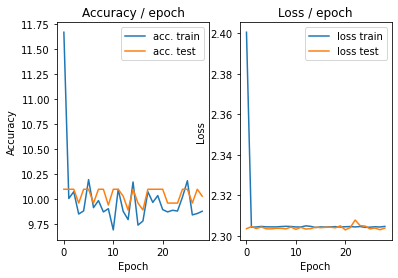

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 2.3058 (2.3058)	Prec@1  11.7 ( 11.7)	Prec@5  50.8 ( 50.8)


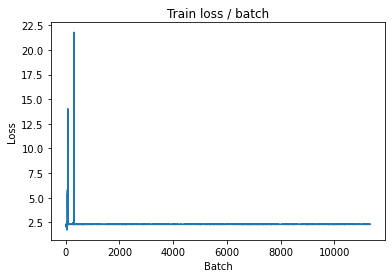

[TRAIN Batch 200/391]	Time 0.079s (0.054s)	Loss 2.3079 (2.3045)	Prec@1   6.2 (  9.9)	Prec@5  44.5 ( 49.3)


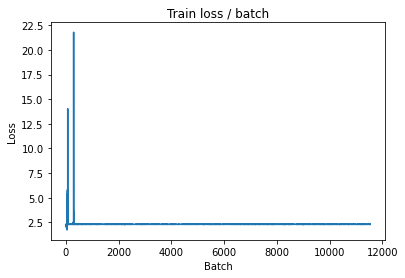


===============> Total time 20s	Avg loss 2.3045	Avg Prec@1 10.09 %	Avg Prec@5 49.63 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 2.3069 (2.3069)	Prec@1   7.0 (  7.0)	Prec@5  50.8 ( 50.8)

===============> Total time 3s	Avg loss 2.3053	Avg Prec@1 10.10 %	Avg Prec@5 50.28 %



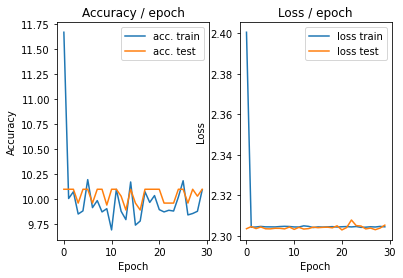

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 2.2990 (2.2990)	Prec@1  10.9 ( 10.9)	Prec@5  55.5 ( 55.5)


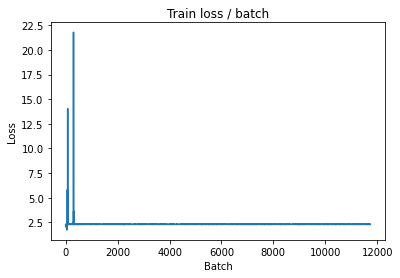

[TRAIN Batch 200/391]	Time 0.075s (0.054s)	Loss 2.3005 (2.3044)	Prec@1   9.4 (  9.8)	Prec@5  54.7 ( 49.9)


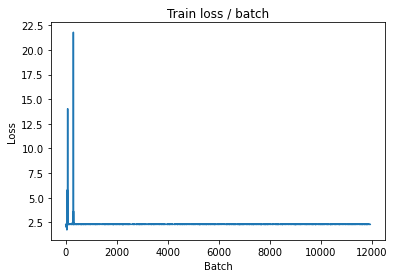


===============> Total time 21s	Avg loss 2.3043	Avg Prec@1  9.78 %	Avg Prec@5 49.98 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 2.3101 (2.3101)	Prec@1  11.7 ( 11.7)	Prec@5  50.0 ( 50.0)

===============> Total time 3s	Avg loss 2.3061	Avg Prec@1 10.10 %	Avg Prec@5 50.21 %



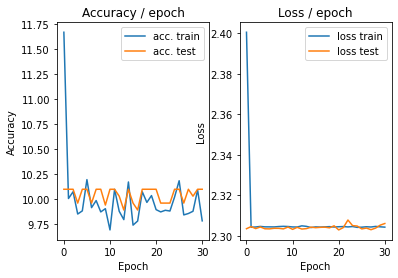

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 2.2946 (2.2946)	Prec@1  12.5 ( 12.5)	Prec@5  53.9 ( 53.9)


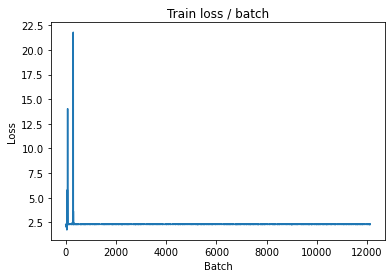

[TRAIN Batch 200/391]	Time 0.034s (0.053s)	Loss 2.3081 (2.3040)	Prec@1  10.2 ( 10.1)	Prec@5  46.9 ( 50.2)


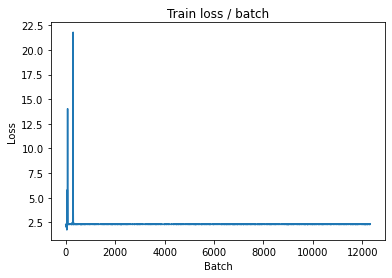


===============> Total time 20s	Avg loss 2.3043	Avg Prec@1 10.03 %	Avg Prec@5 49.94 %

[EVAL Batch 000/079]	Time 0.202s (0.202s)	Loss 2.3042 (2.3042)	Prec@1   7.0 (  7.0)	Prec@5  55.5 ( 55.5)

===============> Total time 3s	Avg loss 2.3045	Avg Prec@1 10.10 %	Avg Prec@5 50.21 %



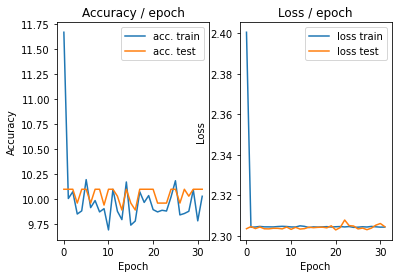

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 2.3117 (2.3117)	Prec@1   9.4 (  9.4)	Prec@5  49.2 ( 49.2)


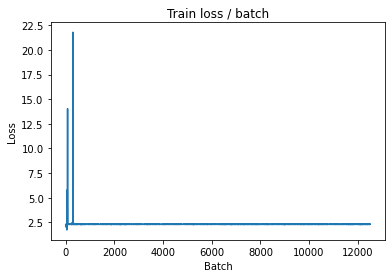

[TRAIN Batch 200/391]	Time 0.094s (0.053s)	Loss 2.2981 (2.3040)	Prec@1   5.5 (  9.8)	Prec@5  52.3 ( 50.1)


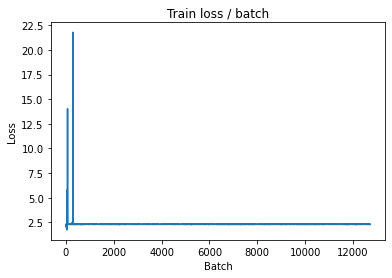


===============> Total time 20s	Avg loss 2.3041	Avg Prec@1  9.94 %	Avg Prec@5 50.14 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 2.3018 (2.3018)	Prec@1  14.8 ( 14.8)	Prec@5  49.2 ( 49.2)

===============> Total time 3s	Avg loss 2.3066	Avg Prec@1  9.89 %	Avg Prec@5 49.72 %



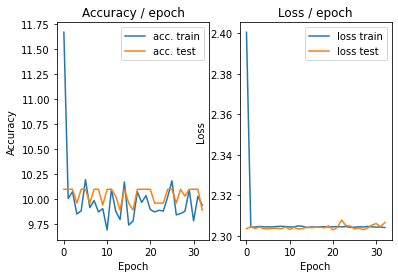

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 2.3101 (2.3101)	Prec@1  11.7 ( 11.7)	Prec@5  46.1 ( 46.1)


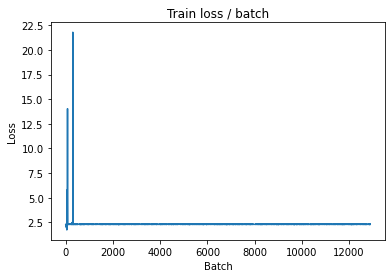

[TRAIN Batch 200/391]	Time 0.022s (0.053s)	Loss 2.2995 (2.3042)	Prec@1  10.2 ( 10.2)	Prec@5  51.6 ( 50.3)


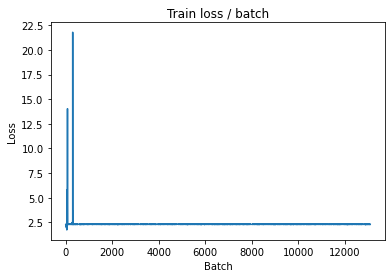


===============> Total time 20s	Avg loss 2.3043	Avg Prec@1 10.06 %	Avg Prec@5 50.13 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 2.3066 (2.3066)	Prec@1   7.8 (  7.8)	Prec@5  46.1 ( 46.1)

===============> Total time 3s	Avg loss 2.3035	Avg Prec@1  9.96 %	Avg Prec@5 49.93 %



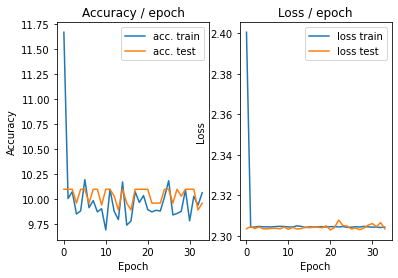

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 2.3105 (2.3105)	Prec@1   3.9 (  3.9)	Prec@5  45.3 ( 45.3)


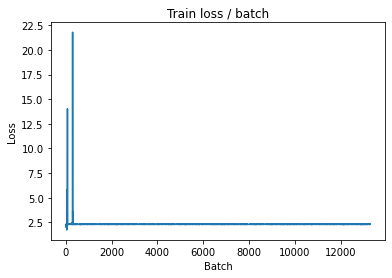

[TRAIN Batch 200/391]	Time 0.019s (0.054s)	Loss 2.3090 (2.3040)	Prec@1  10.9 (  9.8)	Prec@5  46.1 ( 50.2)


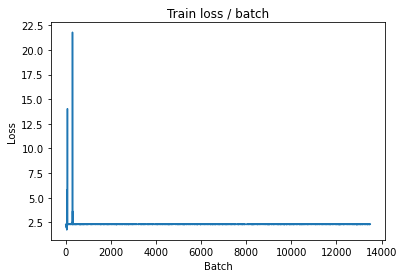


===============> Total time 20s	Avg loss 2.3041	Avg Prec@1  9.83 %	Avg Prec@5 50.02 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 2.3060 (2.3060)	Prec@1   7.0 (  7.0)	Prec@5  49.2 ( 49.2)

===============> Total time 3s	Avg loss 2.3030	Avg Prec@1 10.10 %	Avg Prec@5 50.21 %



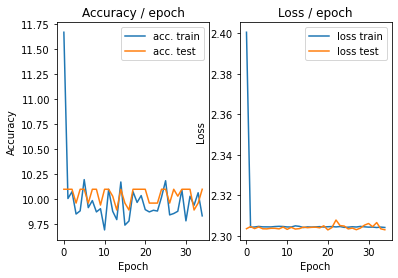

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 2.3028 (2.3028)	Prec@1   7.0 (  7.0)	Prec@5  50.8 ( 50.8)


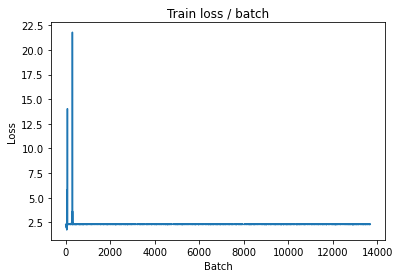

[TRAIN Batch 200/391]	Time 0.018s (0.053s)	Loss 2.3080 (2.3041)	Prec@1   5.5 (  9.7)	Prec@5  45.3 ( 49.9)


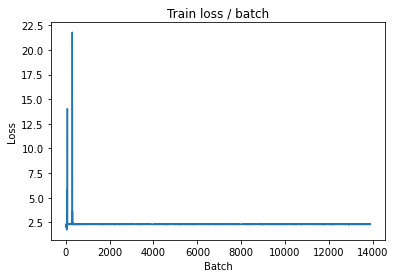


===============> Total time 20s	Avg loss 2.3043	Avg Prec@1  9.66 %	Avg Prec@5 49.87 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 2.2971 (2.2971)	Prec@1  13.3 ( 13.3)	Prec@5  53.9 ( 53.9)

===============> Total time 3s	Avg loss 2.3040	Avg Prec@1 10.10 %	Avg Prec@5 50.14 %



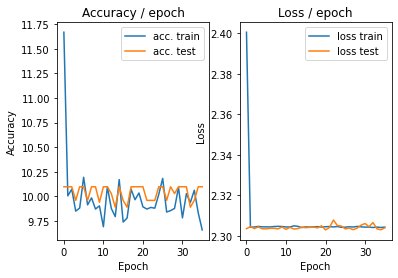

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 2.3032 (2.3032)	Prec@1   6.2 (  6.2)	Prec@5  51.6 ( 51.6)


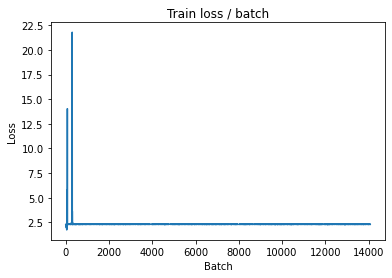

[TRAIN Batch 200/391]	Time 0.084s (0.053s)	Loss 2.3079 (2.3039)	Prec@1  10.2 ( 10.2)	Prec@5  53.9 ( 50.2)


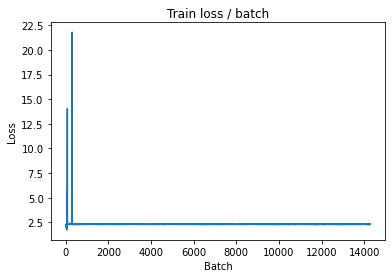


===============> Total time 20s	Avg loss 2.3041	Avg Prec@1 10.05 %	Avg Prec@5 50.27 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 2.3047 (2.3047)	Prec@1   7.8 (  7.8)	Prec@5  48.4 ( 48.4)

===============> Total time 3s	Avg loss 2.3048	Avg Prec@1  9.89 %	Avg Prec@5 49.79 %



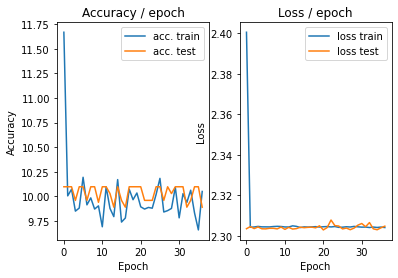

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 2.3051 (2.3051)	Prec@1   7.8 (  7.8)	Prec@5  47.7 ( 47.7)


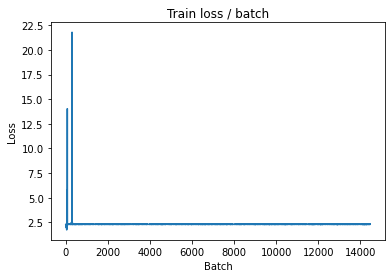

[TRAIN Batch 200/391]	Time 0.062s (0.054s)	Loss 2.3071 (2.3049)	Prec@1  11.7 (  9.7)	Prec@5  47.7 ( 49.6)


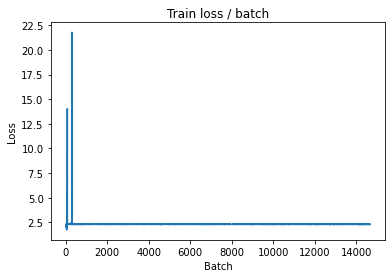


===============> Total time 20s	Avg loss 2.3045	Avg Prec@1  9.88 %	Avg Prec@5 49.59 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 2.3003 (2.3003)	Prec@1   8.6 (  8.6)	Prec@5  52.3 ( 52.3)

===============> Total time 3s	Avg loss 2.3043	Avg Prec@1  9.89 %	Avg Prec@5 49.72 %



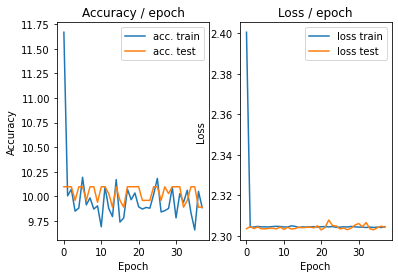

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 2.3056 (2.3056)	Prec@1  10.2 ( 10.2)	Prec@5  50.0 ( 50.0)


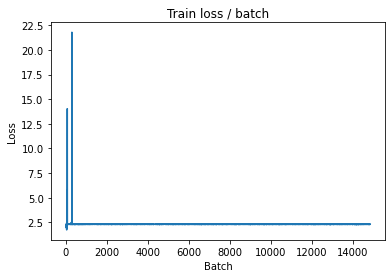

[TRAIN Batch 200/391]	Time 0.016s (0.054s)	Loss 2.3049 (2.3046)	Prec@1  10.2 ( 10.0)	Prec@5  46.9 ( 49.8)


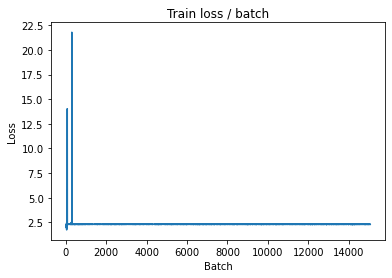


===============> Total time 20s	Avg loss 2.3046	Avg Prec@1  9.91 %	Avg Prec@5 49.78 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 2.3110 (2.3110)	Prec@1   7.8 (  7.8)	Prec@5  46.9 ( 46.9)

===============> Total time 3s	Avg loss 2.3041	Avg Prec@1  9.96 %	Avg Prec@5 49.93 %



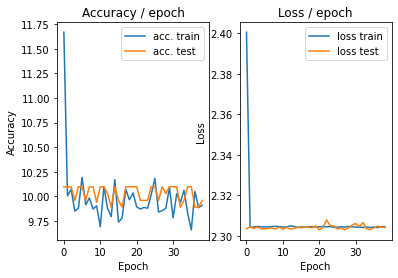

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 2.2986 (2.2986)	Prec@1  10.9 ( 10.9)	Prec@5  55.5 ( 55.5)


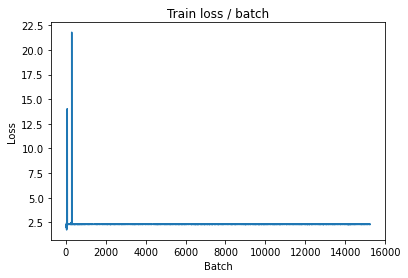

[TRAIN Batch 200/391]	Time 0.025s (0.054s)	Loss 2.3077 (2.3045)	Prec@1   9.4 ( 10.3)	Prec@5  43.8 ( 49.4)


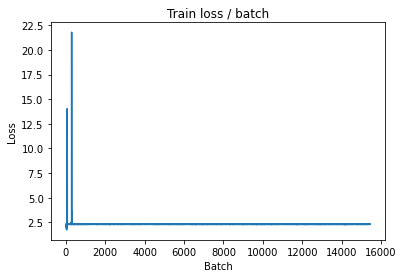


===============> Total time 20s	Avg loss 2.3045	Avg Prec@1 10.15 %	Avg Prec@5 49.54 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 2.2957 (2.2957)	Prec@1  14.8 ( 14.8)	Prec@5  53.1 ( 53.1)

===============> Total time 3s	Avg loss 2.3038	Avg Prec@1  9.89 %	Avg Prec@5 49.79 %



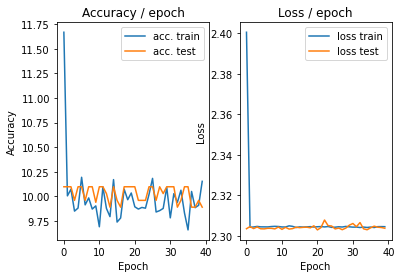

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 2.3056 (2.3056)	Prec@1  10.2 ( 10.2)	Prec@5  47.7 ( 47.7)


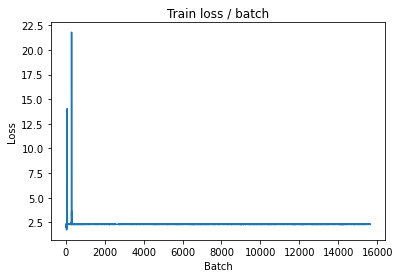

[TRAIN Batch 200/391]	Time 0.093s (0.053s)	Loss 2.3061 (2.3044)	Prec@1  10.2 ( 10.0)	Prec@5  47.7 ( 49.8)


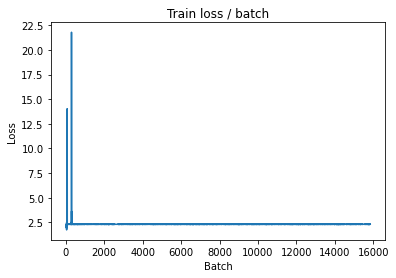


===============> Total time 20s	Avg loss 2.3044	Avg Prec@1 10.12 %	Avg Prec@5 49.86 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 2.3159 (2.3159)	Prec@1   8.6 (  8.6)	Prec@5  43.8 ( 43.8)

===============> Total time 3s	Avg loss 2.3051	Avg Prec@1  9.89 %	Avg Prec@5 50.00 %



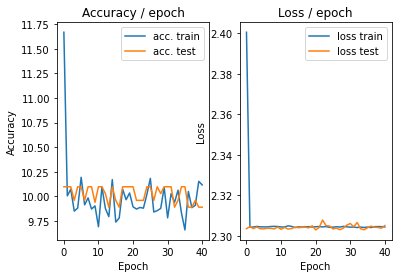

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 2.3118 (2.3118)	Prec@1  10.9 ( 10.9)	Prec@5  45.3 ( 45.3)


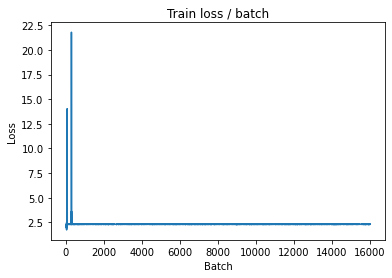

[TRAIN Batch 200/391]	Time 0.035s (0.054s)	Loss 2.3114 (2.3048)	Prec@1   9.4 (  9.8)	Prec@5  42.2 ( 49.4)


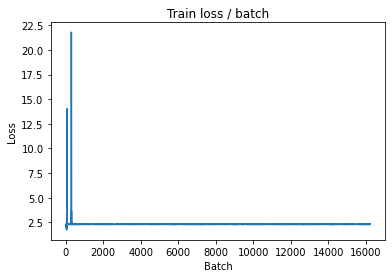


===============> Total time 20s	Avg loss 2.3045	Avg Prec@1  9.79 %	Avg Prec@5 49.84 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 2.3084 (2.3084)	Prec@1   7.0 (  7.0)	Prec@5  48.4 ( 48.4)

===============> Total time 3s	Avg loss 2.3043	Avg Prec@1 10.10 %	Avg Prec@5 49.93 %



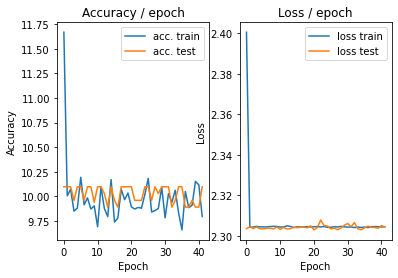

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 2.3037 (2.3037)	Prec@1   7.0 (  7.0)	Prec@5  51.6 ( 51.6)


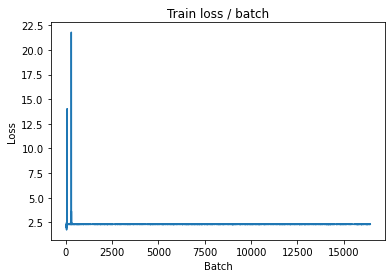

[TRAIN Batch 200/391]	Time 0.065s (0.053s)	Loss 2.3048 (2.3044)	Prec@1   7.8 ( 10.0)	Prec@5  55.5 ( 50.1)


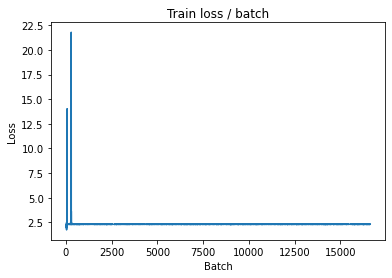


===============> Total time 20s	Avg loss 2.3043	Avg Prec@1  9.92 %	Avg Prec@5 50.16 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 2.3085 (2.3085)	Prec@1   8.6 (  8.6)	Prec@5  48.4 ( 48.4)

===============> Total time 3s	Avg loss 2.3043	Avg Prec@1  9.89 %	Avg Prec@5 50.00 %



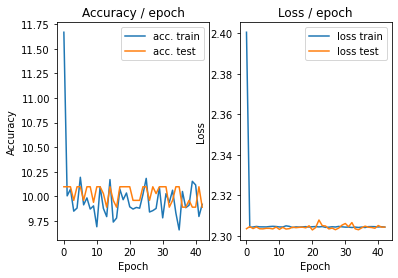

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 2.3162 (2.3162)	Prec@1  10.9 ( 10.9)	Prec@5  42.2 ( 42.2)


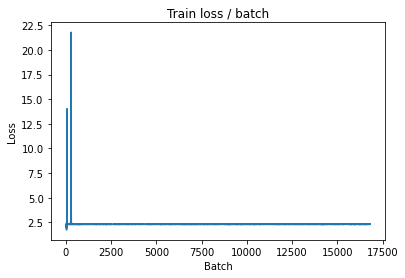

[TRAIN Batch 200/391]	Time 0.084s (0.054s)	Loss 2.3044 (2.3043)	Prec@1  10.9 ( 10.3)	Prec@5  50.8 ( 50.0)


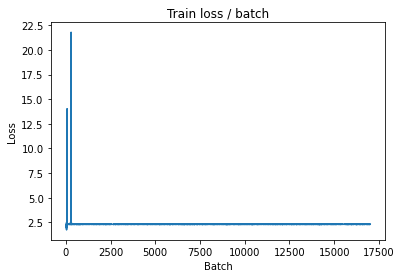


===============> Total time 20s	Avg loss 2.3043	Avg Prec@1 10.16 %	Avg Prec@5 49.94 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 2.3015 (2.3015)	Prec@1  13.3 ( 13.3)	Prec@5  49.2 ( 49.2)

===============> Total time 3s	Avg loss 2.3032	Avg Prec@1 10.10 %	Avg Prec@5 49.93 %



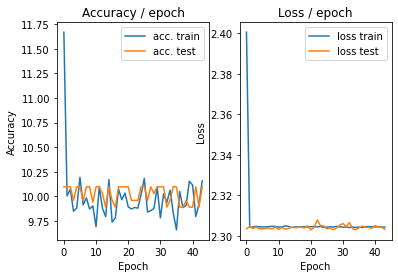

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 2.2986 (2.2986)	Prec@1  13.3 ( 13.3)	Prec@5  55.5 ( 55.5)


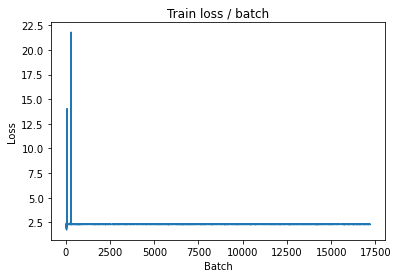

[TRAIN Batch 200/391]	Time 0.080s (0.054s)	Loss 2.3050 (2.3039)	Prec@1   9.4 ( 10.3)	Prec@5  48.4 ( 50.6)


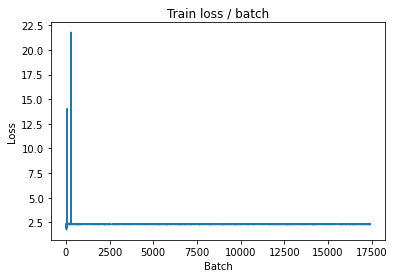


===============> Total time 20s	Avg loss 2.3043	Avg Prec@1 10.13 %	Avg Prec@5 50.16 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 2.3078 (2.3078)	Prec@1   7.8 (  7.8)	Prec@5  48.4 ( 48.4)

===============> Total time 3s	Avg loss 2.3052	Avg Prec@1  9.89 %	Avg Prec@5 49.79 %



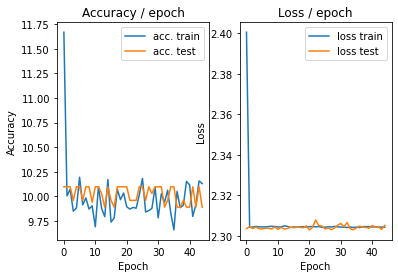

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.232s (0.232s)	Loss 2.3036 (2.3036)	Prec@1   7.8 (  7.8)	Prec@5  50.8 ( 50.8)


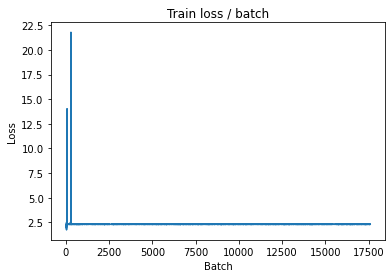

[TRAIN Batch 200/391]	Time 0.089s (0.054s)	Loss 2.3030 (2.3043)	Prec@1  10.2 ( 10.2)	Prec@5  53.1 ( 50.3)


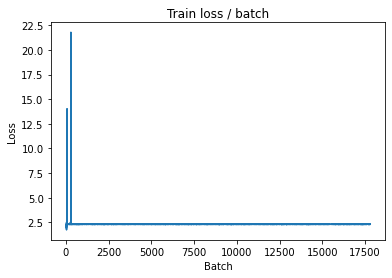


===============> Total time 20s	Avg loss 2.3045	Avg Prec@1 10.06 %	Avg Prec@5 49.94 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 2.3008 (2.3008)	Prec@1  13.3 ( 13.3)	Prec@5  47.7 ( 47.7)

===============> Total time 3s	Avg loss 2.3037	Avg Prec@1 10.10 %	Avg Prec@5 49.86 %



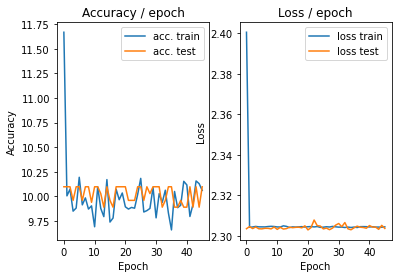

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 2.3146 (2.3146)	Prec@1   7.8 (  7.8)	Prec@5  38.3 ( 38.3)


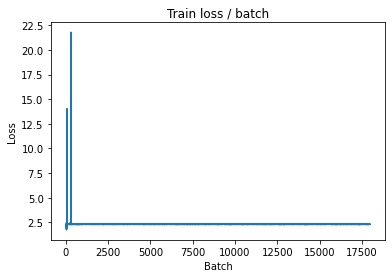

[TRAIN Batch 200/391]	Time 0.036s (0.055s)	Loss 2.3012 (2.3043)	Prec@1  13.3 (  9.8)	Prec@5  49.2 ( 49.6)


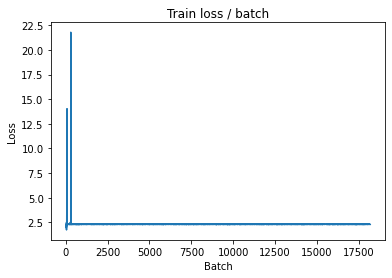


===============> Total time 21s	Avg loss 2.3046	Avg Prec@1  9.99 %	Avg Prec@5 49.63 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 2.3018 (2.3018)	Prec@1  10.2 ( 10.2)	Prec@5  53.1 ( 53.1)

===============> Total time 3s	Avg loss 2.3031	Avg Prec@1 10.10 %	Avg Prec@5 50.07 %



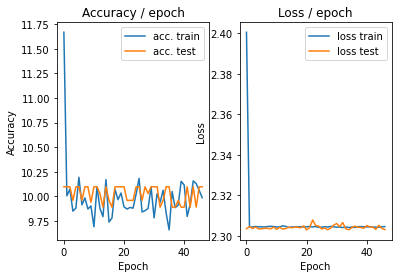

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.259s (0.259s)	Loss 2.3036 (2.3036)	Prec@1   9.4 (  9.4)	Prec@5  53.9 ( 53.9)


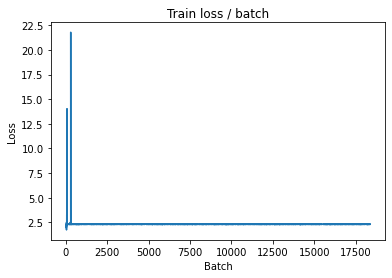

[TRAIN Batch 200/391]	Time 0.070s (0.054s)	Loss 2.3160 (2.3048)	Prec@1   7.8 ( 10.1)	Prec@5  45.3 ( 49.4)


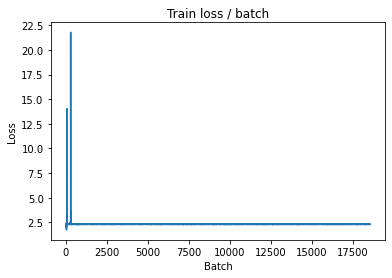


===============> Total time 20s	Avg loss 2.3047	Avg Prec@1  9.98 %	Avg Prec@5 49.36 %

[EVAL Batch 000/079]	Time 0.202s (0.202s)	Loss 2.3028 (2.3028)	Prec@1  10.2 ( 10.2)	Prec@5  52.3 ( 52.3)

===============> Total time 3s	Avg loss 2.3040	Avg Prec@1 10.10 %	Avg Prec@5 50.07 %



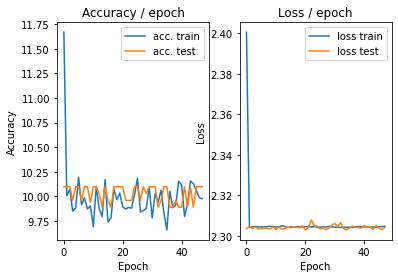

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 2.3082 (2.3082)	Prec@1   9.4 (  9.4)	Prec@5  47.7 ( 47.7)


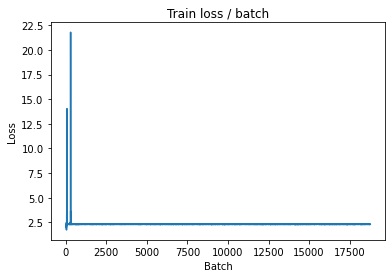

[TRAIN Batch 200/391]	Time 0.088s (0.054s)	Loss 2.2980 (2.3046)	Prec@1  13.3 ( 10.0)	Prec@5  57.0 ( 50.1)


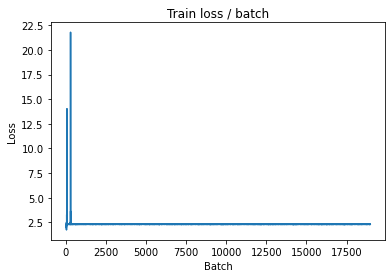


===============> Total time 20s	Avg loss 2.3045	Avg Prec@1  9.96 %	Avg Prec@5 50.16 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 2.3052 (2.3052)	Prec@1   7.8 (  7.8)	Prec@5  48.4 ( 48.4)

===============> Total time 3s	Avg loss 2.3045	Avg Prec@1  9.89 %	Avg Prec@5 49.79 %



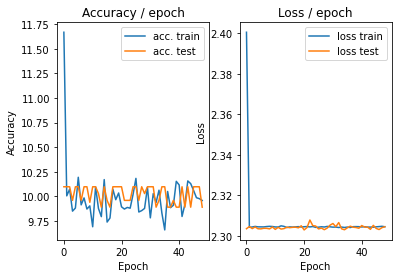

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 2.3099 (2.3099)	Prec@1   4.7 (  4.7)	Prec@5  46.1 ( 46.1)


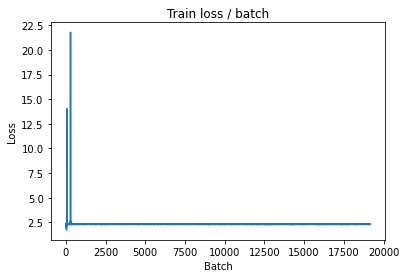

[TRAIN Batch 200/391]	Time 0.087s (0.054s)	Loss 2.3061 (2.3048)	Prec@1   8.6 ( 10.1)	Prec@5  50.8 ( 50.1)


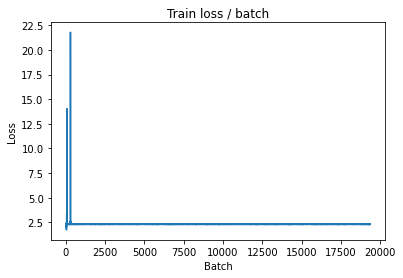


===============> Total time 20s	Avg loss 2.3047	Avg Prec@1 10.03 %	Avg Prec@5 49.81 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 2.3094 (2.3094)	Prec@1   7.0 (  7.0)	Prec@5  46.9 ( 46.9)

===============> Total time 3s	Avg loss 2.3042	Avg Prec@1 10.10 %	Avg Prec@5 50.07 %



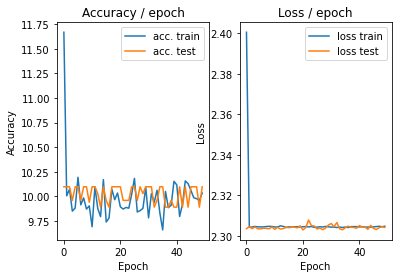

In [ ]:
main(128, 0.1,epochs=50, cuda=True)

momentum + schedule

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.9)
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

        lr_sched.step()

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====



/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[TRAIN Batch 000/391]	Time 0.760s (0.760s)	Loss 2.2974 (2.2974)	Prec@1   7.8 (  7.8)	Prec@5  60.9 ( 60.9)


<Figure size 432x288 with 0 Axes>

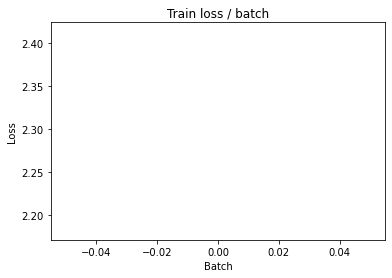

[TRAIN Batch 200/391]	Time 0.025s (0.055s)	Loss 1.8417 (1.9916)	Prec@1  33.6 ( 26.2)	Prec@5  86.7 ( 78.6)


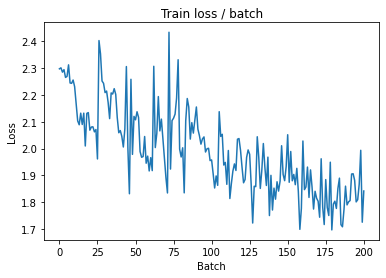


===============> Total time 21s	Avg loss 1.8632	Avg Prec@1 31.20 %	Avg Prec@5 83.03 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 1.5967 (1.5967)	Prec@1  46.9 ( 46.9)	Prec@5  92.2 ( 92.2)

===============> Total time 3s	Avg loss 1.5924	Avg Prec@1 39.95 %	Avg Prec@5 90.68 %



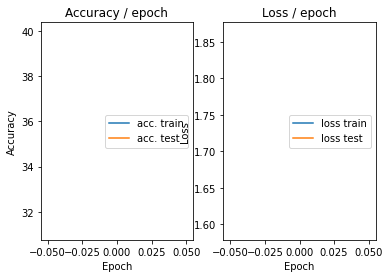

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 1.6949 (1.6949)	Prec@1  37.5 ( 37.5)	Prec@5  89.1 ( 89.1)


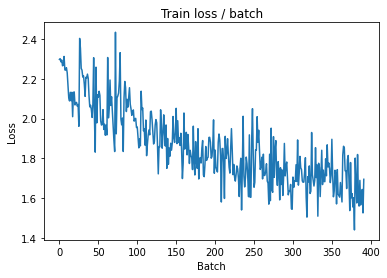

[TRAIN Batch 200/391]	Time 0.049s (0.053s)	Loss 1.7126 (1.6446)	Prec@1  39.1 ( 39.6)	Prec@5  88.3 ( 89.0)


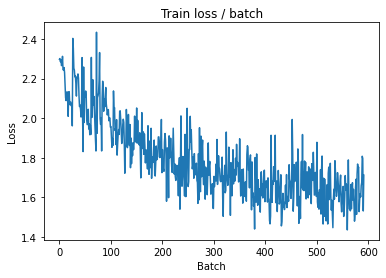


===============> Total time 20s	Avg loss 1.6165	Avg Prec@1 40.85 %	Avg Prec@5 89.64 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 1.5746 (1.5746)	Prec@1  45.3 ( 45.3)	Prec@5  91.4 ( 91.4)

===============> Total time 3s	Avg loss 1.5925	Avg Prec@1 42.18 %	Avg Prec@5 90.11 %



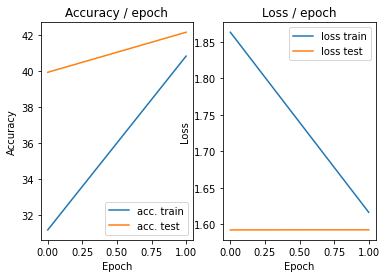

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 1.6039 (1.6039)	Prec@1  38.3 ( 38.3)	Prec@5  93.8 ( 93.8)


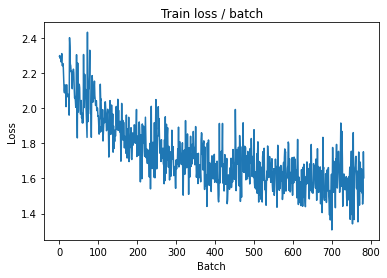

[TRAIN Batch 200/391]	Time 0.020s (0.053s)	Loss 1.4601 (1.5443)	Prec@1  46.9 ( 44.1)	Prec@5  90.6 ( 90.9)


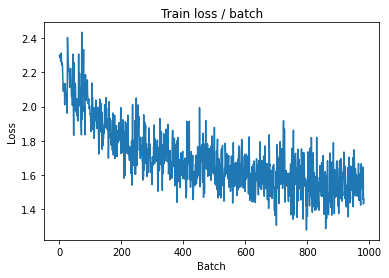


===============> Total time 20s	Avg loss 1.5475	Avg Prec@1 44.41 %	Avg Prec@5 90.83 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 1.5463 (1.5463)	Prec@1  48.4 ( 48.4)	Prec@5  92.2 ( 92.2)

===============> Total time 3s	Avg loss 1.5272	Avg Prec@1 46.56 %	Avg Prec@5 91.76 %



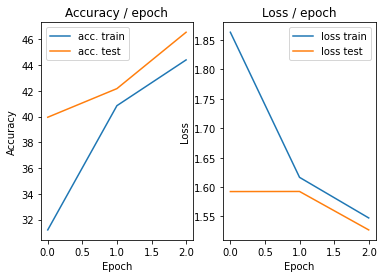

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.192s (0.192s)	Loss 1.5419 (1.5419)	Prec@1  42.2 ( 42.2)	Prec@5  94.5 ( 94.5)


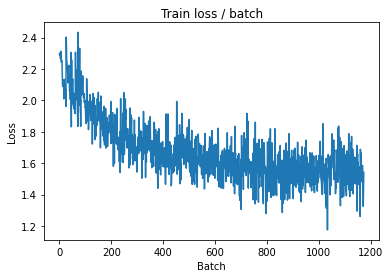

[TRAIN Batch 200/391]	Time 0.085s (0.053s)	Loss 1.4169 (1.4638)	Prec@1  48.4 ( 47.8)	Prec@5  94.5 ( 92.1)


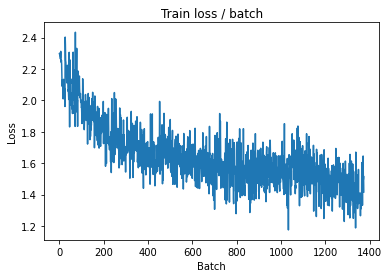


===============> Total time 20s	Avg loss 1.4586	Avg Prec@1 48.15 %	Avg Prec@5 92.07 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 1.4999 (1.4999)	Prec@1  49.2 ( 49.2)	Prec@5  91.4 ( 91.4)

===============> Total time 3s	Avg loss 1.4856	Avg Prec@1 49.50 %	Avg Prec@5 92.09 %



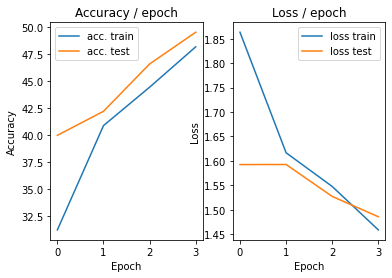

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 1.2434 (1.2434)	Prec@1  54.7 ( 54.7)	Prec@5  93.8 ( 93.8)


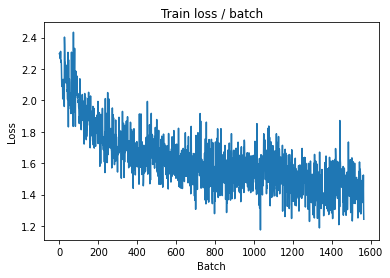

[TRAIN Batch 200/391]	Time 0.020s (0.054s)	Loss 1.3975 (1.4025)	Prec@1  47.7 ( 50.4)	Prec@5  93.0 ( 92.6)


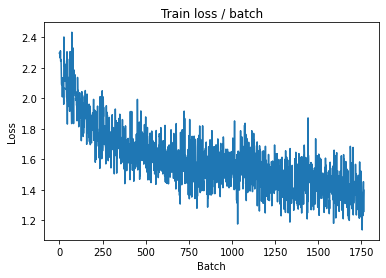


===============> Total time 20s	Avg loss 1.4054	Avg Prec@1 50.55 %	Avg Prec@5 92.47 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 1.3439 (1.3439)	Prec@1  49.2 ( 49.2)	Prec@5  93.0 ( 93.0)

===============> Total time 3s	Avg loss 1.3256	Avg Prec@1 54.09 %	Avg Prec@5 93.25 %



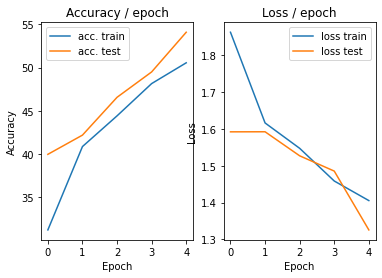

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 1.5055 (1.5055)	Prec@1  49.2 ( 49.2)	Prec@5  93.8 ( 93.8)


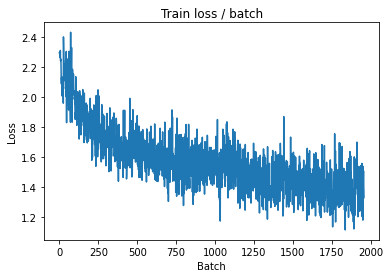

[TRAIN Batch 200/391]	Time 0.026s (0.053s)	Loss 1.1477 (1.3492)	Prec@1  55.5 ( 53.1)	Prec@5  97.7 ( 93.2)


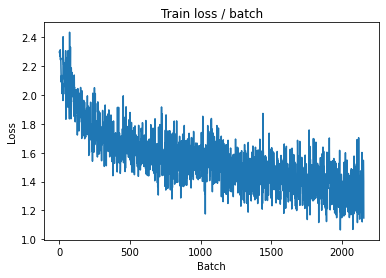


===============> Total time 20s	Avg loss 1.3522	Avg Prec@1 52.94 %	Avg Prec@5 93.12 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 1.4557 (1.4557)	Prec@1  50.8 ( 50.8)	Prec@5  91.4 ( 91.4)

===============> Total time 3s	Avg loss 1.3139	Avg Prec@1 55.02 %	Avg Prec@5 93.18 %



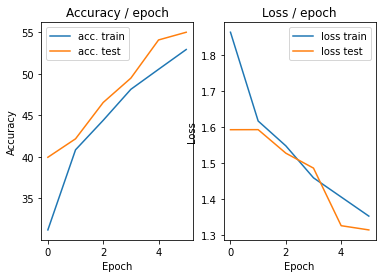

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 1.5515 (1.5515)	Prec@1  46.1 ( 46.1)	Prec@5  89.8 ( 89.8)


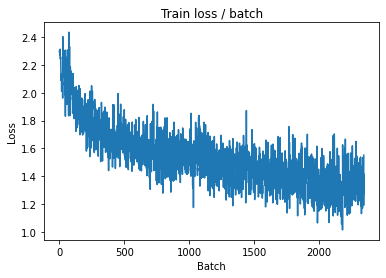

[TRAIN Batch 200/391]	Time 0.027s (0.053s)	Loss 1.2678 (1.3072)	Prec@1  53.9 ( 54.6)	Prec@5  96.9 ( 93.7)


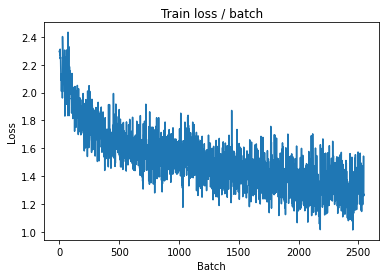


===============> Total time 20s	Avg loss 1.3125	Avg Prec@1 54.55 %	Avg Prec@5 93.54 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 1.3232 (1.3232)	Prec@1  52.3 ( 52.3)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.3290	Avg Prec@1 54.46 %	Avg Prec@5 93.54 %



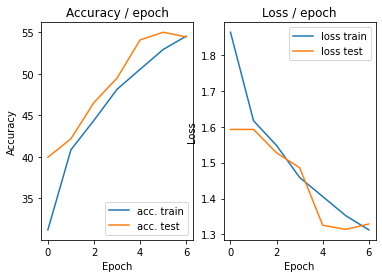

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 1.2322 (1.2322)	Prec@1  57.0 ( 57.0)	Prec@5  95.3 ( 95.3)


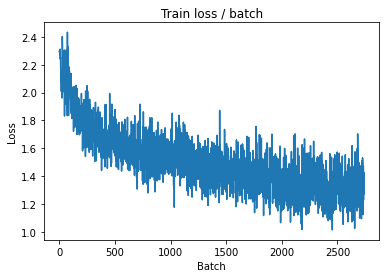

[TRAIN Batch 200/391]	Time 0.019s (0.053s)	Loss 1.3213 (1.2747)	Prec@1  49.2 ( 55.7)	Prec@5  94.5 ( 93.8)


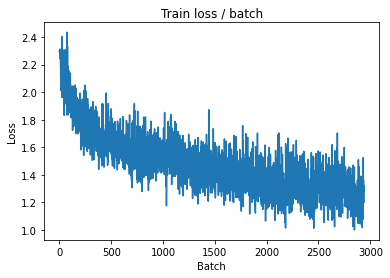


===============> Total time 20s	Avg loss 1.2730	Avg Prec@1 56.18 %	Avg Prec@5 93.79 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 1.1959 (1.1959)	Prec@1  60.9 ( 60.9)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.1838	Avg Prec@1 59.67 %	Avg Prec@5 94.51 %



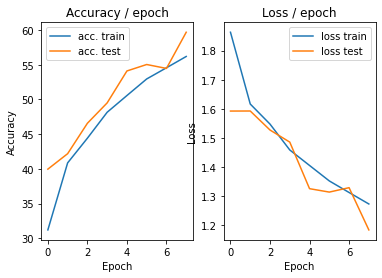

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 1.2308 (1.2308)	Prec@1  57.0 ( 57.0)	Prec@5  93.8 ( 93.8)


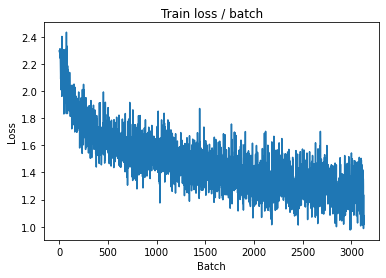

[TRAIN Batch 200/391]	Time 0.081s (0.053s)	Loss 1.2082 (1.2226)	Prec@1  56.2 ( 57.8)	Prec@5  93.0 ( 94.3)


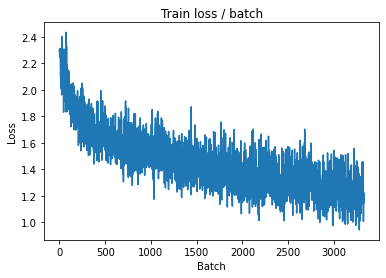


===============> Total time 20s	Avg loss 1.2328	Avg Prec@1 57.70 %	Avg Prec@5 94.27 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 1.2433 (1.2433)	Prec@1  64.1 ( 64.1)	Prec@5  93.8 ( 93.8)

===============> Total time 3s	Avg loss 1.1670	Avg Prec@1 60.65 %	Avg Prec@5 94.45 %



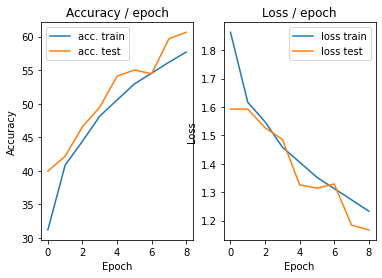

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 1.2240 (1.2240)	Prec@1  58.6 ( 58.6)	Prec@5  93.0 ( 93.0)


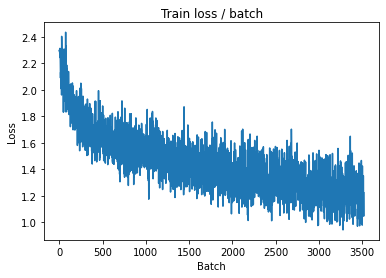

[TRAIN Batch 200/391]	Time 0.017s (0.053s)	Loss 1.0210 (1.1673)	Prec@1  71.1 ( 59.8)	Prec@5  96.1 ( 94.8)


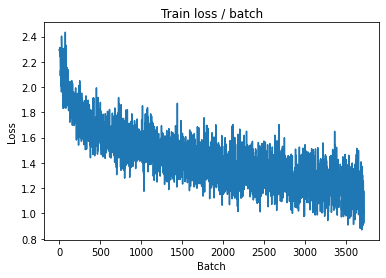


===============> Total time 20s	Avg loss 1.1777	Avg Prec@1 59.61 %	Avg Prec@5 94.73 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 1.2588 (1.2588)	Prec@1  58.6 ( 58.6)	Prec@5  92.2 ( 92.2)

===============> Total time 3s	Avg loss 1.1492	Avg Prec@1 60.70 %	Avg Prec@5 95.04 %



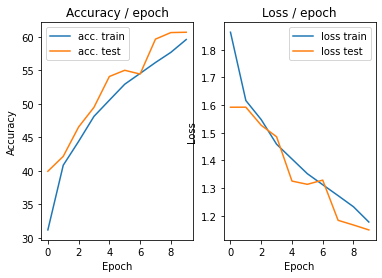

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 1.3208 (1.3208)	Prec@1  58.6 ( 58.6)	Prec@5  90.6 ( 90.6)


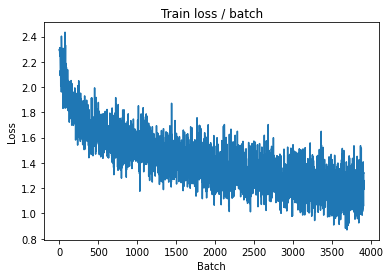

[TRAIN Batch 200/391]	Time 0.036s (0.053s)	Loss 0.8761 (1.1757)	Prec@1  67.2 ( 60.1)	Prec@5  96.9 ( 94.6)


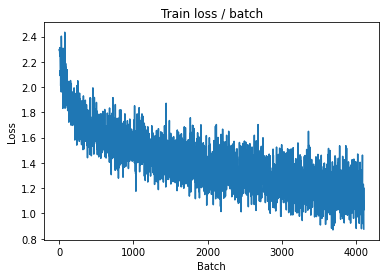


===============> Total time 20s	Avg loss 1.1575	Avg Prec@1 60.50 %	Avg Prec@5 94.85 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.1164 (1.1164)	Prec@1  63.3 ( 63.3)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.1025	Avg Prec@1 63.09 %	Avg Prec@5 95.17 %



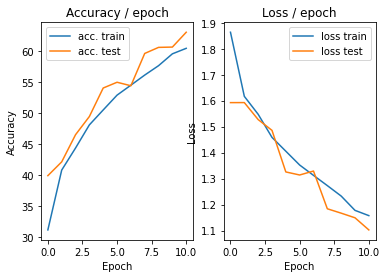

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 1.3304 (1.3304)	Prec@1  57.0 ( 57.0)	Prec@5  94.5 ( 94.5)


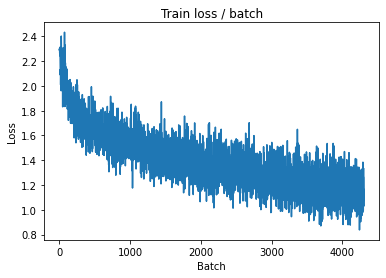

[TRAIN Batch 200/391]	Time 0.089s (0.053s)	Loss 1.1711 (1.1209)	Prec@1  60.9 ( 62.1)	Prec@5  95.3 ( 95.2)


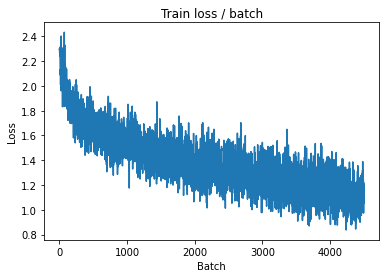


===============> Total time 20s	Avg loss 1.1086	Avg Prec@1 62.54 %	Avg Prec@5 95.18 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.2367 (1.2367)	Prec@1  66.4 ( 66.4)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.1230	Avg Prec@1 63.14 %	Avg Prec@5 95.51 %



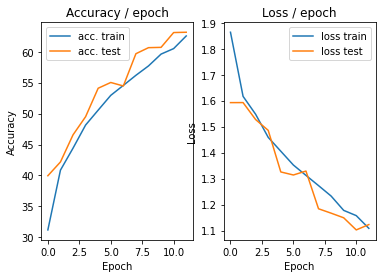

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.227s (0.227s)	Loss 1.0575 (1.0575)	Prec@1  62.5 ( 62.5)	Prec@5  96.9 ( 96.9)


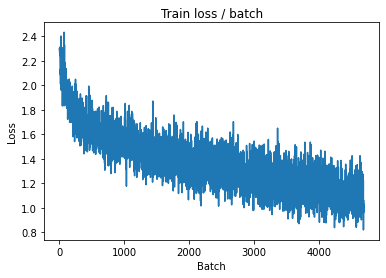

[TRAIN Batch 200/391]	Time 0.027s (0.053s)	Loss 1.1865 (1.0841)	Prec@1  61.7 ( 63.2)	Prec@5  97.7 ( 95.3)


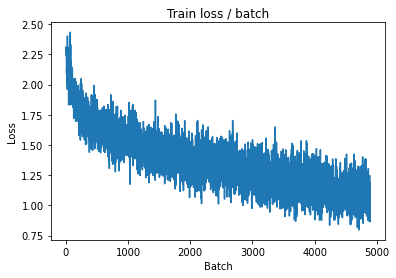


===============> Total time 20s	Avg loss 1.0796	Avg Prec@1 63.31 %	Avg Prec@5 95.44 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 1.0359 (1.0359)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.0539	Avg Prec@1 64.58 %	Avg Prec@5 95.80 %



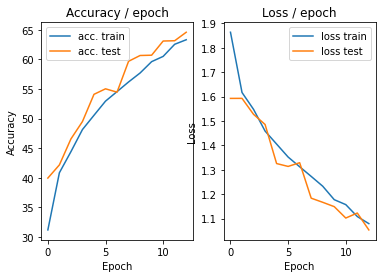

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.8324 (0.8324)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)


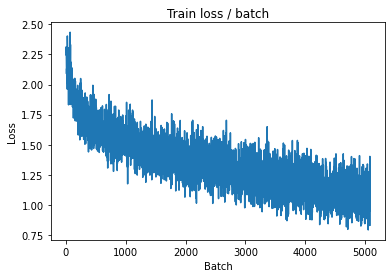

[TRAIN Batch 200/391]	Time 0.088s (0.053s)	Loss 1.0141 (1.0242)	Prec@1  65.6 ( 65.2)	Prec@5  97.7 ( 95.9)


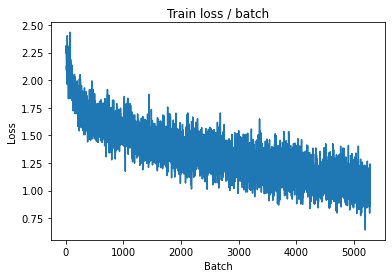


===============> Total time 20s	Avg loss 1.0273	Avg Prec@1 65.30 %	Avg Prec@5 95.95 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 0.9970 (0.9970)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.0361	Avg Prec@1 64.86 %	Avg Prec@5 95.70 %



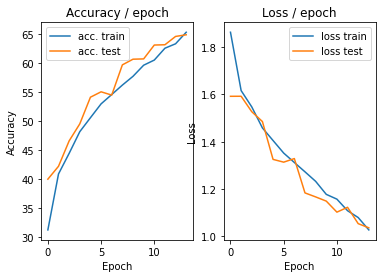

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.215s (0.215s)	Loss 0.9913 (0.9913)	Prec@1  67.2 ( 67.2)	Prec@5  94.5 ( 94.5)


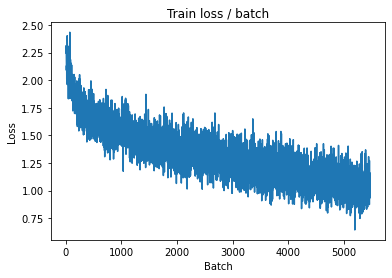

[TRAIN Batch 200/391]	Time 0.023s (0.053s)	Loss 1.0145 (0.9875)	Prec@1  66.4 ( 66.6)	Prec@5  96.9 ( 96.2)


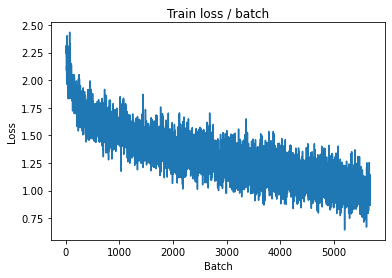


===============> Total time 20s	Avg loss 0.9953	Avg Prec@1 66.53 %	Avg Prec@5 96.10 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.9663 (0.9663)	Prec@1  71.9 ( 71.9)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 0.9863	Avg Prec@1 67.32 %	Avg Prec@5 96.46 %



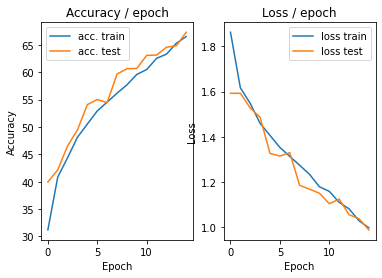

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.9142 (0.9142)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)


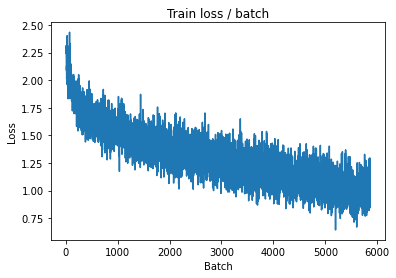

[TRAIN Batch 200/391]	Time 0.050s (0.054s)	Loss 0.9441 (0.9512)	Prec@1  65.6 ( 67.8)	Prec@5  98.4 ( 96.7)


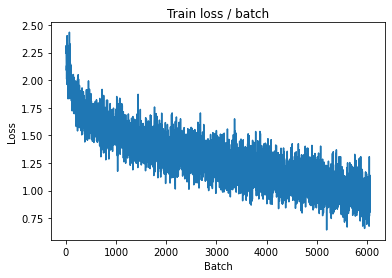


===============> Total time 20s	Avg loss 0.9654	Avg Prec@1 67.30 %	Avg Prec@5 96.47 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 1.0105 (1.0105)	Prec@1  65.6 ( 65.6)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.0508	Avg Prec@1 66.14 %	Avg Prec@5 95.16 %



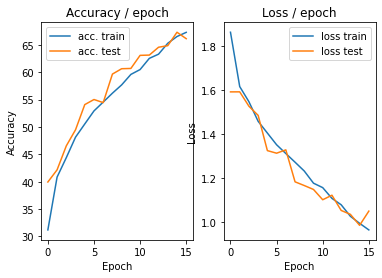

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.8031 (0.8031)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)


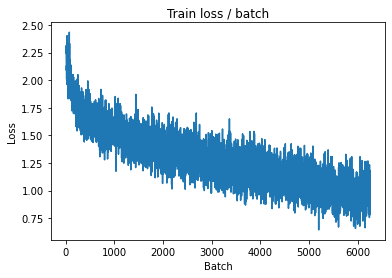

[TRAIN Batch 200/391]	Time 0.095s (0.054s)	Loss 1.1797 (0.9302)	Prec@1  60.9 ( 68.3)	Prec@5  95.3 ( 96.7)


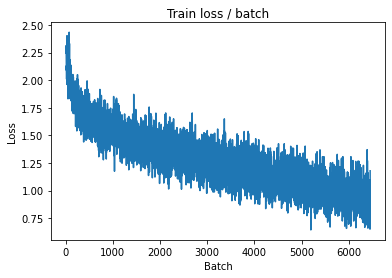


===============> Total time 20s	Avg loss 0.9300	Avg Prec@1 68.41 %	Avg Prec@5 96.71 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 0.9827 (0.9827)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9631	Avg Prec@1 68.32 %	Avg Prec@5 96.55 %



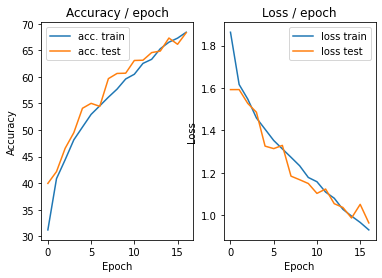

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.9743 (0.9743)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)


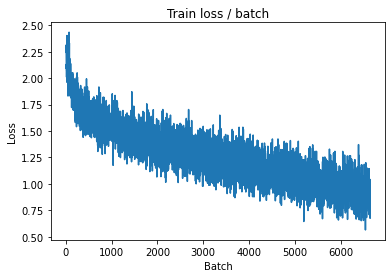

[TRAIN Batch 200/391]	Time 0.026s (0.053s)	Loss 0.7176 (0.8955)	Prec@1  77.3 ( 70.0)	Prec@5  96.1 ( 96.9)


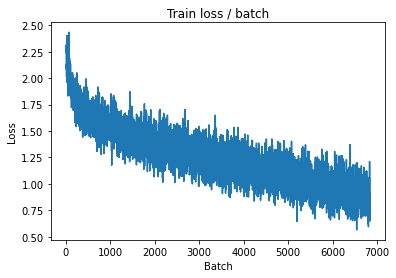


===============> Total time 20s	Avg loss 0.8982	Avg Prec@1 69.76 %	Avg Prec@5 96.90 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.9359 (0.9359)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9539	Avg Prec@1 67.91 %	Avg Prec@5 96.50 %



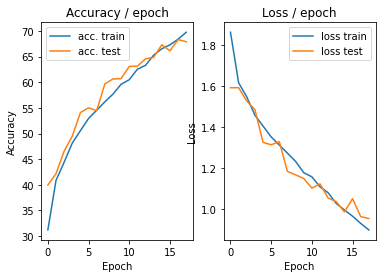

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.8154 (0.8154)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 99.2)


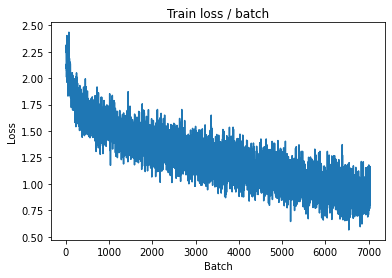

[TRAIN Batch 200/391]	Time 0.028s (0.053s)	Loss 0.8304 (0.8606)	Prec@1  77.3 ( 70.9)	Prec@5  97.7 ( 97.2)


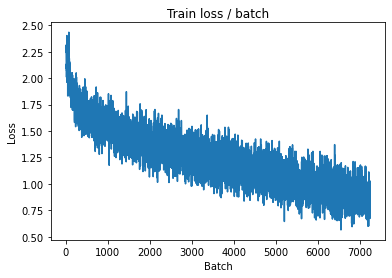


===============> Total time 20s	Avg loss 0.8669	Avg Prec@1 70.70 %	Avg Prec@5 97.16 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 0.8214 (0.8214)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8755	Avg Prec@1 71.78 %	Avg Prec@5 97.17 %



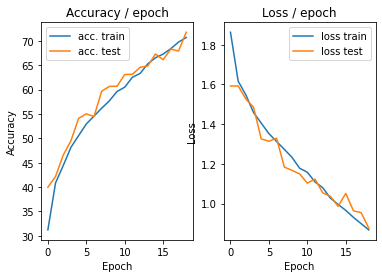

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.227s (0.227s)	Loss 0.9550 (0.9550)	Prec@1  68.0 ( 68.0)	Prec@5  95.3 ( 95.3)


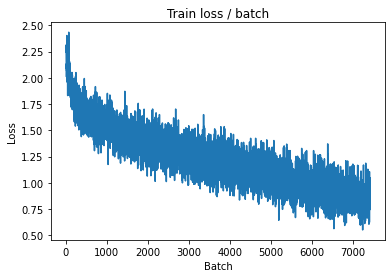

[TRAIN Batch 200/391]	Time 0.104s (0.054s)	Loss 0.7457 (0.8315)	Prec@1  77.3 ( 71.6)	Prec@5  98.4 ( 97.7)


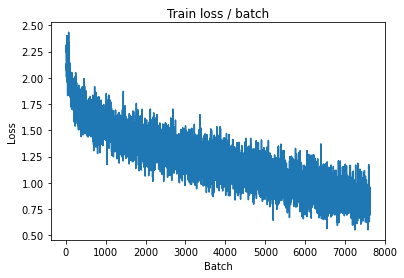


===============> Total time 20s	Avg loss 0.8365	Avg Prec@1 71.76 %	Avg Prec@5 97.45 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.9159 (0.9159)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9118	Avg Prec@1 70.95 %	Avg Prec@5 97.16 %



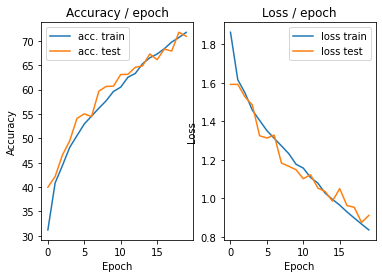

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.9125 (0.9125)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)


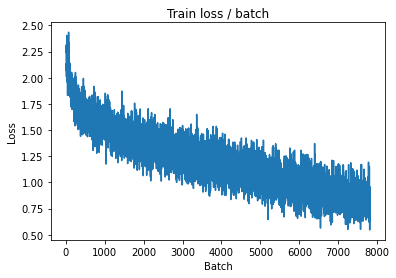

[TRAIN Batch 200/391]	Time 0.038s (0.054s)	Loss 1.0364 (0.8131)	Prec@1  68.0 ( 72.5)	Prec@5  96.1 ( 97.4)


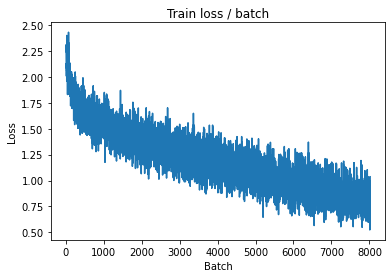


===============> Total time 20s	Avg loss 0.8129	Avg Prec@1 72.61 %	Avg Prec@5 97.43 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.7799 (0.7799)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8929	Avg Prec@1 71.16 %	Avg Prec@5 97.16 %



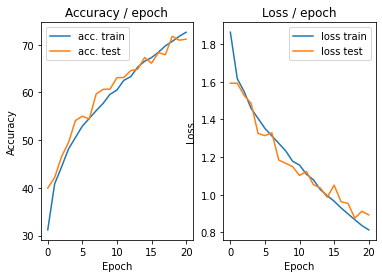

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 0.6128 (0.6128)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


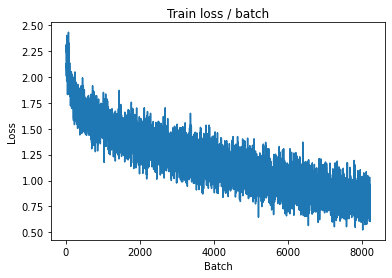

[TRAIN Batch 200/391]	Time 0.031s (0.054s)	Loss 0.7598 (0.7688)	Prec@1  73.4 ( 74.2)	Prec@5  98.4 ( 97.8)


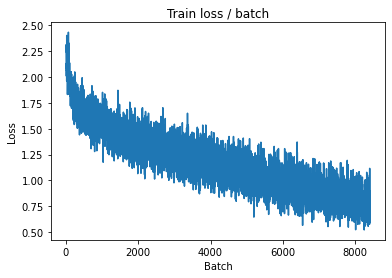


===============> Total time 20s	Avg loss 0.7902	Avg Prec@1 73.30 %	Avg Prec@5 97.67 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 0.8857 (0.8857)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8976	Avg Prec@1 70.76 %	Avg Prec@5 96.97 %



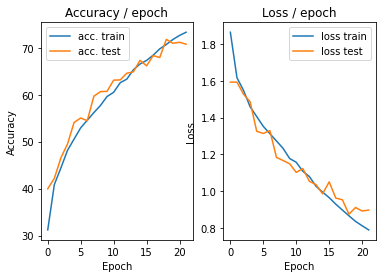

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.8107 (0.8107)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)


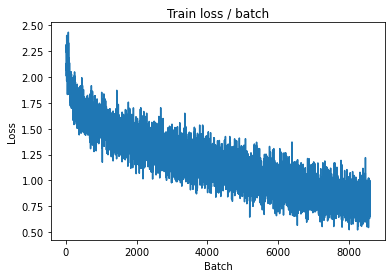

[TRAIN Batch 200/391]	Time 0.024s (0.054s)	Loss 0.8280 (0.7697)	Prec@1  75.8 ( 73.7)	Prec@5  96.9 ( 97.9)


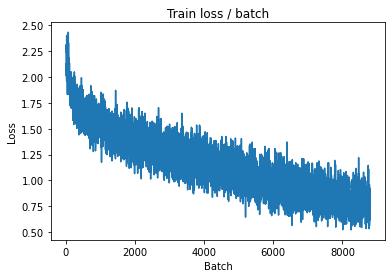


===============> Total time 20s	Avg loss 0.7613	Avg Prec@1 74.14 %	Avg Prec@5 97.82 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.7950 (0.7950)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8739	Avg Prec@1 72.45 %	Avg Prec@5 97.13 %



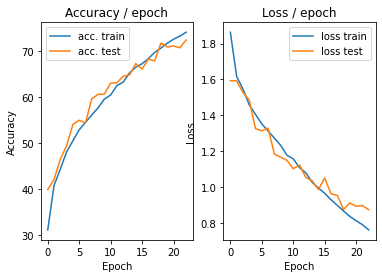

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 0.7753 (0.7753)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)


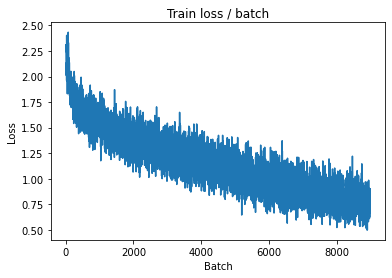

[TRAIN Batch 200/391]	Time 0.065s (0.054s)	Loss 0.6946 (0.7206)	Prec@1  75.0 ( 75.3)	Prec@5  99.2 ( 98.1)


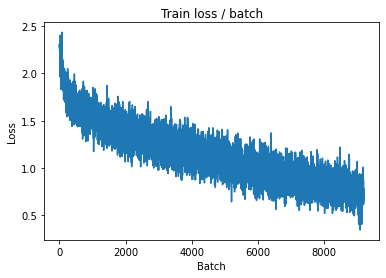


===============> Total time 20s	Avg loss 0.7234	Avg Prec@1 75.34 %	Avg Prec@5 98.00 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.7423 (0.7423)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8368	Avg Prec@1 73.36 %	Avg Prec@5 97.45 %



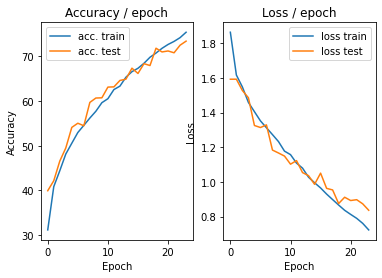

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.6702 (0.6702)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)


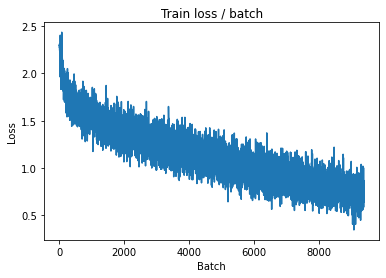

[TRAIN Batch 200/391]	Time 0.060s (0.054s)	Loss 0.8290 (0.6929)	Prec@1  70.3 ( 76.2)	Prec@5  97.7 ( 98.2)


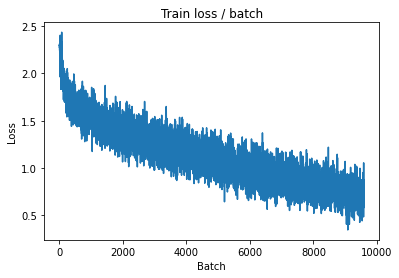


===============> Total time 20s	Avg loss 0.7069	Avg Prec@1 75.89 %	Avg Prec@5 98.20 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.7812 (0.7812)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8310	Avg Prec@1 74.10 %	Avg Prec@5 97.63 %



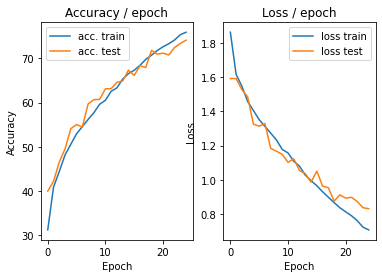

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.5856 (0.5856)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)


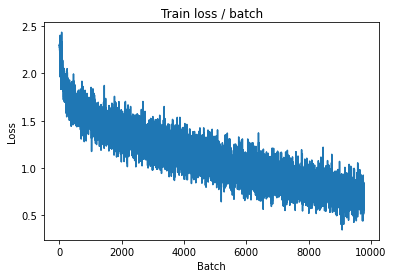

[TRAIN Batch 200/391]	Time 0.081s (0.053s)	Loss 0.6361 (0.6689)	Prec@1  75.8 ( 77.0)	Prec@5  97.7 ( 98.4)


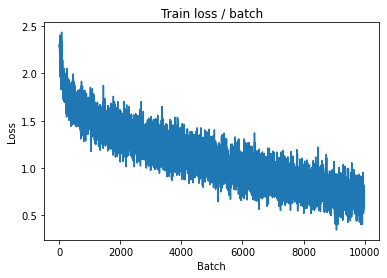


===============> Total time 20s	Avg loss 0.6797	Avg Prec@1 76.77 %	Avg Prec@5 98.31 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.7656 (0.7656)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8323	Avg Prec@1 73.94 %	Avg Prec@5 97.65 %



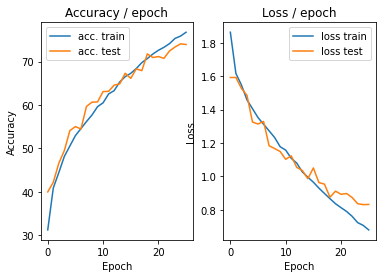

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 0.6391 (0.6391)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)


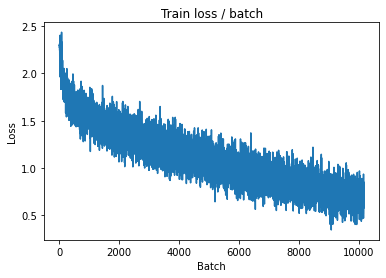

[TRAIN Batch 200/391]	Time 0.066s (0.055s)	Loss 0.5546 (0.6443)	Prec@1  76.6 ( 77.9)	Prec@5  98.4 ( 98.5)


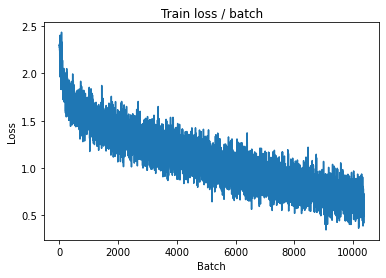


===============> Total time 20s	Avg loss 0.6589	Avg Prec@1 77.59 %	Avg Prec@5 98.39 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 0.7730 (0.7730)	Prec@1  77.3 ( 77.3)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 0.7983	Avg Prec@1 74.71 %	Avg Prec@5 97.48 %



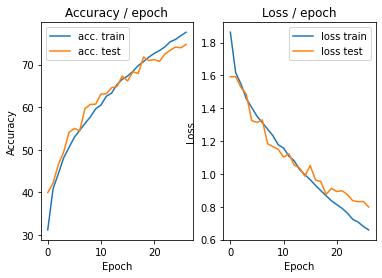

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 0.6596 (0.6596)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)


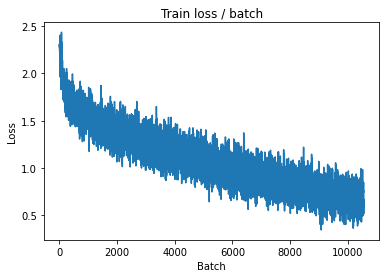

[TRAIN Batch 200/391]	Time 0.018s (0.054s)	Loss 0.6536 (0.6394)	Prec@1  70.3 ( 78.2)	Prec@5  99.2 ( 98.4)


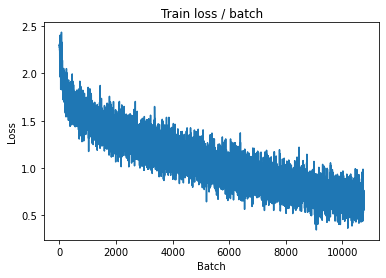


===============> Total time 20s	Avg loss 0.6450	Avg Prec@1 78.01 %	Avg Prec@5 98.39 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 0.6161 (0.6161)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8076	Avg Prec@1 75.52 %	Avg Prec@5 97.65 %



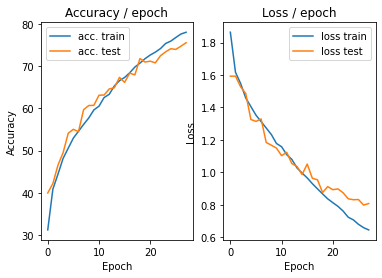

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 0.7436 (0.7436)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)


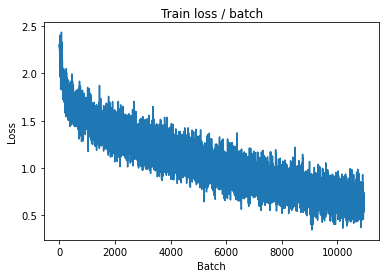

[TRAIN Batch 200/391]	Time 0.024s (0.054s)	Loss 0.5245 (0.6069)	Prec@1  82.8 ( 79.6)	Prec@5  99.2 ( 98.6)


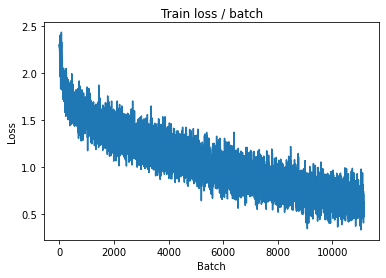


===============> Total time 20s	Avg loss 0.6146	Avg Prec@1 79.04 %	Avg Prec@5 98.61 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.5846 (0.5846)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7970	Avg Prec@1 75.49 %	Avg Prec@5 97.81 %



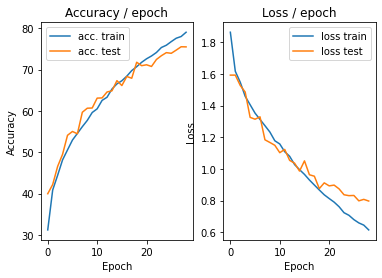

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.6712 (0.6712)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)


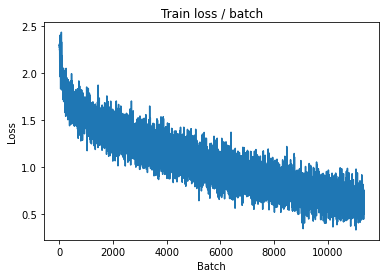

[TRAIN Batch 200/391]	Time 0.089s (0.054s)	Loss 0.6635 (0.5890)	Prec@1  78.1 ( 79.8)	Prec@5  96.9 ( 98.8)


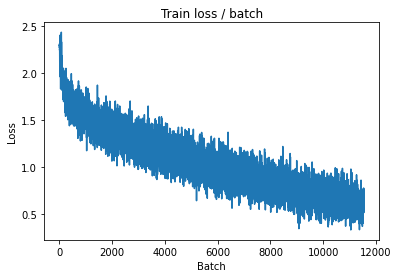


===============> Total time 20s	Avg loss 0.5976	Avg Prec@1 79.55 %	Avg Prec@5 98.67 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.6056 (0.6056)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7961	Avg Prec@1 75.73 %	Avg Prec@5 97.86 %



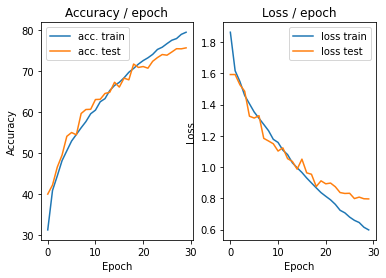

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.7001 (0.7001)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)


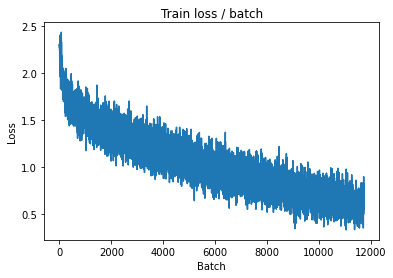

[TRAIN Batch 200/391]	Time 0.072s (0.055s)	Loss 0.5233 (0.5597)	Prec@1  78.9 ( 80.8)	Prec@5  98.4 ( 98.8)


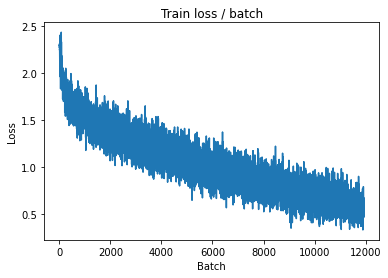


===============> Total time 20s	Avg loss 0.5710	Avg Prec@1 80.42 %	Avg Prec@5 98.80 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.7037 (0.7037)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7716	Avg Prec@1 75.92 %	Avg Prec@5 97.83 %



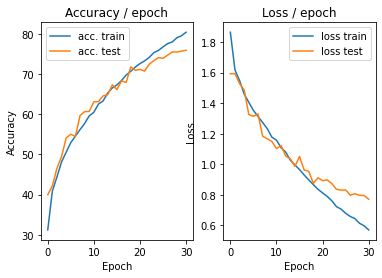

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.4352 (0.4352)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


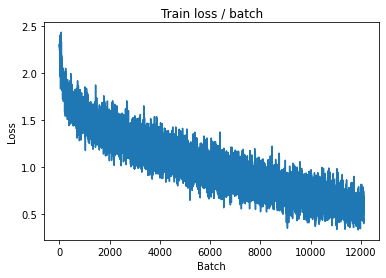

[TRAIN Batch 200/391]	Time 0.058s (0.054s)	Loss 0.5795 (0.5466)	Prec@1  79.7 ( 81.1)	Prec@5  98.4 ( 99.0)


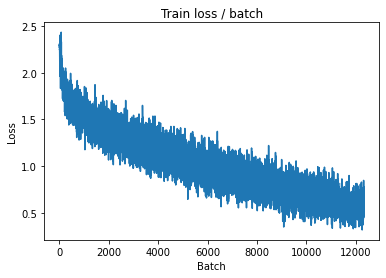


===============> Total time 20s	Avg loss 0.5534	Avg Prec@1 80.88 %	Avg Prec@5 98.85 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.5591 (0.5591)	Prec@1  84.4 ( 84.4)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7642	Avg Prec@1 76.84 %	Avg Prec@5 97.78 %



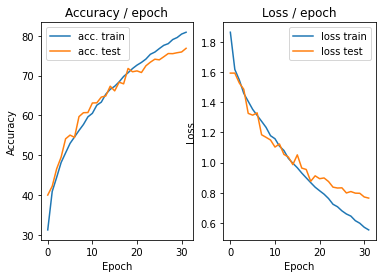

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.4429 (0.4429)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)


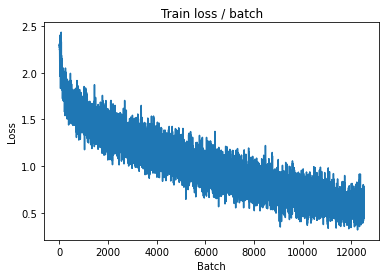

[TRAIN Batch 200/391]	Time 0.030s (0.054s)	Loss 0.5652 (0.5379)	Prec@1  84.4 ( 81.6)	Prec@5  98.4 ( 99.0)


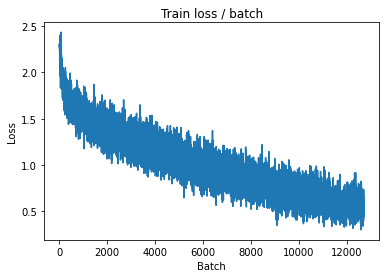


===============> Total time 20s	Avg loss 0.5434	Avg Prec@1 81.36 %	Avg Prec@5 98.96 %

[EVAL Batch 000/079]	Time 0.202s (0.202s)	Loss 0.6783 (0.6783)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7812	Avg Prec@1 76.18 %	Avg Prec@5 97.98 %



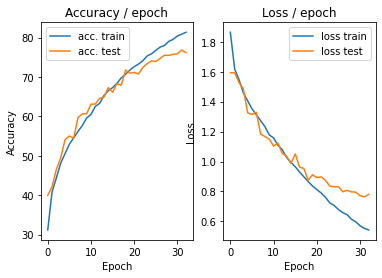

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.4553 (0.4553)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


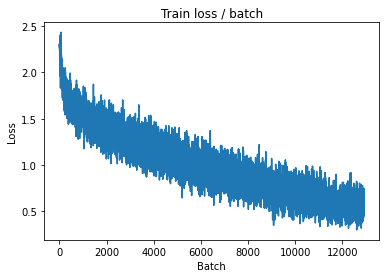

[TRAIN Batch 200/391]	Time 0.068s (0.054s)	Loss 0.5536 (0.5142)	Prec@1  82.0 ( 82.3)	Prec@5  99.2 ( 99.1)


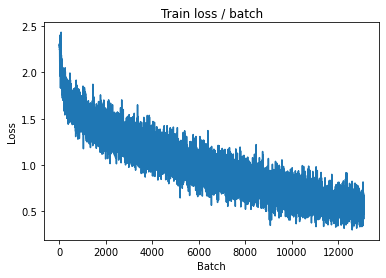


===============> Total time 20s	Avg loss 0.5134	Avg Prec@1 82.32 %	Avg Prec@5 99.09 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.6695 (0.6695)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7619	Avg Prec@1 76.74 %	Avg Prec@5 97.97 %



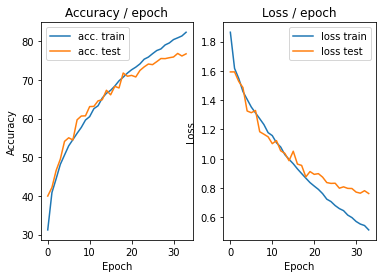

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.4543 (0.4543)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


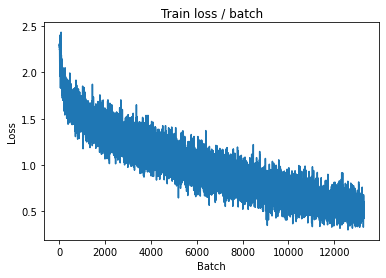

[TRAIN Batch 200/391]	Time 0.020s (0.054s)	Loss 0.5394 (0.4997)	Prec@1  81.2 ( 82.9)	Prec@5 100.0 ( 99.1)


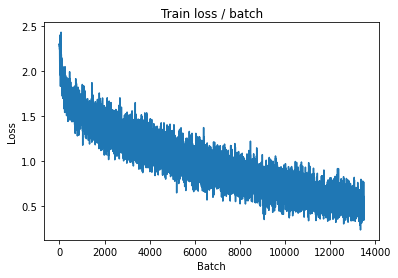


===============> Total time 20s	Avg loss 0.4962	Avg Prec@1 82.98 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.6614 (0.6614)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7954	Avg Prec@1 76.24 %	Avg Prec@5 98.04 %



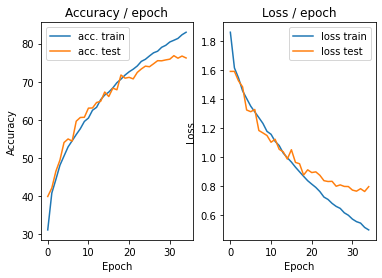

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 0.5700 (0.5700)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)


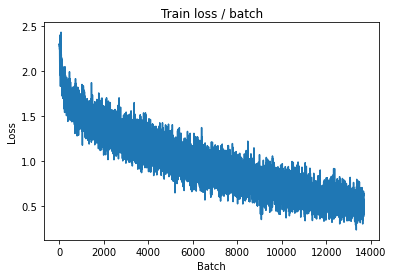

[TRAIN Batch 200/391]	Time 0.091s (0.054s)	Loss 0.4659 (0.4732)	Prec@1  82.0 ( 83.7)	Prec@5 100.0 ( 99.1)


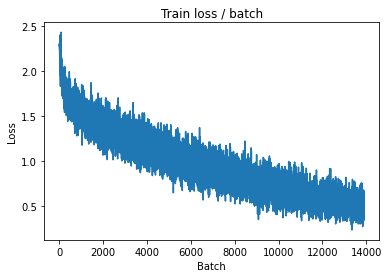


===============> Total time 20s	Avg loss 0.4824	Avg Prec@1 83.25 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.6834 (0.6834)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7719	Avg Prec@1 77.91 %	Avg Prec@5 98.02 %



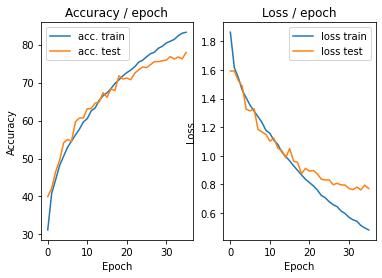

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 0.5251 (0.5251)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


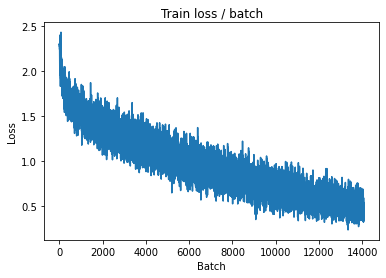

[TRAIN Batch 200/391]	Time 0.091s (0.054s)	Loss 0.6059 (0.4592)	Prec@1  78.9 ( 83.9)	Prec@5 100.0 ( 99.2)


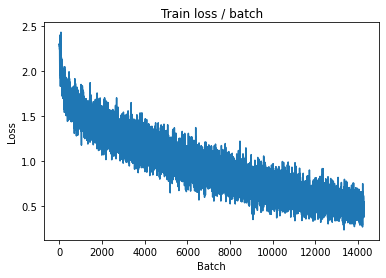


===============> Total time 20s	Avg loss 0.4640	Avg Prec@1 83.77 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 0.5999 (0.5999)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7721	Avg Prec@1 77.21 %	Avg Prec@5 98.12 %



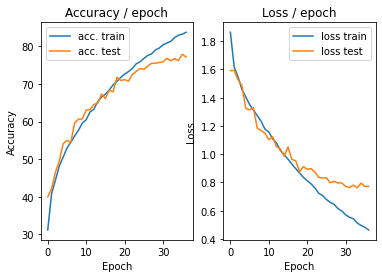

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 0.3612 (0.3612)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


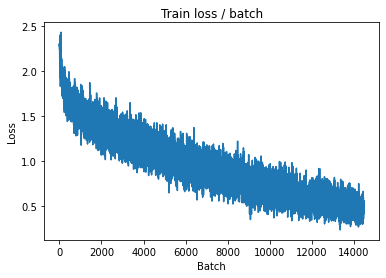

[TRAIN Batch 200/391]	Time 0.094s (0.053s)	Loss 0.3541 (0.4320)	Prec@1  87.5 ( 84.9)	Prec@5 100.0 ( 99.4)


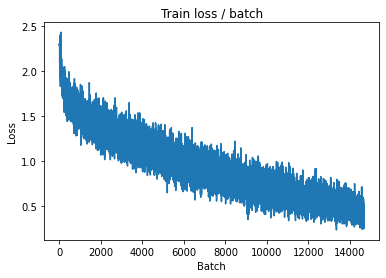


===============> Total time 20s	Avg loss 0.4482	Avg Prec@1 84.51 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.6473 (0.6473)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7756	Avg Prec@1 77.63 %	Avg Prec@5 98.05 %



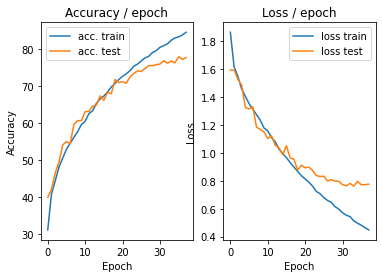

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.5190 (0.5190)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


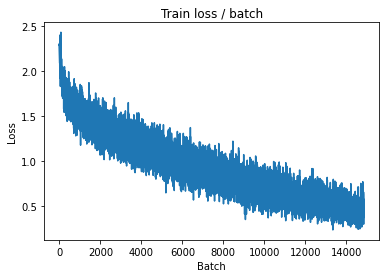

[TRAIN Batch 200/391]	Time 0.106s (0.055s)	Loss 0.4830 (0.4355)	Prec@1  79.7 ( 84.9)	Prec@5 100.0 ( 99.4)


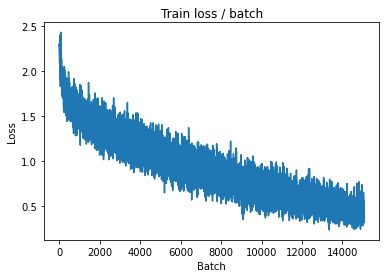


===============> Total time 21s	Avg loss 0.4378	Avg Prec@1 84.80 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.7594 (0.7594)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7633	Avg Prec@1 77.82 %	Avg Prec@5 98.11 %



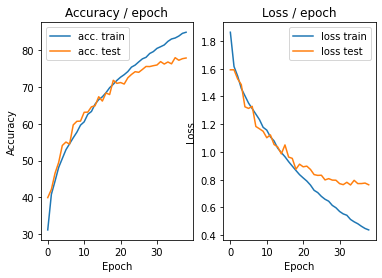

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 0.4565 (0.4565)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


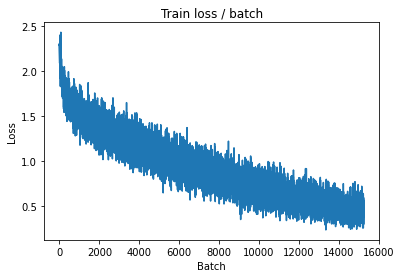

[TRAIN Batch 200/391]	Time 0.079s (0.053s)	Loss 0.3584 (0.4108)	Prec@1  89.1 ( 85.6)	Prec@5  99.2 ( 99.3)


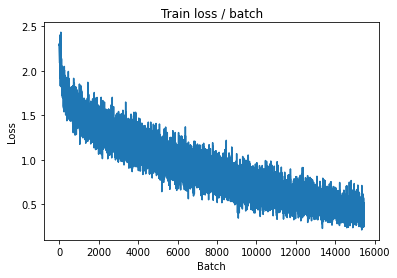


===============> Total time 20s	Avg loss 0.4148	Avg Prec@1 85.62 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.7453 (0.7453)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7870	Avg Prec@1 77.70 %	Avg Prec@5 98.06 %



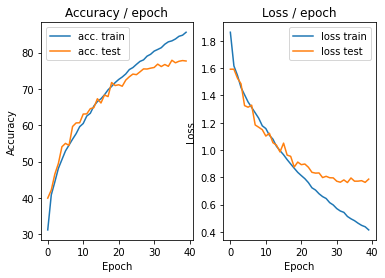

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 0.4800 (0.4800)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)


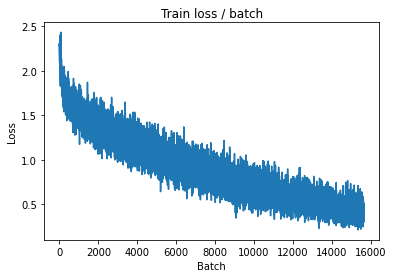

[TRAIN Batch 200/391]	Time 0.019s (0.054s)	Loss 0.3818 (0.3957)	Prec@1  85.9 ( 86.3)	Prec@5  99.2 ( 99.5)


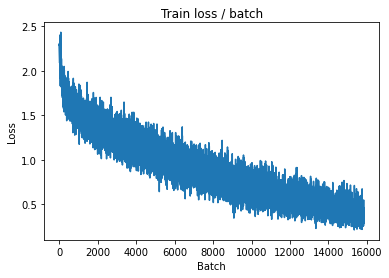


===============> Total time 20s	Avg loss 0.4008	Avg Prec@1 86.13 %	Avg Prec@5 99.41 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.7417 (0.7417)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7908	Avg Prec@1 77.84 %	Avg Prec@5 98.09 %



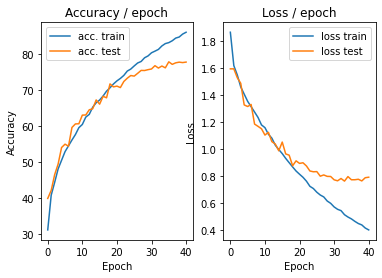

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.3696 (0.3696)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


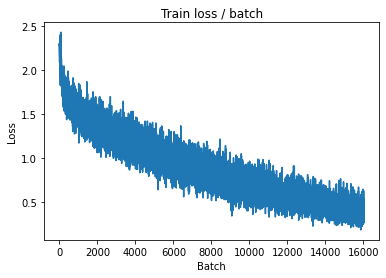

[TRAIN Batch 200/391]	Time 0.020s (0.053s)	Loss 0.4337 (0.3914)	Prec@1  86.7 ( 86.5)	Prec@5 100.0 ( 99.5)


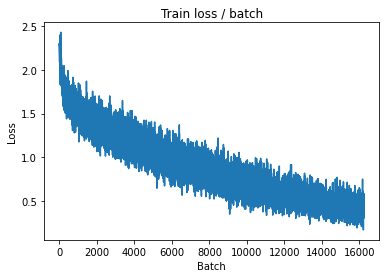


===============> Total time 20s	Avg loss 0.3924	Avg Prec@1 86.44 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.7381 (0.7381)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7755	Avg Prec@1 78.10 %	Avg Prec@5 98.16 %



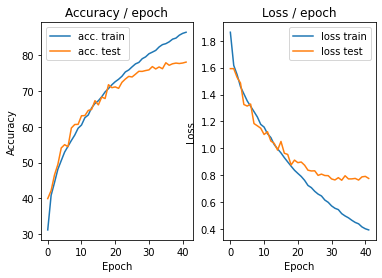

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.4216 (0.4216)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


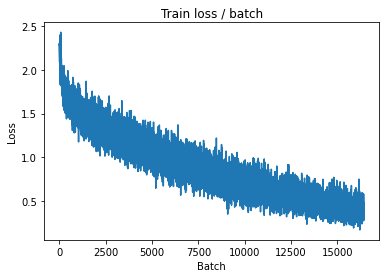

[TRAIN Batch 200/391]	Time 0.057s (0.053s)	Loss 0.4025 (0.3606)	Prec@1  85.9 ( 87.7)	Prec@5  99.2 ( 99.5)


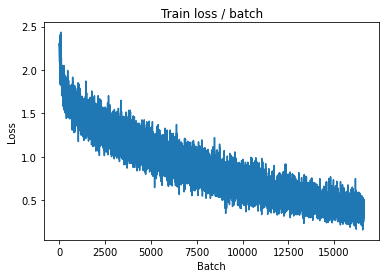


===============> Total time 20s	Avg loss 0.3693	Avg Prec@1 87.26 %	Avg Prec@5 99.52 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 0.6190 (0.6190)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7773	Avg Prec@1 77.95 %	Avg Prec@5 98.28 %



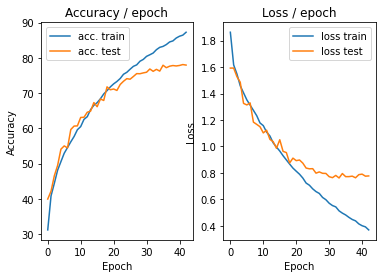

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.4364 (0.4364)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


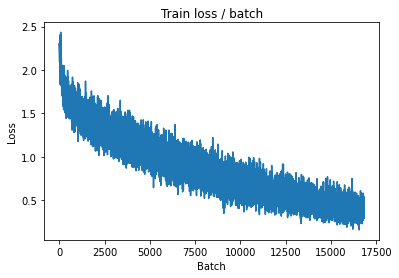

[TRAIN Batch 200/391]	Time 0.048s (0.053s)	Loss 0.2833 (0.3494)	Prec@1  89.1 ( 87.7)	Prec@5 100.0 ( 99.6)


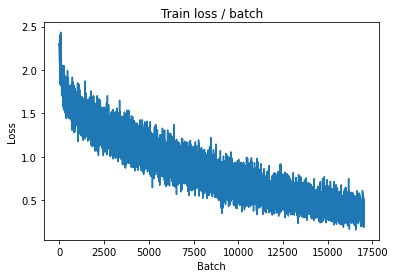


===============> Total time 20s	Avg loss 0.3581	Avg Prec@1 87.43 %	Avg Prec@5 99.54 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.6853 (0.6853)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7837	Avg Prec@1 78.58 %	Avg Prec@5 98.17 %



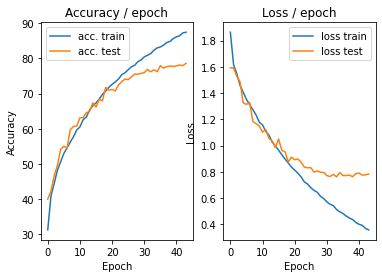

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.2495 (0.2495)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


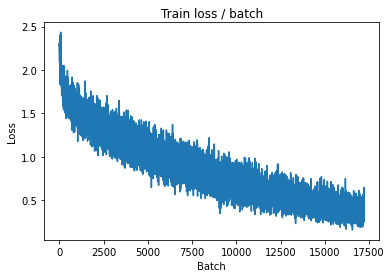

[TRAIN Batch 200/391]	Time 0.079s (0.054s)	Loss 0.3238 (0.3443)	Prec@1  90.6 ( 88.1)	Prec@5  99.2 ( 99.5)


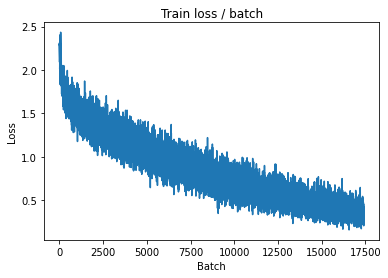


===============> Total time 20s	Avg loss 0.3477	Avg Prec@1 87.96 %	Avg Prec@5 99.54 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.7328 (0.7328)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7815	Avg Prec@1 78.82 %	Avg Prec@5 98.17 %



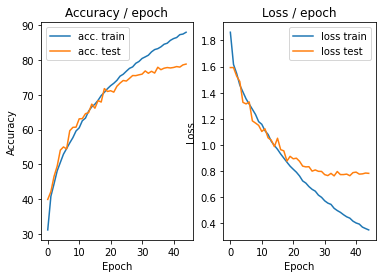

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.3599 (0.3599)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


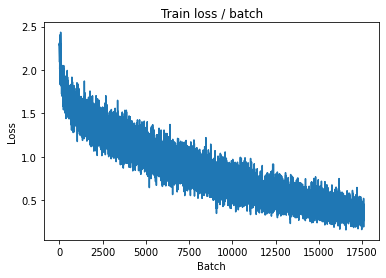

[TRAIN Batch 200/391]	Time 0.071s (0.055s)	Loss 0.3037 (0.3301)	Prec@1  87.5 ( 88.6)	Prec@5 100.0 ( 99.6)


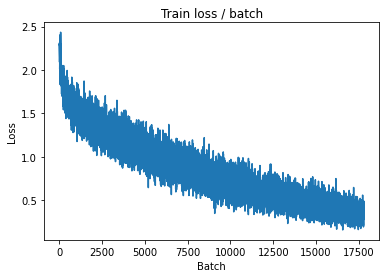


===============> Total time 20s	Avg loss 0.3308	Avg Prec@1 88.59 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 0.7866 (0.7866)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7915	Avg Prec@1 78.78 %	Avg Prec@5 98.34 %



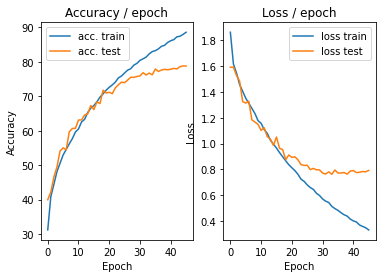

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.249s (0.249s)	Loss 0.3882 (0.3882)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


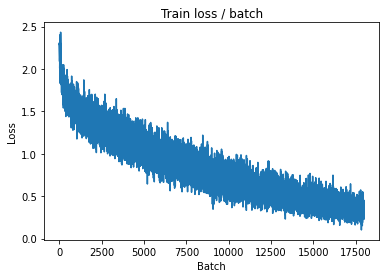

[TRAIN Batch 200/391]	Time 0.019s (0.053s)	Loss 0.2630 (0.3175)	Prec@1  92.2 ( 88.8)	Prec@5 100.0 ( 99.6)


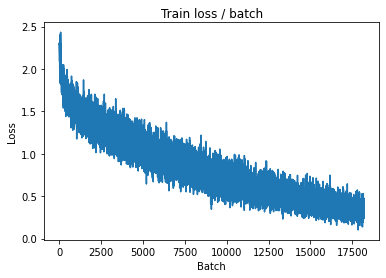


===============> Total time 20s	Avg loss 0.3258	Avg Prec@1 88.48 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 0.7058 (0.7058)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7765	Avg Prec@1 78.81 %	Avg Prec@5 98.24 %



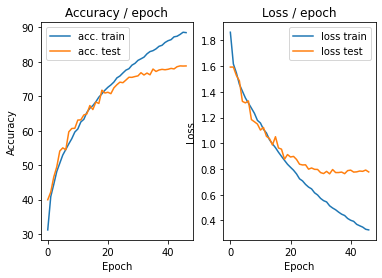

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 0.3625 (0.3625)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)


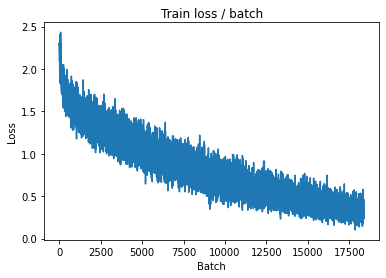

[TRAIN Batch 200/391]	Time 0.039s (0.053s)	Loss 0.4289 (0.3124)	Prec@1  85.9 ( 89.1)	Prec@5 100.0 ( 99.7)


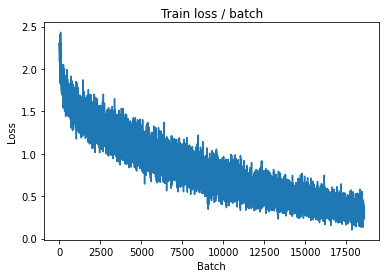


===============> Total time 20s	Avg loss 0.3095	Avg Prec@1 89.35 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.7991 (0.7991)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7962	Avg Prec@1 79.02 %	Avg Prec@5 98.25 %



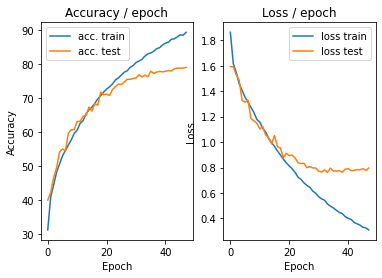

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 0.2879 (0.2879)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


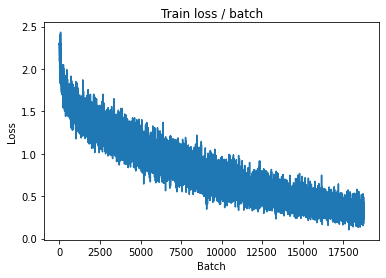

[TRAIN Batch 200/391]	Time 0.030s (0.053s)	Loss 0.2044 (0.2961)	Prec@1  91.4 ( 89.6)	Prec@5 100.0 ( 99.7)


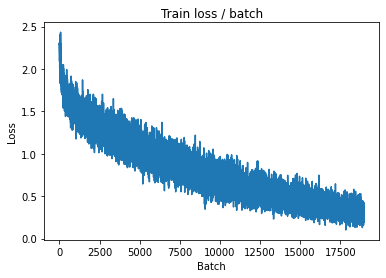


===============> Total time 20s	Avg loss 0.3033	Avg Prec@1 89.35 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 0.6974 (0.6974)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7950	Avg Prec@1 79.01 %	Avg Prec@5 98.25 %



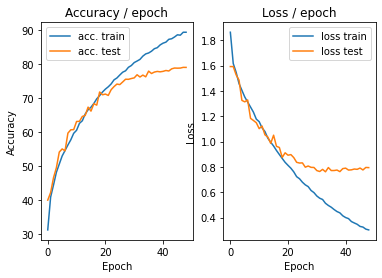

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 0.2000 (0.2000)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


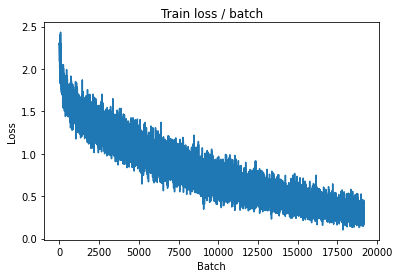

[TRAIN Batch 200/391]	Time 0.019s (0.053s)	Loss 0.3656 (0.2923)	Prec@1  87.5 ( 89.8)	Prec@5 100.0 ( 99.8)


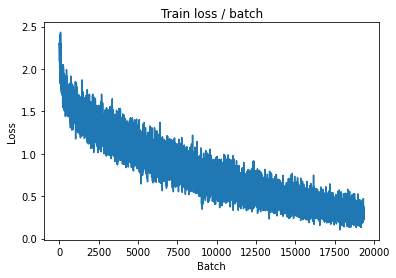


===============> Total time 20s	Avg loss 0.2921	Avg Prec@1 89.83 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.7321 (0.7321)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7999	Avg Prec@1 79.24 %	Avg Prec@5 98.31 %



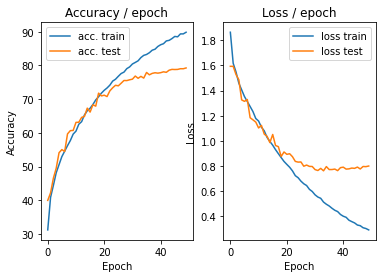

In [ ]:
main(128, 0.1,epochs=50, cuda=True)

##Adam opt

In [ ]:

def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr,amsgrad=True)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 2.3023 (2.3023)	Prec@1  10.2 ( 10.2)	Prec@5  46.1 ( 46.1)


<Figure size 432x288 with 0 Axes>

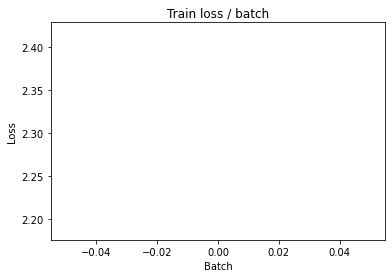

[TRAIN Batch 200/391]	Time 0.068s (0.054s)	Loss 1.3707 (1.6548)	Prec@1  50.0 ( 38.7)	Prec@5  93.0 ( 87.9)


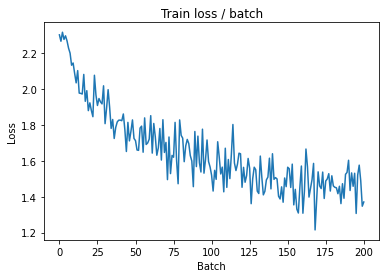


===============> Total time 20s	Avg loss 1.4824	Avg Prec@1 45.88 %	Avg Prec@5 90.94 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 1.1096 (1.1096)	Prec@1  64.8 ( 64.8)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.1721	Avg Prec@1 57.06 %	Avg Prec@5 95.93 %



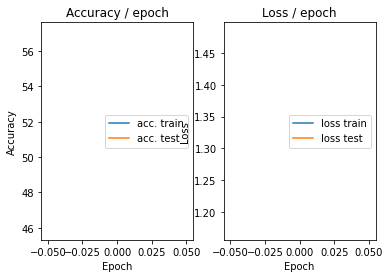

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 1.2179 (1.2179)	Prec@1  57.0 ( 57.0)	Prec@5  95.3 ( 95.3)


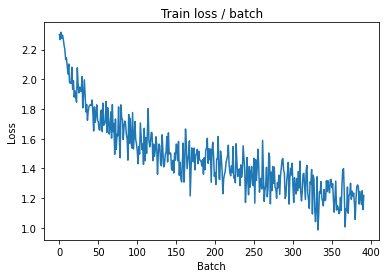

[TRAIN Batch 200/391]	Time 0.016s (0.053s)	Loss 0.9818 (1.1216)	Prec@1  62.5 ( 59.6)	Prec@5  98.4 ( 96.0)


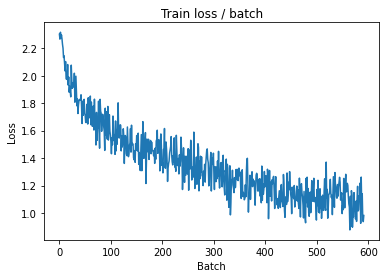


===============> Total time 20s	Avg loss 1.0791	Avg Prec@1 61.59 %	Avg Prec@5 96.20 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 0.9373 (0.9373)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9913	Avg Prec@1 65.29 %	Avg Prec@5 96.67 %



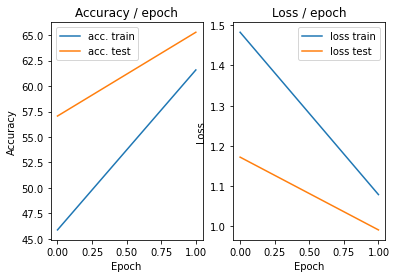

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.9435 (0.9435)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)


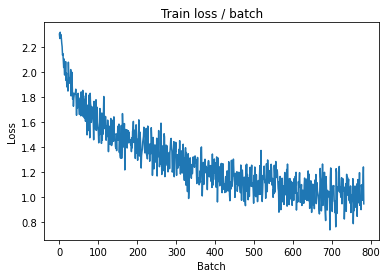

[TRAIN Batch 200/391]	Time 0.025s (0.053s)	Loss 0.8010 (0.9397)	Prec@1  71.9 ( 66.6)	Prec@5  98.4 ( 97.2)


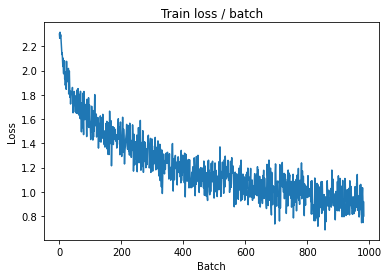


===============> Total time 20s	Avg loss 0.9155	Avg Prec@1 67.64 %	Avg Prec@5 97.25 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.8375 (0.8375)	Prec@1  75.0 ( 75.0)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 0.8904	Avg Prec@1 68.95 %	Avg Prec@5 97.34 %



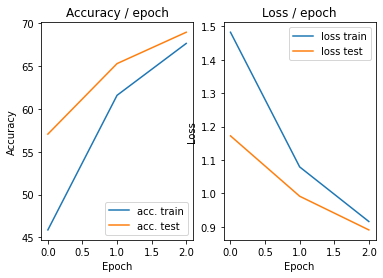

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.7933 (0.7933)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)


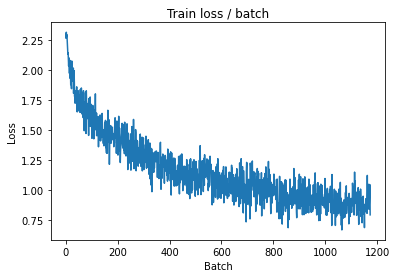

[TRAIN Batch 200/391]	Time 0.019s (0.054s)	Loss 0.8494 (0.8218)	Prec@1  71.9 ( 71.1)	Prec@5  96.9 ( 97.9)


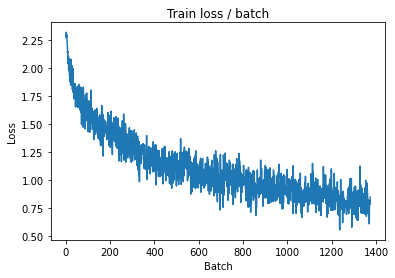


===============> Total time 21s	Avg loss 0.8181	Avg Prec@1 71.25 %	Avg Prec@5 97.96 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.7122 (0.7122)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7846	Avg Prec@1 72.77 %	Avg Prec@5 97.88 %



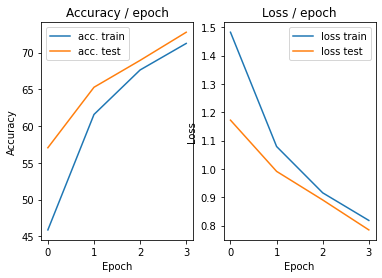

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 0.8297 (0.8297)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)


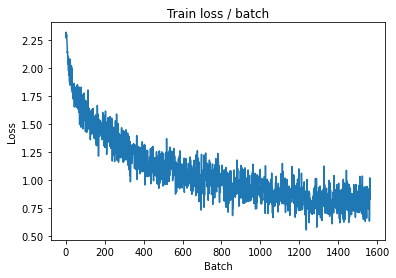

[TRAIN Batch 200/391]	Time 0.094s (0.055s)	Loss 0.5563 (0.7549)	Prec@1  81.2 ( 73.3)	Prec@5  97.7 ( 98.2)


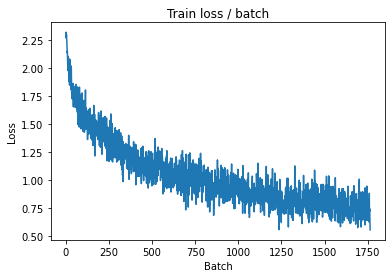


===============> Total time 21s	Avg loss 0.7498	Avg Prec@1 73.52 %	Avg Prec@5 98.24 %

[EVAL Batch 000/079]	Time 0.202s (0.202s)	Loss 0.6802 (0.6802)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7499	Avg Prec@1 74.08 %	Avg Prec@5 98.03 %



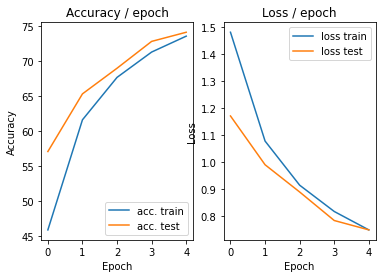

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.7093 (0.7093)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)


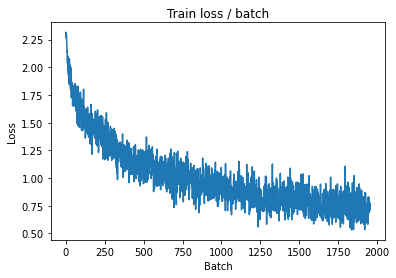

[TRAIN Batch 200/391]	Time 0.080s (0.055s)	Loss 0.7239 (0.7016)	Prec@1  75.8 ( 75.5)	Prec@5 100.0 ( 98.5)


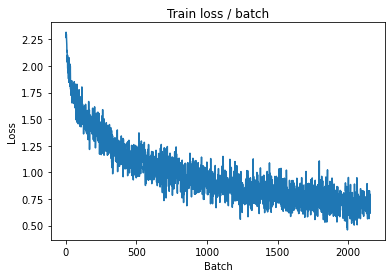


===============> Total time 21s	Avg loss 0.7013	Avg Prec@1 75.34 %	Avg Prec@5 98.38 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.7235 (0.7235)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7524	Avg Prec@1 74.03 %	Avg Prec@5 98.07 %



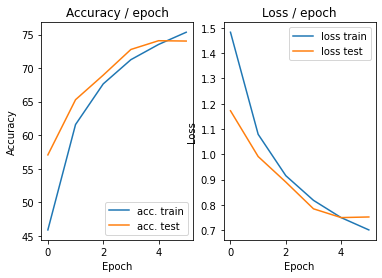

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 0.6690 (0.6690)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)


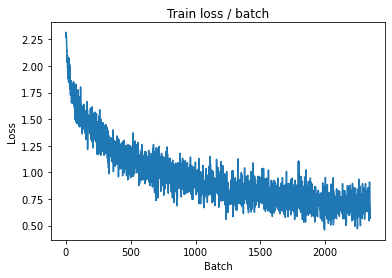

[TRAIN Batch 200/391]	Time 0.029s (0.055s)	Loss 0.6453 (0.6539)	Prec@1  78.9 ( 77.3)	Prec@5  97.7 ( 98.7)


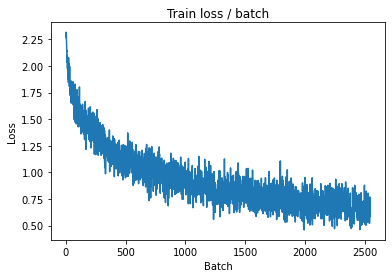


===============> Total time 21s	Avg loss 0.6527	Avg Prec@1 77.09 %	Avg Prec@5 98.71 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.6945 (0.6945)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6906	Avg Prec@1 76.12 %	Avg Prec@5 98.44 %



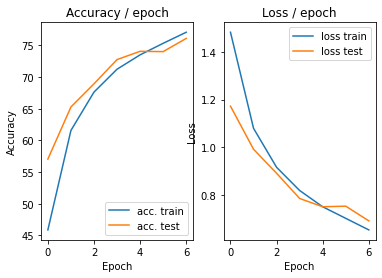

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.285s (0.285s)	Loss 0.5175 (0.5175)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)


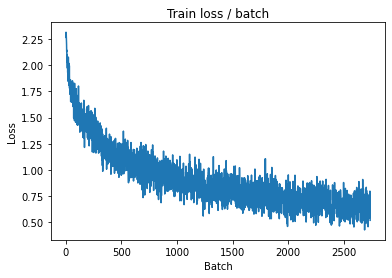

[TRAIN Batch 200/391]	Time 0.068s (0.056s)	Loss 0.5323 (0.6230)	Prec@1  80.5 ( 78.1)	Prec@5 100.0 ( 98.8)


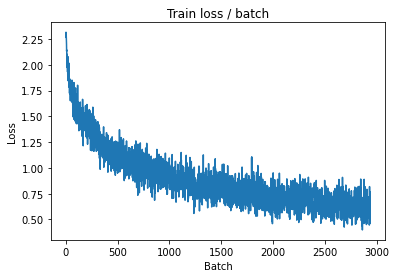


===============> Total time 21s	Avg loss 0.6204	Avg Prec@1 78.30 %	Avg Prec@5 98.80 %

[EVAL Batch 000/079]	Time 0.206s (0.206s)	Loss 0.6735 (0.6735)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6843	Avg Prec@1 76.71 %	Avg Prec@5 98.61 %



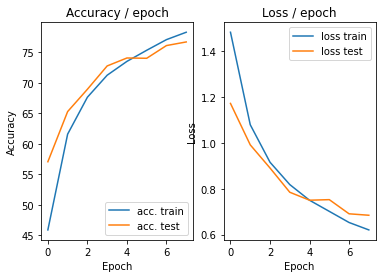

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.5970 (0.5970)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)


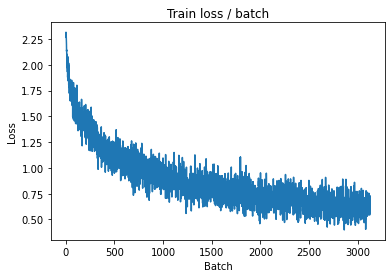

[TRAIN Batch 200/391]	Time 0.031s (0.055s)	Loss 0.6992 (0.5716)	Prec@1  72.7 ( 79.9)	Prec@5  97.7 ( 99.1)


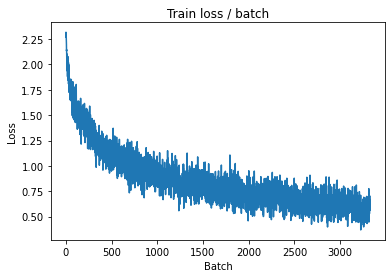


===============> Total time 21s	Avg loss 0.5758	Avg Prec@1 79.75 %	Avg Prec@5 99.02 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.7025 (0.7025)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6530	Avg Prec@1 77.59 %	Avg Prec@5 98.66 %



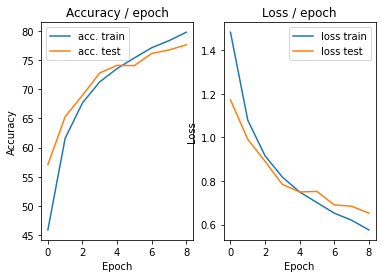

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.243s (0.243s)	Loss 0.4552 (0.4552)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


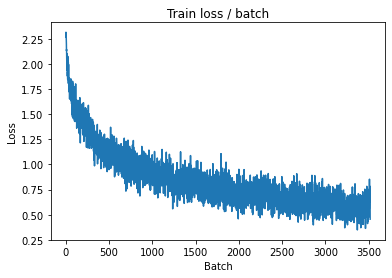

[TRAIN Batch 200/391]	Time 0.066s (0.057s)	Loss 0.5907 (0.5454)	Prec@1  77.3 ( 80.8)	Prec@5  98.4 ( 99.1)


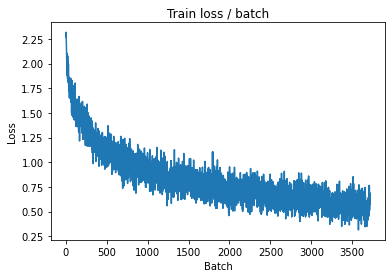


===============> Total time 21s	Avg loss 0.5559	Avg Prec@1 80.54 %	Avg Prec@5 99.07 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.6379 (0.6379)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6432	Avg Prec@1 78.67 %	Avg Prec@5 98.76 %



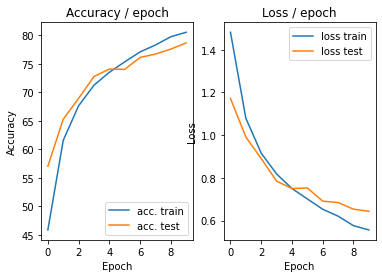

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.4637 (0.4637)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


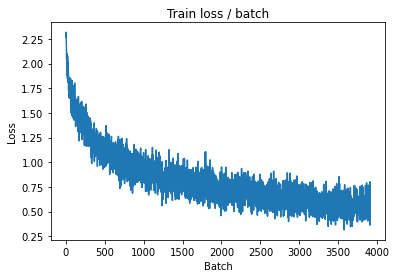

[TRAIN Batch 200/391]	Time 0.036s (0.055s)	Loss 0.7030 (0.5236)	Prec@1  78.1 ( 81.7)	Prec@5  98.4 ( 99.2)


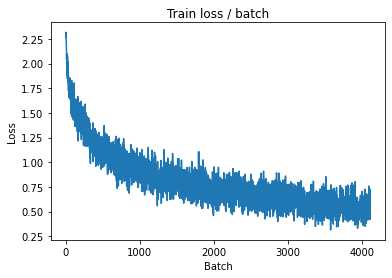


===============> Total time 21s	Avg loss 0.5297	Avg Prec@1 81.62 %	Avg Prec@5 99.17 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.7697 (0.7697)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6592	Avg Prec@1 77.88 %	Avg Prec@5 98.50 %



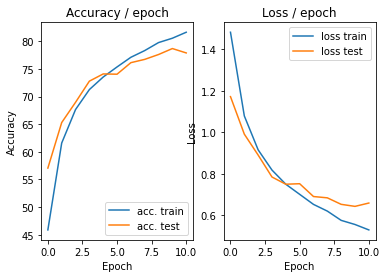

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.5411 (0.5411)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


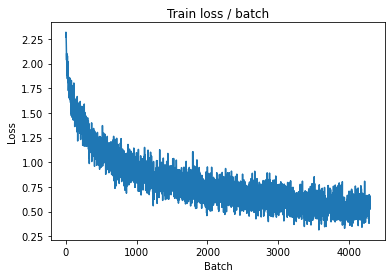

[TRAIN Batch 200/391]	Time 0.030s (0.055s)	Loss 0.6004 (0.4979)	Prec@1  82.0 ( 82.8)	Prec@5  99.2 ( 99.2)


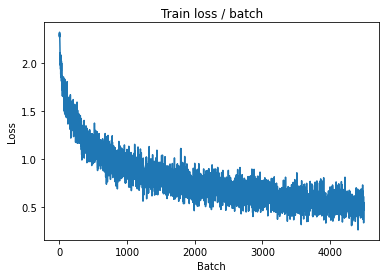


===============> Total time 21s	Avg loss 0.4994	Avg Prec@1 82.55 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.7430 (0.7430)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6869	Avg Prec@1 77.20 %	Avg Prec@5 98.46 %



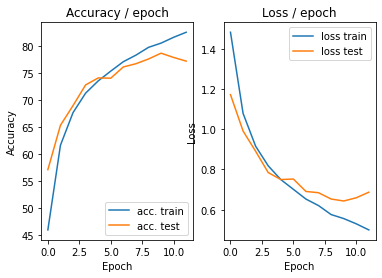

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 0.5978 (0.5978)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)


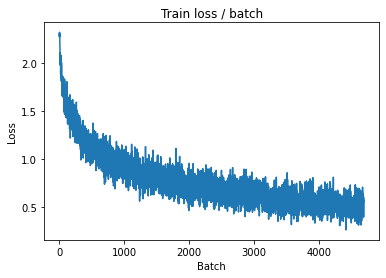

[TRAIN Batch 200/391]	Time 0.060s (0.055s)	Loss 0.5115 (0.4799)	Prec@1  82.8 ( 83.0)	Prec@5  98.4 ( 99.3)


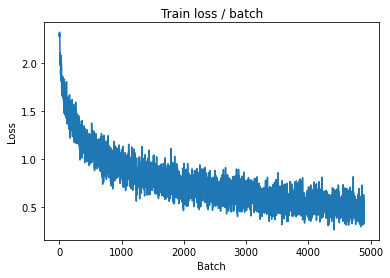


===============> Total time 21s	Avg loss 0.4841	Avg Prec@1 82.90 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 0.6348 (0.6348)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6533	Avg Prec@1 79.02 %	Avg Prec@5 98.47 %



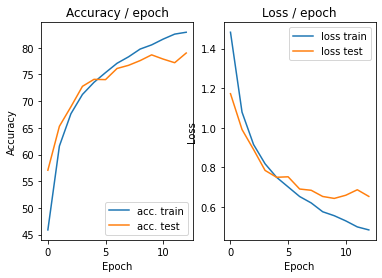

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.3604 (0.3604)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


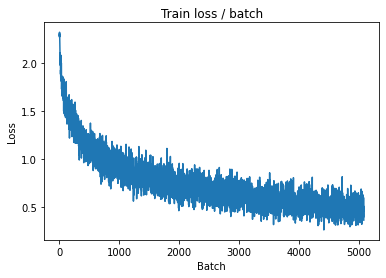

[TRAIN Batch 200/391]	Time 0.087s (0.057s)	Loss 0.4572 (0.4488)	Prec@1  84.4 ( 84.1)	Prec@5  99.2 ( 99.4)


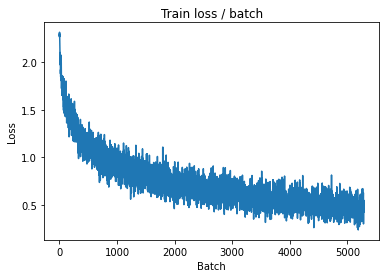


===============> Total time 21s	Avg loss 0.4564	Avg Prec@1 83.84 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.5335 (0.5335)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6420	Avg Prec@1 79.18 %	Avg Prec@5 98.79 %



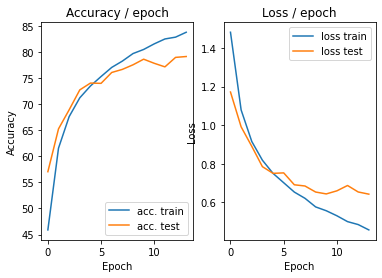

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.4602 (0.4602)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


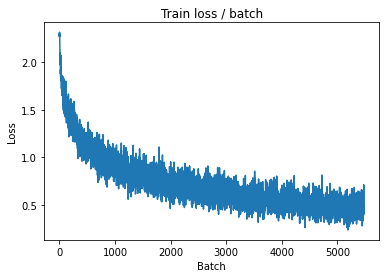

[TRAIN Batch 200/391]	Time 0.025s (0.055s)	Loss 0.3360 (0.4338)	Prec@1  88.3 ( 84.7)	Prec@5  99.2 ( 99.4)


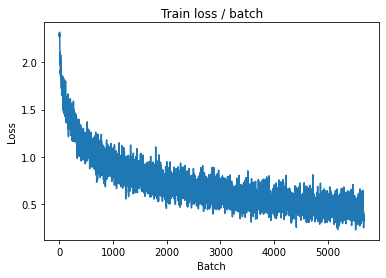


===============> Total time 21s	Avg loss 0.4413	Avg Prec@1 84.44 %	Avg Prec@5 99.46 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 0.5942 (0.5942)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6620	Avg Prec@1 78.74 %	Avg Prec@5 98.71 %



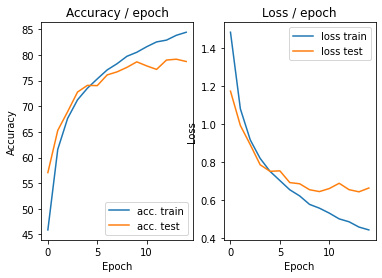

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.5465 (0.5465)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)


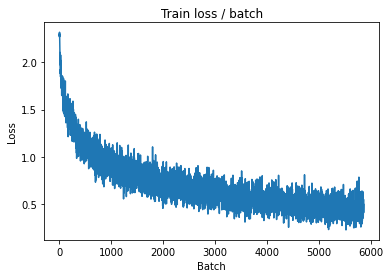

[TRAIN Batch 200/391]	Time 0.027s (0.055s)	Loss 0.5020 (0.4167)	Prec@1  80.5 ( 85.1)	Prec@5  99.2 ( 99.5)


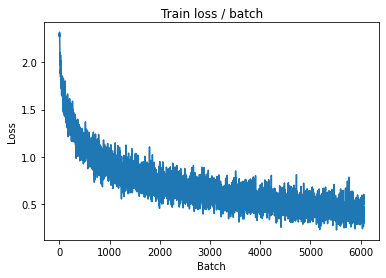


===============> Total time 21s	Avg loss 0.4259	Avg Prec@1 84.86 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.5956 (0.5956)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6483	Avg Prec@1 78.64 %	Avg Prec@5 98.48 %



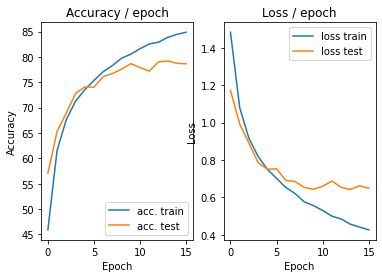

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 0.4043 (0.4043)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


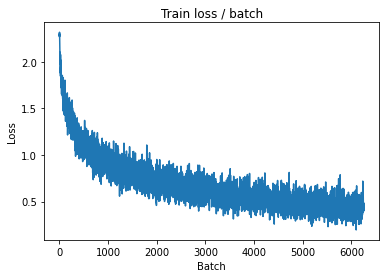

[TRAIN Batch 200/391]	Time 0.087s (0.056s)	Loss 0.4134 (0.4022)	Prec@1  85.9 ( 86.0)	Prec@5  99.2 ( 99.6)


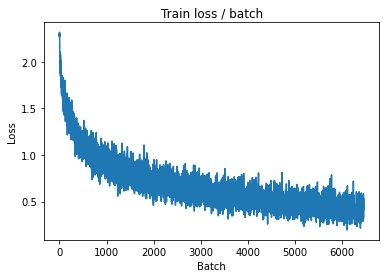


===============> Total time 21s	Avg loss 0.4103	Avg Prec@1 85.52 %	Avg Prec@5 99.61 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.6713 (0.6713)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6497	Avg Prec@1 79.19 %	Avg Prec@5 98.62 %



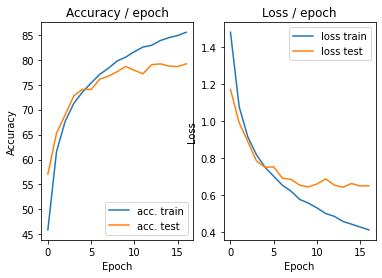

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.253s (0.253s)	Loss 0.4417 (0.4417)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)


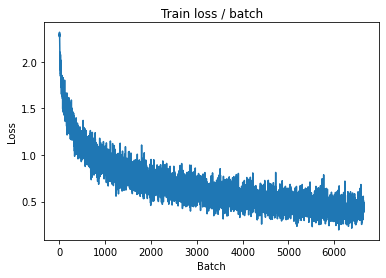

[TRAIN Batch 200/391]	Time 0.104s (0.057s)	Loss 0.3977 (0.3897)	Prec@1  86.7 ( 86.3)	Prec@5 100.0 ( 99.6)


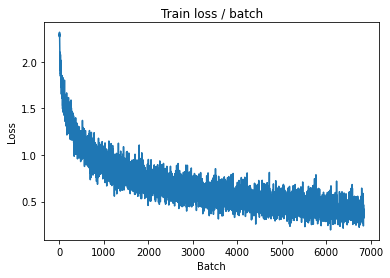


===============> Total time 21s	Avg loss 0.3921	Avg Prec@1 86.31 %	Avg Prec@5 99.60 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.6998 (0.6998)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6598	Avg Prec@1 79.54 %	Avg Prec@5 98.78 %



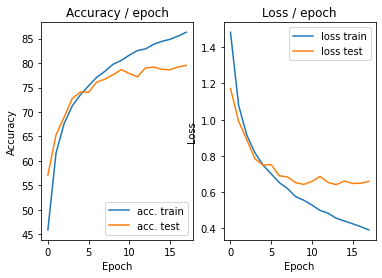

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 0.3901 (0.3901)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


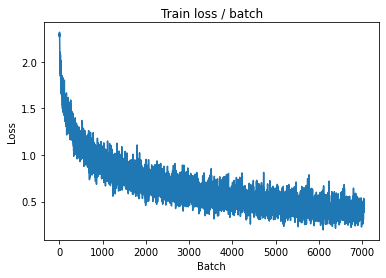

[TRAIN Batch 200/391]	Time 0.094s (0.056s)	Loss 0.4177 (0.3705)	Prec@1  83.6 ( 86.9)	Prec@5 100.0 ( 99.7)


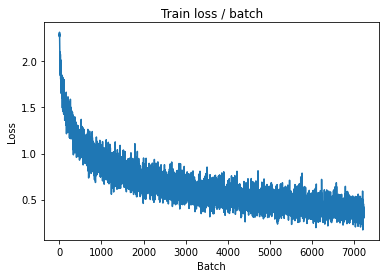


===============> Total time 21s	Avg loss 0.3765	Avg Prec@1 86.64 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.7031 (0.7031)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6601	Avg Prec@1 79.75 %	Avg Prec@5 98.53 %



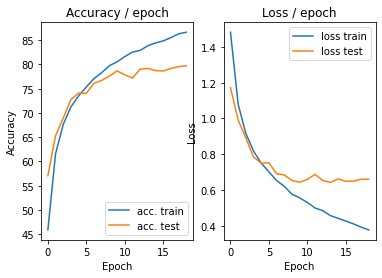

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.289s (0.289s)	Loss 0.3388 (0.3388)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


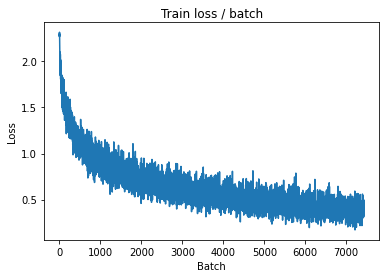

[TRAIN Batch 200/391]	Time 0.061s (0.056s)	Loss 0.4291 (0.3512)	Prec@1  85.9 ( 87.7)	Prec@5 100.0 ( 99.7)


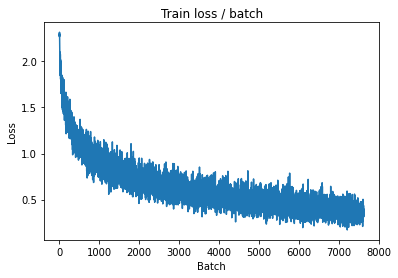


===============> Total time 21s	Avg loss 0.3650	Avg Prec@1 87.29 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 0.6021 (0.6021)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6738	Avg Prec@1 80.09 %	Avg Prec@5 98.61 %



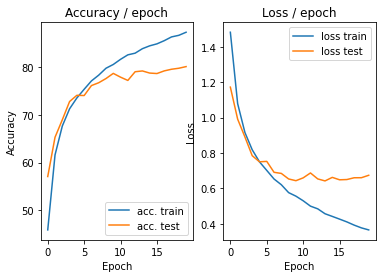

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.4358 (0.4358)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


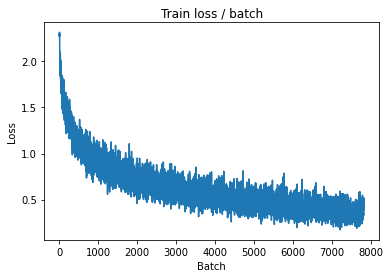

[TRAIN Batch 200/391]	Time 0.017s (0.056s)	Loss 0.5348 (0.3426)	Prec@1  80.5 ( 87.7)	Prec@5  99.2 ( 99.7)


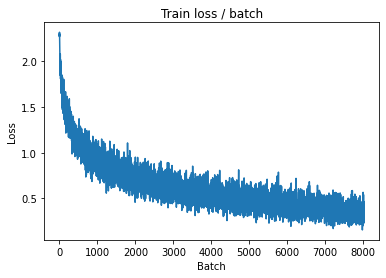


===============> Total time 21s	Avg loss 0.3508	Avg Prec@1 87.56 %	Avg Prec@5 99.71 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.6468 (0.6468)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6404	Avg Prec@1 80.06 %	Avg Prec@5 98.77 %



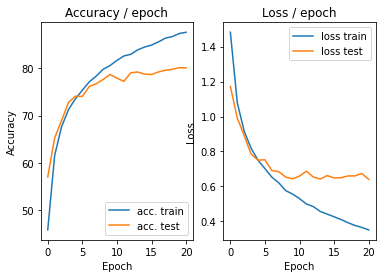

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.3635 (0.3635)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


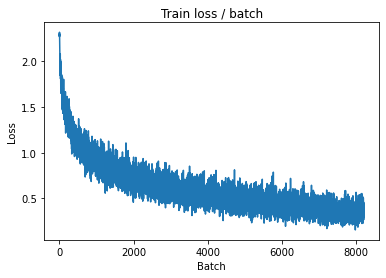

[TRAIN Batch 200/391]	Time 0.068s (0.057s)	Loss 0.3575 (0.3234)	Prec@1  86.7 ( 88.7)	Prec@5  99.2 ( 99.7)


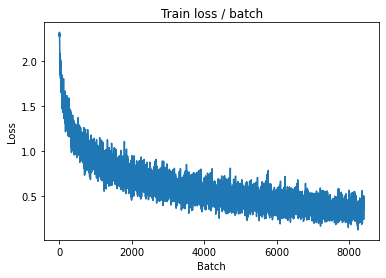


===============> Total time 21s	Avg loss 0.3371	Avg Prec@1 88.20 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.226s (0.226s)	Loss 0.5370 (0.5370)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6602	Avg Prec@1 80.42 %	Avg Prec@5 98.62 %



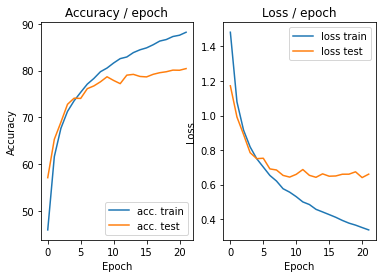

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.2317 (0.2317)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


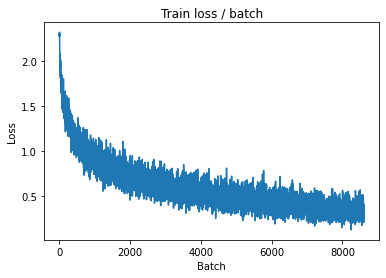

[TRAIN Batch 200/391]	Time 0.028s (0.055s)	Loss 0.2107 (0.3122)	Prec@1  93.8 ( 89.0)	Prec@5 100.0 ( 99.8)


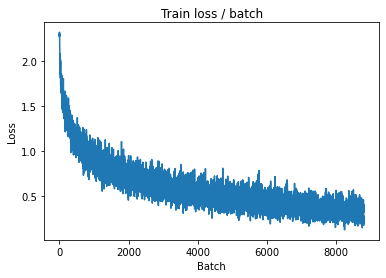


===============> Total time 21s	Avg loss 0.3243	Avg Prec@1 88.51 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.6219 (0.6219)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6796	Avg Prec@1 79.95 %	Avg Prec@5 98.49 %



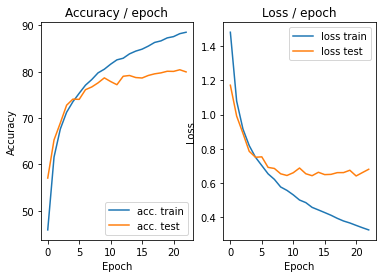

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.3547 (0.3547)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


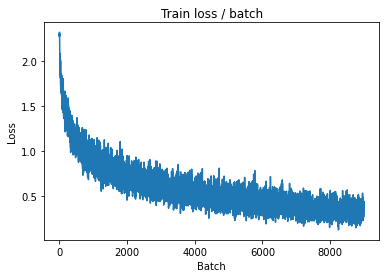

[TRAIN Batch 200/391]	Time 0.068s (0.055s)	Loss 0.3890 (0.3110)	Prec@1  84.4 ( 89.0)	Prec@5 100.0 ( 99.8)


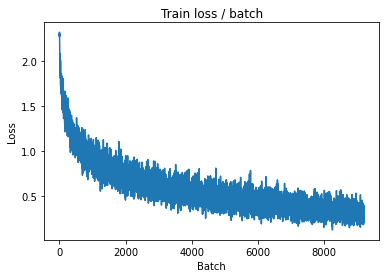


===============> Total time 21s	Avg loss 0.3233	Avg Prec@1 88.70 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.6244 (0.6244)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)

===============> Total time 3s	Avg loss 0.6662	Avg Prec@1 79.91 %	Avg Prec@5 98.73 %



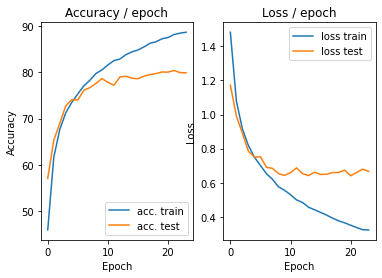

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.275s (0.275s)	Loss 0.3484 (0.3484)	Prec@1  88.3 ( 88.3)	Prec@5  97.7 ( 97.7)


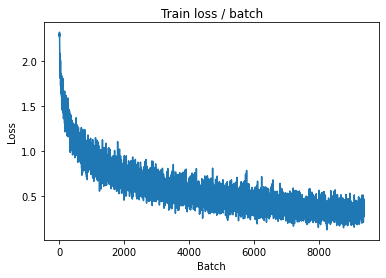

[TRAIN Batch 200/391]	Time 0.028s (0.055s)	Loss 0.1800 (0.2993)	Prec@1  96.1 ( 89.6)	Prec@5 100.0 ( 99.8)


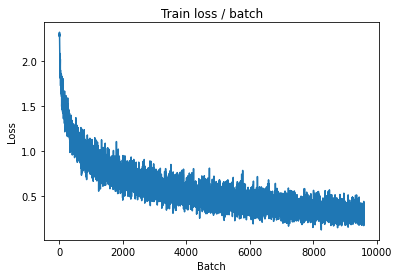


===============> Total time 21s	Avg loss 0.3093	Avg Prec@1 89.10 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.6084 (0.6084)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6855	Avg Prec@1 79.69 %	Avg Prec@5 98.49 %



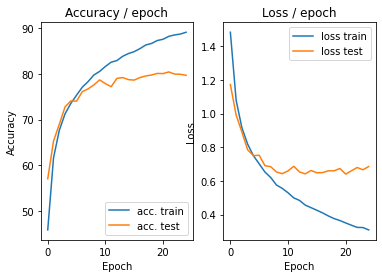

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.4332 (0.4332)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


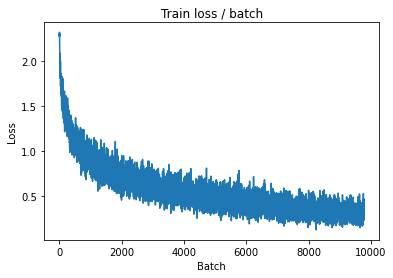

[TRAIN Batch 200/391]	Time 0.057s (0.057s)	Loss 0.2823 (0.2982)	Prec@1  88.3 ( 89.5)	Prec@5 100.0 ( 99.8)


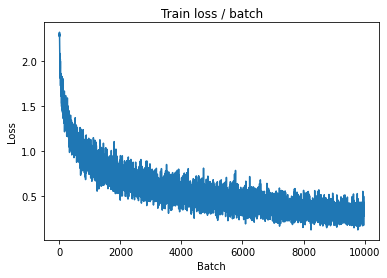


===============> Total time 21s	Avg loss 0.3043	Avg Prec@1 89.27 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.5922 (0.5922)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7203	Avg Prec@1 79.58 %	Avg Prec@5 98.65 %



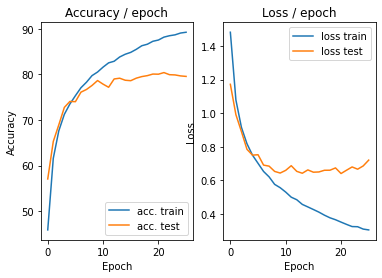

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.274s (0.274s)	Loss 0.3494 (0.3494)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


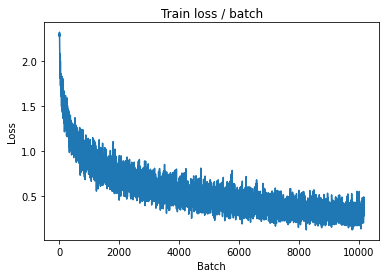

[TRAIN Batch 200/391]	Time 0.065s (0.055s)	Loss 0.2999 (0.2818)	Prec@1  86.7 ( 90.1)	Prec@5 100.0 ( 99.9)


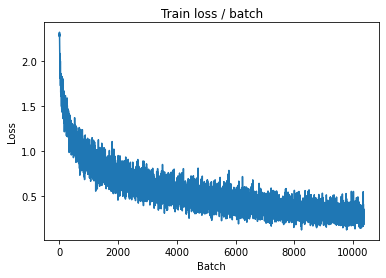


===============> Total time 21s	Avg loss 0.2942	Avg Prec@1 89.59 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.248s (0.248s)	Loss 0.5187 (0.5187)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7150	Avg Prec@1 79.63 %	Avg Prec@5 98.66 %



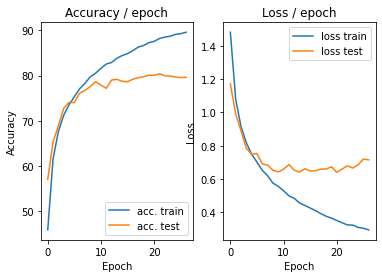

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.2456 (0.2456)	Prec@1  92.2 ( 92.2)	Prec@5  99.2 ( 99.2)


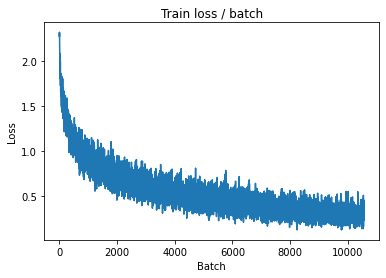

[TRAIN Batch 200/391]	Time 0.029s (0.056s)	Loss 0.2325 (0.2771)	Prec@1  93.0 ( 90.2)	Prec@5 100.0 ( 99.9)


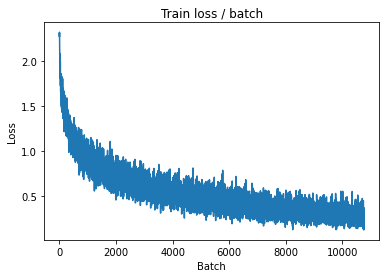


===============> Total time 21s	Avg loss 0.2837	Avg Prec@1 90.02 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.6572 (0.6572)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7297	Avg Prec@1 80.10 %	Avg Prec@5 98.60 %



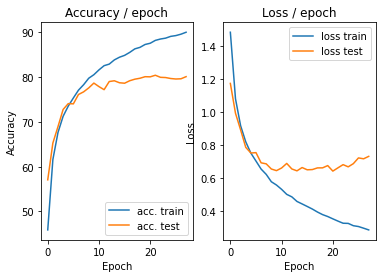

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.273s (0.273s)	Loss 0.2563 (0.2563)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


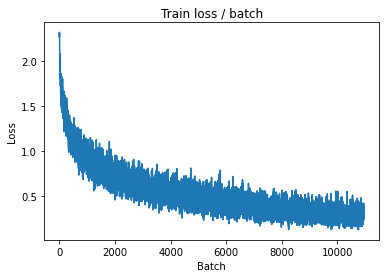

[TRAIN Batch 200/391]	Time 0.088s (0.056s)	Loss 0.2498 (0.2642)	Prec@1  90.6 ( 90.8)	Prec@5 100.0 ( 99.8)


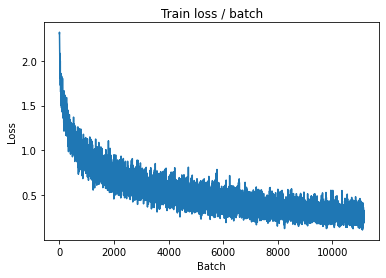


===============> Total time 21s	Avg loss 0.2751	Avg Prec@1 90.42 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.8048 (0.8048)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7251	Avg Prec@1 80.28 %	Avg Prec@5 98.55 %



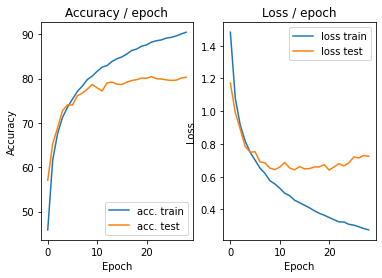

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.281s (0.281s)	Loss 0.2280 (0.2280)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


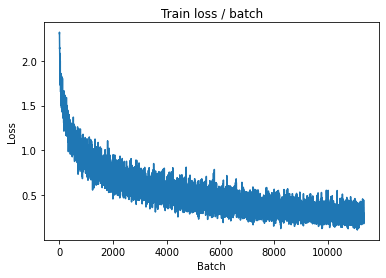

[TRAIN Batch 200/391]	Time 0.087s (0.057s)	Loss 0.2250 (0.2671)	Prec@1  93.0 ( 90.7)	Prec@5  99.2 ( 99.9)


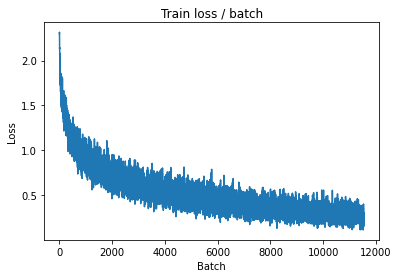


===============> Total time 21s	Avg loss 0.2683	Avg Prec@1 90.61 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.220s (0.220s)	Loss 0.8261 (0.8261)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7800	Avg Prec@1 79.74 %	Avg Prec@5 98.43 %



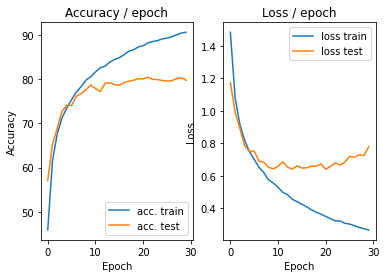

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.289s (0.289s)	Loss 0.2149 (0.2149)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


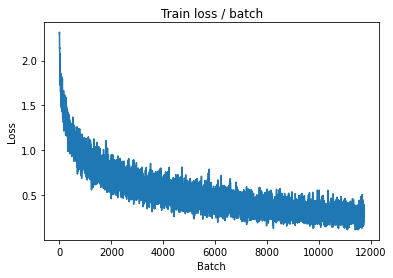

[TRAIN Batch 200/391]	Time 0.093s (0.056s)	Loss 0.2476 (0.2536)	Prec@1  90.6 ( 91.0)	Prec@5 100.0 ( 99.9)


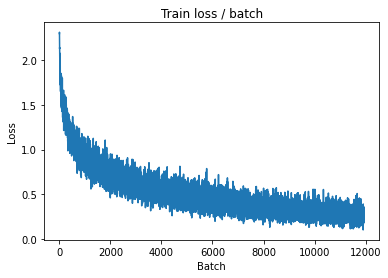


===============> Total time 21s	Avg loss 0.2653	Avg Prec@1 90.66 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 0.7149 (0.7149)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7151	Avg Prec@1 79.87 %	Avg Prec@5 98.57 %



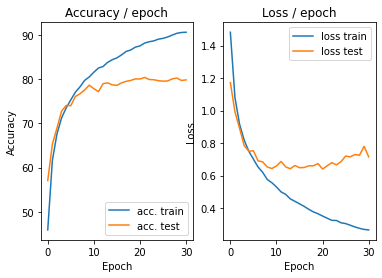

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.2758 (0.2758)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


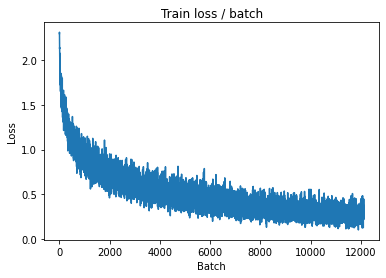

[TRAIN Batch 200/391]	Time 0.026s (0.057s)	Loss 0.2428 (0.2595)	Prec@1  92.2 ( 91.1)	Prec@5 100.0 ( 99.8)


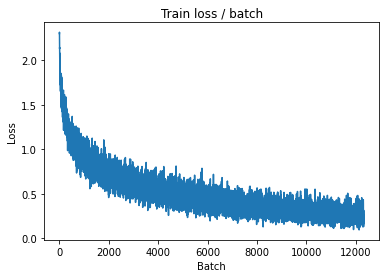


===============> Total time 21s	Avg loss 0.2681	Avg Prec@1 90.81 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.234s (0.234s)	Loss 0.6992 (0.6992)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7088	Avg Prec@1 80.26 %	Avg Prec@5 98.64 %



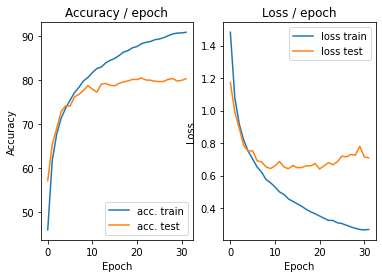

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.284s (0.284s)	Loss 0.2542 (0.2542)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


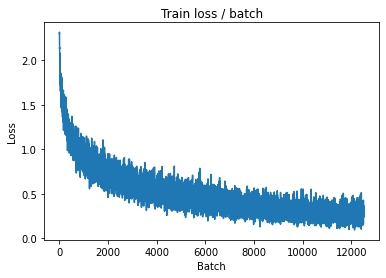

[TRAIN Batch 200/391]	Time 0.020s (0.056s)	Loss 0.1957 (0.2575)	Prec@1  93.8 ( 91.0)	Prec@5 100.0 ( 99.9)


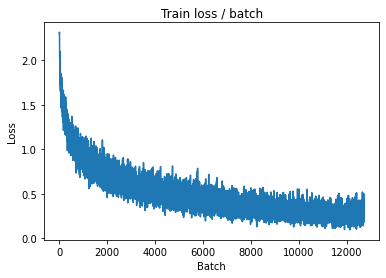


===============> Total time 21s	Avg loss 0.2576	Avg Prec@1 91.03 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.230s (0.230s)	Loss 0.8245 (0.8245)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8032	Avg Prec@1 78.61 %	Avg Prec@5 98.40 %



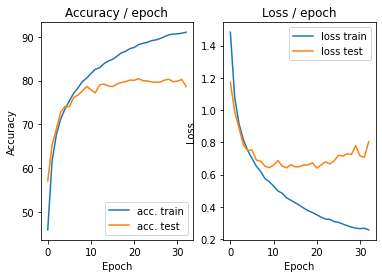

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.297s (0.297s)	Loss 0.2537 (0.2537)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


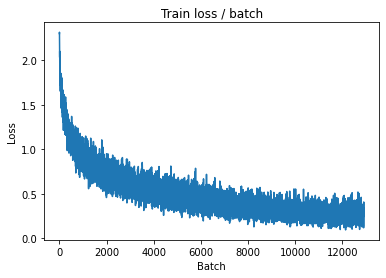

[TRAIN Batch 200/391]	Time 0.027s (0.057s)	Loss 0.1490 (0.2406)	Prec@1  93.8 ( 91.6)	Prec@5 100.0 ( 99.9)


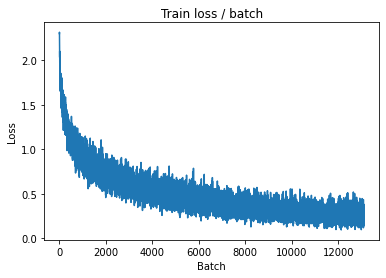


===============> Total time 21s	Avg loss 0.2554	Avg Prec@1 91.07 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.220s (0.220s)	Loss 0.7986 (0.7986)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7363	Avg Prec@1 80.06 %	Avg Prec@5 98.81 %



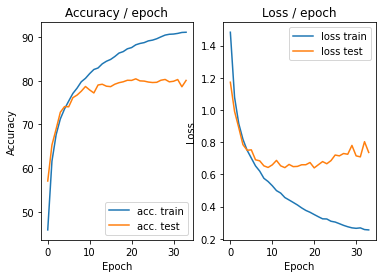

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.311s (0.311s)	Loss 0.2024 (0.2024)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


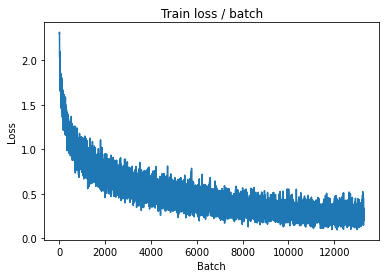

[TRAIN Batch 200/391]	Time 0.092s (0.057s)	Loss 0.3054 (0.2332)	Prec@1  89.1 ( 91.7)	Prec@5 100.0 ( 99.9)


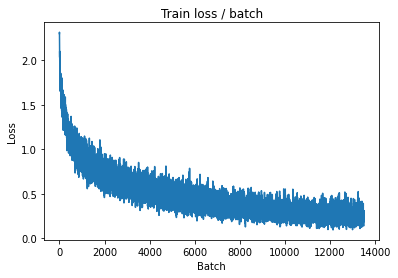


===============> Total time 21s	Avg loss 0.2479	Avg Prec@1 91.28 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.8187 (0.8187)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7627	Avg Prec@1 79.99 %	Avg Prec@5 98.68 %



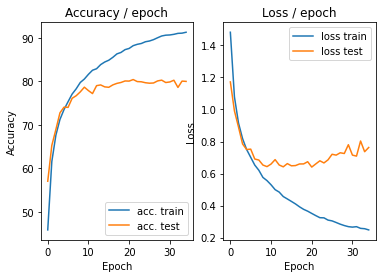

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.288s (0.288s)	Loss 0.2838 (0.2838)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


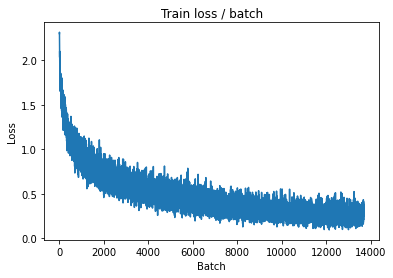

[TRAIN Batch 200/391]	Time 0.025s (0.056s)	Loss 0.2096 (0.2272)	Prec@1  91.4 ( 92.1)	Prec@5 100.0 ( 99.9)


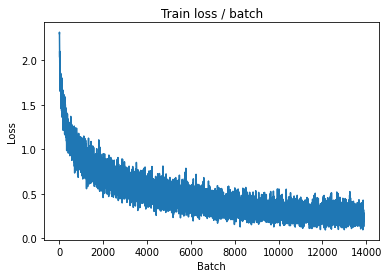


===============> Total time 21s	Avg loss 0.2352	Avg Prec@1 91.81 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.7114 (0.7114)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7604	Avg Prec@1 80.49 %	Avg Prec@5 98.68 %



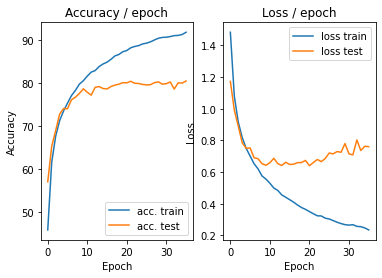

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 0.1624 (0.1624)	Prec@1  96.1 ( 96.1)	Prec@5  99.2 ( 99.2)


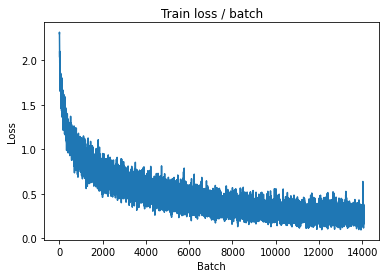

[TRAIN Batch 200/391]	Time 0.035s (0.057s)	Loss 0.3658 (0.2267)	Prec@1  89.8 ( 92.1)	Prec@5  99.2 ( 99.9)


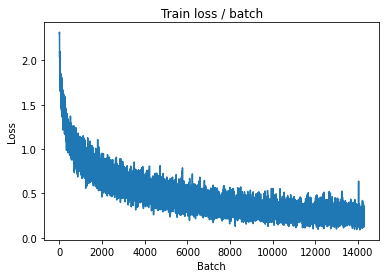


===============> Total time 21s	Avg loss 0.2351	Avg Prec@1 91.82 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.237s (0.237s)	Loss 0.7126 (0.7126)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7379	Avg Prec@1 80.39 %	Avg Prec@5 98.56 %



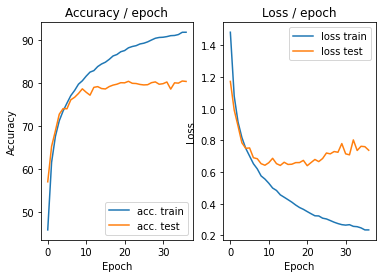

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.297s (0.297s)	Loss 0.1802 (0.1802)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


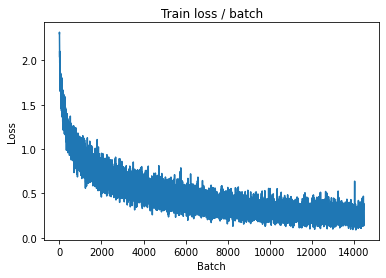

[TRAIN Batch 200/391]	Time 0.029s (0.057s)	Loss 0.1076 (0.2096)	Prec@1  96.9 ( 92.5)	Prec@5 100.0 ( 99.9)


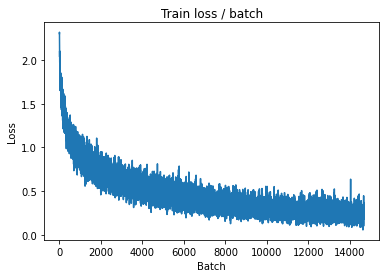


===============> Total time 22s	Avg loss 0.2237	Avg Prec@1 92.10 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.227s (0.227s)	Loss 0.6634 (0.6634)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7798	Avg Prec@1 80.33 %	Avg Prec@5 98.53 %



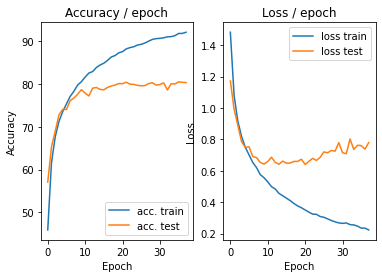

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.2108 (0.2108)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


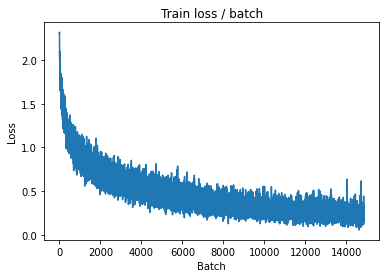

[TRAIN Batch 200/391]	Time 0.019s (0.056s)	Loss 0.1730 (0.2127)	Prec@1  93.8 ( 92.7)	Prec@5  99.2 ( 99.9)


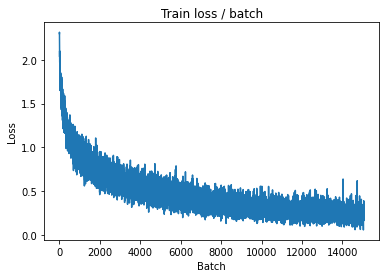


===============> Total time 21s	Avg loss 0.2190	Avg Prec@1 92.37 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.230s (0.230s)	Loss 0.8923 (0.8923)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8610	Avg Prec@1 79.55 %	Avg Prec@5 98.61 %



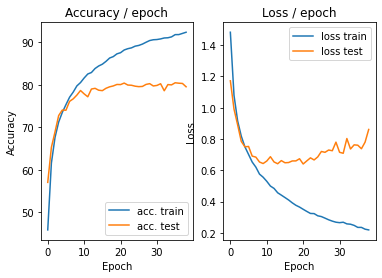

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 0.2031 (0.2031)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


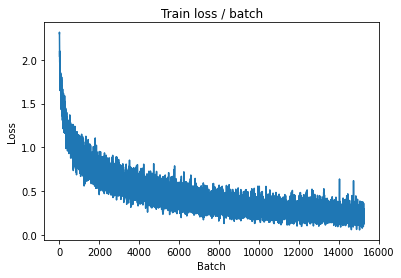

[TRAIN Batch 200/391]	Time 0.074s (0.057s)	Loss 0.1814 (0.2142)	Prec@1  93.0 ( 92.6)	Prec@5 100.0 ( 99.9)


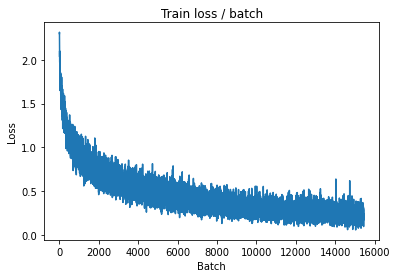


===============> Total time 22s	Avg loss 0.2244	Avg Prec@1 92.30 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.206s (0.206s)	Loss 0.8284 (0.8284)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7745	Avg Prec@1 79.66 %	Avg Prec@5 98.45 %



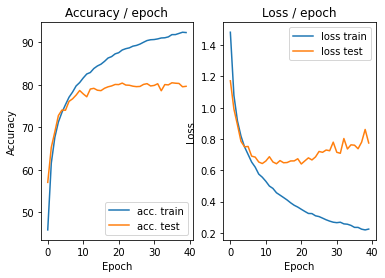

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.333s (0.333s)	Loss 0.1652 (0.1652)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


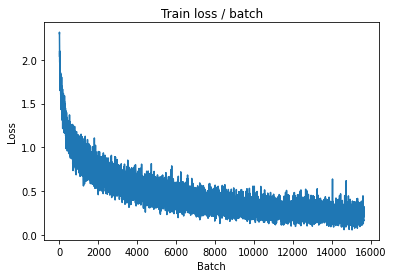

[TRAIN Batch 200/391]	Time 0.060s (0.057s)	Loss 0.2265 (0.2057)	Prec@1  93.8 ( 93.0)	Prec@5 100.0 ( 99.9)


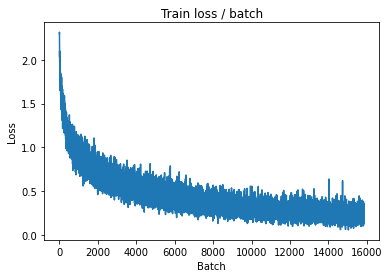


===============> Total time 21s	Avg loss 0.2158	Avg Prec@1 92.57 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.222s (0.222s)	Loss 0.7407 (0.7407)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8030	Avg Prec@1 79.35 %	Avg Prec@5 98.64 %



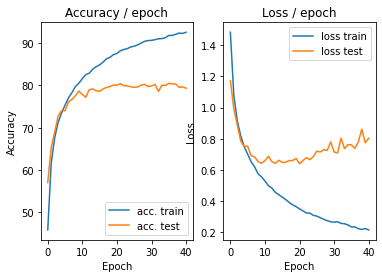

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.296s (0.296s)	Loss 0.1287 (0.1287)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


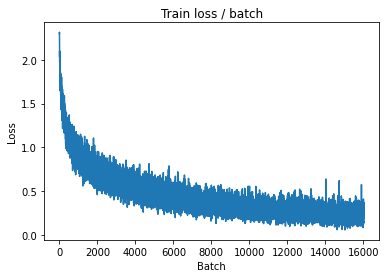

[TRAIN Batch 200/391]	Time 0.022s (0.058s)	Loss 0.2123 (0.2034)	Prec@1  91.4 ( 92.9)	Prec@5  99.2 ( 99.9)


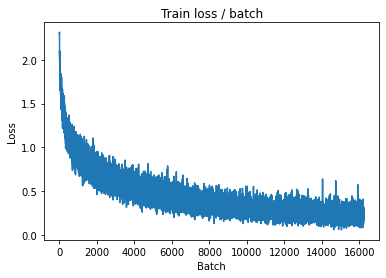


===============> Total time 22s	Avg loss 0.2109	Avg Prec@1 92.63 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.224s (0.224s)	Loss 0.8038 (0.8038)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8360	Avg Prec@1 80.08 %	Avg Prec@5 98.58 %



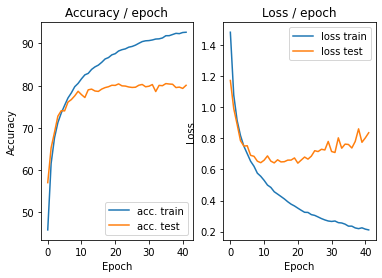

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.285s (0.285s)	Loss 0.1936 (0.1936)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


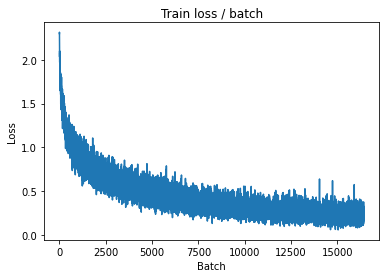

[TRAIN Batch 200/391]	Time 0.074s (0.057s)	Loss 0.1479 (0.2019)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 ( 99.9)


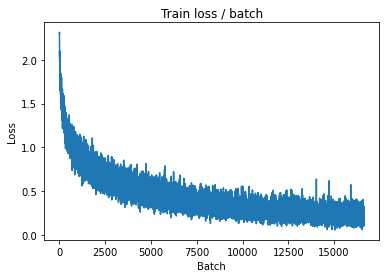


===============> Total time 22s	Avg loss 0.2101	Avg Prec@1 92.67 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.8154 (0.8154)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8097	Avg Prec@1 80.32 %	Avg Prec@5 98.64 %



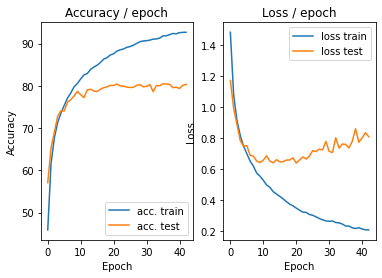

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.281s (0.281s)	Loss 0.1262 (0.1262)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


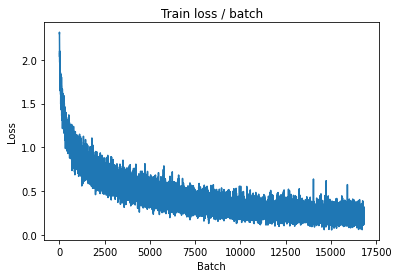

[TRAIN Batch 200/391]	Time 0.030s (0.057s)	Loss 0.1353 (0.1835)	Prec@1  95.3 ( 93.6)	Prec@5 100.0 ( 99.9)


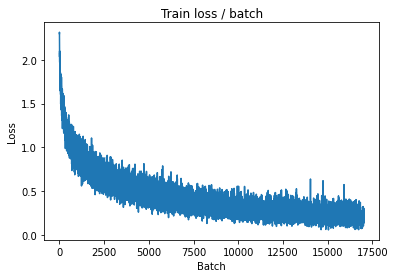


===============> Total time 22s	Avg loss 0.1990	Avg Prec@1 93.08 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.229s (0.229s)	Loss 0.7559 (0.7559)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8166	Avg Prec@1 80.08 %	Avg Prec@5 98.80 %



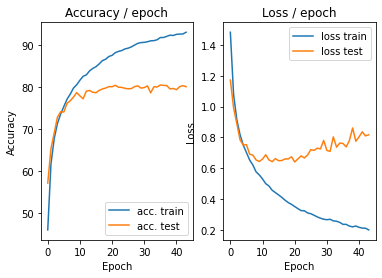

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.293s (0.293s)	Loss 0.2233 (0.2233)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


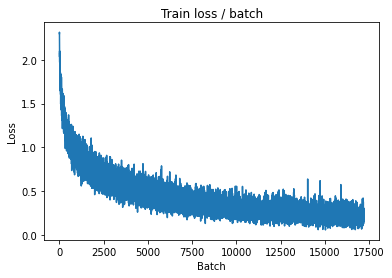

[TRAIN Batch 200/391]	Time 0.087s (0.057s)	Loss 0.2426 (0.1966)	Prec@1  89.8 ( 93.3)	Prec@5 100.0 ( 99.9)


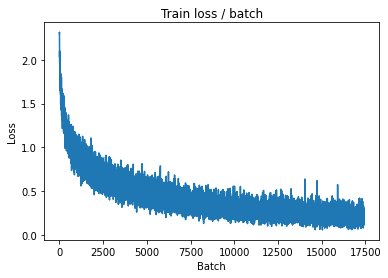


===============> Total time 22s	Avg loss 0.2042	Avg Prec@1 93.05 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.231s (0.231s)	Loss 0.7441 (0.7441)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8400	Avg Prec@1 79.63 %	Avg Prec@5 98.53 %



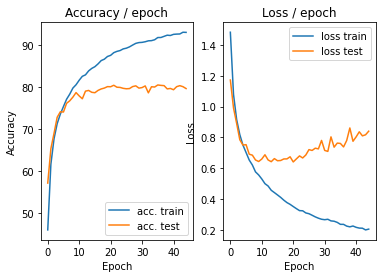

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.284s (0.284s)	Loss 0.2636 (0.2636)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


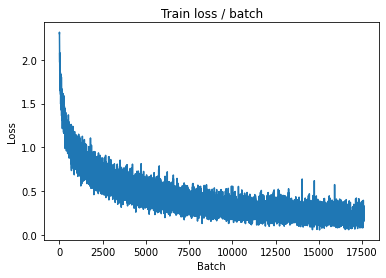

[TRAIN Batch 200/391]	Time 0.083s (0.058s)	Loss 0.1060 (0.1977)	Prec@1  95.3 ( 93.1)	Prec@5 100.0 ( 99.9)


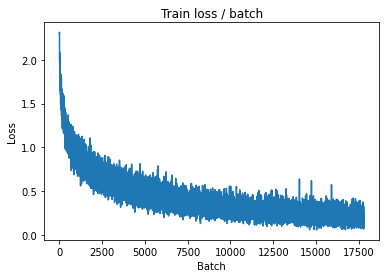


===============> Total time 22s	Avg loss 0.2037	Avg Prec@1 92.80 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.220s (0.220s)	Loss 0.6478 (0.6478)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)

===============> Total time 3s	Avg loss 0.8355	Avg Prec@1 80.18 %	Avg Prec@5 98.58 %



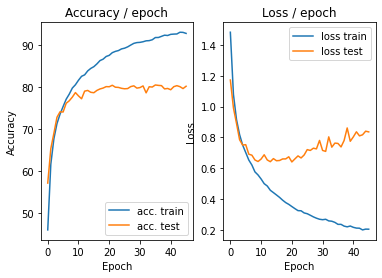

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.291s (0.291s)	Loss 0.1611 (0.1611)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


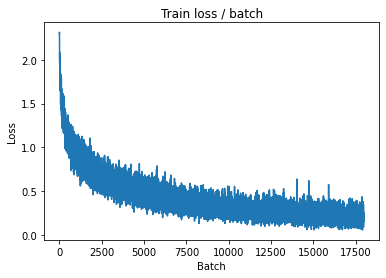

[TRAIN Batch 200/391]	Time 0.093s (0.058s)	Loss 0.2968 (0.2056)	Prec@1  91.4 ( 93.0)	Prec@5 100.0 ( 99.9)


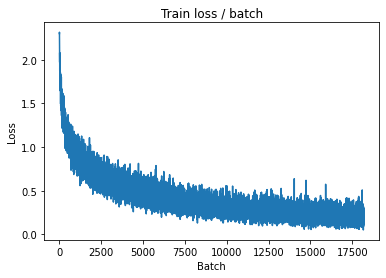


===============> Total time 22s	Avg loss 0.2085	Avg Prec@1 92.80 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.223s (0.223s)	Loss 0.7691 (0.7691)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8400	Avg Prec@1 79.28 %	Avg Prec@5 98.41 %



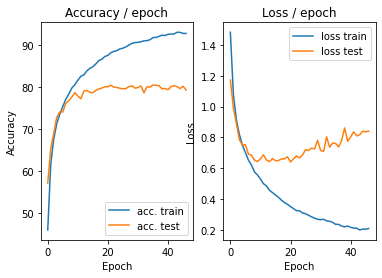

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 0.2096 (0.2096)	Prec@1  95.3 ( 95.3)	Prec@5  99.2 ( 99.2)


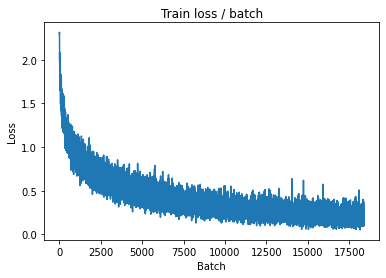

[TRAIN Batch 200/391]	Time 0.088s (0.057s)	Loss 0.2323 (0.1850)	Prec@1  93.0 ( 93.6)	Prec@5 100.0 ( 99.9)


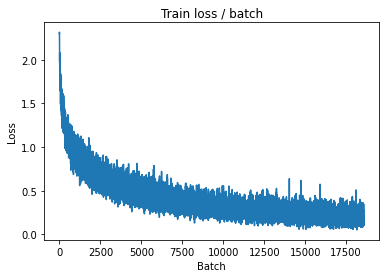


===============> Total time 22s	Avg loss 0.1923	Avg Prec@1 93.38 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.240s (0.240s)	Loss 0.7857 (0.7857)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)

===============> Total time 3s	Avg loss 0.8260	Avg Prec@1 80.31 %	Avg Prec@5 98.50 %



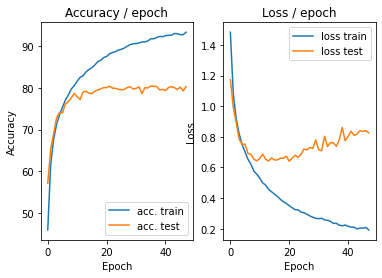

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.316s (0.316s)	Loss 0.1345 (0.1345)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


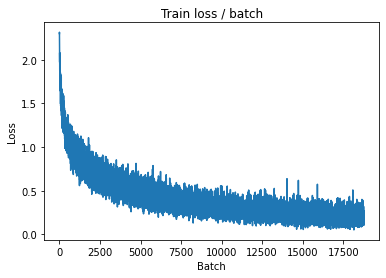

[TRAIN Batch 200/391]	Time 0.019s (0.057s)	Loss 0.0871 (0.1779)	Prec@1  97.7 ( 93.9)	Prec@5 100.0 ( 99.9)


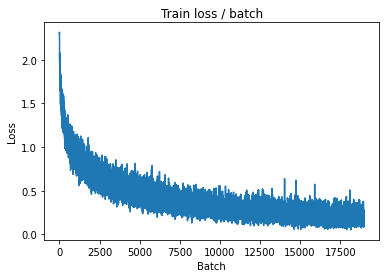


===============> Total time 21s	Avg loss 0.1874	Avg Prec@1 93.52 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.239s (0.239s)	Loss 0.7842 (0.7842)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8650	Avg Prec@1 79.84 %	Avg Prec@5 98.54 %



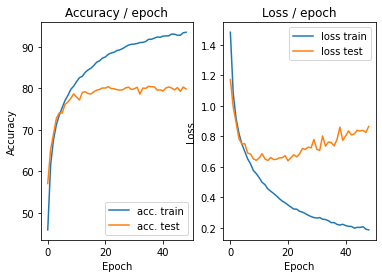

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.300s (0.300s)	Loss 0.1152 (0.1152)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


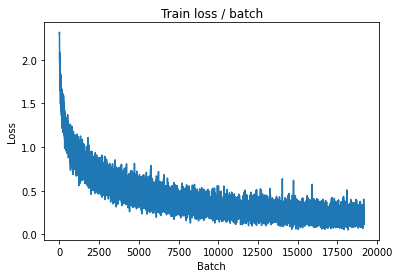

[TRAIN Batch 200/391]	Time 0.025s (0.058s)	Loss 0.1745 (0.1879)	Prec@1  93.8 ( 93.6)	Prec@5 100.0 ( 99.9)


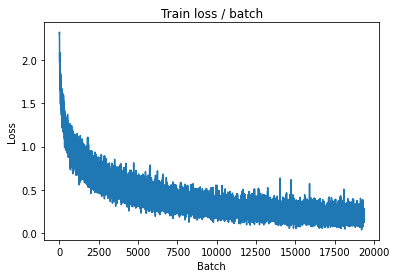


===============> Total time 22s	Avg loss 0.1894	Avg Prec@1 93.65 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.256s (0.256s)	Loss 0.8179 (0.8179)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8887	Avg Prec@1 80.01 %	Avg Prec@5 98.54 %



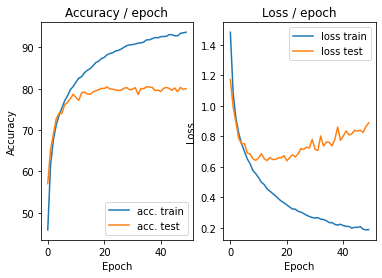

In [ ]:
main(128, 0.001,epochs=50, cuda=True)

##Dropout

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.9)
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

        lr_sched.step()

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====



/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


[TRAIN Batch 000/391]	Time 0.847s (0.847s)	Loss 2.3040 (2.3040)	Prec@1   7.0 (  7.0)	Prec@5  50.0 ( 50.0)


<Figure size 432x288 with 0 Axes>

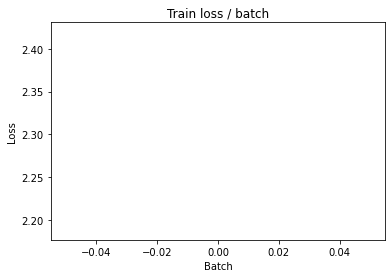

[TRAIN Batch 200/391]	Time 0.091s (0.058s)	Loss 2.0829 (2.2510)	Prec@1  15.6 ( 17.8)	Prec@5  74.2 ( 67.3)


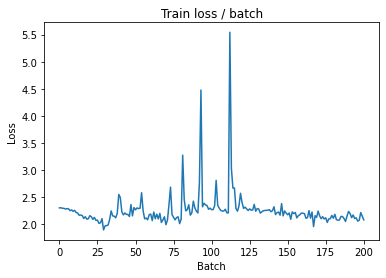


===============> Total time 22s	Avg loss 2.1226	Avg Prec@1 22.38 %	Avg Prec@5 73.46 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 1.9881 (1.9881)	Prec@1  25.8 ( 25.8)	Prec@5  83.6 ( 83.6)

===============> Total time 3s	Avg loss 1.9288	Avg Prec@1 27.61 %	Avg Prec@5 82.30 %



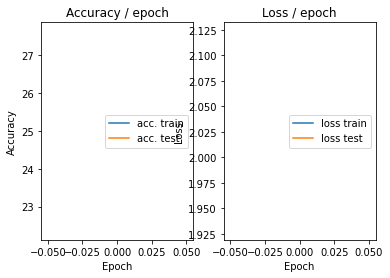

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 1.9752 (1.9752)	Prec@1  24.2 ( 24.2)	Prec@5  85.9 ( 85.9)


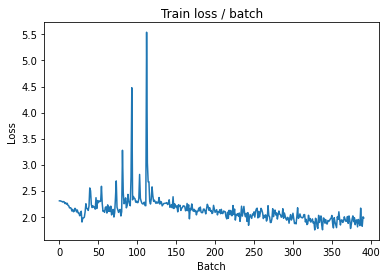

[TRAIN Batch 200/391]	Time 0.019s (0.055s)	Loss 1.7751 (1.8739)	Prec@1  37.5 ( 30.6)	Prec@5  83.6 ( 84.1)


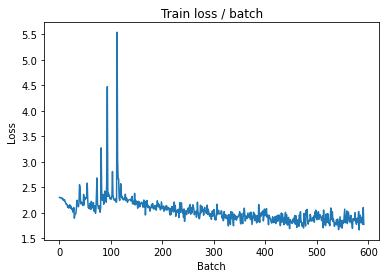


===============> Total time 21s	Avg loss 1.8588	Avg Prec@1 30.74 %	Avg Prec@5 84.53 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 1.8165 (1.8165)	Prec@1  34.4 ( 34.4)	Prec@5  83.6 ( 83.6)

===============> Total time 3s	Avg loss 1.7700	Avg Prec@1 32.96 %	Avg Prec@5 87.12 %



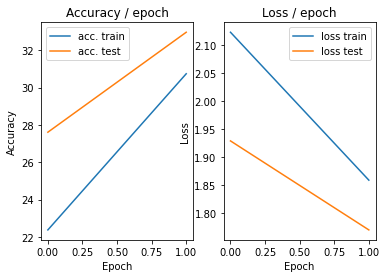

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 1.9181 (1.9181)	Prec@1  29.7 ( 29.7)	Prec@5  82.8 ( 82.8)


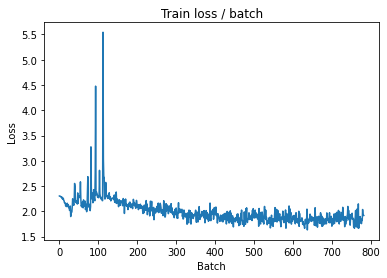

[TRAIN Batch 200/391]	Time 0.042s (0.056s)	Loss 1.8134 (1.7957)	Prec@1  28.1 ( 33.4)	Prec@5  86.7 ( 86.0)


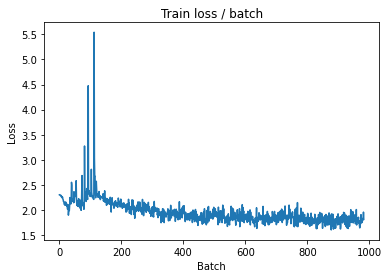


===============> Total time 21s	Avg loss 1.7872	Avg Prec@1 33.60 %	Avg Prec@5 86.18 %

[EVAL Batch 000/079]	Time 0.202s (0.202s)	Loss 1.7848 (1.7848)	Prec@1  34.4 ( 34.4)	Prec@5  86.7 ( 86.7)

===============> Total time 3s	Avg loss 1.7866	Avg Prec@1 34.73 %	Avg Prec@5 85.83 %



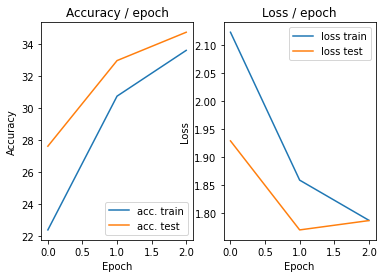

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 1.8559 (1.8559)	Prec@1  35.9 ( 35.9)	Prec@5  84.4 ( 84.4)


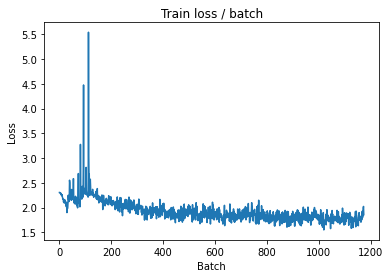

[TRAIN Batch 200/391]	Time 0.089s (0.055s)	Loss 1.6618 (1.7731)	Prec@1  39.8 ( 34.2)	Prec@5  88.3 ( 86.8)


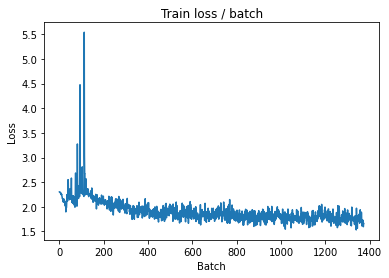


===============> Total time 21s	Avg loss 1.7589	Avg Prec@1 34.75 %	Avg Prec@5 86.91 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 1.6882 (1.6882)	Prec@1  37.5 ( 37.5)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.6662	Avg Prec@1 37.87 %	Avg Prec@5 89.35 %



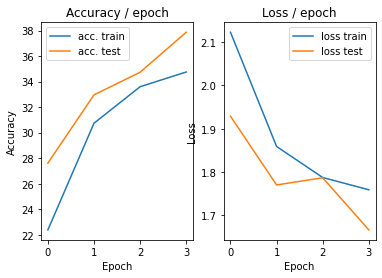

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 1.7657 (1.7657)	Prec@1  33.6 ( 33.6)	Prec@5  85.2 ( 85.2)


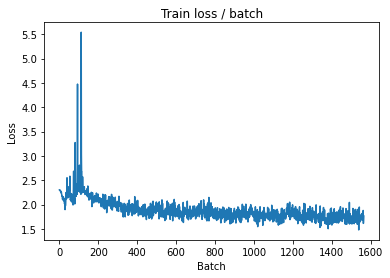

[TRAIN Batch 200/391]	Time 0.055s (0.056s)	Loss 1.6659 (1.7564)	Prec@1  30.5 ( 34.9)	Prec@5  91.4 ( 86.9)


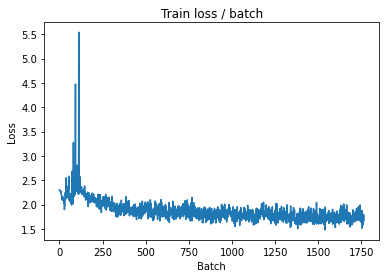


===============> Total time 21s	Avg loss 1.7489	Avg Prec@1 35.36 %	Avg Prec@5 87.16 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 1.7534 (1.7534)	Prec@1  34.4 ( 34.4)	Prec@5  85.2 ( 85.2)

===============> Total time 3s	Avg loss 1.6135	Avg Prec@1 39.43 %	Avg Prec@5 89.36 %



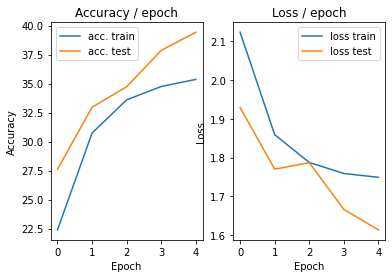

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 1.7447 (1.7447)	Prec@1  37.5 ( 37.5)	Prec@5  83.6 ( 83.6)


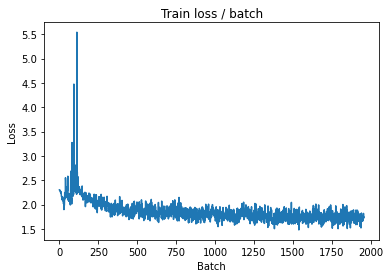

[TRAIN Batch 200/391]	Time 0.062s (0.056s)	Loss 1.5792 (1.7096)	Prec@1  46.9 ( 36.6)	Prec@5  89.8 ( 88.0)


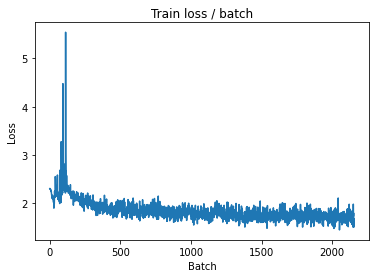


===============> Total time 21s	Avg loss 1.6977	Avg Prec@1 37.27 %	Avg Prec@5 88.25 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 1.6099 (1.6099)	Prec@1  43.0 ( 43.0)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.6107	Avg Prec@1 40.58 %	Avg Prec@5 90.00 %



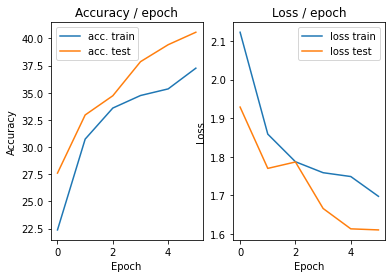

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 1.6022 (1.6022)	Prec@1  39.1 ( 39.1)	Prec@5  91.4 ( 91.4)


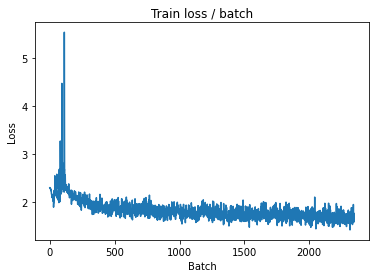

[TRAIN Batch 200/391]	Time 0.019s (0.056s)	Loss 1.6121 (1.6767)	Prec@1  38.3 ( 38.4)	Prec@5  90.6 ( 88.6)


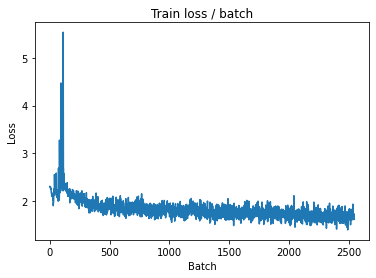


===============> Total time 21s	Avg loss 1.6732	Avg Prec@1 38.59 %	Avg Prec@5 88.53 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 1.5741 (1.5741)	Prec@1  45.3 ( 45.3)	Prec@5  89.1 ( 89.1)

===============> Total time 3s	Avg loss 1.5338	Avg Prec@1 43.34 %	Avg Prec@5 90.80 %



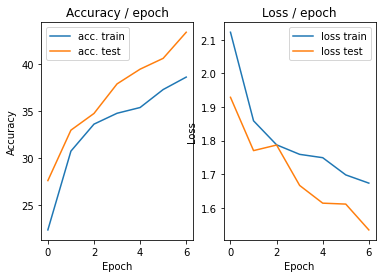

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 1.4944 (1.4944)	Prec@1  43.8 ( 43.8)	Prec@5  92.2 ( 92.2)


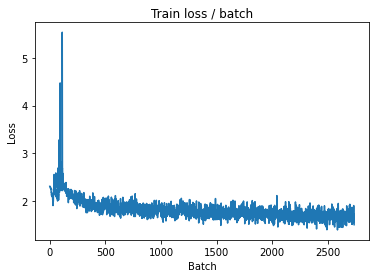

[TRAIN Batch 200/391]	Time 0.074s (0.056s)	Loss 1.4054 (1.6222)	Prec@1  44.5 ( 40.3)	Prec@5  95.3 ( 89.5)


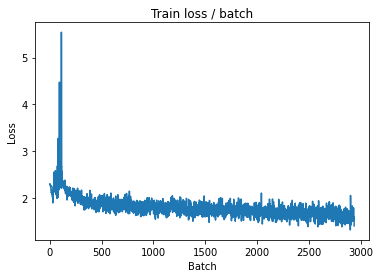


===============> Total time 21s	Avg loss 1.6270	Avg Prec@1 40.19 %	Avg Prec@5 89.33 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 1.4640 (1.4640)	Prec@1  50.8 ( 50.8)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.5036	Avg Prec@1 44.00 %	Avg Prec@5 91.59 %



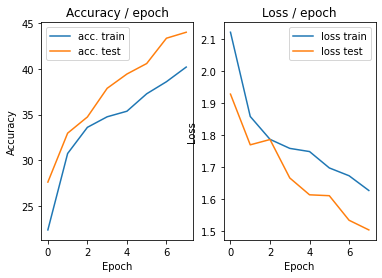

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 1.5920 (1.5920)	Prec@1  45.3 ( 45.3)	Prec@5  92.2 ( 92.2)


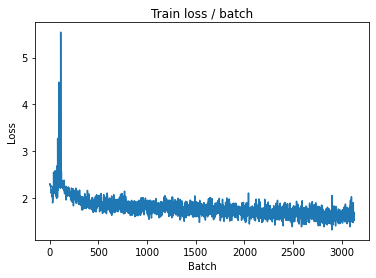

[TRAIN Batch 200/391]	Time 0.067s (0.057s)	Loss 1.4691 (1.5935)	Prec@1  47.7 ( 41.8)	Prec@5  89.8 ( 89.7)


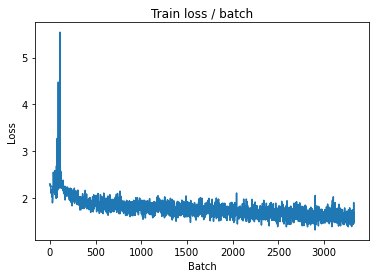


===============> Total time 21s	Avg loss 1.5896	Avg Prec@1 42.14 %	Avg Prec@5 90.06 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.4891 (1.4891)	Prec@1  43.8 ( 43.8)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.4736	Avg Prec@1 46.26 %	Avg Prec@5 91.50 %



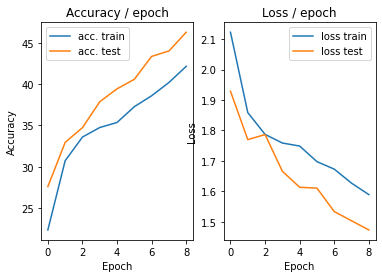

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 1.4174 (1.4174)	Prec@1  50.8 ( 50.8)	Prec@5  94.5 ( 94.5)


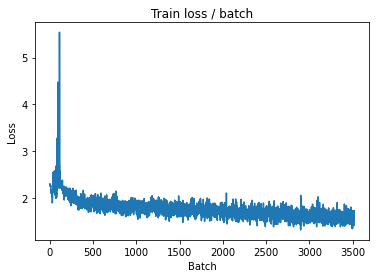

[TRAIN Batch 200/391]	Time 0.032s (0.056s)	Loss 1.4206 (1.5488)	Prec@1  49.2 ( 43.6)	Prec@5  93.8 ( 90.6)


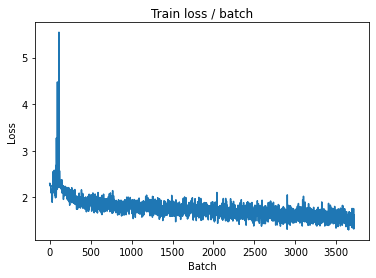


===============> Total time 21s	Avg loss 1.5465	Avg Prec@1 43.96 %	Avg Prec@5 90.71 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 1.4218 (1.4218)	Prec@1  48.4 ( 48.4)	Prec@5  93.8 ( 93.8)

===============> Total time 3s	Avg loss 1.4052	Avg Prec@1 48.60 %	Avg Prec@5 92.52 %



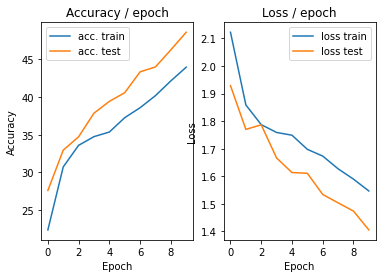

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 1.4332 (1.4332)	Prec@1  50.8 ( 50.8)	Prec@5  93.0 ( 93.0)


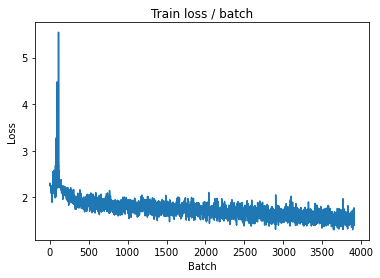

[TRAIN Batch 200/391]	Time 0.037s (0.056s)	Loss 1.7700 (1.5230)	Prec@1  37.5 ( 44.8)	Prec@5  86.7 ( 91.2)


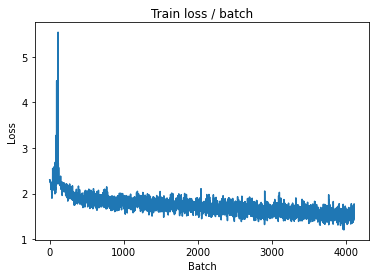


===============> Total time 21s	Avg loss 1.5198	Avg Prec@1 45.39 %	Avg Prec@5 91.15 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 1.5232 (1.5232)	Prec@1  45.3 ( 45.3)	Prec@5  88.3 ( 88.3)

===============> Total time 3s	Avg loss 1.4023	Avg Prec@1 49.77 %	Avg Prec@5 92.51 %



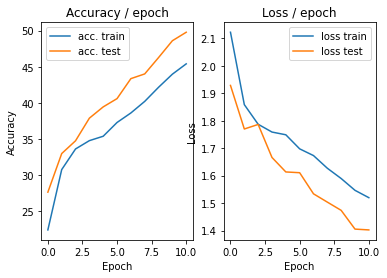

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 1.4848 (1.4848)	Prec@1  50.0 ( 50.0)	Prec@5  93.0 ( 93.0)


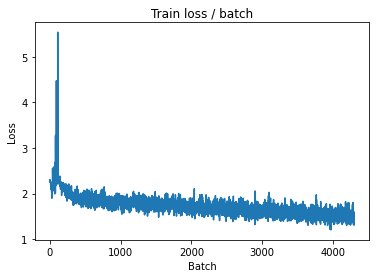

[TRAIN Batch 200/391]	Time 0.029s (0.057s)	Loss 1.5577 (1.4718)	Prec@1  52.3 ( 47.1)	Prec@5  92.2 ( 91.8)


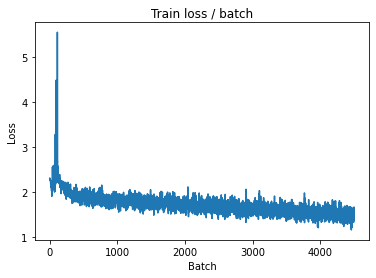


===============> Total time 21s	Avg loss 1.4778	Avg Prec@1 47.07 %	Avg Prec@5 91.56 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 1.3151 (1.3151)	Prec@1  53.1 ( 53.1)	Prec@5  93.8 ( 93.8)

===============> Total time 3s	Avg loss 1.3381	Avg Prec@1 51.57 %	Avg Prec@5 93.32 %



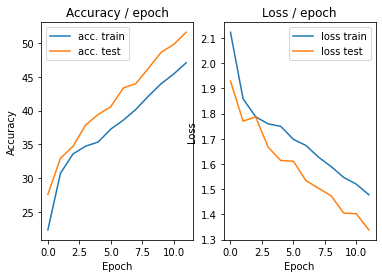

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 1.3766 (1.3766)	Prec@1  46.1 ( 46.1)	Prec@5  93.8 ( 93.8)


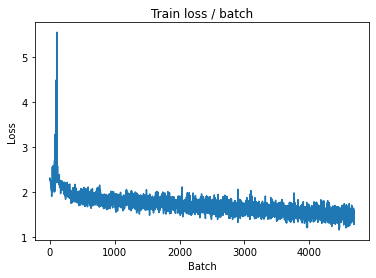

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 1.5680 (1.4422)	Prec@1  41.4 ( 48.6)	Prec@5  93.0 ( 92.1)


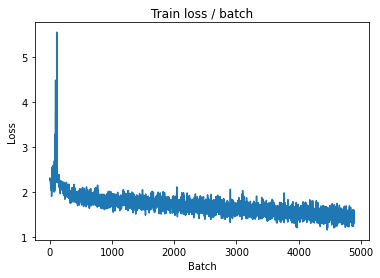


===============> Total time 21s	Avg loss 1.4376	Avg Prec@1 48.86 %	Avg Prec@5 92.16 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 1.2753 (1.2753)	Prec@1  52.3 ( 52.3)	Prec@5  93.8 ( 93.8)

===============> Total time 3s	Avg loss 1.2804	Avg Prec@1 54.33 %	Avg Prec@5 93.83 %



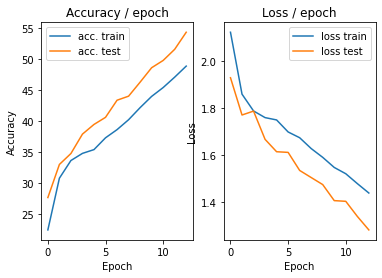

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 1.4484 (1.4484)	Prec@1  50.0 ( 50.0)	Prec@5  94.5 ( 94.5)


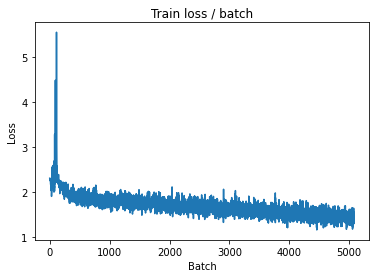

[TRAIN Batch 200/391]	Time 0.077s (0.056s)	Loss 1.4101 (1.3887)	Prec@1  46.1 ( 50.5)	Prec@5  91.4 ( 92.7)


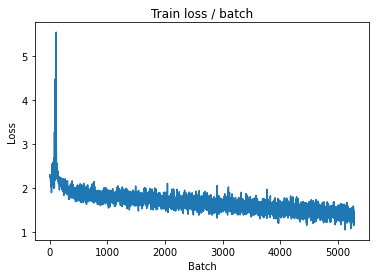


===============> Total time 21s	Avg loss 1.3996	Avg Prec@1 50.19 %	Avg Prec@5 92.47 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 1.2639 (1.2639)	Prec@1  50.8 ( 50.8)	Prec@5  93.0 ( 93.0)

===============> Total time 3s	Avg loss 1.3256	Avg Prec@1 52.71 %	Avg Prec@5 93.68 %



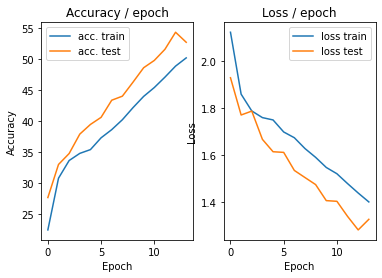

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 1.2836 (1.2836)	Prec@1  53.1 ( 53.1)	Prec@5  92.2 ( 92.2)


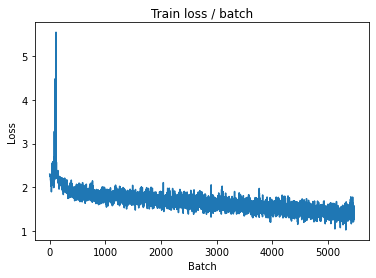

[TRAIN Batch 200/391]	Time 0.090s (0.056s)	Loss 1.5056 (1.3734)	Prec@1  46.1 ( 51.4)	Prec@5  91.4 ( 93.0)


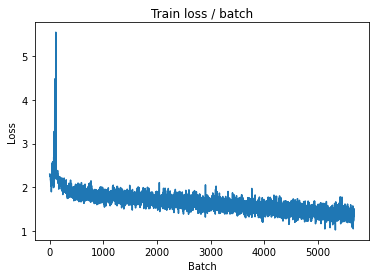


===============> Total time 21s	Avg loss 1.3567	Avg Prec@1 52.26 %	Avg Prec@5 93.10 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 1.2112 (1.2112)	Prec@1  55.5 ( 55.5)	Prec@5  93.0 ( 93.0)

===============> Total time 3s	Avg loss 1.2504	Avg Prec@1 55.98 %	Avg Prec@5 94.29 %



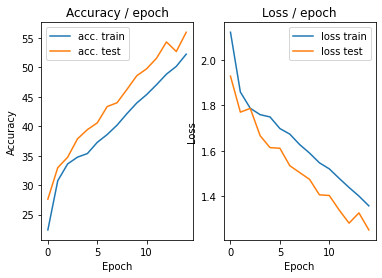

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 1.3777 (1.3777)	Prec@1  54.7 ( 54.7)	Prec@5  90.6 ( 90.6)


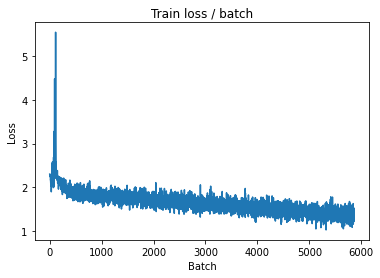

[TRAIN Batch 200/391]	Time 0.033s (0.057s)	Loss 1.2756 (1.3246)	Prec@1  55.5 ( 53.6)	Prec@5  94.5 ( 93.3)


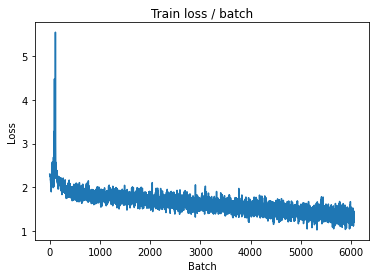


===============> Total time 21s	Avg loss 1.3321	Avg Prec@1 53.53 %	Avg Prec@5 93.28 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 1.3449 (1.3449)	Prec@1  52.3 ( 52.3)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.2434	Avg Prec@1 55.05 %	Avg Prec@5 94.50 %



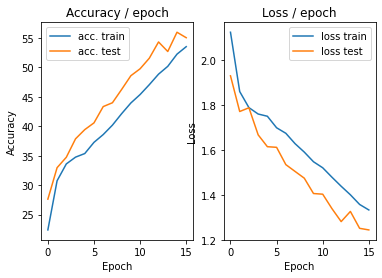

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 1.3895 (1.3895)	Prec@1  54.7 ( 54.7)	Prec@5  89.1 ( 89.1)


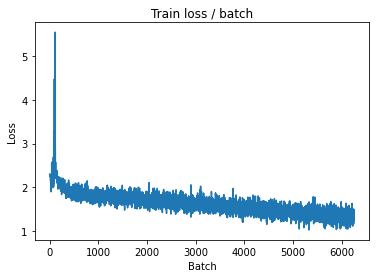

[TRAIN Batch 200/391]	Time 0.064s (0.056s)	Loss 1.1358 (1.2757)	Prec@1  64.1 ( 55.7)	Prec@5  93.8 ( 93.9)


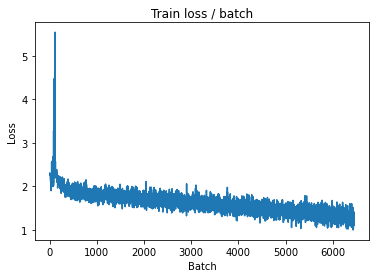


===============> Total time 21s	Avg loss 1.2800	Avg Prec@1 55.48 %	Avg Prec@5 93.81 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 1.0852 (1.0852)	Prec@1  57.8 ( 57.8)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.1748	Avg Prec@1 59.24 %	Avg Prec@5 94.75 %



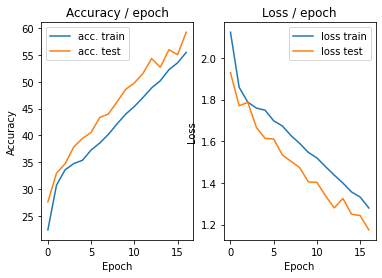

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.234s (0.234s)	Loss 1.1853 (1.1853)	Prec@1  61.7 ( 61.7)	Prec@5  92.2 ( 92.2)


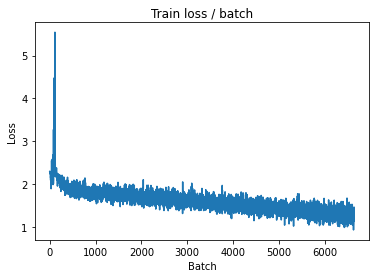

[TRAIN Batch 200/391]	Time 0.035s (0.057s)	Loss 1.0904 (1.2332)	Prec@1  64.8 ( 56.9)	Prec@5  94.5 ( 94.2)


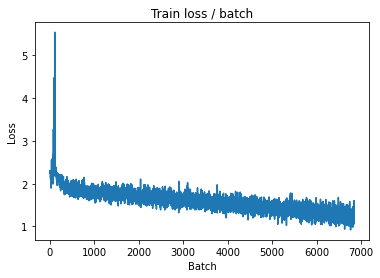


===============> Total time 21s	Avg loss 1.2380	Avg Prec@1 56.98 %	Avg Prec@5 94.14 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 1.1790 (1.1790)	Prec@1  61.7 ( 61.7)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.1543	Avg Prec@1 60.55 %	Avg Prec@5 94.49 %



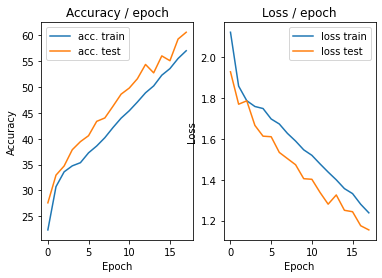

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 1.2750 (1.2750)	Prec@1  58.6 ( 58.6)	Prec@5  95.3 ( 95.3)


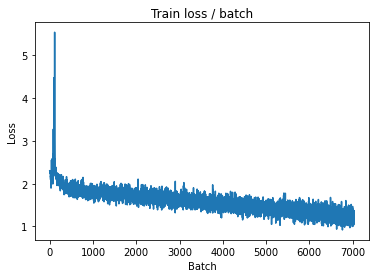

[TRAIN Batch 200/391]	Time 0.079s (0.056s)	Loss 1.2111 (1.1979)	Prec@1  60.9 ( 58.9)	Prec@5  94.5 ( 94.5)


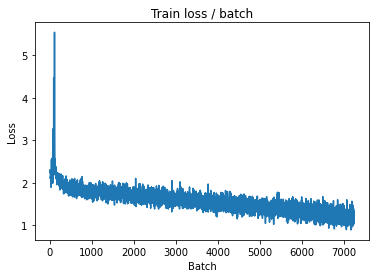


===============> Total time 21s	Avg loss 1.2043	Avg Prec@1 58.79 %	Avg Prec@5 94.52 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 1.0053 (1.0053)	Prec@1  66.4 ( 66.4)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.1109	Avg Prec@1 61.39 %	Avg Prec@5 95.08 %



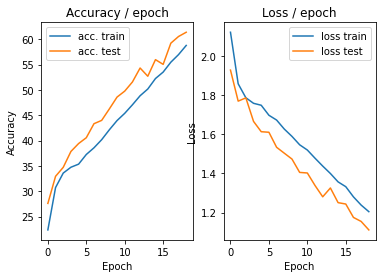

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 1.1548 (1.1548)	Prec@1  57.0 ( 57.0)	Prec@5  93.8 ( 93.8)


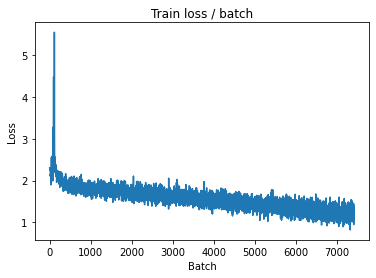

[TRAIN Batch 200/391]	Time 0.058s (0.057s)	Loss 1.1778 (1.1736)	Prec@1  55.5 ( 59.4)	Prec@5  96.9 ( 94.9)


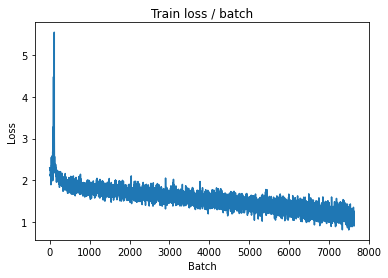


===============> Total time 21s	Avg loss 1.1671	Avg Prec@1 59.83 %	Avg Prec@5 94.79 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 1.1451 (1.1451)	Prec@1  57.8 ( 57.8)	Prec@5  94.5 ( 94.5)

===============> Total time 3s	Avg loss 1.0732	Avg Prec@1 62.98 %	Avg Prec@5 95.69 %



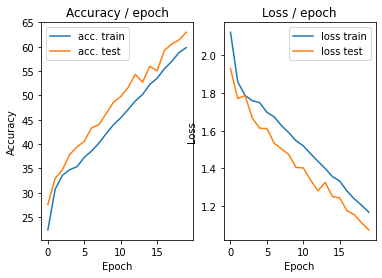

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 1.1084 (1.1084)	Prec@1  59.4 ( 59.4)	Prec@5  97.7 ( 97.7)


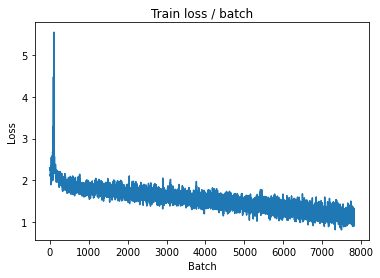

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 1.0221 (1.1508)	Prec@1  60.2 ( 60.7)	Prec@5  96.1 ( 94.9)


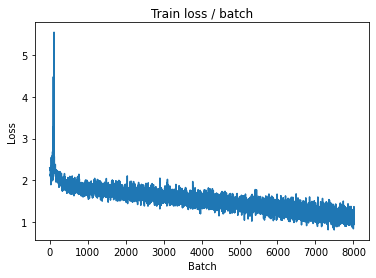


===============> Total time 21s	Avg loss 1.1491	Avg Prec@1 60.75 %	Avg Prec@5 94.97 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 1.0824 (1.0824)	Prec@1  57.0 ( 57.0)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.0663	Avg Prec@1 63.50 %	Avg Prec@5 95.97 %



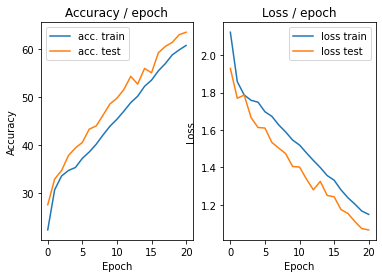

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 1.0136 (1.0136)	Prec@1  68.0 ( 68.0)	Prec@5  94.5 ( 94.5)


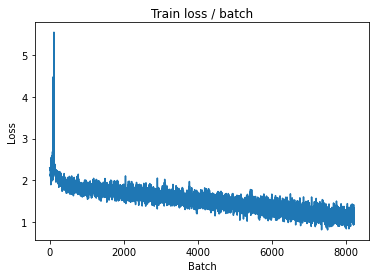

[TRAIN Batch 200/391]	Time 0.065s (0.056s)	Loss 1.1132 (1.1031)	Prec@1  66.4 ( 62.2)	Prec@5  93.8 ( 95.4)


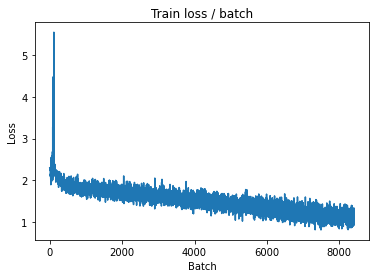


===============> Total time 21s	Avg loss 1.1028	Avg Prec@1 62.24 %	Avg Prec@5 95.48 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 0.8944 (0.8944)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.0124	Avg Prec@1 65.34 %	Avg Prec@5 96.02 %



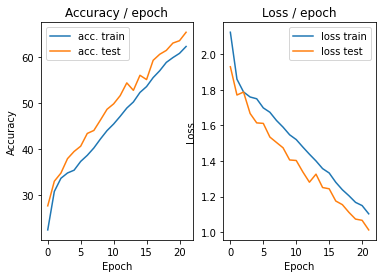

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 1.2026 (1.2026)	Prec@1  54.7 ( 54.7)	Prec@5  93.0 ( 93.0)


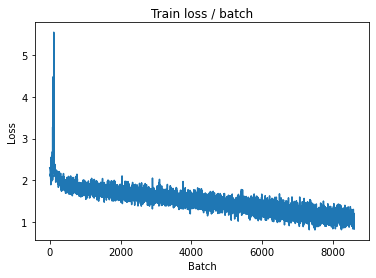

[TRAIN Batch 200/391]	Time 0.097s (0.056s)	Loss 0.9597 (1.0681)	Prec@1  66.4 ( 63.6)	Prec@5  96.9 ( 95.3)


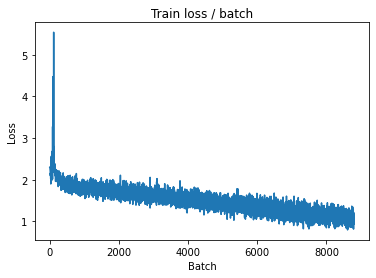


===============> Total time 21s	Avg loss 1.0709	Avg Prec@1 63.52 %	Avg Prec@5 95.49 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.9268 (0.9268)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9917	Avg Prec@1 66.52 %	Avg Prec@5 96.20 %



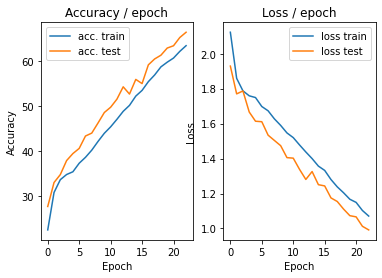

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 1.0306 (1.0306)	Prec@1  64.8 ( 64.8)	Prec@5  94.5 ( 94.5)


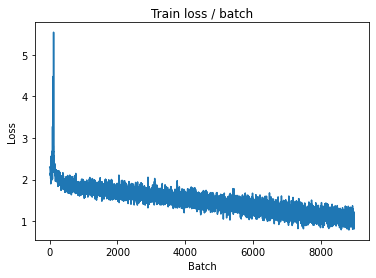

[TRAIN Batch 200/391]	Time 0.025s (0.056s)	Loss 1.0697 (1.0475)	Prec@1  63.3 ( 64.6)	Prec@5  94.5 ( 95.7)


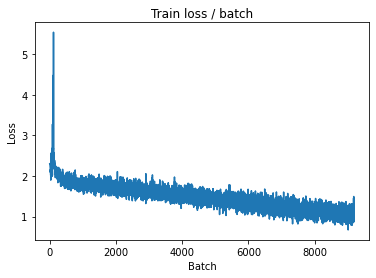


===============> Total time 21s	Avg loss 1.0558	Avg Prec@1 64.22 %	Avg Prec@5 95.71 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 1.0259 (1.0259)	Prec@1  58.6 ( 58.6)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9880	Avg Prec@1 66.22 %	Avg Prec@5 96.31 %



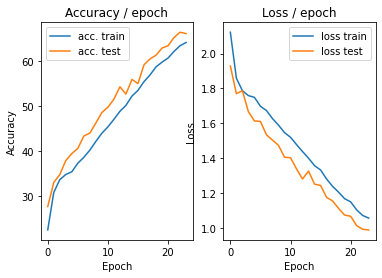

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 1.4247 (1.4247)	Prec@1  50.8 ( 50.8)	Prec@5  92.2 ( 92.2)


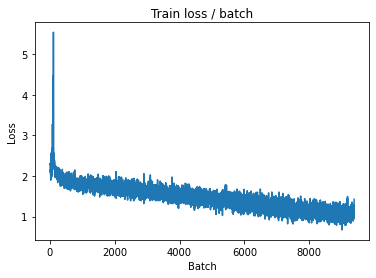

[TRAIN Batch 200/391]	Time 0.060s (0.056s)	Loss 1.0241 (1.0289)	Prec@1  60.2 ( 64.9)	Prec@5  94.5 ( 96.0)


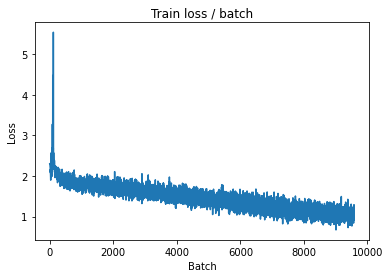


===============> Total time 21s	Avg loss 1.0244	Avg Prec@1 65.05 %	Avg Prec@5 96.02 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.8731 (0.8731)	Prec@1  68.0 ( 68.0)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.9658	Avg Prec@1 67.34 %	Avg Prec@5 96.42 %



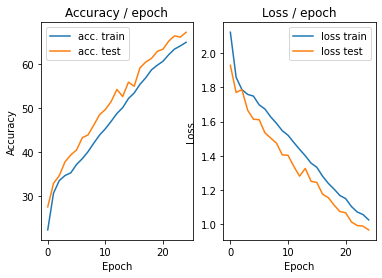

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 1.0219 (1.0219)	Prec@1  61.7 ( 61.7)	Prec@5 100.0 (100.0)


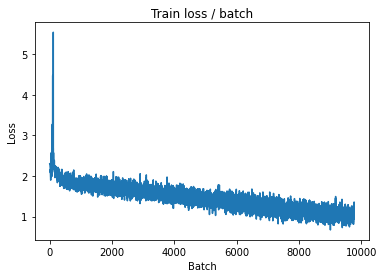

[TRAIN Batch 200/391]	Time 0.024s (0.055s)	Loss 0.9770 (1.0074)	Prec@1  62.5 ( 65.8)	Prec@5  99.2 ( 96.2)


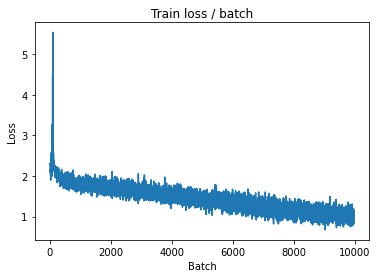


===============> Total time 21s	Avg loss 1.0016	Avg Prec@1 66.08 %	Avg Prec@5 96.12 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 0.9655 (0.9655)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.9314	Avg Prec@1 67.87 %	Avg Prec@5 96.77 %



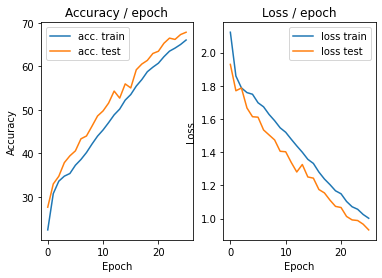

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.225s (0.225s)	Loss 1.1517 (1.1517)	Prec@1  62.5 ( 62.5)	Prec@5  94.5 ( 94.5)


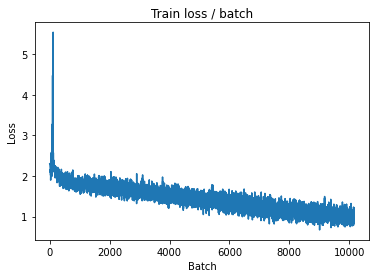

[TRAIN Batch 200/391]	Time 0.047s (0.054s)	Loss 0.8585 (0.9566)	Prec@1  70.3 ( 67.1)	Prec@5  97.7 ( 96.5)


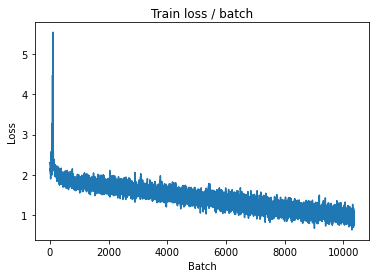


===============> Total time 21s	Avg loss 0.9716	Avg Prec@1 66.86 %	Avg Prec@5 96.43 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.8906 (0.8906)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9125	Avg Prec@1 68.41 %	Avg Prec@5 96.60 %



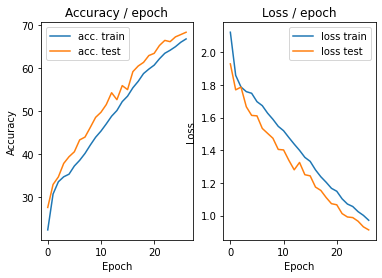

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.9956 (0.9956)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)


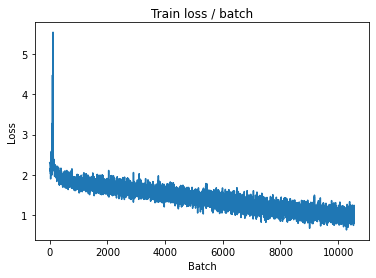

[TRAIN Batch 200/391]	Time 0.025s (0.057s)	Loss 0.8062 (0.9446)	Prec@1  70.3 ( 67.9)	Prec@5  97.7 ( 96.5)


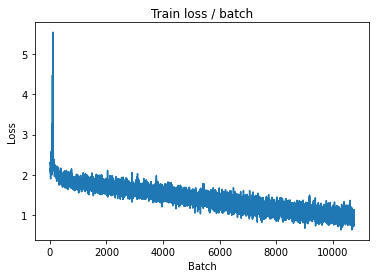


===============> Total time 21s	Avg loss 0.9463	Avg Prec@1 67.93 %	Avg Prec@5 96.55 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.8535 (0.8535)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8963	Avg Prec@1 70.03 %	Avg Prec@5 96.96 %



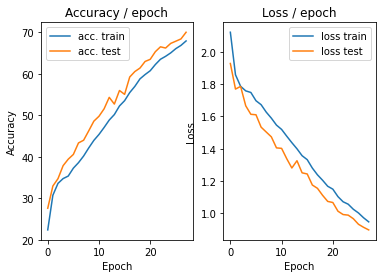

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.256s (0.256s)	Loss 0.9037 (0.9037)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)


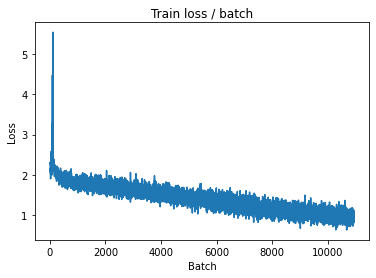

[TRAIN Batch 200/391]	Time 0.025s (0.056s)	Loss 0.7573 (0.9200)	Prec@1  77.3 ( 68.6)	Prec@5  97.7 ( 96.8)


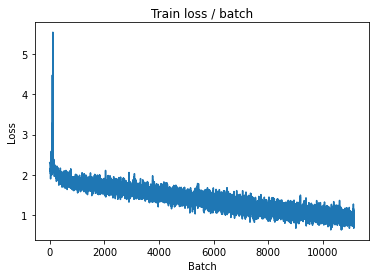


===============> Total time 21s	Avg loss 0.9183	Avg Prec@1 68.68 %	Avg Prec@5 96.75 %

[EVAL Batch 000/079]	Time 0.229s (0.229s)	Loss 0.7685 (0.7685)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.8730	Avg Prec@1 70.02 %	Avg Prec@5 97.07 %



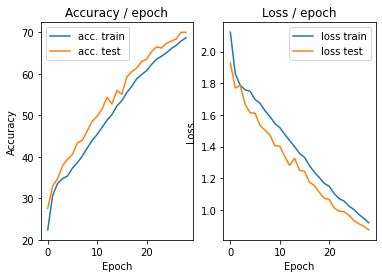

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 1.0095 (1.0095)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)


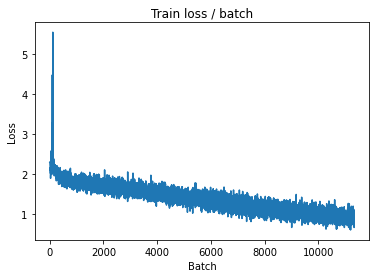

[TRAIN Batch 200/391]	Time 0.019s (0.056s)	Loss 0.9350 (0.9077)	Prec@1  68.8 ( 68.9)	Prec@5  97.7 ( 96.8)


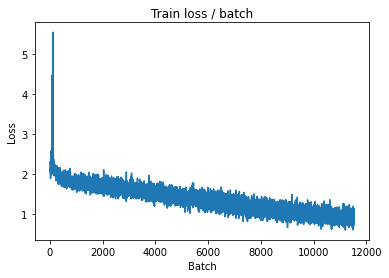


===============> Total time 21s	Avg loss 0.9096	Avg Prec@1 68.97 %	Avg Prec@5 96.84 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.7866 (0.7866)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.8474	Avg Prec@1 71.39 %	Avg Prec@5 97.14 %



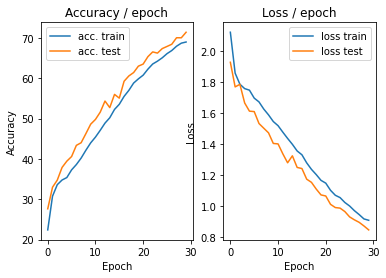

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 0.8947 (0.8947)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)


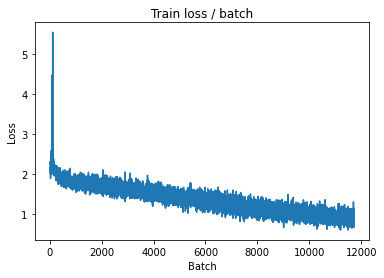

[TRAIN Batch 200/391]	Time 0.090s (0.056s)	Loss 0.8795 (0.8858)	Prec@1  68.0 ( 70.2)	Prec@5  99.2 ( 97.2)


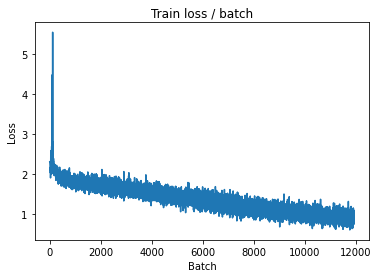


===============> Total time 21s	Avg loss 0.8859	Avg Prec@1 70.07 %	Avg Prec@5 97.04 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 0.8279 (0.8279)	Prec@1  67.2 ( 67.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.8515	Avg Prec@1 71.13 %	Avg Prec@5 97.20 %



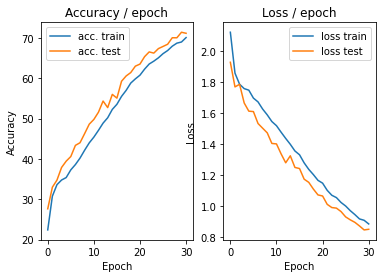

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 0.9612 (0.9612)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)


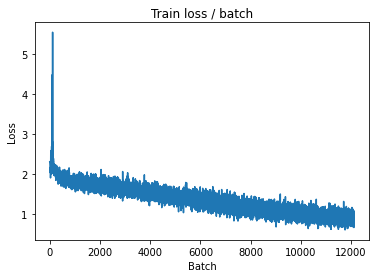

[TRAIN Batch 200/391]	Time 0.025s (0.057s)	Loss 0.8624 (0.8642)	Prec@1  68.0 ( 70.4)	Prec@5  96.9 ( 97.3)


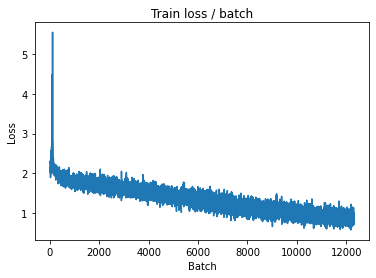


===============> Total time 21s	Avg loss 0.8579	Avg Prec@1 70.54 %	Avg Prec@5 97.34 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.7597 (0.7597)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8262	Avg Prec@1 71.94 %	Avg Prec@5 97.43 %



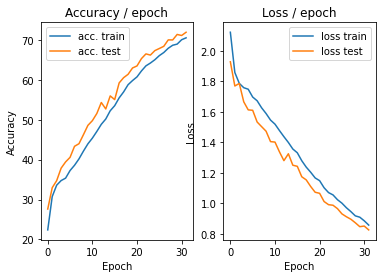

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.6470 (0.6470)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)


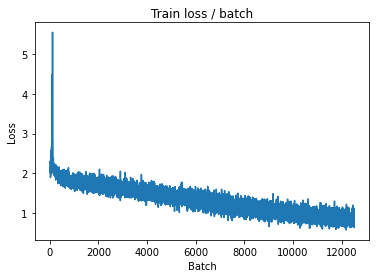

[TRAIN Batch 200/391]	Time 0.091s (0.056s)	Loss 0.8226 (0.8378)	Prec@1  74.2 ( 71.3)	Prec@5  95.3 ( 97.4)


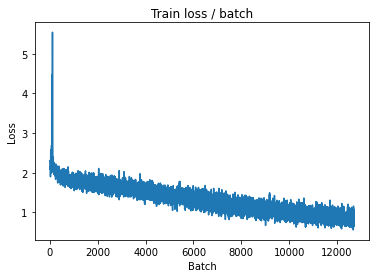


===============> Total time 21s	Avg loss 0.8313	Avg Prec@1 71.51 %	Avg Prec@5 97.47 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 0.6819 (0.6819)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8156	Avg Prec@1 72.62 %	Avg Prec@5 97.43 %



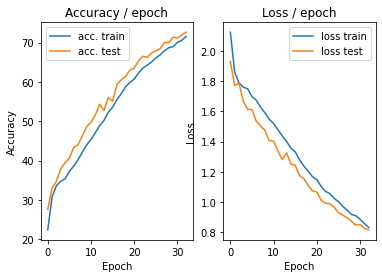

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.249s (0.249s)	Loss 0.9079 (0.9079)	Prec@1  73.4 ( 73.4)	Prec@5  95.3 ( 95.3)


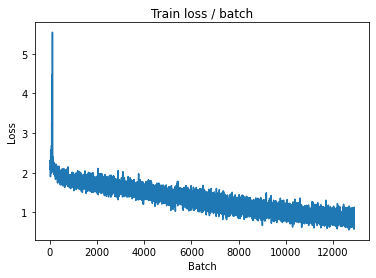

[TRAIN Batch 200/391]	Time 0.025s (0.056s)	Loss 0.6849 (0.8195)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 97.5)


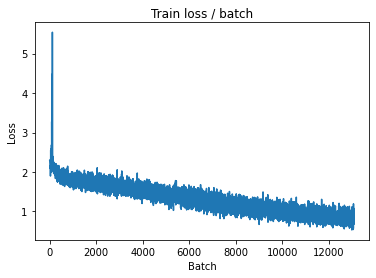


===============> Total time 21s	Avg loss 0.8199	Avg Prec@1 71.80 %	Avg Prec@5 97.47 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.6146 (0.6146)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.8103	Avg Prec@1 72.64 %	Avg Prec@5 97.28 %



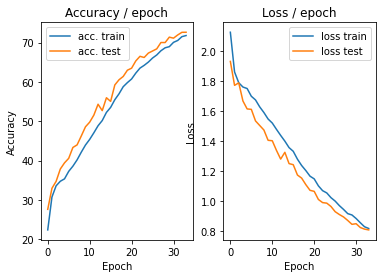

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 0.7544 (0.7544)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)


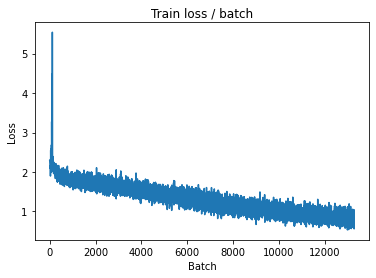

[TRAIN Batch 200/391]	Time 0.019s (0.056s)	Loss 0.8183 (0.8098)	Prec@1  71.1 ( 72.3)	Prec@5  99.2 ( 97.5)


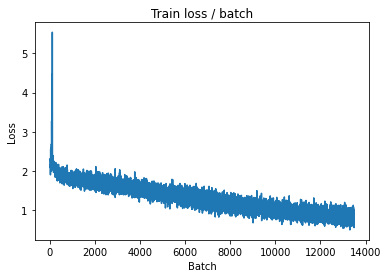


===============> Total time 21s	Avg loss 0.8098	Avg Prec@1 72.51 %	Avg Prec@5 97.51 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 0.7707 (0.7707)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8187	Avg Prec@1 73.30 %	Avg Prec@5 97.26 %



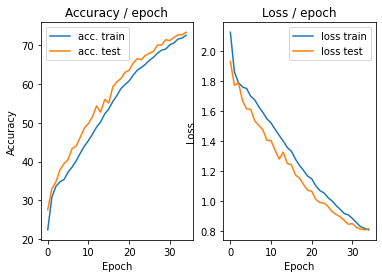

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 0.9074 (0.9074)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)


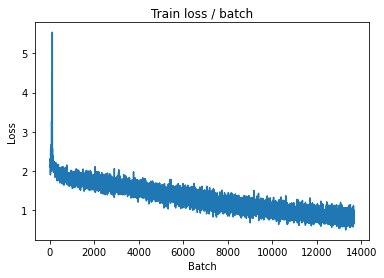

[TRAIN Batch 200/391]	Time 0.019s (0.057s)	Loss 0.7755 (0.7991)	Prec@1  70.3 ( 72.9)	Prec@5  99.2 ( 97.5)


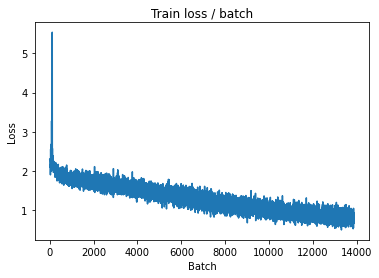


===============> Total time 21s	Avg loss 0.7985	Avg Prec@1 72.73 %	Avg Prec@5 97.54 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.6838 (0.6838)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7711	Avg Prec@1 74.09 %	Avg Prec@5 97.64 %



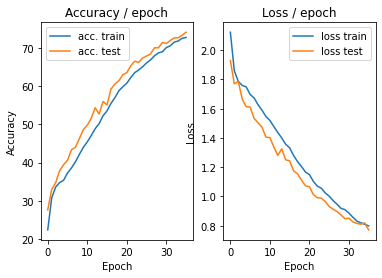

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.241s (0.241s)	Loss 0.8161 (0.8161)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)


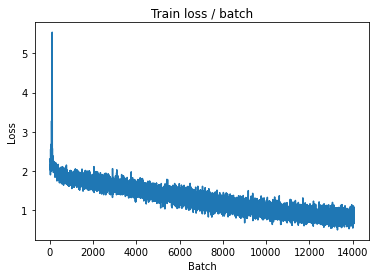

[TRAIN Batch 200/391]	Time 0.063s (0.057s)	Loss 0.9139 (0.7751)	Prec@1  68.8 ( 73.4)	Prec@5  96.1 ( 97.8)


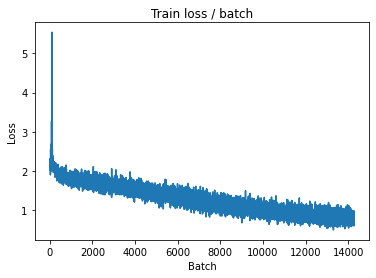


===============> Total time 21s	Avg loss 0.7729	Avg Prec@1 73.46 %	Avg Prec@5 97.77 %

[EVAL Batch 000/079]	Time 0.216s (0.216s)	Loss 0.7175 (0.7175)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7935	Avg Prec@1 73.82 %	Avg Prec@5 97.73 %



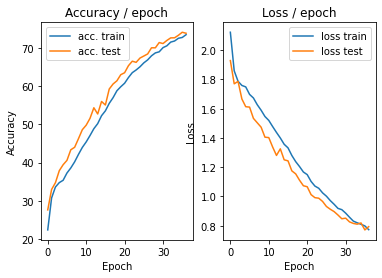

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.6246 (0.6246)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)


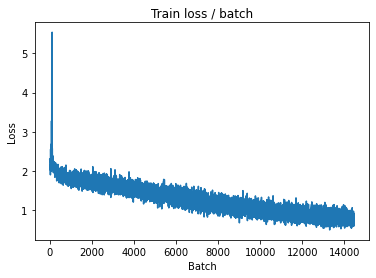

[TRAIN Batch 200/391]	Time 0.027s (0.057s)	Loss 0.7717 (0.7458)	Prec@1  72.7 ( 74.2)	Prec@5  97.7 ( 98.0)


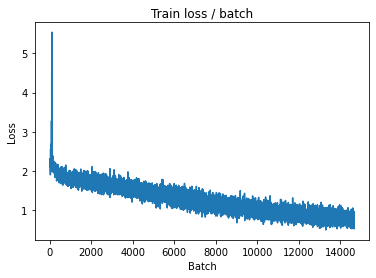


===============> Total time 21s	Avg loss 0.7570	Avg Prec@1 74.02 %	Avg Prec@5 97.85 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.7049 (0.7049)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8084	Avg Prec@1 73.34 %	Avg Prec@5 97.59 %



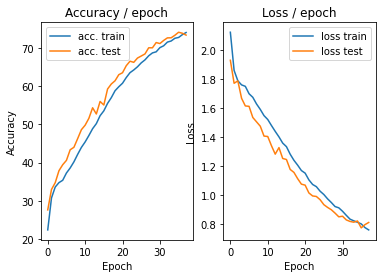

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.8907 (0.8907)	Prec@1  69.5 ( 69.5)	Prec@5  96.1 ( 96.1)


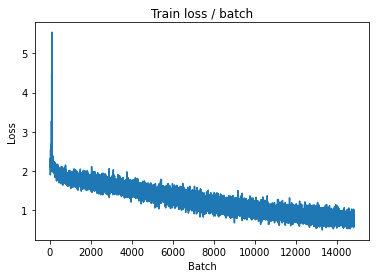

[TRAIN Batch 200/391]	Time 0.074s (0.056s)	Loss 0.8303 (0.7418)	Prec@1  74.2 ( 74.5)	Prec@5  96.9 ( 97.9)


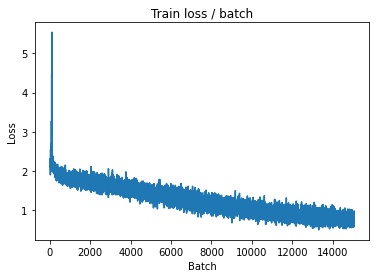


===============> Total time 21s	Avg loss 0.7419	Avg Prec@1 74.58 %	Avg Prec@5 97.88 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 0.6058 (0.6058)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7614	Avg Prec@1 75.20 %	Avg Prec@5 97.84 %



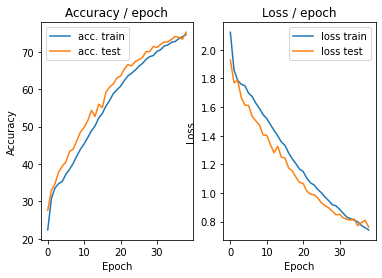

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.249s (0.249s)	Loss 0.7051 (0.7051)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)


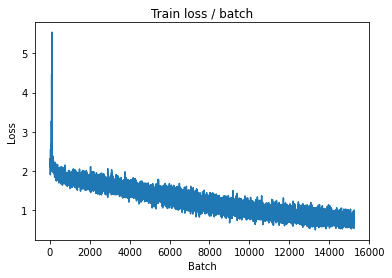

[TRAIN Batch 200/391]	Time 0.020s (0.058s)	Loss 0.6583 (0.7274)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 97.9)


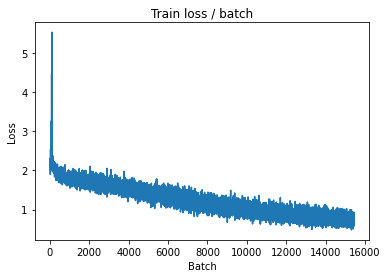


===============> Total time 22s	Avg loss 0.7249	Avg Prec@1 75.09 %	Avg Prec@5 98.05 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 0.6756 (0.6756)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7404	Avg Prec@1 75.40 %	Avg Prec@5 97.90 %



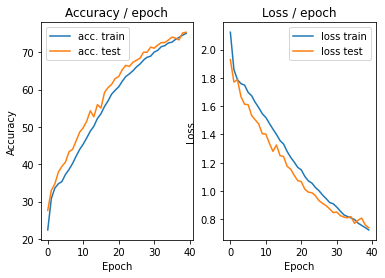

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.6945 (0.6945)	Prec@1  71.9 ( 71.9)	Prec@5 100.0 (100.0)


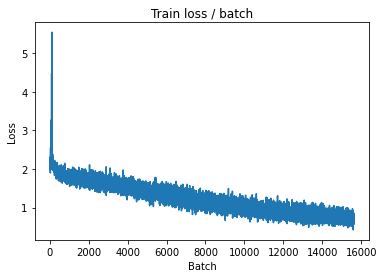

[TRAIN Batch 200/391]	Time 0.083s (0.056s)	Loss 0.7066 (0.7012)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.1)


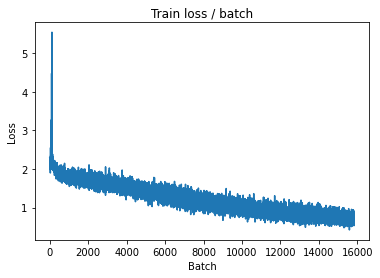


===============> Total time 21s	Avg loss 0.7134	Avg Prec@1 75.61 %	Avg Prec@5 98.10 %

[EVAL Batch 000/079]	Time 0.199s (0.199s)	Loss 0.6180 (0.6180)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7225	Avg Prec@1 76.02 %	Avg Prec@5 98.03 %



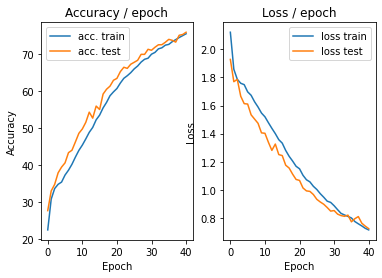

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.7336 (0.7336)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)


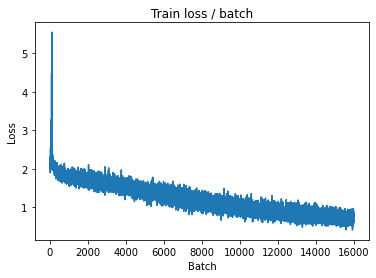

[TRAIN Batch 200/391]	Time 0.077s (0.057s)	Loss 0.7302 (0.7122)	Prec@1  69.5 ( 75.6)	Prec@5 100.0 ( 98.1)


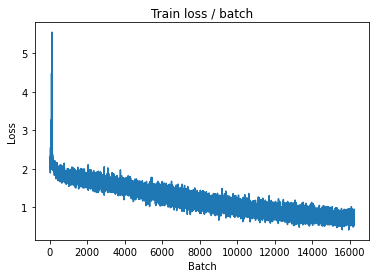


===============> Total time 21s	Avg loss 0.7093	Avg Prec@1 75.59 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.6220 (0.6220)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7165	Avg Prec@1 76.17 %	Avg Prec@5 98.06 %



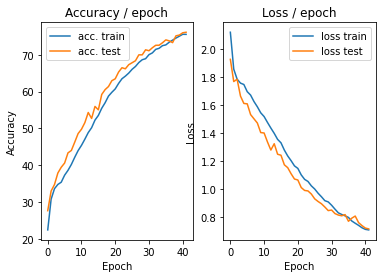

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.5847 (0.5847)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)


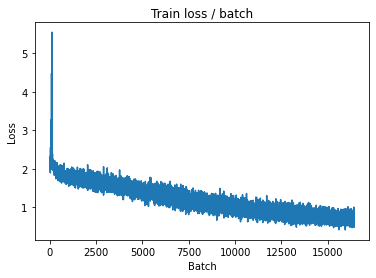

[TRAIN Batch 200/391]	Time 0.019s (0.057s)	Loss 0.8279 (0.6871)	Prec@1  73.4 ( 76.2)	Prec@5  96.9 ( 98.3)


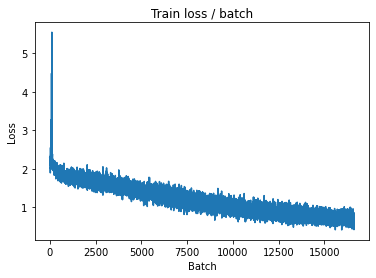


===============> Total time 21s	Avg loss 0.6933	Avg Prec@1 75.94 %	Avg Prec@5 98.25 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.6549 (0.6549)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7388	Avg Prec@1 75.74 %	Avg Prec@5 97.87 %



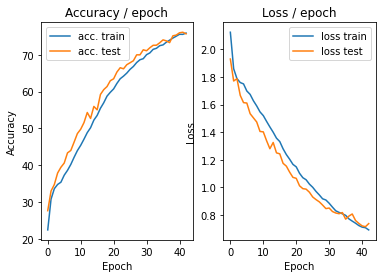

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.256s (0.256s)	Loss 0.5655 (0.5655)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


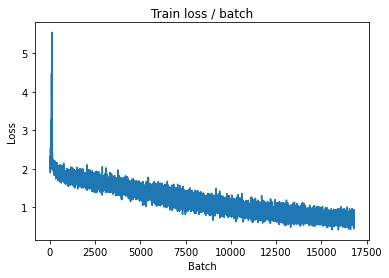

[TRAIN Batch 200/391]	Time 0.033s (0.056s)	Loss 0.5206 (0.6868)	Prec@1  80.5 ( 76.4)	Prec@5  98.4 ( 98.1)


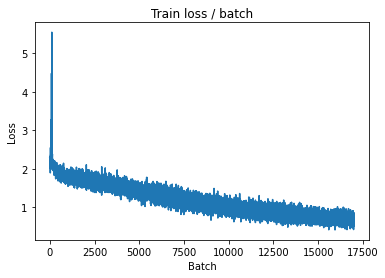


===============> Total time 21s	Avg loss 0.6823	Avg Prec@1 76.62 %	Avg Prec@5 98.23 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.5498 (0.5498)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7203	Avg Prec@1 75.97 %	Avg Prec@5 97.99 %



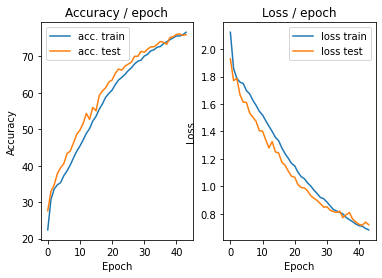

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.5795 (0.5795)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)


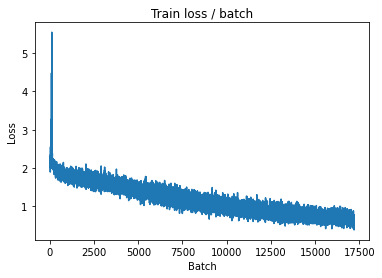

[TRAIN Batch 200/391]	Time 0.082s (0.057s)	Loss 0.6280 (0.6771)	Prec@1  78.1 ( 76.6)	Prec@5  96.9 ( 98.3)


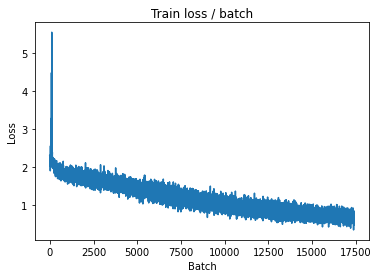


===============> Total time 21s	Avg loss 0.6760	Avg Prec@1 76.61 %	Avg Prec@5 98.31 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 0.6607 (0.6607)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7080	Avg Prec@1 76.74 %	Avg Prec@5 98.04 %



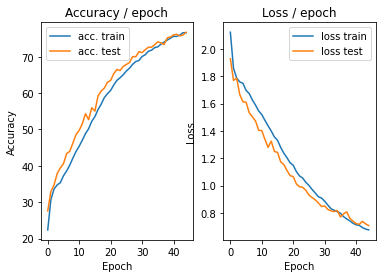

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.260s (0.260s)	Loss 0.5208 (0.5208)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)


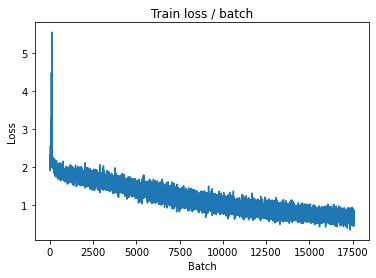

[TRAIN Batch 200/391]	Time 0.052s (0.056s)	Loss 0.8419 (0.6556)	Prec@1  69.5 ( 77.2)	Prec@5  97.7 ( 98.4)


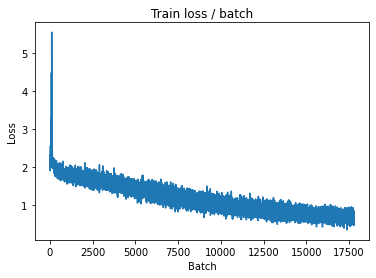


===============> Total time 21s	Avg loss 0.6561	Avg Prec@1 77.24 %	Avg Prec@5 98.44 %

[EVAL Batch 000/079]	Time 0.223s (0.223s)	Loss 0.6196 (0.6196)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6948	Avg Prec@1 77.20 %	Avg Prec@5 98.03 %



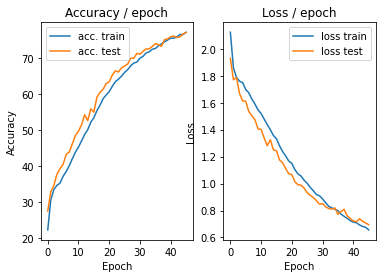

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.259s (0.259s)	Loss 0.5877 (0.5877)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)


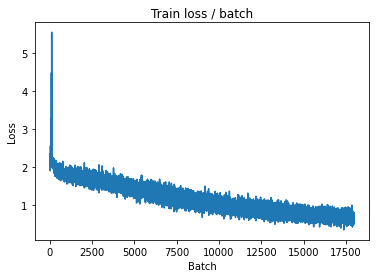

[TRAIN Batch 200/391]	Time 0.027s (0.056s)	Loss 0.6953 (0.6474)	Prec@1  77.3 ( 77.7)	Prec@5  99.2 ( 98.6)


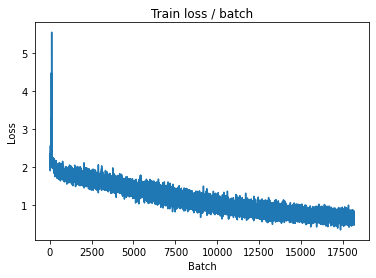


===============> Total time 21s	Avg loss 0.6462	Avg Prec@1 77.77 %	Avg Prec@5 98.57 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.6073 (0.6073)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6918	Avg Prec@1 76.85 %	Avg Prec@5 98.09 %



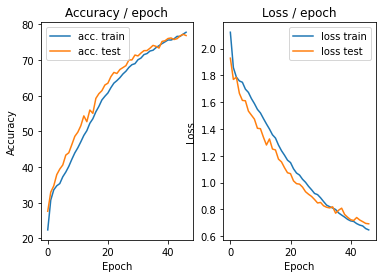

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.259s (0.259s)	Loss 0.7613 (0.7613)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)


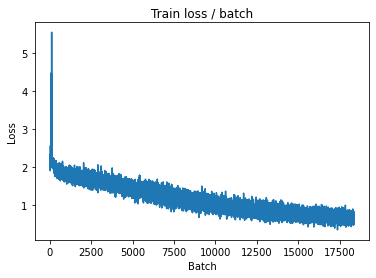

[TRAIN Batch 200/391]	Time 0.077s (0.057s)	Loss 0.5974 (0.6411)	Prec@1  81.2 ( 78.1)	Prec@5  99.2 ( 98.5)


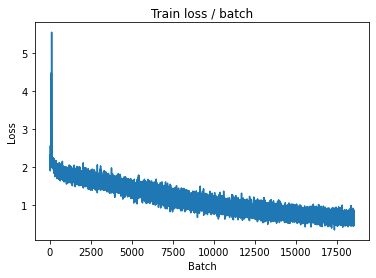


===============> Total time 21s	Avg loss 0.6401	Avg Prec@1 77.88 %	Avg Prec@5 98.57 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.6578 (0.6578)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6844	Avg Prec@1 77.16 %	Avg Prec@5 98.10 %



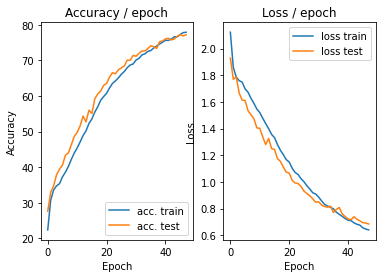

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.6729 (0.6729)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


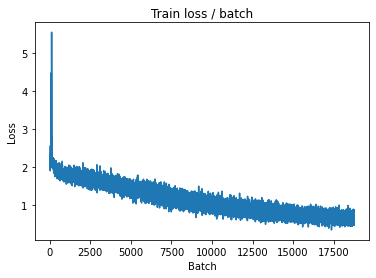

[TRAIN Batch 200/391]	Time 0.034s (0.057s)	Loss 0.5786 (0.6300)	Prec@1  78.9 ( 78.3)	Prec@5 100.0 ( 98.7)


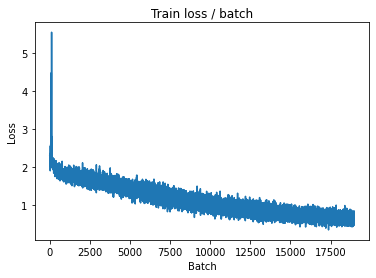


===============> Total time 21s	Avg loss 0.6273	Avg Prec@1 78.37 %	Avg Prec@5 98.64 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 0.5766 (0.5766)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6897	Avg Prec@1 77.22 %	Avg Prec@5 98.17 %



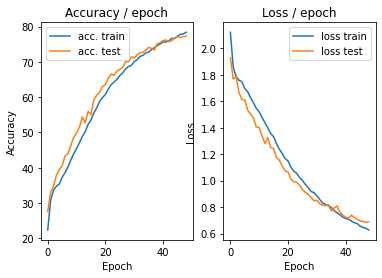

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.5302 (0.5302)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)


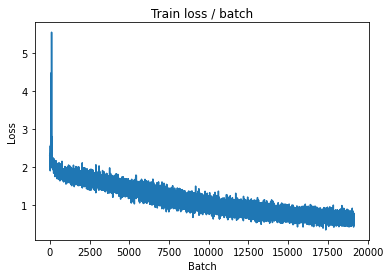

[TRAIN Batch 200/391]	Time 0.018s (0.057s)	Loss 0.5563 (0.6162)	Prec@1  79.7 ( 78.6)	Prec@5  99.2 ( 98.6)


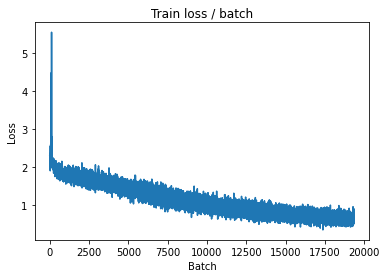


===============> Total time 21s	Avg loss 0.6165	Avg Prec@1 78.70 %	Avg Prec@5 98.67 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.5697 (0.5697)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6815	Avg Prec@1 77.26 %	Avg Prec@5 98.21 %



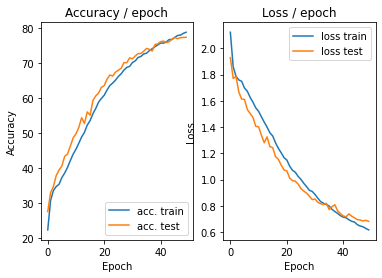

In [ ]:
main(128, 0.1,epochs=50, cuda=True)

##batch normalization :

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.BatchNorm2d(32),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491, 0.482, 0.447], std =[0.202, 0.199, 0.201]),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.9)
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

        lr_sched.step()

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.226s (0.226s)	Loss 2.3649 (2.3649)	Prec@1  14.1 ( 14.1)	Prec@5  45.3 ( 45.3)


<Figure size 432x288 with 0 Axes>

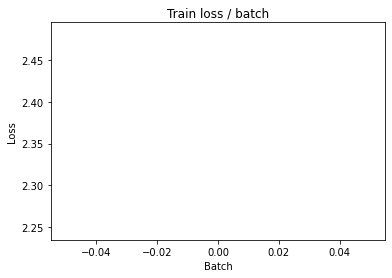

[TRAIN Batch 200/391]	Time 0.092s (0.053s)	Loss 1.4681 (1.7874)	Prec@1  43.8 ( 35.9)	Prec@5  94.5 ( 86.5)


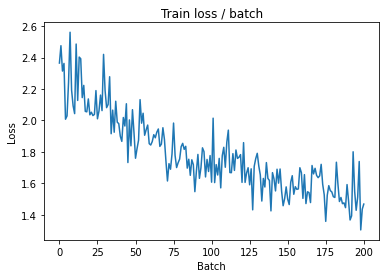


===============> Total time 20s	Avg loss 1.6140	Avg Prec@1 42.16 %	Avg Prec@5 89.58 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 1.2216 (1.2216)	Prec@1  63.3 ( 63.3)	Prec@5  90.6 ( 90.6)

===============> Total time 3s	Avg loss 1.2881	Avg Prec@1 54.21 %	Avg Prec@5 94.50 %



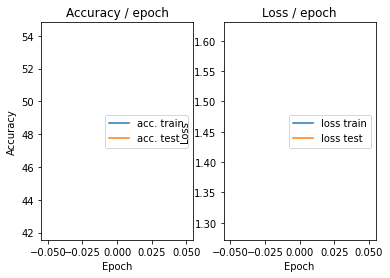

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 1.6116 (1.6116)	Prec@1  47.7 ( 47.7)	Prec@5  89.8 ( 89.8)


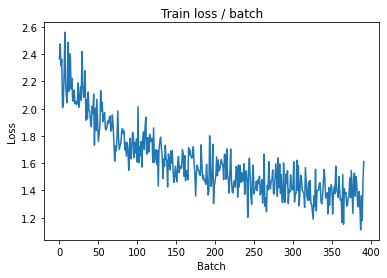

[TRAIN Batch 200/391]	Time 0.025s (0.054s)	Loss 1.1842 (1.2653)	Prec@1  59.4 ( 55.6)	Prec@5  97.7 ( 94.5)


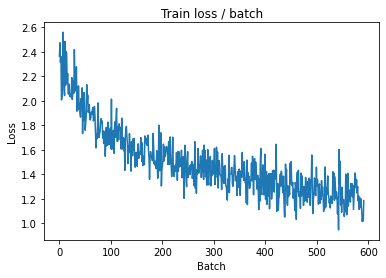


===============> Total time 20s	Avg loss 1.2048	Avg Prec@1 57.41 %	Avg Prec@5 95.08 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 0.8757 (0.8757)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.9693	Avg Prec@1 65.91 %	Avg Prec@5 96.97 %



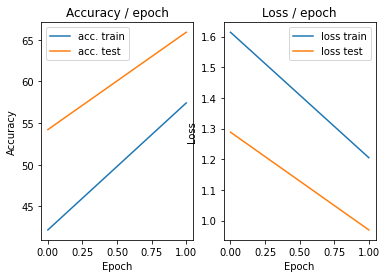

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 1.0606 (1.0606)	Prec@1  60.2 ( 60.2)	Prec@5  96.1 ( 96.1)


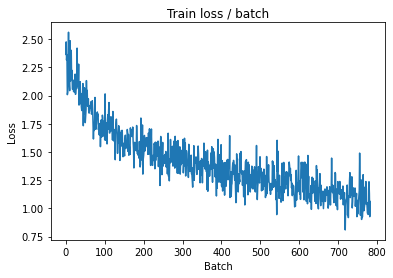

[TRAIN Batch 200/391]	Time 0.020s (0.054s)	Loss 1.0851 (1.0558)	Prec@1  57.0 ( 63.1)	Prec@5  97.7 ( 96.4)


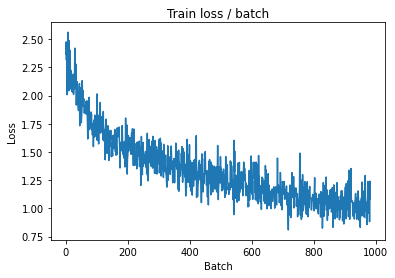


===============> Total time 21s	Avg loss 1.0293	Avg Prec@1 64.21 %	Avg Prec@5 96.53 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 0.8282 (0.8282)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8986	Avg Prec@1 68.99 %	Avg Prec@5 97.11 %



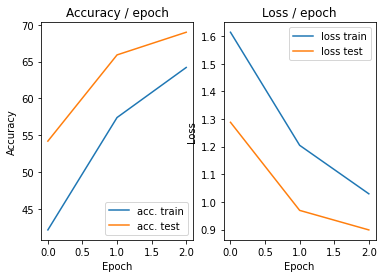

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.9086 (0.9086)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)


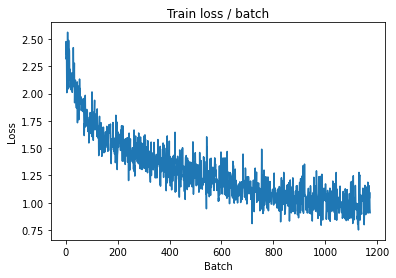

[TRAIN Batch 200/391]	Time 0.087s (0.056s)	Loss 0.9907 (0.9385)	Prec@1  67.2 ( 67.4)	Prec@5  93.0 ( 96.9)


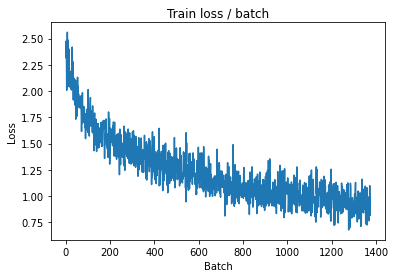


===============> Total time 21s	Avg loss 0.9306	Avg Prec@1 67.91 %	Avg Prec@5 96.99 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.7305 (0.7305)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7715	Avg Prec@1 72.90 %	Avg Prec@5 98.10 %



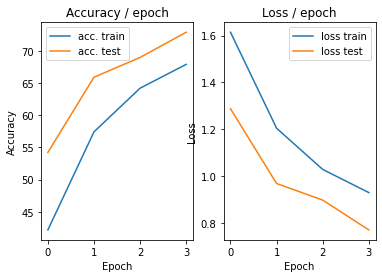

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 0.8869 (0.8869)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)


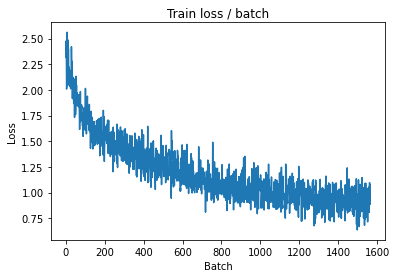

[TRAIN Batch 200/391]	Time 0.087s (0.055s)	Loss 0.7911 (0.8528)	Prec@1  71.9 ( 70.4)	Prec@5  96.9 ( 97.4)


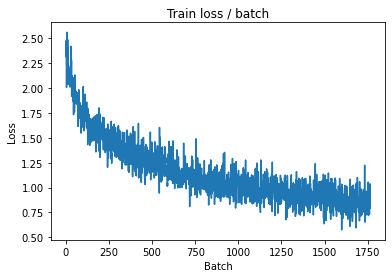


===============> Total time 21s	Avg loss 0.8550	Avg Prec@1 70.50 %	Avg Prec@5 97.38 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.7740 (0.7740)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8130	Avg Prec@1 71.82 %	Avg Prec@5 97.93 %



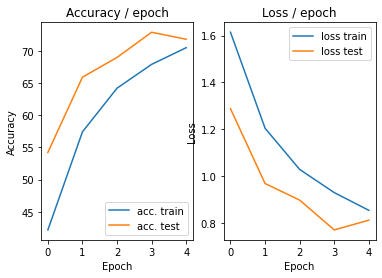

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.218s (0.218s)	Loss 0.7669 (0.7669)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)


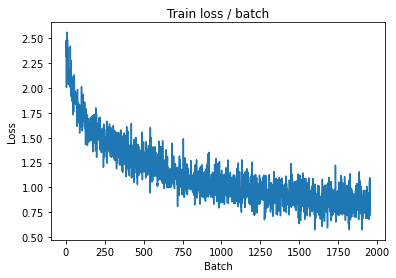

[TRAIN Batch 200/391]	Time 0.072s (0.055s)	Loss 0.8397 (0.8010)	Prec@1  71.9 ( 72.2)	Prec@5  96.9 ( 98.1)


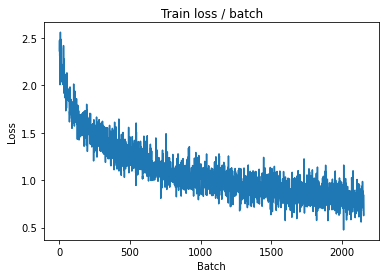


===============> Total time 21s	Avg loss 0.7943	Avg Prec@1 72.65 %	Avg Prec@5 97.97 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.7138 (0.7138)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8461	Avg Prec@1 71.37 %	Avg Prec@5 97.75 %



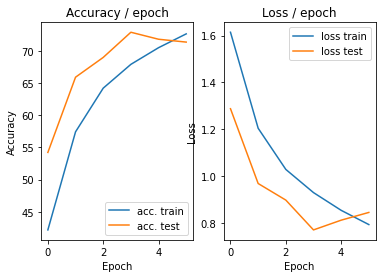

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 0.7559 (0.7559)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)


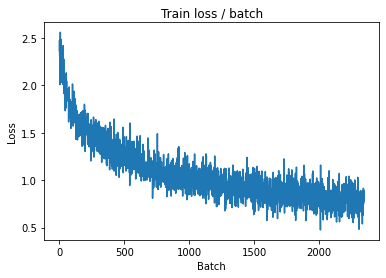

[TRAIN Batch 200/391]	Time 0.068s (0.055s)	Loss 0.6944 (0.7465)	Prec@1  73.4 ( 74.4)	Prec@5  97.7 ( 98.2)


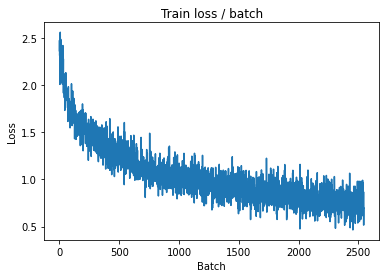


===============> Total time 21s	Avg loss 0.7537	Avg Prec@1 74.32 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.6263 (0.6263)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6879	Avg Prec@1 76.79 %	Avg Prec@5 98.57 %



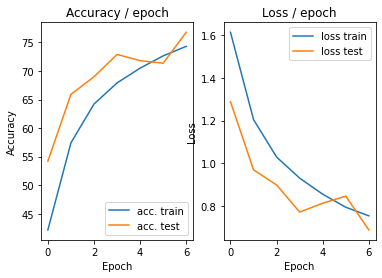

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.6345 (0.6345)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


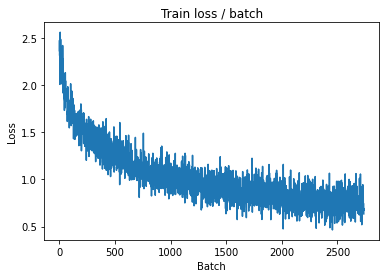

[TRAIN Batch 200/391]	Time 0.027s (0.055s)	Loss 0.8305 (0.7036)	Prec@1  72.7 ( 75.8)	Prec@5  99.2 ( 98.3)


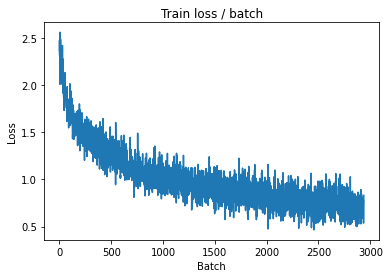


===============> Total time 21s	Avg loss 0.7022	Avg Prec@1 75.88 %	Avg Prec@5 98.31 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.5992 (0.5992)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7103	Avg Prec@1 75.45 %	Avg Prec@5 98.43 %



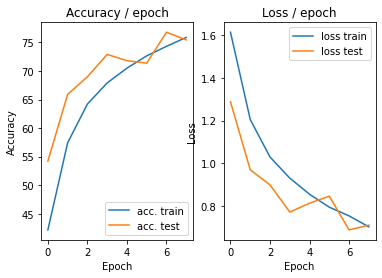

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.246s (0.246s)	Loss 0.7131 (0.7131)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)


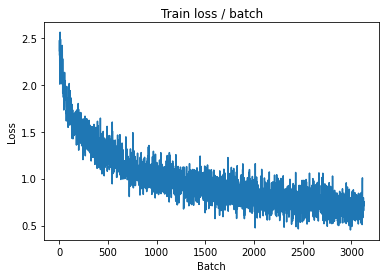

[TRAIN Batch 200/391]	Time 0.031s (0.055s)	Loss 0.5471 (0.6687)	Prec@1  78.9 ( 76.9)	Prec@5  98.4 ( 98.6)


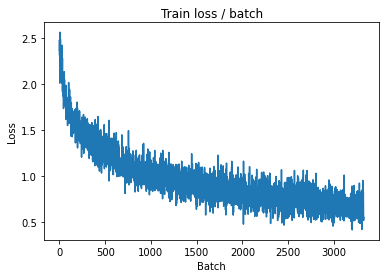


===============> Total time 21s	Avg loss 0.6745	Avg Prec@1 76.86 %	Avg Prec@5 98.59 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.6082 (0.6082)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6788	Avg Prec@1 76.33 %	Avg Prec@5 98.50 %



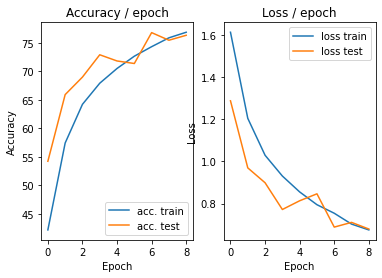

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.232s (0.232s)	Loss 0.8443 (0.8443)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 99.2)


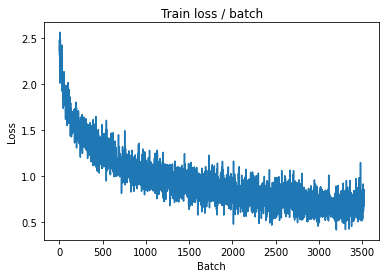

[TRAIN Batch 200/391]	Time 0.096s (0.056s)	Loss 0.5574 (0.6404)	Prec@1  78.1 ( 77.9)	Prec@5  98.4 ( 98.7)


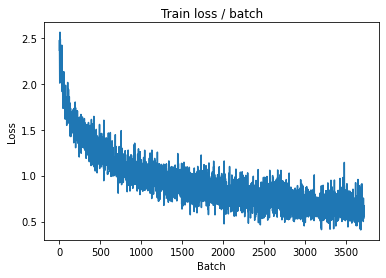


===============> Total time 21s	Avg loss 0.6444	Avg Prec@1 77.71 %	Avg Prec@5 98.61 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 0.4997 (0.4997)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6163	Avg Prec@1 79.00 %	Avg Prec@5 98.86 %



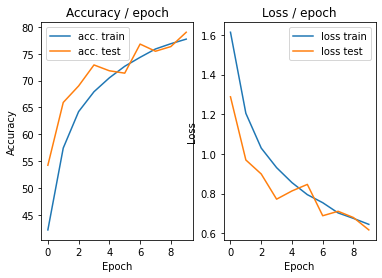

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.4722 (0.4722)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


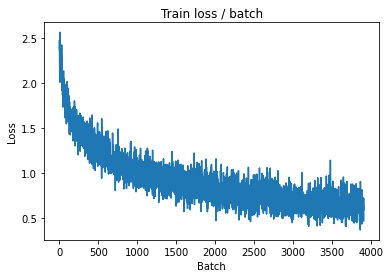

[TRAIN Batch 200/391]	Time 0.059s (0.056s)	Loss 0.6902 (0.6205)	Prec@1  79.7 ( 78.8)	Prec@5  98.4 ( 98.7)


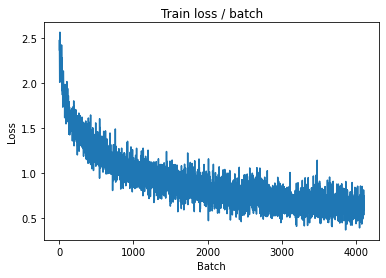


===============> Total time 21s	Avg loss 0.6179	Avg Prec@1 78.68 %	Avg Prec@5 98.70 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 0.5274 (0.5274)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5980	Avg Prec@1 79.70 %	Avg Prec@5 98.78 %



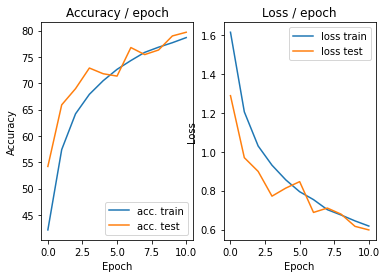

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.4351 (0.4351)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


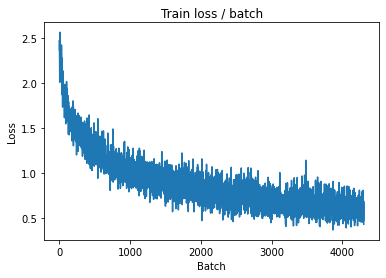

[TRAIN Batch 200/391]	Time 0.018s (0.056s)	Loss 0.6174 (0.5892)	Prec@1  78.1 ( 79.8)	Prec@5  98.4 ( 98.9)


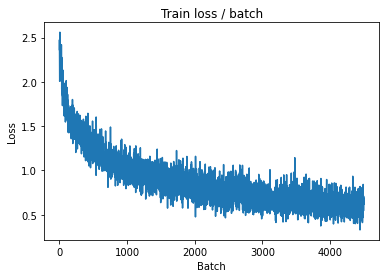


===============> Total time 21s	Avg loss 0.5944	Avg Prec@1 79.64 %	Avg Prec@5 98.81 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.5287 (0.5287)	Prec@1  85.9 ( 85.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.5788	Avg Prec@1 80.73 %	Avg Prec@5 98.93 %



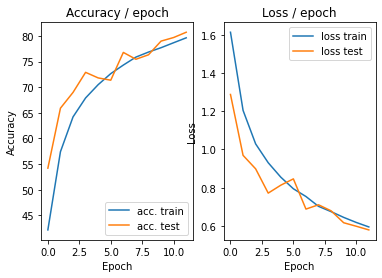

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.6483 (0.6483)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)


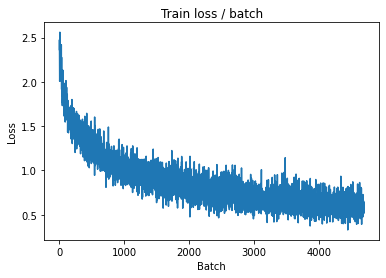

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 0.4292 (0.5559)	Prec@1  85.9 ( 80.8)	Prec@5 100.0 ( 99.0)


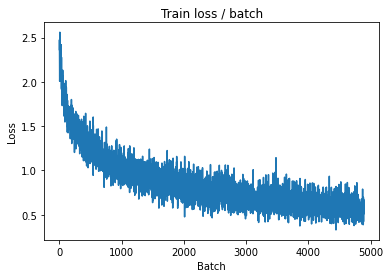


===============> Total time 21s	Avg loss 0.5596	Avg Prec@1 80.64 %	Avg Prec@5 98.96 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.5373 (0.5373)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5783	Avg Prec@1 80.53 %	Avg Prec@5 98.96 %



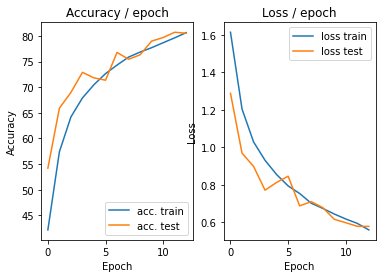

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.4184 (0.4184)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


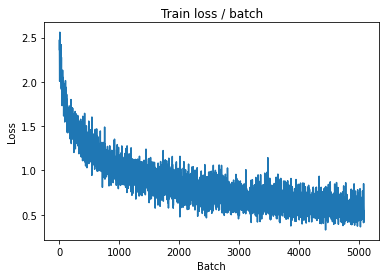

[TRAIN Batch 200/391]	Time 0.035s (0.055s)	Loss 0.4139 (0.5386)	Prec@1  85.9 ( 81.6)	Prec@5 100.0 ( 99.1)


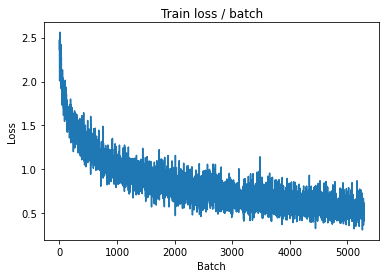


===============> Total time 21s	Avg loss 0.5425	Avg Prec@1 81.39 %	Avg Prec@5 99.02 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 0.4223 (0.4223)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5645	Avg Prec@1 81.15 %	Avg Prec@5 99.06 %



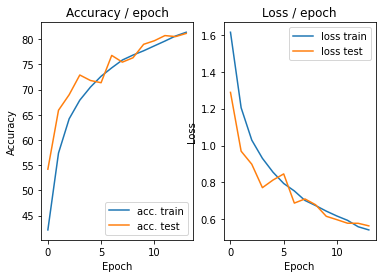

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 0.3543 (0.3543)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


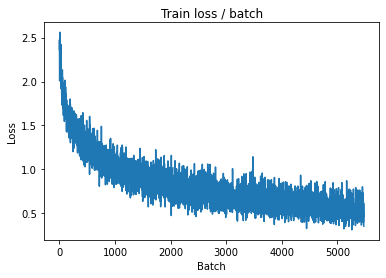

[TRAIN Batch 200/391]	Time 0.028s (0.056s)	Loss 0.6407 (0.5241)	Prec@1  78.9 ( 81.8)	Prec@5  99.2 ( 99.0)


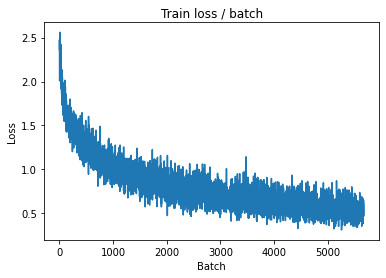


===============> Total time 21s	Avg loss 0.5247	Avg Prec@1 81.79 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.4795 (0.4795)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5508	Avg Prec@1 81.54 %	Avg Prec@5 99.00 %



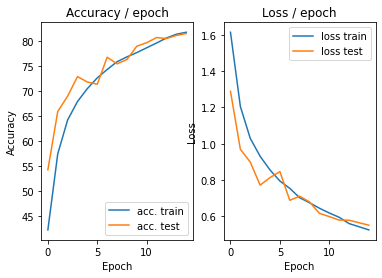

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.4275 (0.4275)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


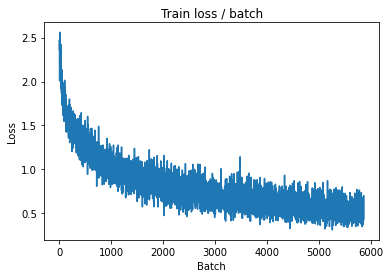

[TRAIN Batch 200/391]	Time 0.033s (0.056s)	Loss 0.5345 (0.4987)	Prec@1  82.0 ( 83.0)	Prec@5  99.2 ( 99.2)


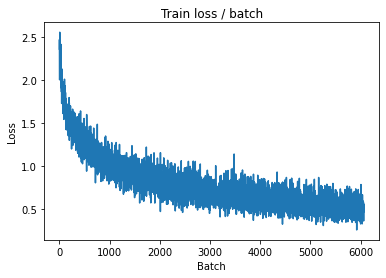


===============> Total time 21s	Avg loss 0.5053	Avg Prec@1 82.65 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 0.4031 (0.4031)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5290	Avg Prec@1 82.14 %	Avg Prec@5 99.25 %



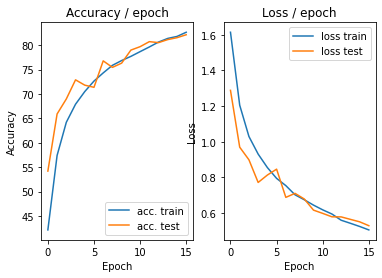

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.268s (0.268s)	Loss 0.5110 (0.5110)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)


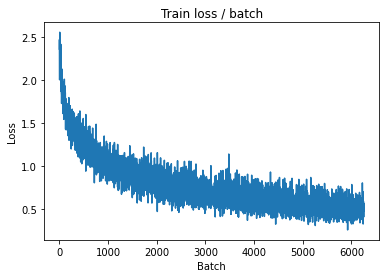

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 0.4326 (0.4840)	Prec@1  85.9 ( 83.1)	Prec@5  98.4 ( 99.3)


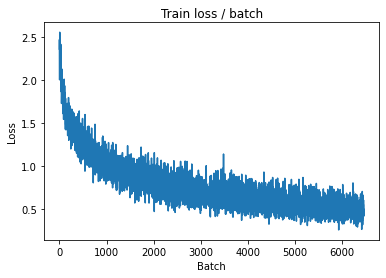


===============> Total time 21s	Avg loss 0.4896	Avg Prec@1 83.08 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.4558 (0.4558)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5473	Avg Prec@1 81.52 %	Avg Prec@5 99.11 %



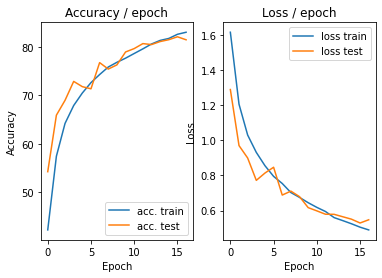

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.4074 (0.4074)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


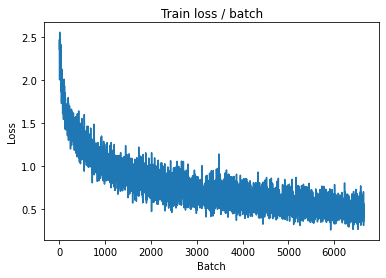

[TRAIN Batch 200/391]	Time 0.090s (0.056s)	Loss 0.5490 (0.4748)	Prec@1  81.2 ( 83.3)	Prec@5 100.0 ( 99.3)


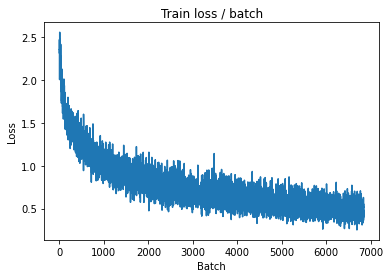


===============> Total time 21s	Avg loss 0.4729	Avg Prec@1 83.40 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 0.3976 (0.3976)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5729	Avg Prec@1 81.85 %	Avg Prec@5 99.22 %



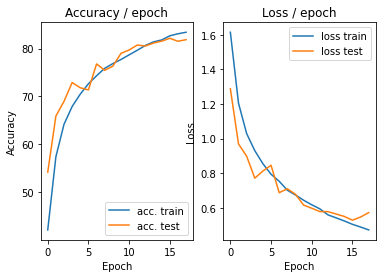

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.250s (0.250s)	Loss 0.3944 (0.3944)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


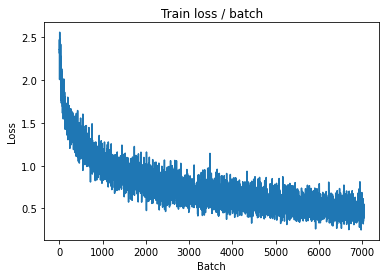

[TRAIN Batch 200/391]	Time 0.069s (0.056s)	Loss 0.4058 (0.4459)	Prec@1  87.5 ( 84.4)	Prec@5  99.2 ( 99.4)


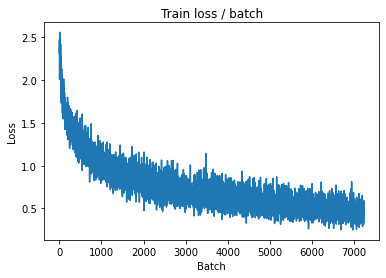


===============> Total time 21s	Avg loss 0.4518	Avg Prec@1 84.35 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.4564 (0.4564)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5443	Avg Prec@1 82.67 %	Avg Prec@5 99.17 %



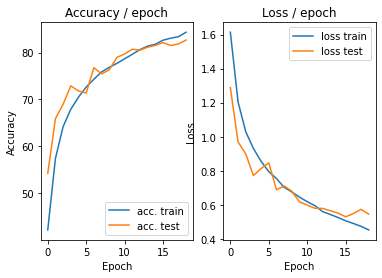

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.5787 (0.5787)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


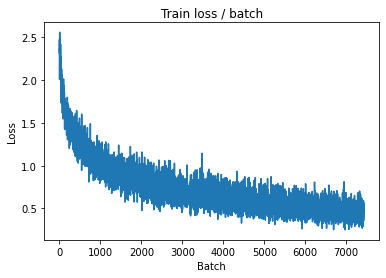

[TRAIN Batch 200/391]	Time 0.027s (0.056s)	Loss 0.4903 (0.4351)	Prec@1  78.9 ( 84.7)	Prec@5 100.0 ( 99.5)


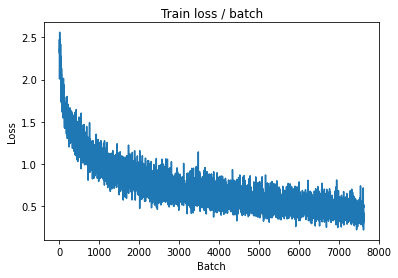


===============> Total time 21s	Avg loss 0.4372	Avg Prec@1 84.70 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 0.4307 (0.4307)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5280	Avg Prec@1 82.45 %	Avg Prec@5 99.16 %



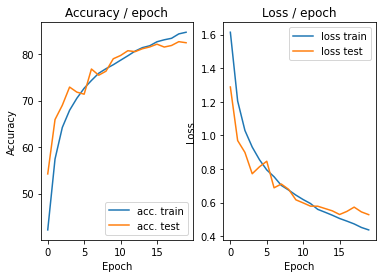

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.4019 (0.4019)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


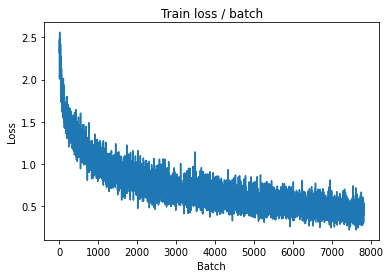

[TRAIN Batch 200/391]	Time 0.063s (0.056s)	Loss 0.3664 (0.4149)	Prec@1  82.0 ( 85.5)	Prec@5  99.2 ( 99.5)


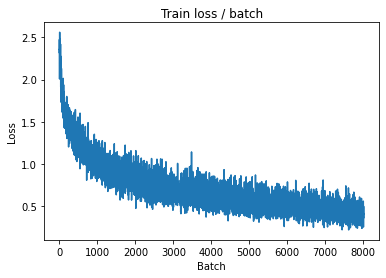


===============> Total time 21s	Avg loss 0.4281	Avg Prec@1 85.21 %	Avg Prec@5 99.49 %

[EVAL Batch 000/079]	Time 0.204s (0.204s)	Loss 0.3888 (0.3888)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5268	Avg Prec@1 83.01 %	Avg Prec@5 99.21 %



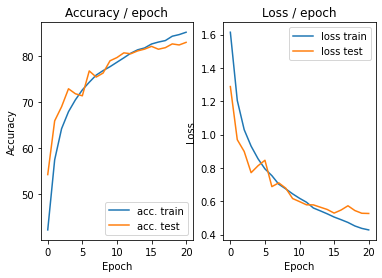

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.278s (0.278s)	Loss 0.4688 (0.4688)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)


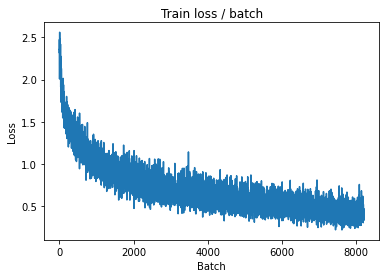

[TRAIN Batch 200/391]	Time 0.085s (0.056s)	Loss 0.4991 (0.4132)	Prec@1  80.5 ( 85.5)	Prec@5  97.7 ( 99.5)


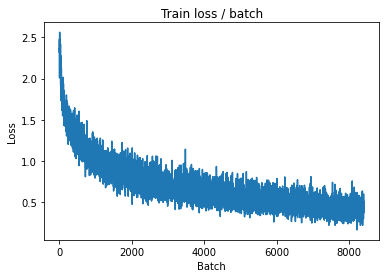


===============> Total time 21s	Avg loss 0.4122	Avg Prec@1 85.49 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.191s (0.191s)	Loss 0.3785 (0.3785)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5087	Avg Prec@1 82.93 %	Avg Prec@5 99.19 %



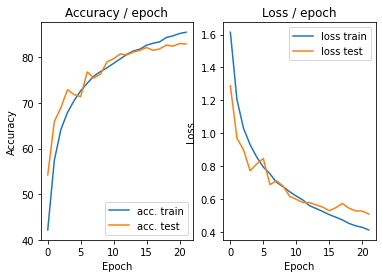

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.3591 (0.3591)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


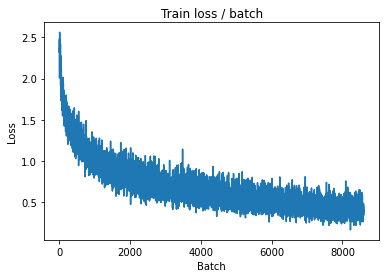

[TRAIN Batch 200/391]	Time 0.025s (0.057s)	Loss 0.3556 (0.3957)	Prec@1  86.7 ( 86.2)	Prec@5 100.0 ( 99.5)


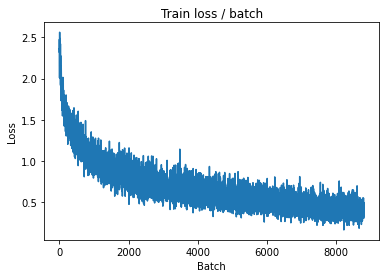


===============> Total time 21s	Avg loss 0.3979	Avg Prec@1 86.12 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.4159 (0.4159)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4984	Avg Prec@1 82.98 %	Avg Prec@5 99.29 %



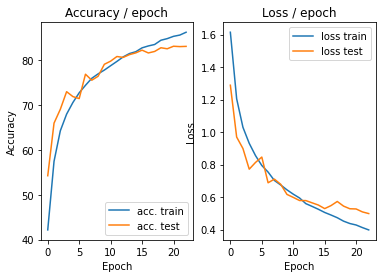

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.3738 (0.3738)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


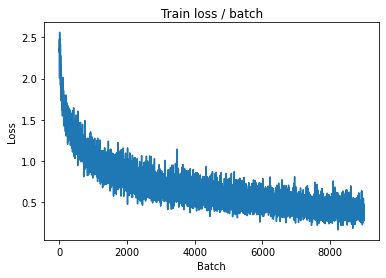

[TRAIN Batch 200/391]	Time 0.028s (0.056s)	Loss 0.4352 (0.3849)	Prec@1  83.6 ( 86.3)	Prec@5 100.0 ( 99.5)


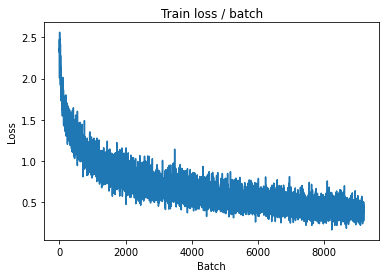


===============> Total time 21s	Avg loss 0.3890	Avg Prec@1 86.31 %	Avg Prec@5 99.55 %

[EVAL Batch 000/079]	Time 0.203s (0.203s)	Loss 0.4012 (0.4012)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4916	Avg Prec@1 83.52 %	Avg Prec@5 99.28 %



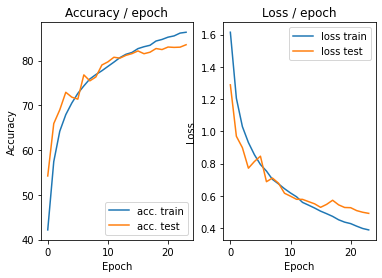

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.260s (0.260s)	Loss 0.3207 (0.3207)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)


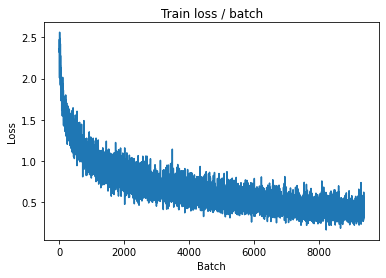

[TRAIN Batch 200/391]	Time 0.027s (0.056s)	Loss 0.2570 (0.3722)	Prec@1  92.2 ( 87.1)	Prec@5 100.0 ( 99.6)


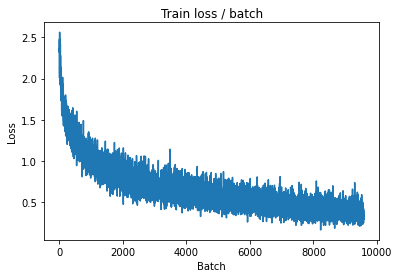


===============> Total time 21s	Avg loss 0.3722	Avg Prec@1 87.07 %	Avg Prec@5 99.59 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 0.3572 (0.3572)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4851	Avg Prec@1 83.63 %	Avg Prec@5 99.36 %



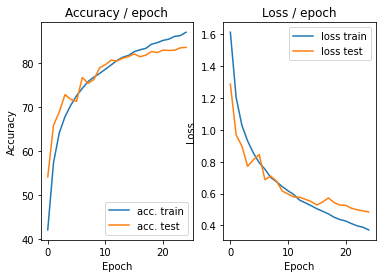

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.275s (0.275s)	Loss 0.2359 (0.2359)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


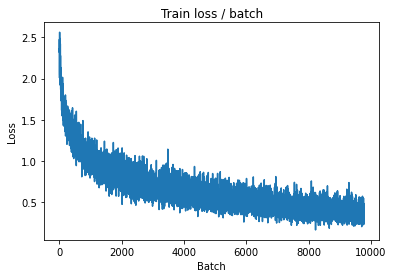

[TRAIN Batch 200/391]	Time 0.082s (0.057s)	Loss 0.4193 (0.3596)	Prec@1  85.2 ( 87.4)	Prec@5 100.0 ( 99.6)


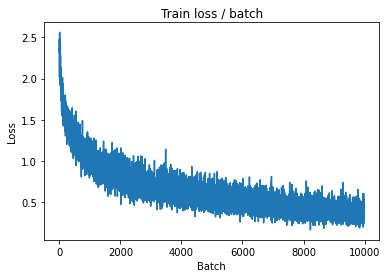


===============> Total time 21s	Avg loss 0.3622	Avg Prec@1 87.32 %	Avg Prec@5 99.56 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 0.4032 (0.4032)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5038	Avg Prec@1 83.88 %	Avg Prec@5 99.13 %



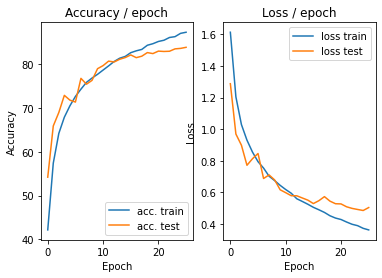

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 0.3306 (0.3306)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


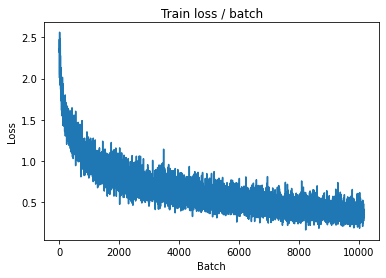

[TRAIN Batch 200/391]	Time 0.072s (0.058s)	Loss 0.4774 (0.3487)	Prec@1  84.4 ( 87.6)	Prec@5  99.2 ( 99.7)


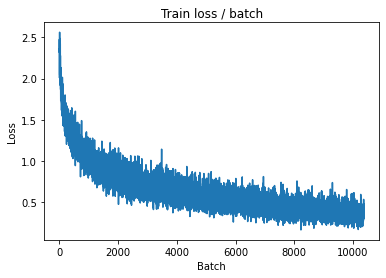


===============> Total time 21s	Avg loss 0.3557	Avg Prec@1 87.41 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 0.3987 (0.3987)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5038	Avg Prec@1 83.78 %	Avg Prec@5 99.28 %



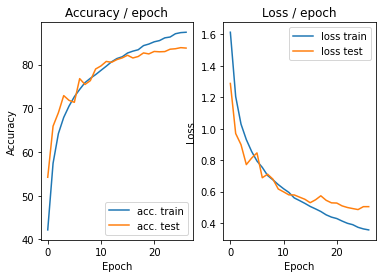

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.2645 (0.2645)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


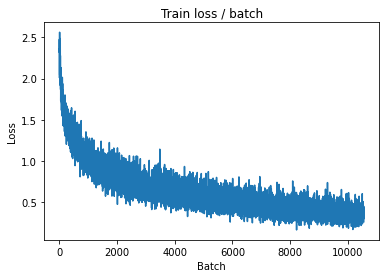

[TRAIN Batch 200/391]	Time 0.089s (0.056s)	Loss 0.2557 (0.3476)	Prec@1  92.2 ( 87.7)	Prec@5 100.0 ( 99.7)


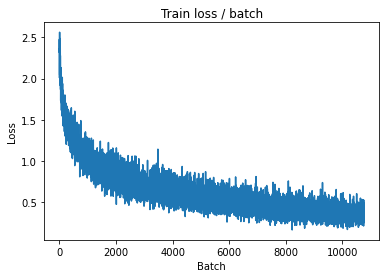


===============> Total time 21s	Avg loss 0.3504	Avg Prec@1 87.67 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.3255 (0.3255)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.4940	Avg Prec@1 84.00 %	Avg Prec@5 99.21 %



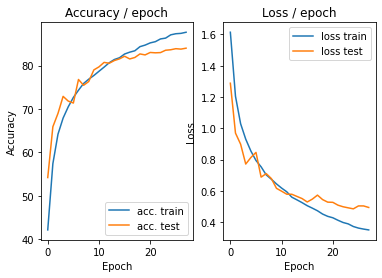

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.3705 (0.3705)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


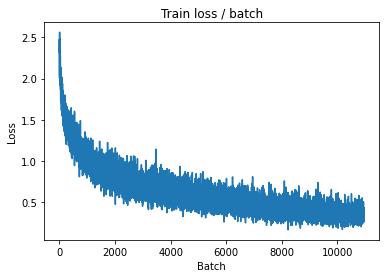

[TRAIN Batch 200/391]	Time 0.019s (0.057s)	Loss 0.3244 (0.3279)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 ( 99.7)


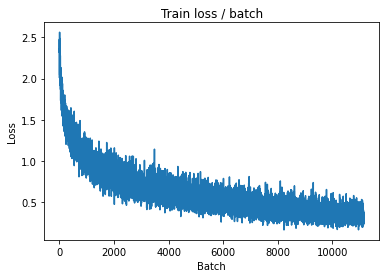


===============> Total time 21s	Avg loss 0.3312	Avg Prec@1 88.22 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.209s (0.209s)	Loss 0.4171 (0.4171)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)

===============> Total time 3s	Avg loss 0.4909	Avg Prec@1 84.06 %	Avg Prec@5 99.33 %



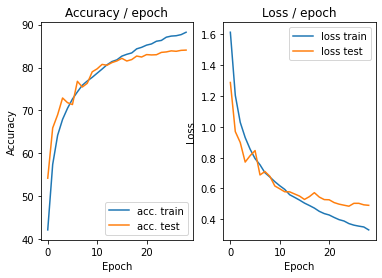

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.2909 (0.2909)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


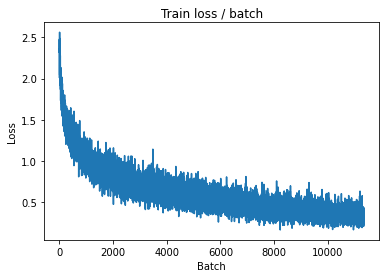

[TRAIN Batch 200/391]	Time 0.040s (0.056s)	Loss 0.3023 (0.3269)	Prec@1  93.0 ( 88.4)	Prec@5  99.2 ( 99.7)


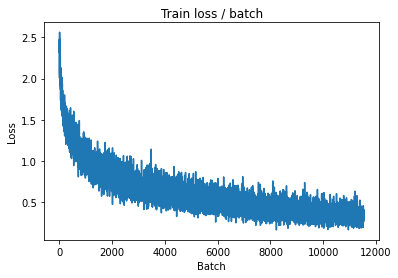


===============> Total time 21s	Avg loss 0.3243	Avg Prec@1 88.44 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.4266 (0.4266)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.4914	Avg Prec@1 83.92 %	Avg Prec@5 99.30 %



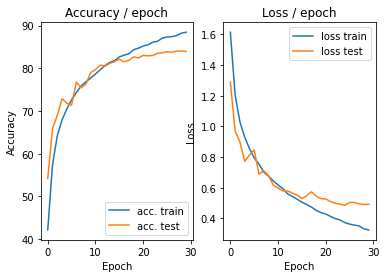

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.238s (0.238s)	Loss 0.2317 (0.2317)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


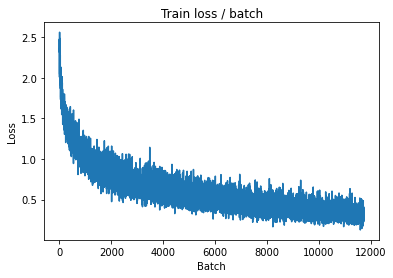

[TRAIN Batch 200/391]	Time 0.073s (0.057s)	Loss 0.2735 (0.3158)	Prec@1  89.8 ( 88.9)	Prec@5 100.0 ( 99.8)


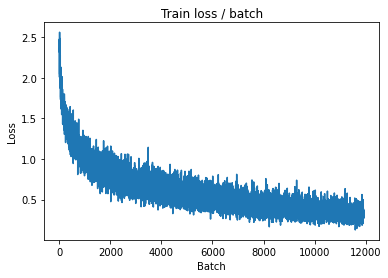


===============> Total time 21s	Avg loss 0.3193	Avg Prec@1 88.70 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.4570 (0.4570)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.4911	Avg Prec@1 84.40 %	Avg Prec@5 99.32 %



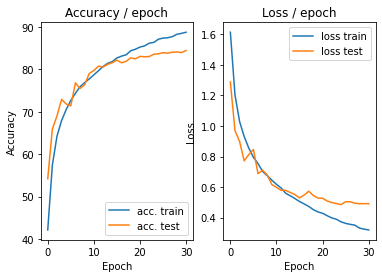

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 0.2619 (0.2619)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


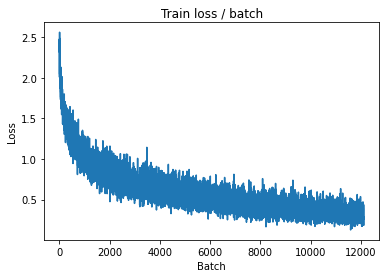

[TRAIN Batch 200/391]	Time 0.023s (0.056s)	Loss 0.4095 (0.3007)	Prec@1  84.4 ( 89.3)	Prec@5  98.4 ( 99.8)


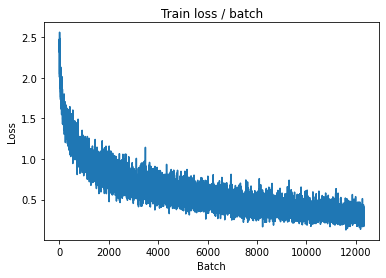


===============> Total time 21s	Avg loss 0.3059	Avg Prec@1 89.17 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 0.3981 (0.3981)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4961	Avg Prec@1 84.28 %	Avg Prec@5 99.29 %



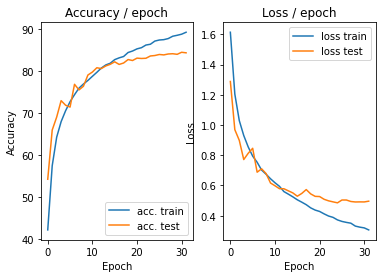

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.2011 (0.2011)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


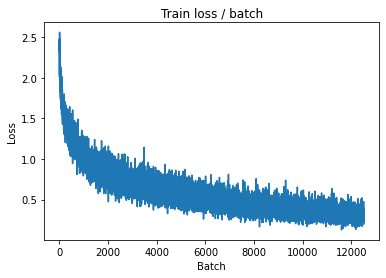

[TRAIN Batch 200/391]	Time 0.088s (0.056s)	Loss 0.3615 (0.2961)	Prec@1  89.1 ( 89.5)	Prec@5  99.2 ( 99.8)


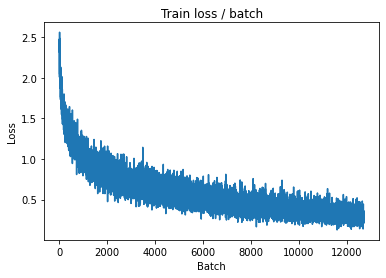


===============> Total time 21s	Avg loss 0.3002	Avg Prec@1 89.42 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.213s (0.213s)	Loss 0.4043 (0.4043)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4879	Avg Prec@1 84.51 %	Avg Prec@5 99.33 %



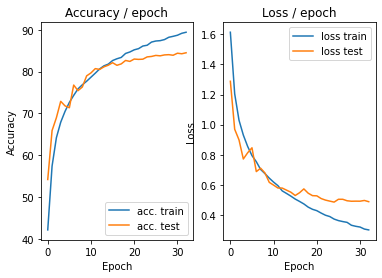

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.3029 (0.3029)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


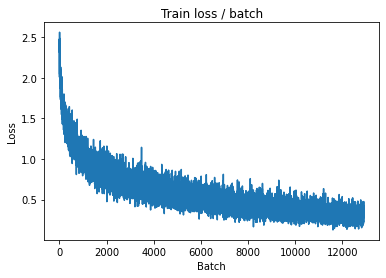

[TRAIN Batch 200/391]	Time 0.041s (0.056s)	Loss 0.2792 (0.2992)	Prec@1  90.6 ( 89.4)	Prec@5  99.2 ( 99.7)


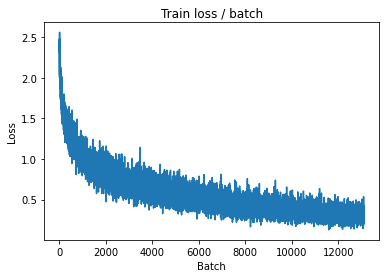


===============> Total time 21s	Avg loss 0.2977	Avg Prec@1 89.52 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.3956 (0.3956)	Prec@1  89.8 ( 89.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5090	Avg Prec@1 84.60 %	Avg Prec@5 99.22 %



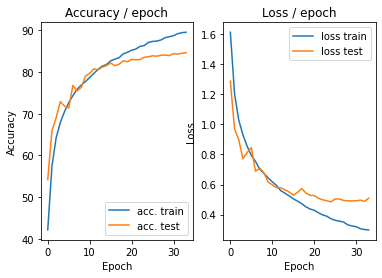

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.264s (0.264s)	Loss 0.2890 (0.2890)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


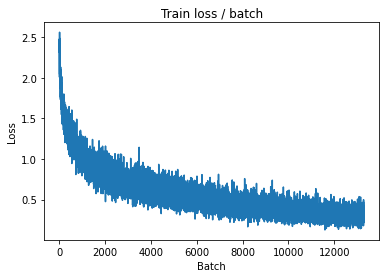

[TRAIN Batch 200/391]	Time 0.079s (0.057s)	Loss 0.3920 (0.2738)	Prec@1  86.7 ( 90.5)	Prec@5 100.0 ( 99.8)


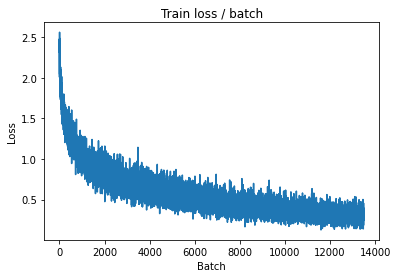


===============> Total time 21s	Avg loss 0.2798	Avg Prec@1 90.22 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.3933 (0.3933)	Prec@1  89.8 ( 89.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4983	Avg Prec@1 84.71 %	Avg Prec@5 99.30 %



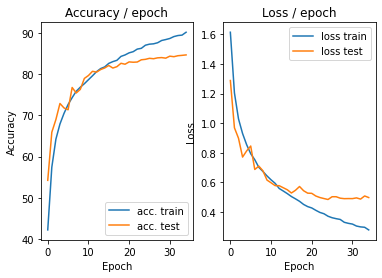

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.1691 (0.1691)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


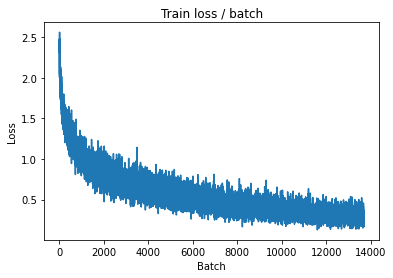

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 0.3223 (0.2741)	Prec@1  89.8 ( 90.3)	Prec@5  97.7 ( 99.8)


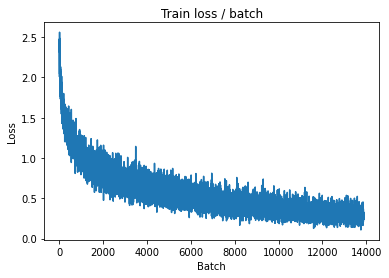


===============> Total time 21s	Avg loss 0.2769	Avg Prec@1 90.15 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.4044 (0.4044)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4867	Avg Prec@1 84.62 %	Avg Prec@5 99.33 %



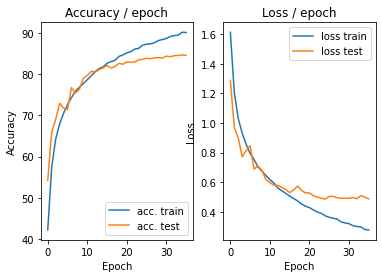

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.2685 (0.2685)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


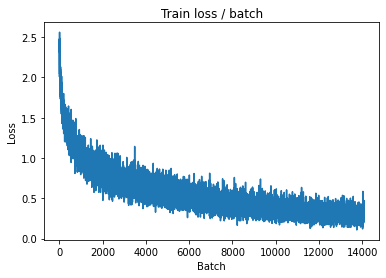

[TRAIN Batch 200/391]	Time 0.066s (0.056s)	Loss 0.2676 (0.2718)	Prec@1  91.4 ( 90.4)	Prec@5 100.0 ( 99.8)


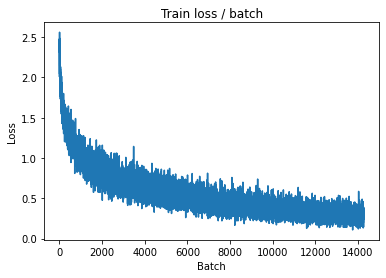


===============> Total time 21s	Avg loss 0.2731	Avg Prec@1 90.28 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.4103 (0.4103)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.4829	Avg Prec@1 85.14 %	Avg Prec@5 99.34 %



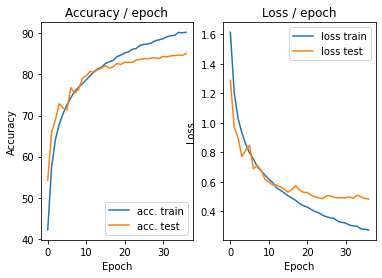

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.260s (0.260s)	Loss 0.1853 (0.1853)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


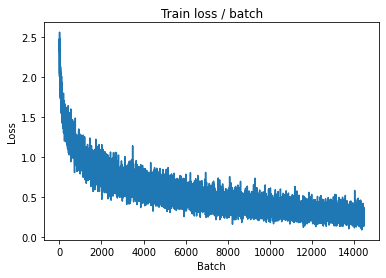

[TRAIN Batch 200/391]	Time 0.084s (0.056s)	Loss 0.2016 (0.2603)	Prec@1  90.6 ( 90.9)	Prec@5 100.0 ( 99.8)


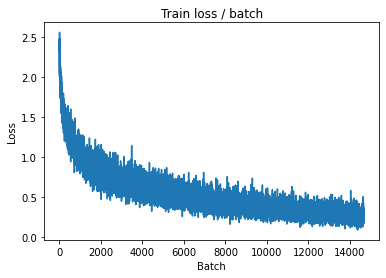


===============> Total time 21s	Avg loss 0.2647	Avg Prec@1 90.69 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 0.3889 (0.3889)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.4918	Avg Prec@1 84.68 %	Avg Prec@5 99.39 %



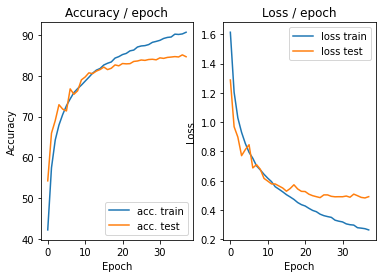

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.2075 (0.2075)	Prec@1  92.2 ( 92.2)	Prec@5  99.2 ( 99.2)


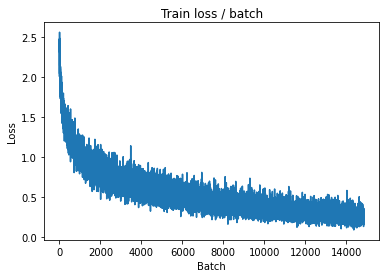

[TRAIN Batch 200/391]	Time 0.031s (0.057s)	Loss 0.2201 (0.2582)	Prec@1  91.4 ( 90.8)	Prec@5  99.2 ( 99.8)


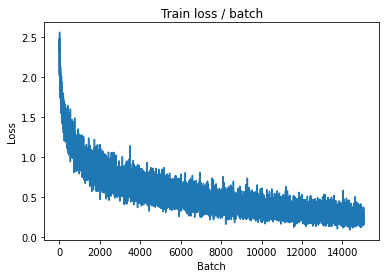


===============> Total time 21s	Avg loss 0.2668	Avg Prec@1 90.58 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.201s (0.201s)	Loss 0.4222 (0.4222)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.4826	Avg Prec@1 85.22 %	Avg Prec@5 99.37 %



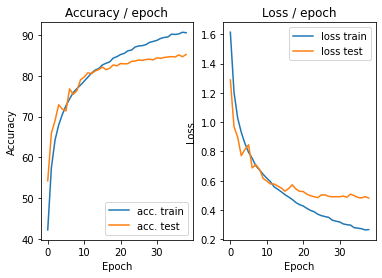

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.1989 (0.1989)	Prec@1  92.2 ( 92.2)	Prec@5  99.2 ( 99.2)


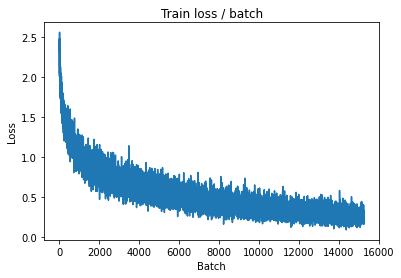

[TRAIN Batch 200/391]	Time 0.040s (0.057s)	Loss 0.3000 (0.2591)	Prec@1  87.5 ( 90.8)	Prec@5 100.0 ( 99.8)


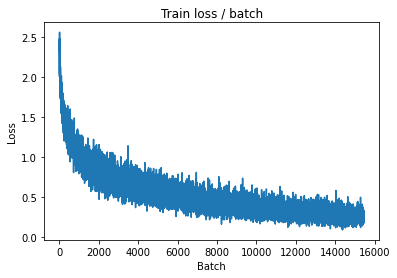


===============> Total time 21s	Avg loss 0.2572	Avg Prec@1 90.83 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.4003 (0.4003)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)

===============> Total time 3s	Avg loss 0.4802	Avg Prec@1 85.13 %	Avg Prec@5 99.43 %



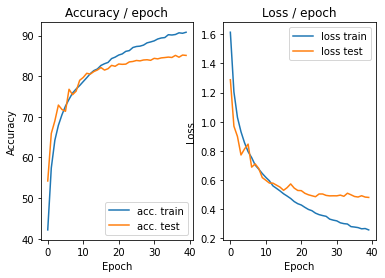

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.2588 (0.2588)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)


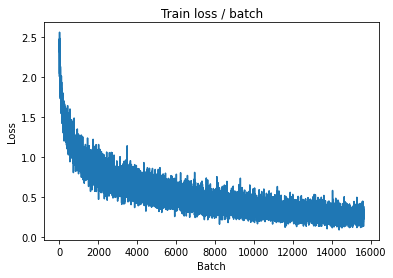

[TRAIN Batch 200/391]	Time 0.020s (0.056s)	Loss 0.1695 (0.2482)	Prec@1  94.5 ( 91.3)	Prec@5 100.0 ( 99.8)


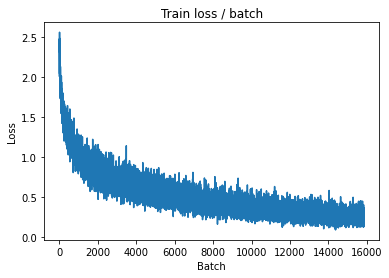


===============> Total time 21s	Avg loss 0.2502	Avg Prec@1 91.18 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.227s (0.227s)	Loss 0.4555 (0.4555)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5071	Avg Prec@1 85.05 %	Avg Prec@5 99.31 %



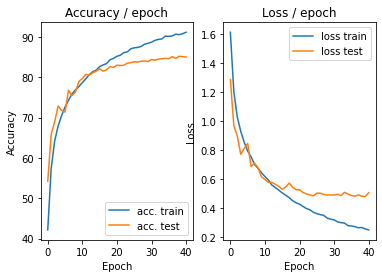

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.2343 (0.2343)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


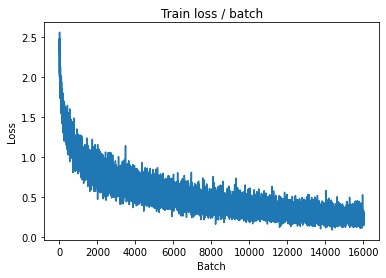

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 0.2596 (0.2421)	Prec@1  89.1 ( 91.3)	Prec@5 100.0 ( 99.9)


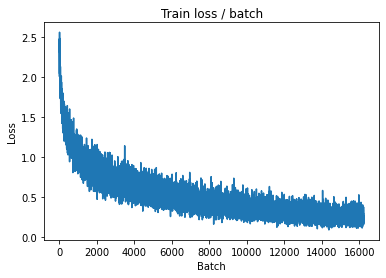


===============> Total time 21s	Avg loss 0.2415	Avg Prec@1 91.42 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.4339 (0.4339)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4960	Avg Prec@1 85.12 %	Avg Prec@5 99.36 %



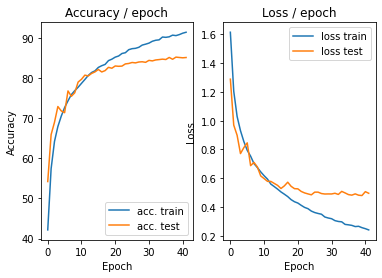

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.2411 (0.2411)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


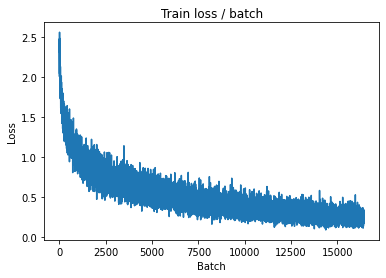

[TRAIN Batch 200/391]	Time 0.020s (0.056s)	Loss 0.2366 (0.2371)	Prec@1  89.8 ( 91.8)	Prec@5 100.0 ( 99.8)


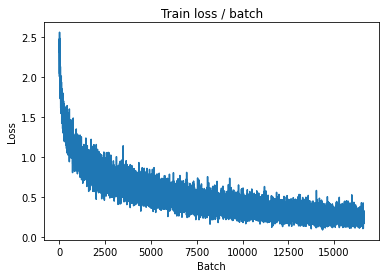


===============> Total time 21s	Avg loss 0.2409	Avg Prec@1 91.55 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.219s (0.219s)	Loss 0.3928 (0.3928)	Prec@1  89.8 ( 89.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4834	Avg Prec@1 85.14 %	Avg Prec@5 99.35 %



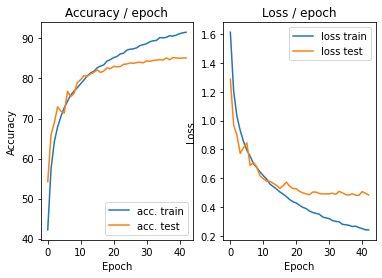

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.2472 (0.2472)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


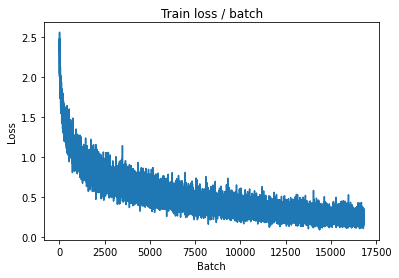

[TRAIN Batch 200/391]	Time 0.062s (0.055s)	Loss 0.1991 (0.2328)	Prec@1  89.8 ( 91.9)	Prec@5 100.0 ( 99.9)


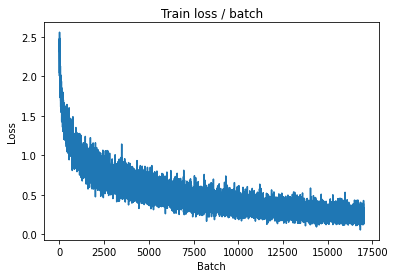


===============> Total time 21s	Avg loss 0.2360	Avg Prec@1 91.70 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.217s (0.217s)	Loss 0.4332 (0.4332)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4866	Avg Prec@1 85.13 %	Avg Prec@5 99.39 %



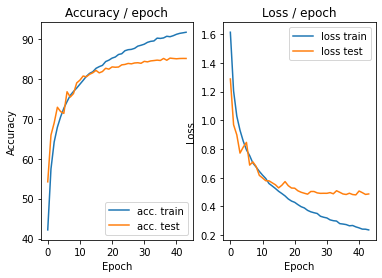

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.3039 (0.3039)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


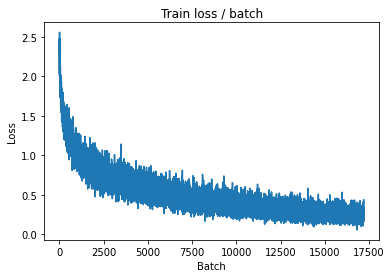

[TRAIN Batch 200/391]	Time 0.021s (0.056s)	Loss 0.2410 (0.2320)	Prec@1  93.0 ( 91.8)	Prec@5 100.0 ( 99.9)


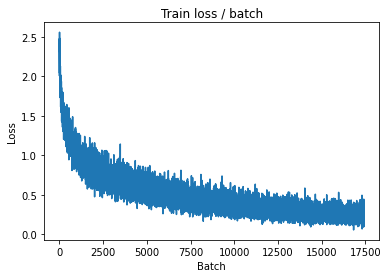


===============> Total time 21s	Avg loss 0.2351	Avg Prec@1 91.62 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.4027 (0.4027)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.4912	Avg Prec@1 85.01 %	Avg Prec@5 99.40 %



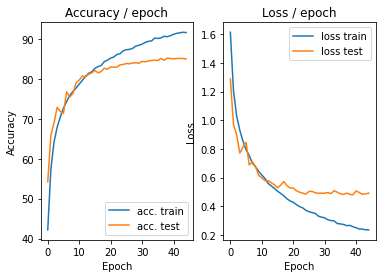

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.2239 (0.2239)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


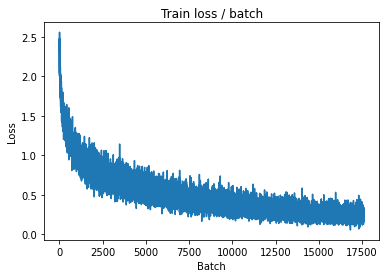

[TRAIN Batch 200/391]	Time 0.095s (0.057s)	Loss 0.2745 (0.2238)	Prec@1  88.3 ( 91.9)	Prec@5 100.0 ( 99.9)


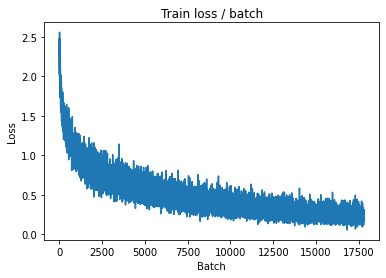


===============> Total time 21s	Avg loss 0.2284	Avg Prec@1 91.79 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 0.4032 (0.4032)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4917	Avg Prec@1 85.16 %	Avg Prec@5 99.35 %



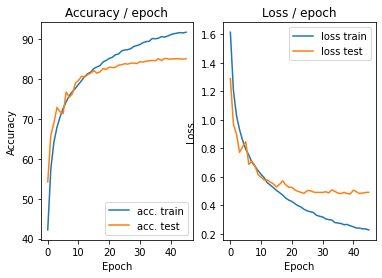

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.1991 (0.1991)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


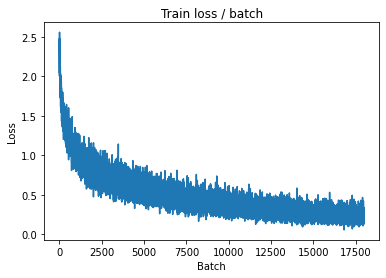

[TRAIN Batch 200/391]	Time 0.027s (0.056s)	Loss 0.2066 (0.2209)	Prec@1  93.0 ( 92.0)	Prec@5 100.0 ( 99.9)


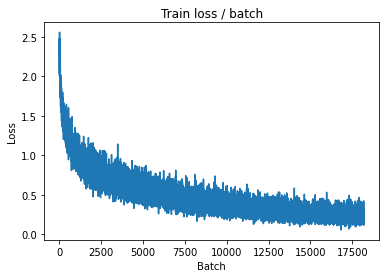


===============> Total time 21s	Avg loss 0.2247	Avg Prec@1 92.02 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.4388 (0.4388)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4983	Avg Prec@1 85.22 %	Avg Prec@5 99.40 %



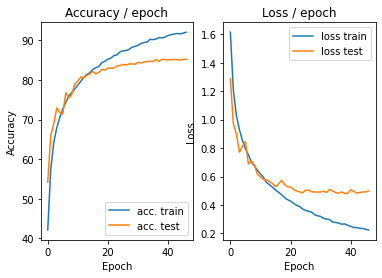

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.255s (0.255s)	Loss 0.3219 (0.3219)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


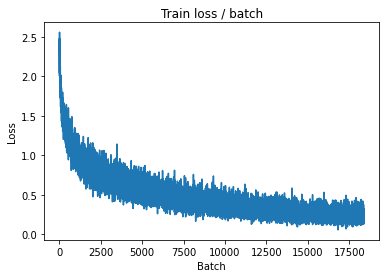

[TRAIN Batch 200/391]	Time 0.059s (0.056s)	Loss 0.1865 (0.2215)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 ( 99.9)


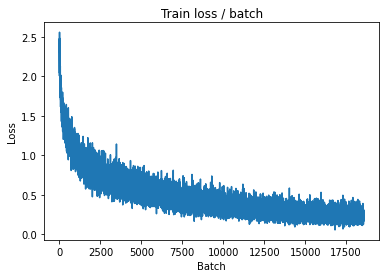


===============> Total time 21s	Avg loss 0.2205	Avg Prec@1 92.14 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.205s (0.205s)	Loss 0.4053 (0.4053)	Prec@1  89.8 ( 89.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5003	Avg Prec@1 85.44 %	Avg Prec@5 99.41 %



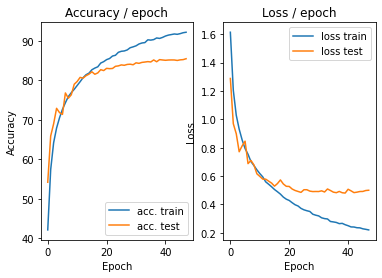

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.282s (0.282s)	Loss 0.1940 (0.1940)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


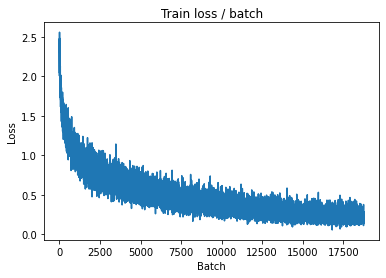

[TRAIN Batch 200/391]	Time 0.098s (0.056s)	Loss 0.2517 (0.2160)	Prec@1  93.0 ( 92.4)	Prec@5 100.0 ( 99.9)


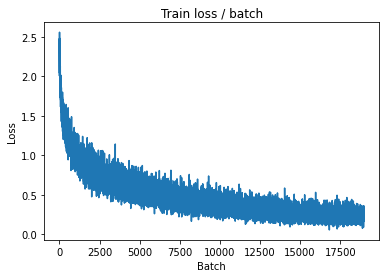


===============> Total time 21s	Avg loss 0.2176	Avg Prec@1 92.32 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.4463 (0.4463)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.5085	Avg Prec@1 85.29 %	Avg Prec@5 99.34 %



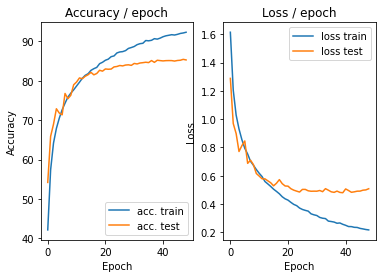

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.2207 (0.2207)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


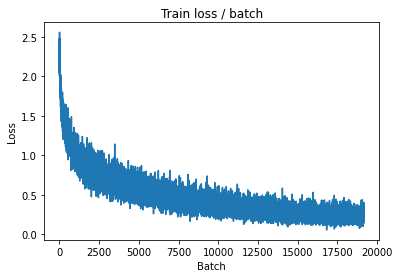

[TRAIN Batch 200/391]	Time 0.092s (0.057s)	Loss 0.2859 (0.2058)	Prec@1  89.8 ( 92.6)	Prec@5 100.0 ( 99.9)


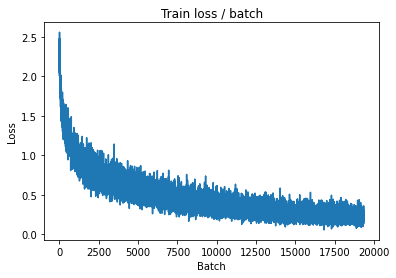


===============> Total time 21s	Avg loss 0.2094	Avg Prec@1 92.51 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.3759 (0.3759)	Prec@1  90.6 ( 90.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.4926	Avg Prec@1 85.29 %	Avg Prec@5 99.37 %



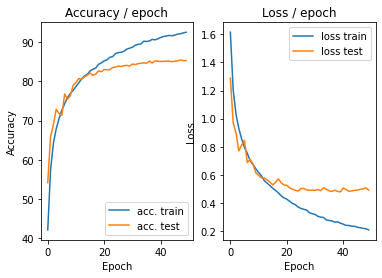

In [ ]:
main(128, 0.1,epochs=50, cuda=True)